In [1]:
import numpy as np
import matplotlib.pyplot as plt
import os

clean = True

In [23]:
#剔除立群点以便于作图观察
def DataClean(data,label,dataset):
    judges = np.abs(data - data.mean(axis=0)) <= (3 * data.std(axis=0))
    choose = np.full(len(data),True)
    for i in range(len(judges)):
        if any(judges[i] != np.full((10), True)):
            choose[i] = False
    new_data = data[choose]
    
    for i in range(len(new_data)):
        a = list(map(float, new_data[i]))
        a.append(label)
        dataset.append(a)
    
    return new_data

In [3]:
file_train = open("avila-tr.txt")
line = file_train.readline()
train_data = []
train_label = []
train_dataset = []
while line:
    data = line.split(',')
    train_data.append(list(map(float, data[:-1])))
    train_label.append(data[-1])
    
    a = list(map(float, data[:-1]))
    a.append(data[-1][0])
    train_dataset.append(a)
    
    line = file_train.readline()
    
file_train.close()
train_data = np.array(train_data)
train_label = np.array(train_label)



### histogram, box plot and scatter plot

In [27]:
A = []
B = []
C = []
D = []
E = []
F = []
G = []
H = []
I = []
W = []
X = []
Y = []
for i in range(len(train_data)):
    if train_label[i][0] == 'A':
        A.append(train_data[i])
    elif train_label[i][0] == 'B':
        B.append(train_data[i])
    elif train_label[i][0] == 'C':
        C.append(train_data[i])
    elif train_label[i][0] == 'D':
        D.append(train_data[i])
    elif train_label[i][0] == 'E':
        E.append(train_data[i])
    elif train_label[i][0] == 'F':
        F.append(train_data[i])
    elif train_label[i][0] == 'G':
        G.append(train_data[i])
    elif train_label[i][0] == 'H':
        H.append(train_data[i])
    elif train_label[i][0] == 'I':
        I.append(train_data[i])
    elif train_label[i][0] == 'W':
        W.append(train_data[i])
    elif train_label[i][0] == 'X':
        X.append(train_data[i])
    elif train_label[i][0] == 'Y':
        Y.append(train_data[i])


A = np.array(A)
B = np.array(B)
C = np.array(C)
D = np.array(D)
E = np.array(E)
F = np.array(F)
G = np.array(G)
H = np.array(H)
I = np.array(I)
W = np.array(W)
X = np.array(X)
Y = np.array(Y)

new_train_dataset = []
new_A = DataClean(A,'A',new_train_dataset)
new_B = DataClean(B,'B',new_train_dataset)
new_C = DataClean(C,'C',new_train_dataset)
new_D = DataClean(D,'D',new_train_dataset)
new_E = DataClean(E,'E',new_train_dataset)
new_F = DataClean(F,'F',new_train_dataset)
new_G = DataClean(G,'G',new_train_dataset)
new_H = DataClean(H,'H',new_train_dataset)
new_I = DataClean(I,'I',new_train_dataset)
new_W = DataClean(W,'W',new_train_dataset)
new_X = DataClean(X,'X',new_train_dataset)
new_Y = DataClean(Y,'Y',new_train_dataset)

print(len(new_train_dataset))

9260


----------------------histogram------------------------
leave the far outliers


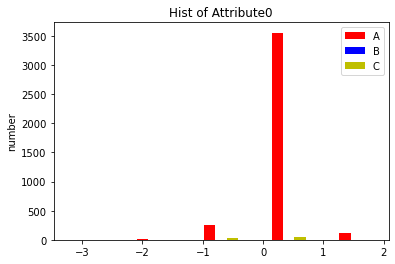

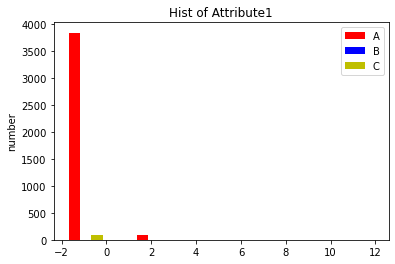

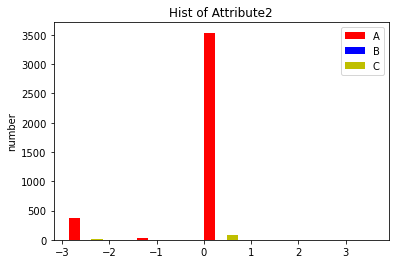

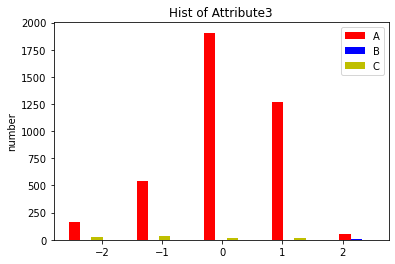

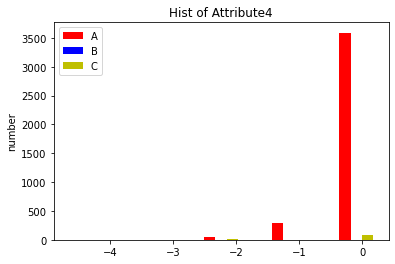

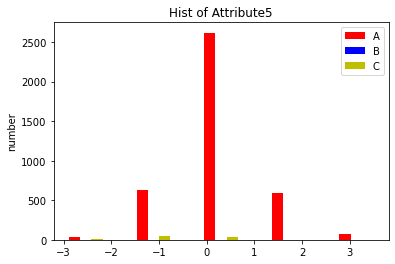

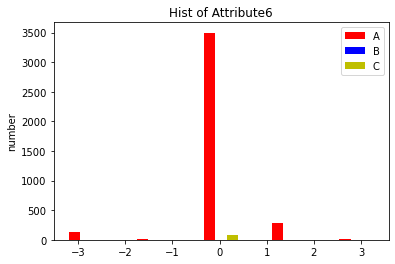

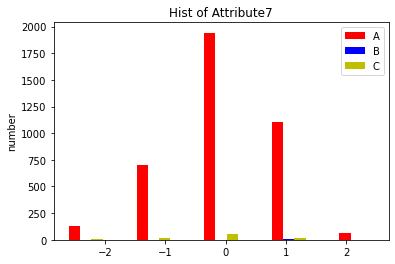

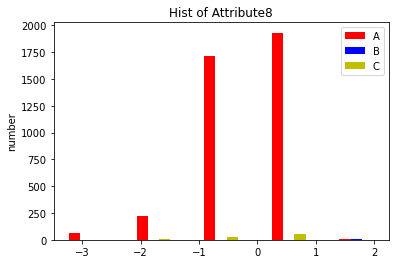

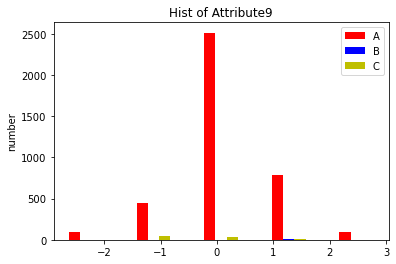

preserve the far outliers


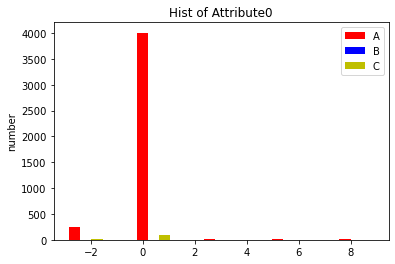

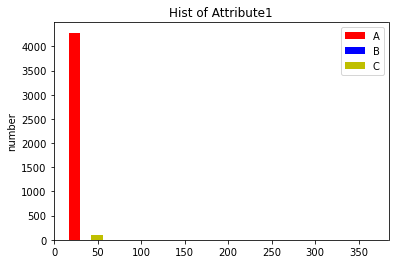

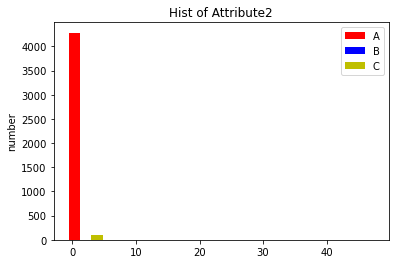

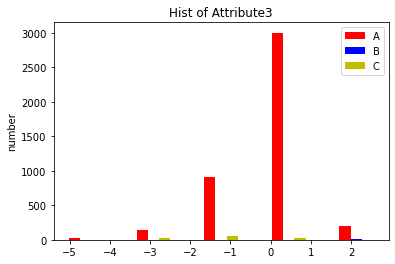

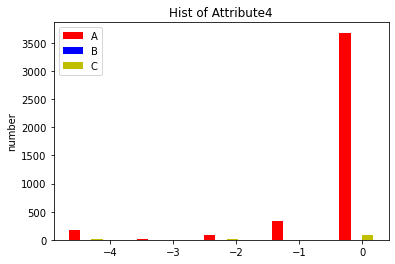

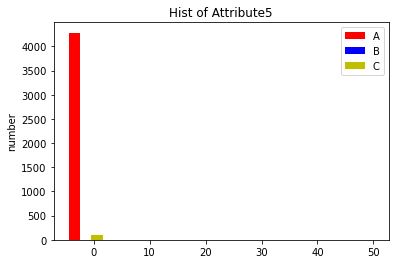

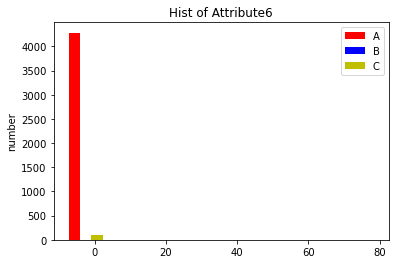

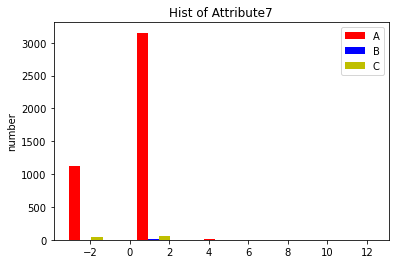

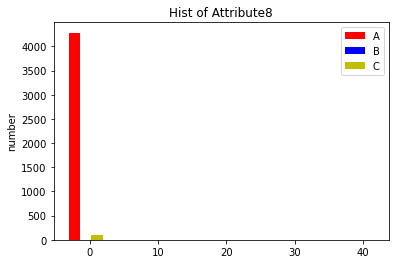

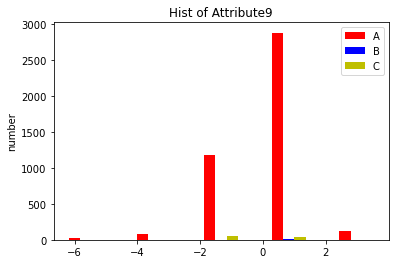

----------------------box plot------------------------


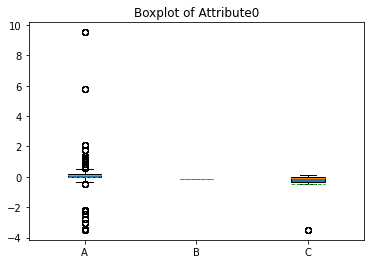

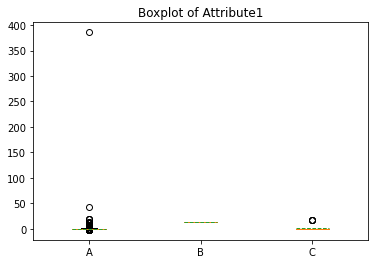

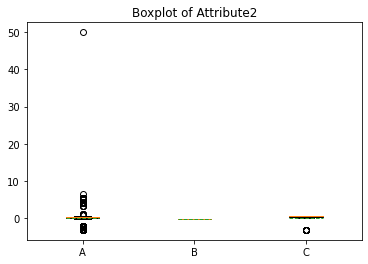

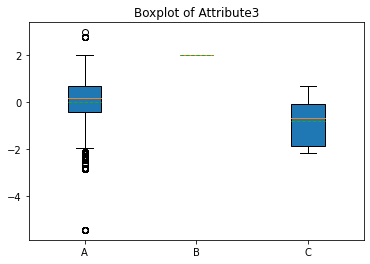

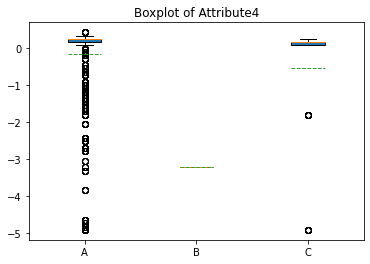

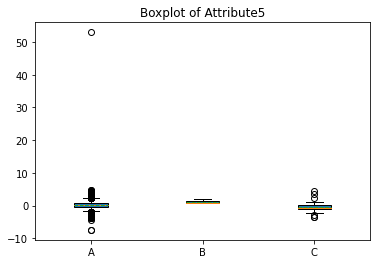

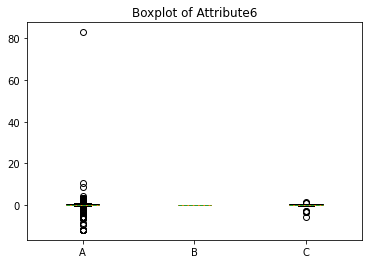

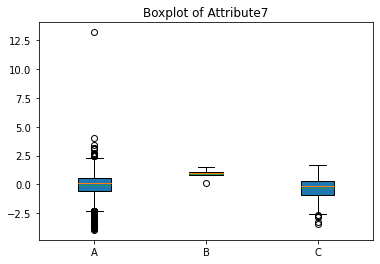

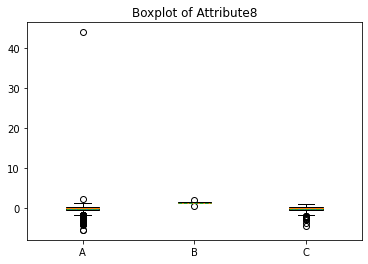

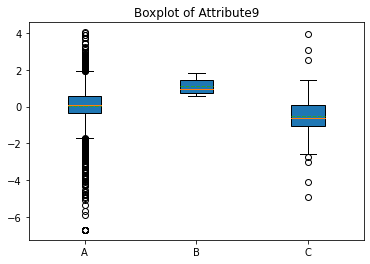

----------------------scatter plot------------------------
leave the far outliers


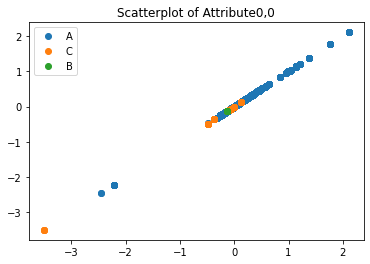

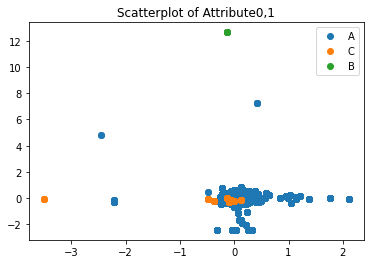

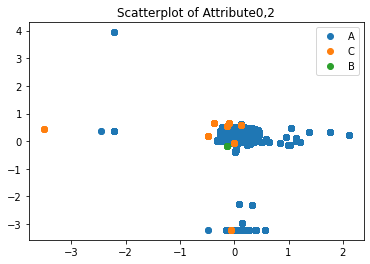

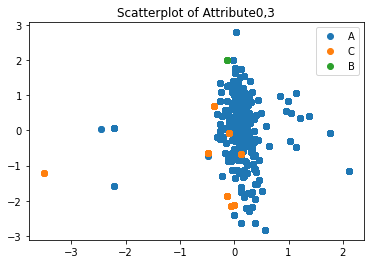

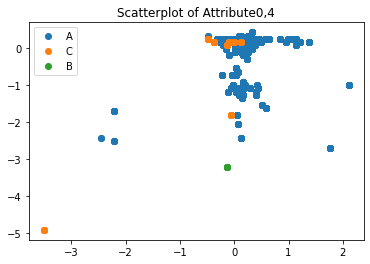

...

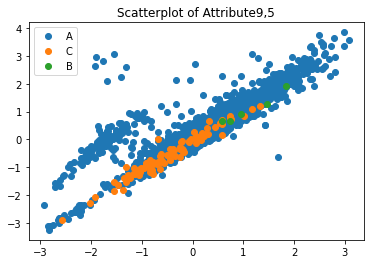

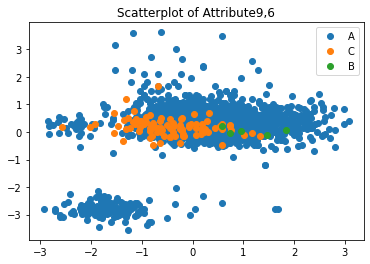

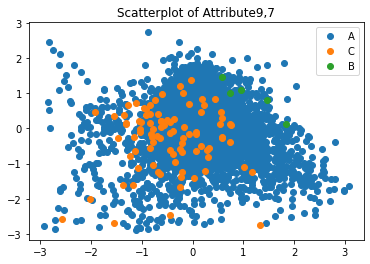

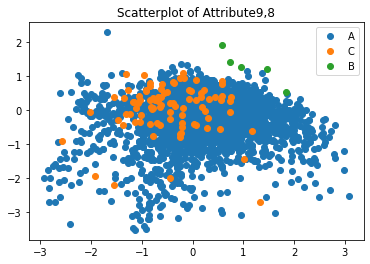

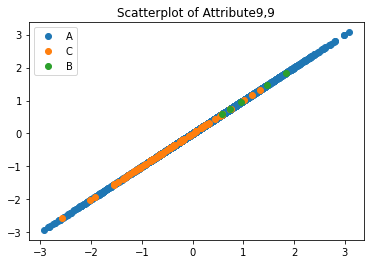

In [19]:
color = ['gray', 'pink']

def AttributeHist(j,clean=True):
    data_A = A[:, j]
    data_B = B[:, j]
    data_C = C[:, j]
    
    if clean:
        data_A = new_A[:, j]  
        data_B = new_B[:, j]
        data_C = new_C[:, j]
    
    plt.hist([data_A, data_B, data_C], 5, rwidth=0.5, color=['r', 'b', 'y'])
    plt.legend(['A', 'B', 'C'])
    plt.ylabel('number')
    plt.title('Hist of Attribute{}'.format(j))
    plt.show()


def AttributeBoxplot(j):
    data_A = A[:, j]
    data_B = B[:, j]
    data_C = C[:, j]
    
    plt.boxplot([data_A, data_B, data_C], sym='o',  # 异常点形状
                vert=True,  # 是否垂直
                patch_artist=True,  # 上下四分位框是否填充
                meanline=True,  # 是否有均值线
                showmeans=True,
                showbox=True,  # 是否显示箱线
                showfliers=True  # 是否显示异常值
                )
    plt.title('Boxplot of Attribute{}'.format(j))
    plt.xticks([1, 2, 3], ['A', 'B', 'C'])
    plt.show()


def AttributeScatterplot(i,j,clean): 
    data_Ai = A[:, i]
    data_Bi = B[:, i]
    data_Ci = C[:, i]
    data_Aj = A[:, j]
    data_Bj = B[:, j]
    data_Cj = C[:, j]
    if clean:
        data_Ai = new_A[:, i]  
        data_Bi = new_B[:, i]
        data_Ci = new_C[:, i]
        data_Aj = new_A[:, j]  
        data_Bj = new_B[:, j]
        data_Cj = new_C[:, j]
        
    plt.plot(data_Ai,data_Aj, 'o')
    plt.plot(data_Ci,data_Cj, 'o')
    plt.plot(data_Bi,data_Bj, 'o')
    plt.title('Scatterplot of Attribute{},{}'.format(i,j))
    plt.legend(['A', 'C', 'B'])
    plt.show()


print("----------------------histogram------------------------")
print("leave the far outliers")
for i in range(10):
    AttributeHist(i,True) 
print("preserve the far outliers")
for i in range(10):
    AttributeHist(i,False)

print("----------------------box plot------------------------")
for i in range(10):
    AttributeBoxplot(i)
    

print("----------------------scatter plot------------------------")
print("leave the far outliers")
for i in range(10):
    for j in range(10):
        AttributeScatterplot(i,j,clean)

      

### matrix plot

In [44]:
import seaborn as sns


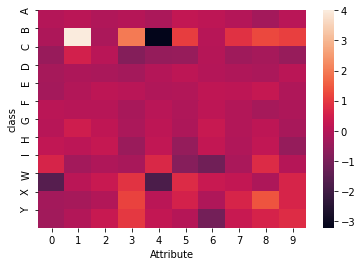

In [45]:
def DatasetMatrixplot(dataset):
    # sns.heatmap(dataset,annot=True,vmax=0.8,cmap='RdBu_r',square=True,center=0)
    sns.heatmap(dataset,vmax=4)



A = np.mean(A, axis=0)
B = np.mean(B, axis=0)
C = np.mean(C, axis=0)
D = np.mean(D, axis=0)
E = np.mean(E, axis=0)
F = np.mean(F, axis=0)
G = np.mean(G, axis=0)
H = np.mean(H, axis=0)
I = np.mean(I, axis=0)
W = np.mean(W, axis=0)
X = np.mean(X, axis=0)
Y = np.mean(Y, axis=0)

train_data_new = np.array([A, B, C, D, E, F, G, H, I, W, X, Y])
DatasetMatrixplot(train_data_new)


plt.yticks([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11], [
           'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'W', 'X', 'Y'])
plt.xlabel('Attribute')
plt.ylabel('class')
plt.show()


### pairwise similarity 

In [5]:
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.metrics.pairwise import euclidean_distances
from sklearn.metrics.pairwise import manhattan_distances


def CosineSimilarity(dataset):
    return cosine_similarity(dataset)


def EulerSimilarity(dataset):
    return euclidean_distances(dataset)


def ManhattanSimilarity(dataset):
    return manhattan_distances(dataset)

cos = 1 - CosineSimilarity(train_data)
euler = EulerSimilarity(train_data)
manhattan = ManhattanSimilarity(train_data)
cos,euler,manhattan

(array([[ 1.11022302e-16,  8.79706522e-01,  1.56261830e+00, ...,
          1.29738168e+00,  3.69320028e-01,  1.34552351e+00],
        [ 8.79706522e-01, -2.22044605e-16,  9.90033947e-01, ...,
          9.36646584e-01,  8.31138922e-01,  1.23158234e+00],
        [ 1.56261830e+00,  9.90033947e-01, -2.22044605e-16, ...,
          2.55780905e-01,  1.30394990e+00,  6.05127501e-01],
        ...,
        [ 1.29738168e+00,  9.36646584e-01,  2.55780905e-01, ...,
          1.11022302e-16,  9.88730250e-01,  8.36624614e-01],
        [ 3.69320028e-01,  8.31138922e-01,  1.30394990e+00, ...,
          9.88730250e-01,  2.22044605e-16,  1.47513984e+00],
        [ 1.34552351e+00,  1.23158234e+00,  6.05127501e-01, ...,
          8.36624614e-01,  1.47513984e+00,  0.00000000e+00]]),
 array([[0.        , 4.06368608, 2.39481081, ..., 2.33081726, 1.68312116,
         3.18149621],
        [4.06368608, 0.        , 4.24862231, ..., 4.22865697, 4.22739983,
         5.20165305],
        [2.39481081, 4.24862231, 0.  

### parallel coordinates

In [20]:
from pandas.plotting import parallel_coordinates
from pandas import DataFrame

In [28]:

df=DataFrame(new_train_dataset, columns=range(1,12))
df

,1,2,3,4,5,6,7,8,9,10,11
0,0.266074,-0.165620,0.320980,0.483299,0.172340,0.273364,0.371178,0.929823,0.251173,0.159345,A
1,0.130292,0.870736,-3.210528,0.062493,0.261718,1.436060,1.465940,0.636203,0.282354,0.515587,A
2,-0.116585,0.069915,0.068476,-0.783147,0.261718,0.439463,-0.081827,-0.888236,-0.123005,0.582939,A
3,0.031541,0.297600,-3.210528,-0.583590,-0.721442,-0.307984,0.710932,1.051693,0.594169,-0.533994,A
4,0.117948,-0.220579,-3.210528,-1.623238,0.261718,-0.349509,0.257927,-0.385979,-0.247731,-0.331310,A
...,...,...,...,...,...,...,...,...,...,...,...
9255,-0.104241,-0.079257,0.552147,1.388496,0.619230,-1.138481,-1.440842,0.915028,1.841428,-0.127169,Y
9256,-0.301743,-0.314793,0.399221,0.770520,0.708609,-0.058835,-1.063338,-0.062499,0.407080,0.745346,Y
9257,-0.289399,0.831480,0.157386,0.987562,0.529852,0.771662,-1.516343,-0.259740,1.030710,1.928990,Y
9258,-0.116585,-0.189174,0.694403,0.974792,0.708609,-1.055431,-1.176589,0.670025,0.968347,-0.202923,Y


<AxesSubplot:>

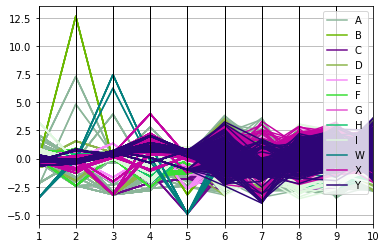

In [29]:
plt.figure()
parallel_coordinates(df, 11)
#lt.legend(train_label)

### star coordinates + chernoff faces

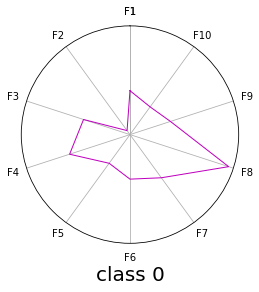

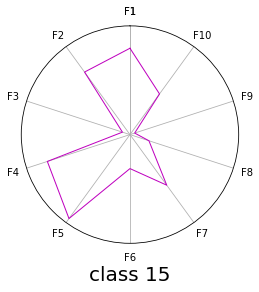

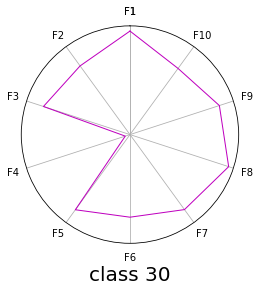

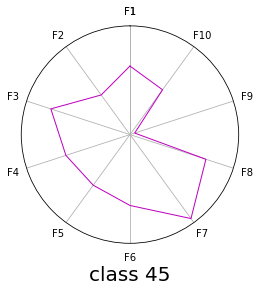

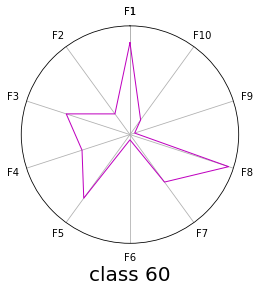

...

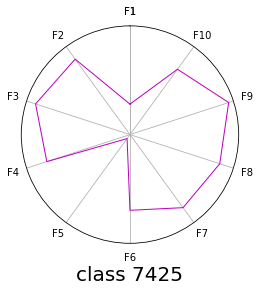

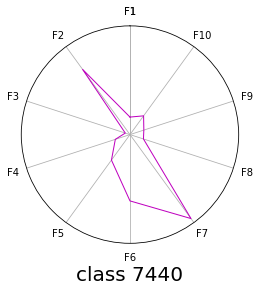

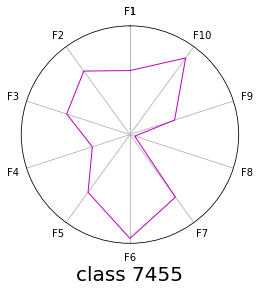

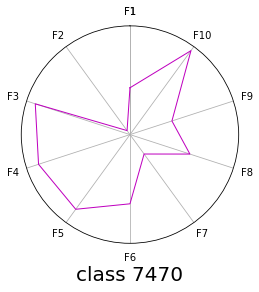

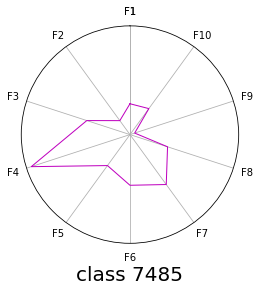

In [33]:
import numpy as np
import matplotlib.pyplot as plt
#plt.rcParams['font.sans-serif'] = ['SimHei']
def DrawStarCoordinates(j):
    name = ['F1','F2','F3','F4','F5', 'F6','F7','F8','F9','F10']   #标签
    theta = np.linspace(0,2*np.pi,len(name),endpoint=False)    #将圆根据标签的个数等比分
    value = train_data[j]  
    theta = np.concatenate((theta,[theta[0]]))  #闭合
    value = np.concatenate((value,[value[0]]))  #闭合
    name.append('F1')
    
    ax = plt.subplot(111,projection = 'polar',alpha=0)      #构建图例
    ax.plot(theta,value,'m-',lw=1,alpha = 1)    #绘图
    ax.fill(theta,value,'m',alpha = 0)           #填充
    ax.set_thetagrids(theta*180/np.pi,name)         #替换标签
    #ax.set_ylim(0,110)                          #设置极轴的区间
    ax.set_theta_zero_location('N')         #设置极轴方向
    plt.yticks([])
    #plt.xticks([])
    ax.set_title('class {}'.format(j),fontsize = 20, y=-.2)   #添加图描述
    plt.show()
for i in range(500):
    DrawStarCoordinates(i*15)

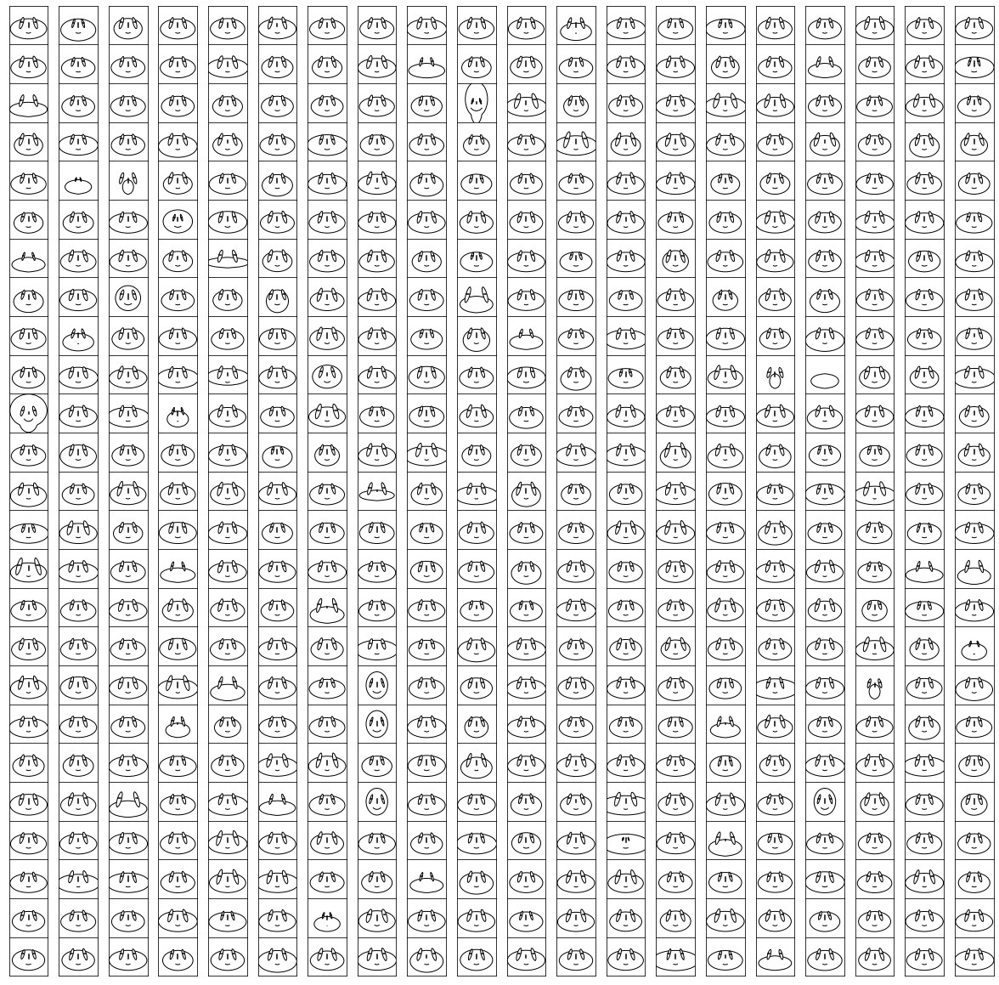

In [41]:
#def DrawChernoffFaces(j):
import matplotlib
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from numpy.random import rand
from numpy import pi, arctan

def cface(ax, x1,x2,x3,x4,x6,x8,x10,x11,x13,x14):
    # x1 = height  of upper face
    # x2 = overlap of lower face
    # x3 = half of vertical size of face
    # x4 = width of upper face
    # x5 = width of lower face
    # x6 = length of nose
    # x7 = vertical position of mouth
    # x8 = curvature of mouth
    # x9 = width of mouth
    # x10 = vertical position of eyes
    # x11 = separation of eyes
    # x12 = slant of eyes
    # x13 = eccentricity of eyes
    # x14 = size of eyes
    # x15 = position of pupils
    # x16 = vertical position of eyebrows
    # x17 = slant of eyebrows
    # x18 = size of eyebrows
    
    # transform some values so that input between 0,1 yields variety of output
    
    x1 = 1.5*x1
    x2 = x1
    x3 = 1.9*(x3-.5)
    x4 = (x4+.25)*1.25
    x5 = x4*.5
    x6 = .3*(x6+.01)
    x9 = x1
    x7 = 0.5
    x8 = 15*(x8+.001)
    
    x11 /= 5
    x12 = 5
    x13 += .15
    x14 *= 1.2
    x15 = 0
    x16 = 0.25
    x17 = 0
    x18 = 0.15

    # top of face, in box with l=-x4, r=x4, t=x1, b=x3
    e = matplotlib.patches.Ellipse( (0,(x1+x3)/2), 2*x4, (x1-x3), fc='white', edgecolor='black', linewidth=2)
    # e.set_clip_box(ax.bbox)
    # e.set_facecolor([0,0,0])
    ax.add_artist(e)

    # bottom of face, in box with l=-x5, r=x5, b=-x1, t=x2+x3
    e = matplotlib.patches.Ellipse( (0,(-x1+x2+x3)/2), 2*x5, (x1+x2+x3), fc='white', edgecolor='black', linewidth=2)
    ax.add_artist(e)

    # cover overlaps
    e = matplotlib.patches.Ellipse( (0,(x1+x3)/2), 2*x4, (x1-x3), fc='white', edgecolor='black', ec='none')
    ax.add_artist(e)
    e = matplotlib.patches.Ellipse( (0,(-x1+x2+x3)/2), 2*x5, (x1+x2+x3), fc='white', edgecolor='black', ec='none')
    ax.add_artist(e)
    
    # draw nose
    ax.plot([0,0], [-x6/2, x6/2], 'k')
    
    # draw mouth
    p = matplotlib.patches.Arc( (0,-x7+.5/x8), 1/x8, 1/x8, theta1=270-180/pi*arctan(x8*x9), theta2=270+180/pi*arctan(x8*x9))
    ax.add_artist(p)
    
    # draw eyes
    p = matplotlib.patches.Ellipse( (-x11-x14/2,x10), x14, x13*x14, angle=-180/pi*x12, facecolor='white', edgecolor='black')
    ax.add_artist(p)
    
    p = matplotlib.patches.Ellipse( (x11+x14/2,x10), x14, x13*x14, angle=180/pi*x12, facecolor='white', edgecolor='black')
    ax.add_artist(p)
    
    # draw eyebrows
    ax.plot([-x11-x14/2-x14*x18/2,-x11-x14/2+x14*x18/2],[x10+x13*x14*(x16+x17),x10+x13*x14*(x16-x17)],'k')
    ax.plot([x11+x14/2+x14*x18/2,x11+x14/2-x14*x18/2],[x10+x13*x14*(x16+x17),x10+x13*x14*(x16-x17)],'k')

min_max_scaler = MinMaxScaler()
X_train_minmax = min_max_scaler.fit_transform(train_data)

fig = plt.figure(figsize=(21,21))
for i in range(500):
    ax = fig.add_subplot(25,20,i+1,aspect='equal')
    
    cface(ax,  *X_train_minmax[i*15])#*rand(9)
    #cface(ax, .9, *rand(9))
    ax.axis([-1.2,1.2,-1.2,1.2])
    ax.set_xticks([])
    ax.set_yticks([])

fig.subplots_adjust(hspace=0, wspace=0)
plt.show()



### PCA

In [44]:
import matplotlib
#matplotlib.use('TkAgg')
import matplotlib.pyplot as plt
import pylab
def pca(X=np.array([]), no_dims=50):
    """
        Runs PCA on the NxD array X in order to reduce its dimensionality to
        no_dims dimensions.
    """

    print("Preprocessing the data using PCA...")
    (n, d) = X.shape
    X = X - np.tile(np.mean(X, 0), (n, 1))
    (l, M) = np.linalg.eig(np.dot(X.T, X))
    Y = np.dot(X, M[:, 0:no_dims])
    return Y

Y = pca(train_data, 2)


Preprocessing the data using PCA...


[[-0.00683513  0.81814632]
 [ 0.92738822  1.5052837 ]
 [ 0.05008565  0.08022263]
 ...
 [ 0.05669761  0.46464827]
 [ 0.52540932  1.64097853]
 [-0.79002276 -0.34053276]]


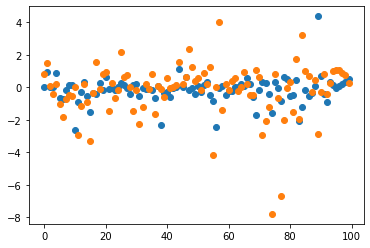

In [45]:
print(Y)
plt.plot(Y[:100], 'o')

### t-SNE

In [50]:
def Hbeta(D=np.array([]), beta=1.0):
    """
        Compute the perplexity and the P-row for a specific value of the
        precision of a Gaussian distribution.
    """

    # Compute P-row and corresponding perplexity
    P = np.exp(-D.copy() * beta)
    sumP = sum(P)
    H = np.log(sumP) + beta * np.sum(D * P) / sumP
    print("sumP",sumP)
    P = P / sumP
    return H, P

In [51]:
def x2p(X=np.array([]), tol=1e-5, perplexity=30.0):
    """
        Performs a binary search to get P-values in such a way that each
        conditional Gaussian has the same perplexity.
    """

    # Initialize some variables
    print("Computing pairwise distances...")
    (n, d) = X.shape
    sum_X = np.sum(np.square(X), 1)
    D = np.add(np.add(-2 * np.dot(X, X.T), sum_X).T, sum_X)
    P = np.zeros((n, n))
    beta = np.ones((n, 1))
    logU = np.log(perplexity)

    # Loop over all datapoints
    for i in range(n):

        # Print progress
        if i % 500 == 0:
            print("Computing P-values for point %d of %d..." % (i, n))

        # Compute the Gaussian kernel and entropy for the current precision
        betamin = -np.inf
        betamax = np.inf
        Di = D[i, np.concatenate((np.r_[0:i], np.r_[i+1:n]))]
        (H, thisP) = Hbeta(Di, beta[i])

        # Evaluate whether the perplexity is within tolerance
        Hdiff = H - logU
        tries = 0
        while np.abs(Hdiff) > tol and tries < 50:

            # If not, increase or decrease precision
            if Hdiff > 0:
                betamin = beta[i].copy()
                if betamax == np.inf or betamax == -np.inf:
                    beta[i] = beta[i] * 2.
                else:
                    beta[i] = (beta[i] + betamax) / 2.
            else:
                betamax = beta[i].copy()
                if betamin == np.inf or betamin == -np.inf:
                    beta[i] = beta[i] / 2.
                else:
                    beta[i] = (beta[i] + betamin) / 2.

            # Recompute the values
            (H, thisP) = Hbeta(Di, beta[i])
            Hdiff = H - logU
            tries += 1

        # Set the final row of P
        P[i, np.concatenate((np.r_[0:i], np.r_[i+1:n]))] = thisP

    # Return final P-matrix
    print("Mean value of sigma: %f" % np.mean(np.sqrt(1 / beta)))
    return P

In [54]:
def tsne(X=np.array([]), no_dims=2, initial_dims=50, perplexity=30.0):
    """
        Runs t-SNE on the dataset in the NxD array X to reduce its
        dimensionality to no_dims dimensions. The syntaxis of the function is
        `Y = tsne.tsne(X, no_dims, perplexity), where X is an NxD NumPy array.
    """

    # Check inputs
    if isinstance(no_dims, float):
        print("Error: array X should have type float.")
        return -1
    if round(no_dims) != no_dims:
        print("Error: number of dimensions should be an integer.")
        return -1

    # Initialize variables
    X = pca(X, initial_dims).real
    (n, d) = X.shape
    max_iter = 1000
    initial_momentum = 0.5
    final_momentum = 0.8
    eta = 500
    min_gain = 0.01
    Y = np.random.randn(n, no_dims)
    dY = np.zeros((n, no_dims))
    iY = np.zeros((n, no_dims))
    gains = np.ones((n, no_dims))

    # Compute P-values
    P = x2p(X, 1e-5, perplexity)
    P = P + np.transpose(P)
    P = P / np.sum(P)
    P = P * 4.									# early exaggeration
    P = np.maximum(P, 1e-12)

    # Run iterations
    for iter in range(max_iter):

        # Compute pairwise affinities
        sum_Y = np.sum(np.square(Y), 1)
        num = -2. * np.dot(Y, Y.T)
        num = 1. / (1. + np.add(np.add(num, sum_Y).T, sum_Y))
        num[range(n), range(n)] = 0.
        Q = num / np.sum(num)
        Q = np.maximum(Q, 1e-12)

        # Compute gradient
        PQ = P - Q
        for i in range(n):
            dY[i, :] = np.sum(np.tile(PQ[:, i] * num[:, i], (no_dims, 1)).T * (Y[i, :] - Y), 0)

        # Perform the update
        if iter < 20:
            momentum = initial_momentum
        else:
            momentum = final_momentum
        gains = (gains + 0.2) * ((dY > 0.) != (iY > 0.)) + \
                (gains * 0.8) * ((dY > 0.) == (iY > 0.))
        gains[gains < min_gain] = min_gain
        iY = momentum * iY - eta * (gains * dY)
        Y = Y + iY
        Y = Y - np.tile(np.mean(Y, 0), (n, 1))

        # Compute current value of cost function
        if (iter + 1) % 10 == 0:
            C = np.sum(P * np.log(P / Q))
            print("Iteration %d: error is %f" % (iter + 1, C))

        # Stop lying about P-values
        if iter == 100:
            P = P / 4.

    # Return solution
    return Y

In [52]:
print(train_data.shape)

(10430, 10)


In [ ]:
print("Run Y = tsne.tsne(X, no_dims, perplexity) to perform t-SNE on dataset AVILA.")
print("Running example on AVILA digits...")
Y = tsne(train_data, 2, 10, 20.0)

Run Y = tsne.tsne(X, no_dims, perplexity) to perform t-SNE on dataset AVILA.
Running example on AVILA digits...
Preprocessing the data using PCA...
Computing pairwise distances...
Computing P-values for point 0 of 10430...
sumP 827.1727310821993
sumP 272.0398168516051
sumP 63.69286090261473
sumP 10.18819739236508
sumP 1.183214397450572
sumP 0.18977396923735942
sumP 0.37677330365606987
sumP 0.6120375176479353
sumP 0.8289495127443889
sumP 0.98332538176501
sumP 0.9013001064578762
sumP 0.9410086293479912
sumP 0.9618281977906075
sumP 0.9724904278236591
sumP 0.9778861027424358
sumP 0.9751828413997713
sumP 0.9765331127831691
sumP 0.977209267525169
sumP 0.9768711051467618
sumP 0.9770401650776159
sumP 0.9771247109859925
sumP 0.9770824367030562
sumP 0.977061300558161
sumP 5.8576254182173715
sumP 0.42256612123096216
sumP 0.00922850353189377
sumP 0.0540486730734525
sumP 0.1441650500507863
sumP 0.08739071801571602
sumP 0.11194182026184024
sumP 0.0988432711564119
sumP 0.09292596167559124
sumP 0.0958

sumP 0.030821208106585417
sumP 0.030862655542829152
sumP 0.03088340113406843
sumP 0.03089377940269363
sumP 0.030898969905848762
sumP 0.030896374540183385
sumP 332.5476510312826
sumP 81.36311485714877
sumP 14.774969048429224
sumP 2.1180691178112334
sumP 0.22962795352835405
sumP 0.615705802088759
sumP 1.0890768929985832
sumP 0.811497747326304
sumP 0.9377056673750763
sumP 0.8718009815542294
sumP 0.9040137300989474
sumP 0.8877275933538331
sumP 0.8958250927645848
sumP 0.8999079394736944
sumP 0.9019579567575787
sumP 0.9029851226614816
sumP 0.9034992460307752
sumP 322.8643716194384
sumP 75.8502393142578
sumP 12.3474098277387
sumP 1.2410314699453637
sumP 0.053378145784315156
sumP 0.228364829019859
sumP 0.10824722011169356
sumP 0.1563087500921561
sumP 0.18863052691578278
sumP 0.17164533846499358
sumP 0.16378238495877434
sumP 0.1599982529323856
sumP 0.15814183709479973
sumP 0.15722239774098148
sumP 0.15768139093550992
sumP 0.15791143207858674
sumP 0.15779636606245057
sumP 0.15773886714276963
sum

sumP 0.8958186997650923
sumP 0.8957589230888463
sumP 0.8957290365702489
sumP 0.8957439796779262
sumP 122.81337905146243
sumP 19.517246317351535
sumP 2.8260244764875444
sumP 0.29051026226495813
sumP 0.7935751795974643
sumP 0.46849642014971066
sumP 0.6055667860326477
sumP 0.6919595920815896
sumP 0.6470372473216044
sumP 0.6690463475081384
sumP 0.6803872525949993
sumP 0.6746882139974391
sumP 0.6775305442491907
sumP 0.676107587201302
sumP 0.676818617078721
sumP 0.6771744684189447
sumP 0.6769965146980089
sumP 0.6769075588769592
sumP 0.6769520350344711
sumP 82.0759201475502
sumP 23.125144536219015
sumP 5.5762568918284074
sumP 1.1346160822025244
sumP 2.2275083024252122
sumP 1.5571342875575793
sumP 1.851019761921863
sumP 2.027169328126396
sumP 1.9363200415046742
sumP 1.9810218902656356
sumP 1.9584940290227368
sumP 1.9697132626708709
sumP 1.975356343735719
sumP 1.9725320023603607
sumP 1.9739434719216002
sumP 1.9732375619739473
sumP 1.9735904731417007
sumP 1.973766961578341
sumP 1.973855214011421

sumP 2.235293199949256
sumP 2.235274475890445
sumP 0.275094007181563
sumP 2.152509640005045
sumP 0.5582265825381909
sumP 0.9399685734434394
sumP 0.7065473517351302
sumP 0.8087469208803723
sumP 0.8700517752897647
sumP 0.9038321672970197
sumP 0.8866610235061504
sumP 0.8951747218079774
sumP 0.8909001123222865
sumP 0.8930329511947214
sumP 0.8919654185279587
sumP 0.891432487520909
sumP 0.8911662304958986
sumP 0.8912993416456881
sumP 0.8912327817308993
sumP 0.8911995050285304
sumP 0.8911828674910081
sumP 434.8673538383564
sumP 83.31409276630154
sumP 9.396688060705396
sumP 0.8188404296280989
sumP 0.07972912460736023
sumP 0.21195048217659435
sumP 0.3865599118700471
sumP 0.5491954347057331
sumP 0.6660068529613626
sumP 0.7371271721128929
sumP 0.700354557978275
sumP 0.6828903498977608
sumP 0.6743775385657264
sumP 0.6701746166855289
sumP 0.6722716597067633
sumP 0.6733234917471779
sumP 0.672797299244077
sumP 0.6730603263294003
sumP 0.6729287955008731
sumP 0.6729945565929579
sumP 0.6729616749664603


sumP 0.7722312477597563
sumP 0.7722678284708062
sumP 0.7722861197039296
sumP 25.97121317827305
sumP 1.359680291118258
sumP 0.018692121444137223
sumP 2.6025714079047834e-05
sumP 0.0005716075191591694
sumP 0.003056993102293924
sumP 0.007413826460770509
sumP 0.004739367844605928
sumP 0.00380223414669775
sumP 0.004243852185569608
sumP 0.004016705491552777
sumP 0.003907932630752355
sumP 0.003961928976141213
sumP 0.003989218979116486
sumP 0.003975549506081596
sumP 0.003982378113223603
sumP 0.003985797012387629
sumP 0.003987507612126477
sumP 0.00398665221637316
sumP 0.003987079890276033
sumP 14.372430926719666
sumP 5.568659361998548
sumP 1.9275961837977915
sumP 3.0789056737493916
sumP 4.050990688240208
sumP 4.717348360911469
sumP 5.115458873954576
sumP 4.910159238291808
sumP 4.8122640491118815
sumP 4.860830642631344
sumP 4.836453187203009
sumP 4.824335213054072
sumP 4.830388332115311
sumP 4.827360307678721
sumP 4.828873953408674
sumP 4.828117038954368
sumP 30.995559603167226
sumP 8.5194535878

sumP 1.193486084832823
sumP 1.1963159824744491
sumP 1.1948999624524212
sumP 1.1956077044113884
sumP 1.1959617763984074
sumP 1.195784723647708
sumP 1.1956962098407409
sumP 1.1957404656969637
sumP 1.1957625944105137
sumP 143.7158080004979
sumP 24.622410875079886
sumP 6.562836640949277
sumP 1.5786247046758288
sumP 2.9300617258948702
sumP 2.1127833041174604
sumP 2.4757968286880527
sumP 2.2844316022674
sumP 2.377476683010615
sumP 2.3303175164710996
sumP 2.353735173994736
sumP 2.365565094468953
sumP 2.3715106357460334
sumP 2.374491090543314
sumP 2.3730002216354067
sumP 2.3722552684007425
sumP 2.371882912011807
sumP 2.3716967638648834
sumP 2.3716036973021266
sumP 359.8009521778878
sumP 88.17817042555768
sumP 16.53190727319257
sumP 2.768007429379123
sumP 0.3612709677086171
sumP 0.890940793320028
sumP 1.5071425138281658
sumP 1.1494272860012746
sumP 1.010110645938186
sumP 1.0770026691985863
sumP 1.1124891164193669
sumP 1.0945688742897346
sumP 1.1034841953364793
sumP 1.0990154036227509
sumP 1.101

sumP 70.6277011073936
sumP 9.170765305034957
sumP 1.2057002620485096
sumP 2.6819519517980903
sumP 1.7326725386918433
sumP 1.434324190710062
sumP 1.312763698457132
sumP 1.3715724845762896
sumP 1.3416964492748158
sumP 1.3565139906129966
sumP 1.3490754268487564
sumP 1.345378530069062
sumP 1.347225121446231
sumP 1.3481498092657156
sumP 1.3486125017581032
sumP 1.348843935218804
sumP 1.348959673761392
sumP 1.3490175484868232
sumP 1.3489886106695637
sumP 1.3489741421018424
sumP 95.05594432625166
sumP 23.9897752980525
sumP 7.3092817299648365
sumP 2.5828148557207142
sumP 3.8974230782673325
sumP 5.133968151178539
sumP 4.438415462070924
sumP 4.151810888667666
sumP 4.290738282077779
sumP 4.363435527949725
sumP 4.400633921760494
sumP 4.419451000286406
sumP 4.428914707286455
sumP 4.424178235490422
sumP 4.4218134648943
sumP 4.422995561746567
sumP 4.422404441233654
sumP 4.422699983465327
sumP 4.42255220784368
sumP 4.422478323412262
sumP 0.9221522371151635
sumP 4.182291657974928
sumP 1.5294458550479761

sumP 0.3185786877279526
sumP 0.31832948185574345
sumP 0.31845405752171246
sumP 0.3183917628729104
sumP 0.31842290849314264
sumP 0.31840733525701065
sumP 211.3056882937121
sumP 42.15024941608096
sumP 5.810494241402097
sumP 0.5834443991009536
sumP 1.5663987416258756
sumP 0.9288267017546066
sumP 0.7316187888053195
sumP 0.6524080564821106
sumP 0.6167500702543416
sumP 0.5998151893388496
sumP 0.5915607192310124
sumP 0.5874854661923538
sumP 0.5854606811442103
sumP 0.5864720080852605
sumP 0.5859660785580422
sumP 0.585713313379281
sumP 0.585839679345412
sumP 0.585902874795253
sumP 0.5858712760312962
sumP 3.8592648407391335
sumP 5.509496448133913
sumP 13.797704610190053
sumP 6.590527121120929
sumP 8.10371239216969
sumP 7.1515276132532914
sumP 6.838984019978342
sumP 6.98567750395923
sumP 7.065974106779238
sumP 7.025199866707175
sumP 7.045426733893377
sumP 7.055659875125216
sumP 7.060806793699505
sumP 7.063387893263251
sumP 7.062096705197178
sumP 7.061451589997104
sumP 7.061129152000423
sumP 7.061

sumP 0.38735957140986726
sumP 0.5390090702415764
sumP 0.6470138308230393
sumP 0.7123615217692892
sumP 0.7484391104506236
sumP 0.7674127751970072
sumP 0.7771447672894949
sumP 0.782073547893573
sumP 0.7796038801997326
sumP 0.7783730078203227
sumP 0.778988114601793
sumP 0.778680478912444
sumP 0.7785267227984068
sumP 0.7784498601682055
sumP 7.054410758653378
sumP 0.29786184578870073
sumP 0.00606560872398219
sumP 0.035341400328650435
sumP 0.09597496321425993
sumP 0.1656234652555922
sumP 0.12550459933253688
sumP 0.10963298273136701
sumP 0.10255005241492453
sumP 0.10602535707118149
sumP 0.10427150950024792
sumP 0.10514434199734368
sumP 0.10558382134775927
sumP 0.10536382529893992
sumP 0.1054737591459745
sumP 0.1055287741920127
sumP 0.10550126265659451
sumP 0.10551501742103978
sumP 0.10552189555569008
sumP 0.10552533481113971
sumP 337.57892232550313
sumP 73.10589786186148
sumP 10.48999849308214
sumP 1.0268934407714698
sumP 0.04256097744501924
sumP 0.1897836320720095
sumP 0.08855985492558822
su

sumP 102.41120650048397
sumP 12.11783290916582
sumP 1.5947257577948333
sumP 0.2311654651342661
sumP 0.4907586878547796
sumP 0.8224755511532527
sumP 1.1215630769548663
sumP 0.9557663963304844
sumP 1.0340440539805626
sumP 1.0765690736871814
sumP 1.0550083355229427
sumP 1.0444528934044057
sumP 1.0392303026855956
sumP 1.0366326547105063
sumP 1.0379303454084494
sumP 1.037281217035522
sumP 1.036956865154293
sumP 1.0371190234105658
sumP 1.0370379398619296
sumP 1.0370784805310465
sumP 421.63469285539145
sumP 95.70698914153789
sumP 14.211114439365543
sumP 1.7424090779775767
sumP 0.21890487725039823
sumP 0.5341109452293983
sumP 0.9090216941999051
sumP 1.2341786831780797
sumP 1.0547665637895542
sumP 1.1396669360958689
sumP 1.0960978465988573
sumP 1.117592894635506
sumP 1.106774249988375
sumP 1.1014184219521375
sumP 1.098753746740481
sumP 1.0974247021562715
sumP 1.0967610010448268
sumP 1.0970927832304482
sumP 1.097258725596211
sumP 524.0871409300339
sumP 141.54392907182745
sumP 26.278719421870463


sumP 0.604008804597135
sumP 0.5933579445616686
sumP 0.5881345888196762
sumP 0.5907378808620168
sumP 0.5894341472848288
sumP 0.5900854910753127
sumP 0.5904115550801897
sumP 0.5902484903730142
sumP 0.5901669825501493
sumP 0.5902077344178089
sumP 44.87604840953271
sumP 7.882572279715492
sumP 0.9517273639741092
sumP 0.0729316176661368
sumP 0.22685713219204354
sumP 0.4406052039519053
sumP 0.6372789165367029
sumP 0.5279818116788738
sumP 0.5795116054012425
sumP 0.6075615273532895
sumP 0.6222045559594729
sumP 0.6296868838100191
sumP 0.6259321252327925
sumP 0.6278060911439214
sumP 0.6287456322852166
sumP 0.6292160440182497
sumP 0.6289807846733447
sumP 398.7554877862406
sumP 93.63691830106649
sumP 14.087617045523366
sumP 1.2694970265353367
sumP 0.06340588604034988
sumP 0.24297864371757733
sumP 0.5249340171884662
sumP 0.3531487782385227
sumP 0.29219193190817916
sumP 0.266292260059574
sumP 0.2543314612083763
sumP 0.26023355892572797
sumP 0.2572632288795802
sumP 0.2587435372239411
sumP 0.2594873293

sumP 0.21571278732239216
sumP 0.294580782524007
sumP 0.3458263529118395
sumP 0.3751785311151286
sumP 0.3601637994803542
sumP 0.35291265077677264
sumP 0.34934916737359684
sumP 0.35112579179975323
sumP 0.3502362044953184
sumP 0.34979236768827415
sumP 0.3500142064644972
sumP 0.3499032671777857
sumP 0.3498478124594077
sumP 0.349875538575062
sumP 74.96923898990225
sumP 9.380007658323542
sumP 2.646997372758064
sumP 4.051014629838745
sumP 3.197269078666163
sumP 3.5705051234856464
sumP 3.7943573299212057
sumP 3.918112674600855
sumP 3.9833534942530853
sumP 3.95043928243021
sumP 3.966821870723873
sumP 3.975068917541696
sumP 420.69920505441127
sumP 101.36052704766847
sumP 19.33789165016919
sumP 3.2059217601481738
sumP 0.4289414577934584
sumP 1.0213252421759802
sumP 1.7255336797666179
sumP 1.3146297155792215
sumP 1.156149220010595
sumP 1.0860670977434663
sumP 1.0530608987429426
sumP 1.0694012944513078
sumP 1.0776930219512106
sumP 1.0818697032379934
sumP 1.0839658034037793
sumP 1.0850158003068806
s

sumP 0.621125591295938
sumP 0.621095919533028
sumP 0.6210810842721689
sumP 676.3937033939909
sumP 208.27070042969123
sumP 44.37367811027681
sumP 6.652548863770852
sumP 0.8767849070380515
sumP 2.0197949526459493
sumP 1.2886667959327653
sumP 1.0556963558430805
sumP 1.164225705017112
sumP 1.1081410678697803
sumP 1.1357086261491458
sumP 1.1218087074381085
sumP 1.114946164452584
sumP 1.118370216495431
sumP 1.11665639046206
sumP 1.1158008280589522
sumP 1.1153733839816475
sumP 1.115159746158013
sumP 1.1150529482917015
sumP 1.114999554618887
sumP 1.1150262510169606
sumP 2.6493811527633104
sumP 4.141002122605934
sumP 6.901424327602468
sumP 4.990568648821151
sumP 5.649375029900185
sumP 6.135344604433953
sumP 6.465757186191832
sumP 6.6670313306349
sumP 6.779550954073415
sumP 6.722195020785491
sumP 6.694347725548015
sumP 6.70820396177913
sumP 6.715182505291762
sumP 6.711689003772826
sumP 6.713434695005546
sumP 6.712561584768626
sumP 6.712998073699318
sumP 6.712779812691096
sumP 514.250905871088
su

sumP 3.077012550192772
sumP 3.0884791565515144
sumP 3.0827289796989623
sumP 3.0855998336603405
sumP 3.0870384344766806
sumP 3.086318869163139
sumP 3.0859592852168776
sumP 3.086139060637367
sumP 3.0862289607615923
sumP 3.086184009664866
sumP 3.0862064849545727
sumP 3.086195247245063
sumP 261.67648105252687
sumP 57.7304234553416
sumP 9.868766236445163
sumP 1.0992017017153017
sumP 0.047567035267323504
sumP 0.20593965497781735
sumP 0.09722434664163578
sumP 0.14076482635251197
sumP 0.1700208554429896
sumP 0.18705125455207727
sumP 0.17831676170381539
sumP 0.17411551774951986
sumP 0.17620262917367024
sumP 0.17515571953204903
sumP 0.17567833292125873
sumP 0.17594027031965964
sumP 0.1758092489848023
sumP 0.1757437777998979
sumP 0.17577651010334483
sumP 0.17579287872173152
sumP 0.17578469420696424
sumP 677.0151416725334
sumP 220.76834036632715
sumP 52.48422349958839
sumP 8.321566731639734
sumP 0.712919760170503
sumP 0.019468578946340968
sumP 0.10527920333922196
sumP 0.04439083396430707
sumP 0.06

sumP 0.13287211982926803
sumP 0.13278884661643392
sumP 0.13283047596234318
sumP 0.13285129608032492
sumP 0.13284088556750798
sumP 3.759039948409521
sumP 5.308105390448707
sumP 6.689270394392906
sumP 8.718462334872642
sumP 30.458552737934113
sumP 10.808180185381044
sumP 9.41495233110568
sumP 9.96395923156223
sumP 9.663527936833429
sumP 9.533733541657753
sumP 9.59714575274836
sumP 9.565082705465583
sumP 9.581023255697291
sumP 9.589061539329323
sumP 9.593097876849704
sumP 9.5910782693002
sumP 9.59208771293994
sumP 9.59158290114108
sumP 9.591835284538908
sumP 9.59170908721544
sumP 9.591772184470882
sumP 9.591803734153295
sumP 16.624255587720103
sumP 0.6901783082824984
sumP 0.03477033947440577
sumP 0.11975195148535796
sumP 0.2603286659407353
sumP 0.41059704876184155
sumP 0.32469249509039905
sumP 0.29026693754039506
sumP 0.2747835029657947
sumP 0.26743284045222776
sumP 0.2710767148896548
sumP 0.27292216224596866
sumP 0.2719974622865278
sumP 0.27153659580940975
sumP 0.27176690569215467
sumP 0

sumP 41.54701692132502
sumP 4.607443804234273
sumP 0.2980750347488908
sumP 0.007576052759422525
sumP 0.04194850079613578
sumP 0.10637052786708598
sumP 0.17519219659456114
sumP 0.22745428804669016
sumP 0.19940390291776394
sumP 0.21290797800049818
sumP 0.22004524751993929
sumP 0.21644336347844226
sumP 0.21466744676872154
sumP 0.21378566731857265
sumP 0.2133463127516156
sumP 0.2135658623886126
sumP 0.21367573292075603
sumP 0.2136207896741285
sumP 0.2136482593019727
sumP 0.2136619956124551
sumP 2.3216326960642073
sumP 9.908327032456826
sumP 3.3878561288391427
sumP 4.99131114102791
sumP 3.9976841438718544
sumP 3.6584557009572354
sumP 3.5158208027403073
sumP 3.4501383947892275
sumP 3.418587773881017
sumP 3.434258820961635
sumP 3.4421723013340255
sumP 3.446148741067446
sumP 3.448141912367833
sumP 3.447144913304769
sumP 3.446646723892498
sumP 3.4468957927677675
sumP 3.4467712518733435
sumP 3.4467089862688187
sumP 3.446677854677155
sumP 57.12190059940327
sumP 6.754263575446913
sumP 1.0052212053

sumP 0.7353429668645912
sumP 0.7350002596032598
sumP 0.7351715881961666
sumP 0.7350859176413923
sumP 0.7351287513540582
sumP 9.849600981711621
sumP 2.9652413804749136
sumP 4.976611881871336
sumP 3.778977224641236
sumP 3.334975820948717
sumP 3.1418635027540733
sumP 3.2362397999753045
sumP 3.2850471147206495
sumP 3.2605052923497317
sumP 3.248338252228952
sumP 3.242280483299318
sumP 3.24530722823873
sumP 3.243793321366418
sumP 3.2430367687919963
sumP 3.2434150116865164
sumP 3.2436041581773556
sumP 3.2435095828447773
sumP 3.2435568699892654
sumP 3.8637490010910205e-07
sumP 0.0007329534982848688
sumP 0.039468124854240734
sumP 0.41995264797172766
sumP 2.530698584067078
sumP 0.9072834784324739
sumP 1.4397546500526142
sumP 1.8754491083050755
sumP 1.637351512767785
sumP 1.5341229049599572
sumP 1.5845591116070672
sumP 1.6106512996921425
sumP 1.623924171756376
sumP 1.6306183767726148
sumP 1.6272664276352127
sumP 1.6289411880871747
sumP 1.6297794785925332
sumP 1.6293602574190658
sumP 1.62956984902

sumP 0.8068902267199384
sumP 1.3676197546770783
sumP 1.039781555529046
sumP 1.1891302525199157
sumP 1.1112065469416832
sumP 1.149310963216832
sumP 1.1300502654896116
sumP 1.1205769964791432
sumP 1.1158790070818965
sumP 1.1182247997039934
sumP 1.1170511042422404
sumP 1.1176377520146061
sumP 1.1179312258482985
sumP 1.1180780002707247
sumP 1.1180046099334888
sumP 1.1179679171094308
sumP 8.920769732997172
sumP 3.6730721477511294
sumP 5.439435805654842
sumP 4.426007613639368
sumP 4.8932768380268685
sumP 5.155423146094296
sumP 5.294545342161379
sumP 5.366249484677354
sumP 5.4026547854771
sumP 5.420998002015006
sumP 5.411814611672939
sumP 5.416403356176216
sumP 5.414108246902247
sumP 5.415255617203133
sumP 5.415829440595578
sumP 6.253018298650769
sumP 2.466859043928097
sumP 3.2433431656169738
sumP 4.128297005078369
sumP 4.931352965245775
sumP 4.48377160084037
sumP 4.296193027541022
sumP 4.209963260306685
sumP 4.168580379233694
sumP 4.189131864172917
sumP 4.1788214516243976
sumP 4.183967950790

sumP 1.5802616017421525
sumP 1.5930818178734976
sumP 1.5866533024748168
sumP 1.5898629414921963
sumP 1.5882569694248294
sumP 1.5874548480736308
sumP 1.5878558367472713
sumP 1.5880563850814466
sumP 1.5881566727514695
sumP 1.5882068199626656
sumP 1.5881817460757082
sumP 728.2216481777114
sumP 209.59650183256778
sumP 39.9381869742993
sumP 4.714421892754816
sumP 0.2663977487480951
sumP 0.003919001842912922
sumP 0.02857325168457924
sumP 0.0833793856229484
sumP 0.048376329818371096
sumP 0.06335298953779586
sumP 0.0726319896177387
sumP 0.06782319986685828
sumP 0.07018358558442779
sumP 0.0713965664488288
sumP 0.07078729845552528
sumP 0.07048475106293119
sumP 0.07033399601154984
sumP 0.07040933040590672
sumP 0.07037165243256314
sumP 0.07039048872436053
sumP 0.07038106990484723
sumP 0.07037636100031461
sumP 632.5442172439263
sumP 191.97002816672804
sumP 42.48661537302756
sumP 6.275120811108728
sumP 0.5999178947713897
sumP 0.056954868695793366
sumP 0.15004134725770255
sumP 0.276835120579559
sumP 

sumP 0.4822549436967082
sumP 0.9069333800266853
sumP 0.6542916632054426
sumP 0.5603615376192528
sumP 0.6051228183933355
sumP 0.6291247039693207
sumP 0.6169822410924519
sumP 0.6110176490297035
sumP 0.6139911631201258
sumP 0.6154844988442532
sumP 0.6147372811413166
sumP 28.408587751606976
sumP 3.3043100933403777
sumP 0.4908184391890656
sumP 1.145058905457721
sumP 1.8570880780707326
sumP 1.4472738500492044
sumP 1.2852866014234077
sumP 1.3632932601229946
sumP 1.40449944707176
sumP 1.383705195879861
sumP 1.3940539363924798
sumP 1.3992645198891183
sumP 1.3966561946770888
sumP 1.3953543083515403
sumP 1.396005062070868
sumP 1.3963305809946431
sumP 1.3961678096902281
sumP 711.468633698677
sumP 203.9044557192759
sumP 40.33184556418237
sumP 6.277654649578181
sumP 0.9065930923441735
sumP 2.050366452830615
sumP 1.3306398902228944
sumP 1.0928846404296917
sumP 1.2042737395697676
sumP 1.1468552794967586
sumP 1.1194559385450333
sumP 1.1330500490483397
sumP 1.1399260119206778
sumP 1.1433839494726652
sum

sumP 3.0910737714806804
sumP 100.50596891028513
sumP 9.096894321531876
sumP 1.0578750292883343
sumP 2.385432871530927
sumP 1.5226569090805462
sumP 1.2580482710064926
sumP 1.3807446393353526
sumP 1.3172167524144807
sumP 1.2871126136994688
sumP 1.3020316923678605
sumP 1.294539289139694
sumP 1.298277227238101
sumP 1.2964061982793764
sumP 1.2954722294759926
sumP 1.2950056308422953
sumP 0.6201988313288462
sumP 4.492159666833993
sumP 1.314871451355339
sumP 2.1545962980573385
sumP 1.6525288770305706
sumP 1.4687942177778288
sumP 1.3886006578163932
sumP 1.4278345587719614
sumP 1.448091263352815
sumP 1.4583859965055554
sumP 1.4532245659849536
sumP 1.4558017501092257
sumP 1.4570929886201682
sumP 1.4577392711525592
sumP 71.890150433069
sumP 17.760247679500466
sumP 3.9492380578907187
sumP 0.6465158966249654
sumP 1.4492756661821662
sumP 0.9519668332270736
sumP 1.168893464107994
sumP 1.299840800354028
sumP 1.372053985431104
sumP 1.4100124315286418
sumP 1.3908735058875432
sumP 1.4004026253073512
sumP 

sumP 1.19102409224382
sumP 1.191443357547729
sumP 1.191653062195471
sumP 1.1917579325244545
sumP 1.1917054958593538
sumP 1.191679278652273
sumP 10.663061380509571
sumP 3.4512174550102532
sumP 5.488110581370521
sumP 4.271953213966785
sumP 3.8241731043864395
sumP 4.037500199332795
sumP 3.9283617913843982
sumP 3.982292552529014
sumP 4.009734214758762
sumP 4.023576342481299
sumP 4.016645103260378
sumP 4.02010817394882
sumP 4.021841620347941
sumP 4.020974737761219
sumP 4.020541416018176
sumP 4.020324785025545
sumP 4.020433098032205
sumP 4.020487256402751
sumP 482.33315713157856
sumP 132.01984651717407
sumP 29.737260170538885
sumP 6.946440048050067
sumP 1.994006368431424
sumP 3.2897725213636932
sumP 4.559293776202041
sumP 3.8379805671153155
sumP 3.5462449552762836
sumP 3.4140019185523385
sumP 3.4790752596997763
sumP 3.4462825655171576
sumP 3.430078969628135
sumP 3.422024716512889
sumP 3.426047899911961
sumP 3.4240353238340084
sumP 3.42504136560217
sumP 3.4255445711673262
sumP 3.4257962201394

sumP 2.701197948135232
sumP 2.70314254013008
sumP 2.7021699924469624
sumP 404.5888786450914
sumP 84.7811960984606
sumP 14.237172136822657
sumP 2.029627416384896
sumP 0.22709062611032976
sumP 0.5760574527933272
sumP 1.0243375800690382
sumP 0.7593658574398902
sumP 0.8792293999134106
sumP 0.8164937564926009
sumP 0.84712029294685
sumP 0.862984188460462
sumP 0.8550052572139583
sumP 0.8589828927278509
sumP 0.8609805724601353
sumP 0.8619816370961034
sumP 0.862482726770595
sumP 0.8622321354522711
sumP 0.8623574194885608
sumP 0.8624200702235338
sumP 0.8624513977705115
sumP 0.8624357338153881
sumP 3.369105395574926
sumP 6.72306785730335
sumP 11.927686661534127
sumP 8.54049629976958
sumP 9.866032710781923
sumP 9.150479233103855
sumP 8.834511454773098
sumP 8.98952889215223
sumP 9.069230800921115
sumP 9.109657463521152
sumP 9.089395287119356
sumP 9.07930089944134
sumP 9.084345048851679
sumP 9.081822214078155
sumP 9.080561366872217
sumP 9.081191742987096
sumP 18.04277774187536
sumP 4.683024253761507

sumP 0.2543559343794296
sumP 0.463596633602502
sumP 0.6507188503159895
sumP 0.7800028798014459
sumP 0.856734891689859
sumP 0.8986482750850029
sumP 0.8773781894337611
sumP 0.8669795883599614
sumP 0.8721594785936778
sumP 0.8747639597087485
sumP 0.8760698532664024
sumP 0.8754166015029955
sumP 0.8750902044023825
sumP 0.8752533838964869
sumP 0.8753349879350243
sumP 0.8752941847246599
sumP 0.8752737840128105
sumP 34.89779301285271
sumP 6.049256355199488
sumP 1.1144408094231593
sumP 2.3064285860604508
sumP 1.5741167079480551
sumP 1.8950756140841094
sumP 1.7250285253219422
sumP 1.647360815106249
sumP 1.610206454786288
sumP 1.5920309785541606
sumP 1.6010857613092324
sumP 1.5965501694550683
sumP 1.598815910485265
sumP 1.599950321574269
sumP 1.5993829875239376
sumP 1.5996666224132927
sumP 1.5995247969358326
sumP 1.5994538902218345
sumP 1.5994184383708916
sumP 70.03281293745279
sumP 11.05579046378566
sumP 1.781475871907395
sumP 3.6335193807816566
sumP 2.44304028803622
sumP 2.067131743047032
sumP 1

sumP 2.3628285026508427
sumP 535.5930608933049
sumP 133.57025429000967
sumP 23.25978127267079
sumP 2.9664705350149045
sumP 0.29167938852062203
sumP 0.7858942125889888
sumP 0.4642019605233778
sumP 0.5987132623101925
sumP 0.684338590481089
sumP 0.6397327892552892
sumP 0.6615644685397498
sumP 0.6728307066466787
sumP 0.6671677660817581
sumP 0.6643587093353965
sumP 0.6657613798169311
sumP 0.6650595808421889
sumP 0.665410364303805
sumP 0.6655858430423895
sumP 0.6654980964200455
sumP 0.6655419679177724
sumP 0.6655200317155693
sumP 742.177422579716
sumP 242.6397428715576
sumP 58.95164883622333
sumP 10.52402952984037
sumP 1.6450242036694585
sumP 3.4557004813191647
sumP 2.29102553299353
sumP 1.923446211639161
sumP 1.7748455677875479
sumP 1.7077727387394497
sumP 1.7407467792125713
sumP 1.7576527401650321
sumP 1.7662129335106527
sumP 1.7705201498103524
sumP 1.772680577845197
sumP 1.7737625018581165
sumP 1.7743038919931813
sumP 1.7740331612295035
sumP 1.7741685176858937
sumP 1.7742362026079996
sumP

sumP 0.22389107361938373
sumP 0.2728116482568585
sumP 0.30186528041668986
sumP 0.3177327405401229
sumP 0.3096808222119639
sumP 0.3057440108332936
sumP 0.3077050938569623
sumP 0.306722729544906
sumP 0.3062329154680964
sumP 0.3064777087040561
sumP 0.3063552836507508
sumP 0.30641648906666213
sumP 0.3063858845812609
sumP 0.30640118637957053
sumP 598.2680992176093
sumP 150.32613189067968
sumP 23.636518459763966
sumP 2.062524438400127
sumP 0.0723266645663905
sumP 0.0003851560057150856
sumP 0.004757801126784327
sumP 0.017836006741941666
sumP 0.0354661410661007
sumP 0.050463966799518874
sumP 0.04227000618067296
sumP 0.03871105940894657
sumP 0.04044932418337695
sumP 0.04134910716552402
sumP 0.0408966086851263
sumP 0.04067231870413111
sumP 0.040784301262032044
sumP 0.040840414302739846
sumP 0.04081234762252057
sumP 0.04079832190328979
sumP 0.04079131094803671
sumP 0.04079481626699178
sumP 0.040796569045471104
sumP 188.72481635079458
sumP 40.97304589338735
sumP 9.253697646922816
sumP 2.0761006763

sumP 1.1640780625781497
sumP 1.0425551213090287
sumP 1.1011594754148504
sumP 1.0713414439019413
sumP 1.0861186633718716
sumP 1.0786974644154586
sumP 1.0750113513232376
sumP 1.0731743774308617
sumP 1.0722574063098966
sumP 1.072715765695228
sumP 1.072486554469531
sumP 1.072601152197777
sumP 1.0726584569751818
sumP 1.0726298040936693
sumP 0.19850766862803287
sumP 1.5260798314316906
sumP 0.4459023237714313
sumP 0.7574457869941528
sumP 1.0448273561693755
sumP 0.8842665159574601
sumP 0.959634909656412
sumP 0.920820172798345
sumP 0.9399334729530668
sumP 0.930304778914844
sumP 0.9255446450608782
sumP 0.9279202319374336
sumP 0.9291113826045717
sumP 0.928515526917405
sumP 0.9282178093829394
sumP 0.9280690031545478
sumP 0.9281434018916479
sumP 0.9281062014289111
sumP 0.9281248013867189
sumP 544.5414236041202
sumP 135.28908977464567
sumP 21.381494723081655
sumP 2.5790977111600517
sumP 0.31513961019567505
sumP 0.7486588360252691
sumP 1.3017113644151865
sumP 0.9742409751551568
sumP 0.851478546983221

sumP 0.4661003096089838
sumP 561.0075993097433
sumP 134.35635056238146
sumP 19.775969004853867
sumP 1.694413980447822
sumP 0.08141112882784104
sumP 0.30840282191857005
sumP 0.15314145997461542
sumP 0.21521014261762011
sumP 0.18112999893735948
sumP 0.19731992940108745
sumP 0.20604012867072552
sumP 0.2105672730607103
sumP 0.2128740318393827
sumP 0.21171701001331122
sumP 0.21114123422450007
sumP 0.21142889487974648
sumP 0.2115728955852682
sumP 0.21150088102363004
sumP 0.21153688475142576
sumP 0.21155488927999042
sumP 0.21154588679363134
sumP 541.080974974458
sumP 150.24348848829004
sumP 32.635019841023926
sumP 6.087388519681479
sumP 0.8859403788424556
sumP 0.06128989266546251
sumP 0.21174751694907015
sumP 0.4192478063345518
sumP 0.6034174996236386
sumP 0.7291160781688404
sumP 0.8031134064143648
sumP 0.8433483534596726
sumP 0.8229460670882378
sumP 0.8129597186090793
sumP 0.8080192035373587
sumP 0.8055619832694834
sumP 0.8043366166601973
sumP 0.8049490301392331
sumP 0.8046427559783643
sumP 

sumP 0.6078156604362723
sumP 0.609656845602365
sumP 0.6105802647939914
sumP 0.610118319125054
sumP 0.6103492329019697
sumP 0.6102337612540377
sumP 0.6102914933875215
sumP 0.610320362222053
sumP 0.6103347973313269
sumP 28.757834290001256
sumP 7.104780574924763
sumP 1.3200467149395247
sumP 0.09238899439597656
sumP 0.33020724941932283
sumP 0.6480093282729718
sumP 0.4608104554815259
sumP 0.5458856082427275
sumP 0.5945985411875828
sumP 0.6206867241024003
sumP 0.6074922104906624
sumP 0.6010082433687602
sumP 0.5977941675628774
sumP 0.5961940554515531
sumP 0.5953957244927391
sumP 0.59499698949629
sumP 0.5947977295200617
sumP 0.5948973505509467
sumP 0.5948475377964179
sumP 808.8684047151672
sumP 261.6479846984463
sumP 62.44718927415699
sumP 11.103165274131044
sumP 1.3266986471552895
sumP 0.08940454481060185
sumP 0.3005227563649523
sumP 0.6014194153327049
sumP 0.42096474104947595
sumP 0.5018020260075584
sumP 0.45931303295291387
sumP 0.4396518445686528
sumP 0.44935702455731247
sumP 0.454303204615

sumP 3.355174214014374
sumP 3.332014008606122
sumP 2.6542075131081706
sumP 10.76548374453472
sumP 3.772525818263286
sumP 5.47791459451219
sumP 4.418354620958123
sumP 4.058544168920141
sumP 3.907659928990148
sumP 3.838269127612366
sumP 3.804958378278865
sumP 3.821501928192325
sumP 3.8132024567356497
sumP 3.817345236086828
sumP 3.8152721113614714
sumP 3.8163082394569816
sumP 3.815790066905557
sumP 3.815531062015506
sumP 3.8156605576800597
sumP 3.8155958081527532
sumP 3.8155634346604064
sumP 526.8529206110353
sumP 138.62526138878866
sumP 27.644013697519373
sumP 5.275168464652342
sumP 1.5514390693222921
sumP 2.4035922821743565
sumP 3.332966694377471
sumP 2.794082971590251
sumP 3.040614379935426
sumP 3.1803808391584636
sumP 3.10898782726385
sumP 3.074434546847214
sumP 3.0916182160614736
sumP 3.1002796099203893
sumP 3.1046278443726276
sumP 3.1024522612593124
sumP 3.103539686011155
sumP 3.1029958819756858
sumP 3.1027240487078123
sumP 3.1028599596136743
sumP 3.1027920027288087
sumP 220.6158318

sumP 0.5077307982115006
sumP 0.3534319567437094
sumP 0.42249764715250954
sumP 0.46284055335725954
sumP 0.4421350321315957
sumP 0.4523501694821961
sumP 0.45756042651305573
sumP 0.46019168905423535
sumP 0.461513912526666
sumP 0.46217667971077037
sumP 0.46250847809328416
sumP 0.4623425443084728
sumP 0.4622596033633109
sumP 11.388818135779895
sumP 5.463149007247275
sumP 7.454224788588247
sumP 6.338272634219256
sumP 6.85921952042125
sumP 7.146264539663067
sumP 7.000298534239787
sumP 7.072650825162684
sumP 7.036319568837543
sumP 7.054446104088909
sumP 7.045373102982985
sumP 7.049907165219443
sumP 7.0476395251417685
sumP 7.046506161899855
sumP 7.04593959441044
sumP 7.046222868646204
sumP 579.956251617094
sumP 161.02335086068985
sumP 32.46543490880666
sumP 5.251587376012549
sumP 0.7472691055866686
sumP 1.7137309533057938
sumP 1.105337586057764
sumP 1.3666730465727743
sumP 1.2271218020416723
sumP 1.164196656562047
sumP 1.134280231878197
sumP 1.1196897378405324
sumP 1.126954878320665
sumP 1.1233

sumP 1.9582340826386704
sumP 1.7590777846253984
sumP 1.8551525682518137
sumP 1.8062783540317626
sumP 1.7824735053667002
sumP 1.7707250702154647
sumP 1.7648888536487206
sumP 1.7678038097864008
sumP 1.7692636508733803
sumP 1.7699941631259375
sumP 1.7703595672989951
sumP 1.7705423064121704
sumP 1.770450933769583
sumP 922.8906841915726
sumP 323.8945357422587
sumP 80.64263420771398
sumP 13.966096671248993
sumP 2.175113500645993
sumP 0.8197934570775468
sumP 1.0657386642545474
sumP 1.3881382797553081
sumP 1.6877257134153887
sumP 1.9005451193230336
sumP 2.0288863070623764
sumP 2.0995864764804595
sumP 2.06365649050276
sumP 2.081473658478203
sumP 2.0904927479822937
sumP 2.0950302365037423
sumP 2.092759154062943
sumP 2.091625367194807
sumP 2.092192114582349
sumP 2.0919087043881475
sumP 2.0917670266677706
sumP 2.0918378632468575
sumP 2.0918024443870604
sumP 2.091820153674387
sumP 69.48990108353206
sumP 25.174430880023976
sumP 7.641700538443991
sumP 1.7205038545706273
sumP 0.20788549836778436
sumP 

sumP 2.1391992565499636
sumP 2.138881446878563
sumP 2.1387225664488256
sumP 2.1386431323344635
sumP 2.1386034168022765
sumP 895.2276759428369
sumP 303.98018655776434
sumP 81.05302246451127
sumP 17.930403011588783
sumP 3.310365425888649
sumP 0.44472704563985216
sumP 1.079777283028319
sumP 0.6792529749578068
sumP 0.8514160382833291
sumP 0.9573006917488766
sumP 1.0162755246863004
sumP 1.0474345743752187
sumP 1.0634545696012163
sumP 1.055407164694756
sumP 1.0594214617264806
sumP 1.0614356575685653
sumP 1.0624445232160558
sumP 1.062949398710644
sumP 1.0626969240520818
sumP 1.0628231521518923
sumP 1.0627600357948277
sumP 1.0627915933965424
sumP 88.13406463986287
sumP 30.21384835640744
sumP 8.938416327472295
sumP 1.7504086457592583
sumP 0.16374615952879512
sumP 0.49077574772781796
sumP 0.900980743126661
sumP 0.660966881803034
sumP 0.7704503946098266
sumP 0.8328134691500471
sumP 0.8009427635856041
sumP 0.7855286044629167
sumP 0.7779480320567299
sumP 0.7817278862074012
sumP 0.7798353593033083
s

sumP 33.20737003002416
sumP 7.022098954614517
sumP 1.053258295441357
sumP 0.07304347608953092
sumP 0.2556711358949606
sumP 0.503574946797822
sumP 0.7213619696108171
sumP 0.8692763834737534
sumP 0.7913707213172937
sumP 0.755440244566759
sumP 0.7381767196060242
sumP 0.7297141113799714
sumP 0.7339315004703267
sumP 0.7360506178356481
sumP 0.7371127939825783
sumP 0.7365814874358044
sumP 0.73631599804378
sumP 0.7364487290885098
sumP 0.7365151048489239
sumP 0.7364819161154605
sumP 712.074172310371
sumP 210.98947188006522
sumP 42.91377637566573
sumP 5.704095228595208
sumP 0.5432617357977176
sumP 1.4818339966913037
sumP 0.8703835054281001
sumP 0.6832856431984677
sumP 0.6083808032867242
sumP 0.5747006043558712
sumP 0.5587127122005003
sumP 0.5666381261817098
sumP 0.5626584661503735
sumP 0.5646440355844279
sumP 0.5636501885231195
sumP 0.5631540620998551
sumP 0.5629061978594786
sumP 0.5627823154439616
sumP 0.5627203866576074
sumP 0.5627513500158087
sumP 0.5627668324711302
sumP 1014.7848057617618
su

sumP 0.23263386889355425
sumP 0.3602169645410723
sumP 0.2887280133036937
sumP 0.32227387393154877
sumP 0.34065650969259337
sumP 0.35028424727724405
sumP 0.3454329306789752
sumP 0.3478491437752577
sumP 0.3490643237255898
sumP 0.3484561421169598
sumP 0.3481524952019613
sumP 0.3480007825730764
sumP 0.34807662965607333
sumP 0.34803870380703356
sumP 0.34805766615462813
sumP 1.3062866279296386
sumP 2.18683404439677
sumP 3.007245563027231
sumP 4.336245296522306
sumP 7.534261954173836
sumP 5.329436053631142
sumP 6.1639523653069395
sumP 6.745369493242454
sumP 7.104688563122197
sumP 7.308922588762769
sumP 7.418672315758661
sumP 7.475697138143699
sumP 7.44699746607761
sumP 7.432788708937939
sumP 7.439881463793963
sumP 7.436332190272701
sumP 7.434559726806337
sumP 7.435445777686943
sumP 7.435888938747533
sumP 7.435667346911582
sumP 0.6540259106148409
sumP 0.11291889637734918
sumP 0.21106171376945704
sumP 0.3257559131501481
sumP 0.44023352883473454
sumP 0.5291898499242607
sumP 0.586122218403051
sum

sumP 0.5708318764559758
sumP 0.5703212815538737
sumP 0.5705765070893237
sumP 0.5707041737877532
sumP 0.5706403359430633
sumP 0.5706722537414455
sumP 167.7919633904837
sumP 12.898291944654732
sumP 0.5750238435906967
sumP 0.044056786554595245
sumP 0.12504302595243064
sumP 0.2416287989506899
sumP 0.35976438071265127
sumP 0.45013505967473344
sumP 0.4014599440963361
sumP 0.37982294877200323
sumP 0.39043448199104025
sumP 0.39589420307897716
sumP 0.398663658476758
sumP 0.3972755975105212
sumP 0.3979687921245374
sumP 0.3983160160133351
sumP 0.398489784883148
sumP 0.39857670858446737
sumP 0.3985332434605632
sumP 0.3985115133536238
sumP 0.39850064891383785
sumP 57.96350336394865
sumP 6.511565886244047
sumP 0.901480980832871
sumP 2.0084730190416944
sumP 1.306037299476176
sumP 1.078245707305085
sumP 1.184678245400532
sumP 1.2433307800790179
sumP 1.2135192433699904
sumP 1.22830109864119
sumP 1.235784629051189
sumP 1.239549834998516
sumP 1.2414383348677949
sumP 1.24238406364382
sumP 1.24191107588123

sumP 0.3038772047837846
sumP 0.3024237182593595
sumP 0.3016999035324808
sumP 0.3013387256707752
sumP 0.30115831878744875
sumP 0.3010681608167461
sumP 0.30102309319402554
sumP 7.340080161973468
sumP 0.8000295161675475
sumP 0.05634986652252993
sumP 0.18533060600857154
sumP 0.3651970581819417
sumP 0.5315500563021628
sumP 0.6490447713369292
sumP 0.5867161229397285
sumP 0.616917707717435
sumP 0.6015851150257336
sumP 0.6091923808783716
sumP 0.6130401490429706
sumP 0.6149751871982978
sumP 0.6140067350035704
sumP 0.613523209015657
sumP 0.613764913723781
sumP 0.6136440468025054
sumP 0.6135836242678065
sumP 0.6136138346247715
sumP 3.2768791954827523
sumP 5.564484544246403
sumP 9.549402438364375
sumP 6.799210445031048
sumP 7.73509214956073
sumP 8.429270382218593
sumP 8.050113100061628
sumP 8.229871711990281
sumP 8.326835156666439
sumP 8.377329454565896
sumP 8.351906600963495
sumP 8.339327574545377
sumP 8.33307061614196
sumP 8.336196398452245
sumP 8.334632834268016
sumP 8.335414447953836
sumP 8.33

sumP 1.9590440197694121
sumP 1.5173082032847507
sumP 1.345514331816855
sumP 1.269321459022295
sumP 1.3066723338993136
sumP 1.3259024994488013
sumP 1.3356601385388134
sumP 1.330769321421665
sumP 1.3332117216629007
sumP 1.3319897705808734
sumP 1.3313793584004487
sumP 1.3316845175730228
sumP 1.3318371323453573
sumP 1.3317608220265644
sumP 39.25320274156666
sumP 7.18905065665157
sumP 0.9269947998994411
sumP 0.042473426813635445
sumP 0.18391084064789168
sumP 0.40232948156850395
sumP 0.2706004065835346
sumP 0.3294860789693768
sumP 0.29849389435306584
sumP 0.2841815957933242
sumP 0.27730218769728177
sumP 0.27392940692213225
sumP 0.27225947281049845
sumP 0.2714285860051437
sumP 0.271014158468547
sumP 0.2712212877058408
sumP 0.27111770196376866
sumP 0.27116948955278297
sumP 0.271195387308661
sumP 0.27120833717706977
sumP 789.4930047971137
sumP 259.1312140815376
sumP 62.93347410315289
sumP 12.405752249192886
sumP 2.542365114325224
sumP 0.5407776471944755
sumP 1.0403119303519235
sumP 1.5568524302

sumP 5.661963383770463
sumP 6.775204827341035
sumP 7.52405148198512
sumP 7.129293263578521
sumP 7.321160099321433
sumP 7.421168208313874
sumP 7.370812496738349
sumP 7.395901490683898
sumP 7.383334897896514
sumP 7.377068188213376
sumP 7.3802001639274195
sumP 7.378633831520258
sumP 7.3778509237582135
sumP 7.377459534462234
sumP 7.377655223728934
sumP 21.662181678516102
sumP 3.991571656874103
sumP 0.9941340592267272
sumP 1.6432656796985654
sumP 2.406060946619414
sumP 1.9618119934744247
sumP 2.164807169791739
sumP 2.2801252722038434
sumP 2.341692399919316
sumP 2.310568227199133
sumP 2.2952627591775396
sumP 2.2876731611861625
sumP 2.291462728756794
sumP 2.28956663934579
sumP 2.2886195741378588
sumP 2.289093025175044
sumP 2.289329811864369
sumP 2.289448220505522
sumP 2.2895074286507016
sumP 464.4469516255675
sumP 123.16788926188458
sumP 23.120743417276934
sumP 3.1938453619996867
sumP 0.31770180518064056
sumP 0.8747272747794966
sumP 0.514874477809273
sumP 0.6664552485951972
sumP 0.58485349261

sumP 0.36722053206404365
sumP 0.9214351899724789
sumP 1.600537655238729
sumP 1.2016456605722712
sumP 1.049773173721552
sumP 0.9829635003979841
sumP 0.9515727694332312
sumP 0.9363513093463935
sumP 0.9288555654187567
sumP 0.9251360162421638
sumP 0.9232832701447401
sumP 0.9223586477399554
sumP 0.9218967733916074
sumP 0.9221276741852552
sumP 0.9222431518656788
sumP 0.9223008975283599
sumP 268.2302416250816
sumP 60.173381597102704
sumP 10.372152761442893
sumP 1.6367340939674333
sumP 0.22361327769237202
sumP 0.5389412864978744
sumP 0.8979886934113884
sumP 1.194748705571146
sumP 1.392490843472157
sumP 1.2885767127630574
sumP 1.3391869023645797
sumP 1.3654905865639073
sumP 1.3789021434922604
sumP 1.3856741596060616
sumP 1.382282592113365
sumP 1.3805909809340358
sumP 1.3814364394333583
sumP 1.3818594289540789
sumP 1.381647912494737
sumP 1.38154217054003
sumP 4.901918434968859
sumP 0.2234713760275332
sumP 0.0016720682565857282
sumP 0.01746945845980921
sumP 0.005315594919381528
sumP 0.00958948615

sumP 1.3826426166939998
sumP 2.476958810467467
sumP 3.4671298311606793
sumP 2.9169589831354497
sumP 3.176191305691638
sumP 3.317392528535261
sumP 3.391152774227907
sumP 3.3540008835653516
sumP 3.335629416484884
sumP 3.32649423079356
sumP 3.3219392042656537
sumP 3.3196648238012085
sumP 3.3185284156745167
sumP 3.3179604070009585
sumP 3.3176764514945596
sumP 3.3175344859468288
sumP 770.4648060440435
sumP 253.62385432193983
sumP 63.68860249390894
sumP 13.027626391286086
sumP 2.428743566913115
sumP 0.37895781717243143
sumP 0.8631621216822569
sumP 1.390266311234487
sumP 1.813598111950928
sumP 1.5833991127162992
sumP 1.693310377068657
sumP 1.6371334207497323
sumP 1.6099698025473692
sumP 1.5966114148414787
sumP 1.6032722153631296
sumP 1.6066163939112141
sumP 1.6082919423710684
sumP 1.6091305832319869
sumP 1.6095501205500047
sumP 1.6097599434596608
sumP 305.3712646723309
sumP 54.351843241299285
sumP 7.21321398924146
sumP 1.7254841672476098
sumP 2.7325535390142104
sumP 4.041302582686253
sumP 3.2

sumP 0.6620578951313512
sumP 0.6621151808245697
sumP 0.662086537260149
sumP 1.1537624180401667
sumP 0.0866792347091405
sumP 0.28507168252708975
sumP 0.5508465730265031
sumP 0.7861781680451359
sumP 0.6562217261589889
sumP 0.7177121393812667
sumP 0.6861523741652592
sumP 0.7017218275992043
sumP 0.6938853648977995
sumP 0.6977905547943525
sumP 0.6997529172751706
sumP 0.7007365522540806
sumP 0.701228984667533
sumP 0.7014753547918913
sumP 0.7015985783568374
sumP 0.7015369633651019
sumP 5.159526762622067
sumP 1.5092094123150093
sumP 2.4808967448240935
sumP 3.411968149547187
sumP 2.8848225156353355
sumP 3.129695319680789
sumP 3.2656381023039738
sumP 3.337431453157447
sumP 3.3743471275489134
sumP 3.39306821082056
sumP 3.3836854714911744
sumP 3.3790107698398715
sumP 3.3766775687322084
sumP 3.3778438239886976
sumP 3.3784272105515547
sumP 3.378135495684277
sumP 3.3782813477208506
sumP 3.3783542777868547
sumP 33.77468844619565
sumP 2.4802040493439748
sumP 0.3459213558396623
sumP 0.7017454365847994
s

sumP 1.158331968389101
sumP 1.1203736396540576
sumP 1.1019993974889328
sumP 1.1111372553883476
sumP 1.1157430473050185
sumP 1.1180552327962157
sumP 1.116898363711897
sumP 1.1174766040030775
sumP 1.1171874353155435
sumP 1.1173320075212263
sumP 1.1174043027273035
sumP 1.1173681543655898
sumP 1.117386228356777
sumP 2.7155061800138567
sumP 7.727752160781678
sumP 3.7631428594370666
sumP 4.928171369231469
sumP 4.241638991448126
sumP 4.5513453392974235
sumP 4.3892384885669085
sumP 4.46835089067525
sumP 4.4283261965397696
sumP 4.408667240650173
sumP 4.398924337336909
sumP 4.39407431188511
sumP 4.396497545512579
sumP 4.395285484403943
sumP 4.394679787130723
sumP 4.39437702176192
sumP 4.394225659887962
sumP 4.394149984152709
sumP 4.394112147585478
sumP 982.7810740307065
sumP 356.4917159100825
sumP 102.3021123879243
sumP 24.301818447447822
sumP 5.081677313397397
sumP 0.780530337440306
sumP 1.815036793105284
sumP 1.1722677700054547
sumP 0.953468390626159
sumP 0.8620305230052455
sumP 0.906421517195

sumP 1.0119102229083676
sumP 1.0125524680806048
sumP 1.012873793372837
sumP 1.0127131138271737
sumP 1.0127934493745667
sumP 985.2673459267614
sumP 372.63036329362455
sumP 108.6747237933934
sumP 25.48319472217053
sumP 5.276898510838344
sumP 0.9479535837323476
sumP 1.9956490485906535
sumP 1.3504015314455944
sumP 1.6326736777873914
sumP 1.4830049721694925
sumP 1.5555358330681008
sumP 1.5935057112520035
sumP 1.5743739979465772
sumP 1.5649185871832871
sumP 1.5696371651859413
sumP 1.5672756000241603
sumP 1.5684558128557853
sumP 1.5690463464947793
sumP 1.569341720197736
sumP 1.569194024436993
sumP 1.5691201832387427
sumP 1.5691571032810594
sumP 387.1762994215253
sumP 94.17861026144065
sumP 16.637029461991816
sumP 2.845758838592053
sumP 0.8133578877535195
sumP 1.2686597185874886
sumP 1.7707336417675683
sumP 2.1957348048678385
sumP 2.4842829970927847
sumP 2.3321526080286885
sumP 2.262114796691575
sumP 2.2966604520274223
sumP 2.314286141533834
sumP 2.3231890134381112
sumP 2.3187300203921253
sumP

sumP 0.11808921333357399
sumP 0.11845179303044401
sumP 0.11827034932569158
sumP 0.11836103267753743
sumP 0.11831568138104132
sumP 0.11829301294879296
sumP 0.11828168053616991
sumP 0.11828734659220456
sumP 0.11829017973292828
sumP 973.7678904694104
sumP 357.5568268668513
sumP 97.87749357768405
sumP 19.507937789157502
sumP 2.7481279152370024
sumP 0.29312714768194115
sumP 0.7610738482773219
sumP 1.367915347863672
sumP 1.0084297208738606
sumP 0.873700569143738
sumP 0.8149163796359233
sumP 0.7874100006299718
sumP 0.774099501779735
sumP 0.7807186728933699
sumP 0.7774001274099707
sumP 0.7757475820192686
sumP 0.7765732956472008
sumP 0.7769865716460974
sumP 0.7767798986904899
sumP 0.7766765884316128
sumP 0.7767282413765171
sumP 0.7767540694873409
sumP 256.16932362821484
sumP 78.84028239400462
sumP 20.464212365505816
sumP 4.452728119196752
sumP 0.7501595669129295
sumP 1.6474190472490904
sumP 1.0928476518666956
sumP 1.3350206214791396
sumP 1.48096905498775
sumP 1.4056393327633332
sumP 1.442691055

sumP 58.18191846923542
sumP 8.743834400002784
sumP 1.2516938574766956
sumP 2.773968847905363
sumP 1.802893020983875
sumP 1.4912673256517903
sumP 1.3638795184886217
sumP 1.306034106461934
sumP 1.3345012818396604
sumP 1.3201560479006114
sumP 1.3273004778271866
sumP 1.33089379828577
sumP 1.3326957653052325
sumP 1.3335980793353575
sumP 1.3331468113295466
sumP 1.332921260578263
sumP 1.3330340290180587
sumP 1.332977643064332
sumP 1.3330058356077203
sumP 1.332991739227654
sumP 46.1827164675064
sumP 10.808598401671594
sumP 2.2437285466586623
sumP 0.5412334023515833
sumP 0.9549236021057184
sumP 1.387215675970032
sumP 1.735066639706671
sumP 1.9639051955292948
sumP 2.096575759589493
sumP 2.1682177655589565
sumP 2.205472931057163
sumP 2.186722423351695
sumP 2.1960666829362103
sumP 2.200762025257998
sumP 2.198412412822066
sumP 2.19958673320214
sumP 2.200174257705632
sumP 2.199880465080905
sumP 2.1997335915492884
sumP 2.1996601604777832
sumP 2.1996234463654987
sumP 7.3085784716538535
sumP 0.78950383

sumP 0.6793634867099454
sumP 0.7429924995439174
sumP 0.710254139587454
sumP 0.6945857680061882
sumP 0.7023632271089552
sumP 0.6984604380474513
sumP 0.696519603288152
sumP 0.6974891438466004
sumP 0.6970041545982539
sumP 0.6967618242304155
sumP 0.696640700084769
sumP 0.6967012587385032
sumP 0.6966709785569211
sumP 0.6966558391071741
sumP 709.8057936593684
sumP 243.29551189972184
sumP 65.09792374748541
sumP 12.785371138308523
sumP 1.4932731003398265
sumP 0.06476643157487796
sumP 0.2810310765380355
sumP 0.13257949111455852
sumP 0.09232243227902452
sumP 0.11052452090673977
sumP 0.10099011085014045
sumP 0.09655338932547648
sumP 0.09441284010093284
sumP 0.09547676720181889
sumP 0.09494322683886376
sumP 0.0946776405173766
sumP 0.09481033528399985
sumP 0.09474396332167784
sumP 0.09477714315564752
sumP 0.0947605517021699
sumP 449.19557703871106
sumP 111.71247304282474
sumP 18.55383598621727
sumP 1.9474739412213795
sumP 0.10264569899585799
sumP 0.38777275645568093
sumP 0.19444509741016322
sumP 0.

sumP 0.22066457190375804
sumP 0.2684555348337684
sumP 0.2967855959583994
sumP 0.31224104489821813
sumP 0.320317464539983
sumP 0.32444634894850893
sumP 0.32653391338726945
sumP 0.3275835338969709
sumP 0.32705823538618406
sumP 0.32732076244727976
sumP 0.32745211760724424
sumP 0.32738643238808063
sumP 177.5493503941519
sumP 22.410240857922805
sumP 2.7264862177956917
sumP 0.9976100535003958
sumP 1.393153662151355
sumP 1.798967816701522
sumP 2.1508714723607167
sumP 2.4002080518525704
sumP 2.5518989162692107
sumP 2.4734504648742184
sumP 2.511993688453701
sumP 2.4925557318643876
sumP 2.5022326437931968
sumP 2.5071025888160285
sumP 2.509545486674591
sumP 2.5107689236171438
sumP 2.5101570392788517
sumP 2.5104629399662945
sumP 224.700175291918
sumP 42.2979009692541
sumP 5.7891165222169745
sumP 0.8748709786991294
sumP 1.8090641463618444
sumP 1.20700740509295
sumP 1.4604851131501948
sumP 1.324069287314291
sumP 1.389620720595362
sumP 1.4243561291511107
sumP 1.442242133444721
sumP 1.4513184514165158

sumP 0.7370780207243006
sumP 0.7363212442451313
sumP 0.7359432163195634
sumP 1005.4899810642828
sumP 359.8595677416253
sumP 93.41916861181592
sumP 16.407165750157553
sumP 1.8990294055927202
sumP 0.13173000825001416
sumP 0.4344617692411159
sumP 0.233707002215824
sumP 0.31645463058514706
sumP 0.3700937826650394
sumP 0.4007902515842954
sumP 0.3850898576228072
sumP 0.39284964518522053
sumP 0.38894745098793343
sumP 0.3870131164329019
sumP 0.38797889461089563
sumP 0.38846282494364515
sumP 0.38870505092911156
sumP 0.3888262291902531
sumP 0.38888683464588764
sumP 0.3888565305574115
sumP 0.38887168226146807
sumP 530.2304002665629
sumP 125.10968655734278
sumP 20.043524382597727
sumP 2.629286768850416
sumP 0.45086618145732343
sumP 0.856683827336168
sumP 1.386669805232525
sumP 1.071334620473318
sumP 1.213246325395007
sumP 1.2955199664931973
sumP 1.253341591253371
sumP 1.274162274358316
sumP 1.284772947769088
sumP 1.2901292810856746
sumP 1.2928203130368172
sumP 1.294169059975941
sumP 1.293494416822

sumP 2.1863521586472876
sumP 2.2570721612770477
sumP 2.22129108428981
sumP 2.2037182120318928
sumP 2.195009560472994
sumP 2.190674481478248
sumP 2.192840422951658
sumP 2.1917570531477257
sumP 2.1912156676009573
sumP 2.1914863354395004
sumP 2.1916216880590493
sumP 2.1915540101907256
sumP 2.1915201724254905
sumP 24.789965565734406
sumP 4.468642912802817
sumP 0.7823858431831063
sumP 1.658862160843319
sumP 1.119325874210142
sumP 1.3552828569836404
sumP 1.4971404966865118
sumP 1.5752963656798107
sumP 1.6163724783238549
sumP 1.637436612151412
sumP 1.626859878789828
sumP 1.632137015631231
sumP 1.6347839984782193
sumP 1.6334598041978408
sumP 1.6341217254994005
sumP 1.6344528180135889
sumP 1.6346183972501533
sumP 1.6347011951150074
sumP 26.022824899983846
sumP 5.7069359956884345
sumP 1.312569484384247
sumP 2.4989099682777525
sumP 1.7860001052787386
sumP 2.10388107327796
sumP 2.290295577165159
sumP 2.3916129404637183
sumP 2.340235367454529
sumP 2.365740974908609
sumP 2.3529428153524243
sumP 2.34

sumP 1.3863125010535489
sumP 1.386781059973389
sumP 1.3865467534806333
sumP 1.386663899967767
sumP 1.3867224782806382
sumP 1.3866931887017313
sumP 234.2577356085534
sumP 29.04546490385687
sumP 3.209479469043478
sumP 0.48748020490778354
sumP 1.1156935970193793
sumP 1.7971168416678396
sumP 1.4046082255571475
sumP 1.5849447461156598
sumP 1.4912401546232095
sumP 1.4470880958894976
sumP 1.468949391918684
sumP 1.4800403520588052
sumP 1.4856265542378633
sumP 1.48842991783009
sumP 1.4898341755921714
sumP 1.4905369497631304
sumP 1.4908884983337605
sumP 1.491064313010728
sumP 1.4909764023056655
sumP 1.491020356816514
sumP 414.2387050997969
sumP 92.3680532348499
sumP 12.538621483480963
sumP 1.0328693373875684
sumP 0.07679475578935861
sumP 0.21956551309128694
sumP 0.4376003525587318
sumP 0.30441392938553846
sumP 0.36320237725399446
sumP 0.39816425025766305
sumP 0.41728201108731205
sumP 0.4272856068380166
sumP 0.4324033730067492
sumP 0.43499187036517273
sumP 0.43369513499835677
sumP 0.4343428795874

sumP 0.5344262356282221
sumP 0.534310334271345
sumP 0.5342523962833522
sumP 98.55094872057118
sumP 16.160425390847134
sumP 2.036695363645091
sumP 0.14630922291545895
sumP 0.4878367405972457
sumP 0.26231381949738397
sumP 0.35580228021028726
sumP 0.41600843701686796
sumP 0.38459443282637645
sumP 0.36988662121397786
sumP 0.3627684184916071
sumP 0.359266573173097
sumP 0.3575297612767366
sumP 0.3566648579465338
sumP 0.356233278822398
sumP 0.3560177070076587
sumP 0.35612547478094636
sumP 0.356179372267288
sumP 568.3383334941886
sumP 147.800649492452
sumP 27.846300628318904
sumP 4.0030734292162755
sumP 0.590012437342989
sumP 1.2586441819682896
sumP 2.1011420008828865
sumP 1.6034579965924922
sumP 1.415997124454896
sumP 1.3339554739772344
sumP 1.2955029566360776
sumP 1.2768796043879294
sumP 1.2677140408050098
sumP 1.2722847804208408
sumP 1.2699964100022478
sumP 1.2711398438202381
sumP 1.2717121241176186
sumP 1.2714259369875927
sumP 1.2715690188048494
sumP 1.2716405685239904
sumP 1.2716763455864

sumP 0.9269455898075625
sumP 0.9268446076062293
sumP 291.00234070368106
sumP 49.00671541809603
sumP 9.050561110070586
sumP 1.4527231447845865
sumP 0.10908607383861817
sumP 0.35757032093680524
sumP 0.6959287421818438
sumP 0.4950920788665682
sumP 0.5857966846139042
sumP 0.5382754276833149
sumP 0.5161705585720439
sumP 0.5270912021082741
sumP 0.5326499188812122
sumP 0.535454267495105
sumP 0.5368627389969416
sumP 0.5361579769932753
sumP 0.5365102263201391
sumP 0.5366864497258145
sumP 0.5365983297915429
sumP 44.83944178351214
sumP 13.270403047414948
sumP 2.7305198963991435
sumP 0.3823426767009363
sumP 0.9096394804476262
sumP 1.5141883615152099
sumP 1.1638508473080045
sumP 1.3244976599287244
sumP 1.2409034208219332
sumP 1.2818412094362945
sumP 1.2611628782010864
sumP 1.2509814473593865
sumP 1.2459295896277252
sumP 1.2434133041780742
sumP 1.2421575634928745
sumP 1.241530292562188
sumP 1.2412168068128109
sumP 1.2413735372152432
sumP 1.2414519117703473
sumP 1.2414127237132417
sumP 698.7799637552

sumP 0.26783558098371096
sumP 0.2676953809636983
sumP 0.26762531195407174
sumP 0.267660343876234
sumP 0.26764282726954336
sumP 568.2622757990347
sumP 145.14677423399462
sumP 24.186121520291046
sumP 2.747447384677538
sumP 0.2905921572907838
sumP 0.7135654296904875
sumP 1.3035966835282662
sumP 0.9495167533482752
sumP 0.820115176985787
sumP 0.764307535888576
sumP 0.7383391697432167
sumP 0.7511697246161133
sumP 0.7576996700768126
sumP 0.760993792793412
sumP 0.7593442877013693
sumP 0.7601684282151098
sumP 0.7605809573585866
sumP 0.7607873367723631
sumP 0.7606841374917206
sumP 0.7607357347383331
sumP 0.7607615351568893
sumP 0.7607744358150081
sumP 286.1767308705064
sumP 67.09684236039173
sumP 12.063051306097583
sumP 2.231125516598071
sumP 4.2857688949868225
sumP 2.9771650683795023
sumP 2.5553617022463464
sumP 2.382905087064804
sumP 2.4663435901023867
sumP 2.4239540231304
sumP 2.4032652316319236
sumP 2.4135681454743376
sumP 2.4187506631869606
sumP 2.4161568054045417
sumP 2.414861826500002
sum

sumP 1.7484065061062588
sumP 1.7485855495064169
sumP 1.7486750818097705
sumP 1.7487198506125765
sumP 1.748697465990234
sumP 115.35415977288397
sumP 12.05867157955452
sumP 1.0587351724798912
sumP 0.15662931169726146
sumP 0.33841197616173446
sumP 0.5504421288963833
sumP 0.7418619299873251
sumP 0.8788978848277532
sumP 0.9624751150048659
sumP 0.9192412096464856
sumP 0.9404804726713297
sumP 0.9513812309936925
sumP 0.9459069830573985
sumP 0.9431877942740937
sumP 0.9418326542515689
sumP 0.9411561941767252
sumP 0.9408182411678232
sumP 0.940987194600104
sumP 0.9410716886193561
sumP 0.9410294401675926
sumP 0.9410083170233309
sumP 468.7907781680655
sumP 124.67537581214464
sumP 23.671334650160578
sumP 2.9033441483617177
sumP 0.190796208951708
sumP 0.6399175141863097
sumP 0.33879901950426117
sumP 0.25244317541317796
sumP 0.291910442901929
sumP 0.2713374157059785
sumP 0.2814037914689091
sumP 0.27631689879400007
sumP 0.2788467555319702
sumP 0.2775784503608184
sumP 0.2769468329363802
sumP 0.2772624309

sumP 0.4291919382486223
sumP 0.39180422051305097
sumP 0.410022226438936
sumP 0.4194846286216518
sumP 0.4243072206900991
sumP 0.4218882157292824
sumP 0.4230957839206963
sumP 0.4224915171372468
sumP 0.4227935297466186
sumP 0.4226424932601558
sumP 721.8992656933738
sumP 214.7697242150121
sumP 46.49082596082291
sumP 7.636610262806986
sumP 0.9207610585050233
sumP 0.07210965166262051
sumP 0.2227542503387063
sumP 0.4301411481907682
sumP 0.6195546088167478
sumP 0.7520125141313231
sumP 0.6818768423909946
sumP 0.6498066850870361
sumP 0.6656064824754244
sumP 0.6736818031377609
sumP 0.6696293095273341
sumP 0.6716518316755269
sumP 0.6706396414859013
sumP 0.6711455040461538
sumP 0.6713986096952061
sumP 0.6715252061399575
sumP 0.6714619042817283
sumP 0.6714935543018155
sumP 0.6715093799936218
sumP 21.822069470870833
sumP 5.420201465582401
sumP 1.7734465153486119
sumP 2.771167293190959
sumP 3.716915648749983
sumP 4.428379686559452
sumP 4.045359383011089
sumP 3.8750478888560087
sumP 3.794539819998132
s

sumP 0.882094352871895
sumP 1.2962665425035338
sumP 1.6419267196102159
sumP 1.880954333959655
sumP 1.7542621493880695
sumP 1.8156484558451826
sumP 1.7844874850659933
sumP 1.7999483492763841
sumP 1.8077681554880793
sumP 1.8117007006361334
sumP 1.8097325322366402
sumP 1.8107161418025322
sumP 1.810224218445912
sumP 1.8099783457084502
sumP 1.8101012746676481
sumP 1.8100398083358338
sumP 3.648967300216329
sumP 0.30040080534132385
sumP 0.8377824814881437
sumP 0.4807884749785193
sumP 0.6268537429237883
sumP 0.5474102927789667
sumP 0.5853500525709965
sumP 0.5659588408367304
sumP 0.5565820911416396
sumP 0.5519709205526773
sumP 0.5542701449780825
sumP 0.5554245224288527
sumP 0.5560029071984752
sumP 0.5562923991883447
sumP 0.5564372201589254
sumP 0.5563648034234492
sumP 0.5563285997435159
sumP 0.5563467011928642
sumP 634.8801074913054
sumP 175.6576698945062
sumP 32.75820565110014
sumP 4.420484526714263
sumP 0.4947279621759632
sumP 1.2546945333912392
sumP 0.7657092970092387
sumP 0.9720722648662913

sumP 0.0516668588097441
sumP 7.007679952859533
sumP 1.2655503138462993
sumP 2.2228609336875196
sumP 1.6057550000228753
sumP 1.8638368022171234
sumP 2.0277322974290715
sumP 2.120921096864915
sumP 2.0732969808048005
sumP 2.0968439467761235
sumP 2.1088152608224875
sumP 2.1148512381556492
sumP 2.117881916535267
sumP 2.1163655165826176
sumP 2.1156081124255515
sumP 2.115229609085558
sumP 2.1150404070732076
sumP 2.1149458184780574
sumP 2.1148985272828194
sumP 2.1148748824607333
sumP 547.7078577438666
sumP 162.6444562685
sumP 36.70454996286868
sumP 6.211845600363069
sumP 0.6768081123807854
sumP 0.03643636320879402
sumP 0.13686496985875843
sumP 0.290231822747516
sumP 0.43695771195138955
sumP 0.5416962153192
sumP 0.4860651970064513
sumP 0.4607535293426819
sumP 0.44867282401756925
sumP 0.45466666313860443
sumP 0.4516582182821293
sumP 0.453159546581934
sumP 0.4524081605055543
sumP 0.4527836728617386
sumP 0.45297156452625953
sumP 0.4530655442520655
sumP 0.45301855156404663
sumP 132.07513862026263
s

sumP 0.1845998889398153
sumP 0.14884382803691237
sumP 0.1338273517395183
sumP 0.14112133893465476
sumP 0.1449273438458515
sumP 0.14301074557424304
sumP 0.14396561928021379
sumP 0.14444562187129104
sumP 0.14468626751728927
sumP 0.14456589091133296
sumP 0.14462606576203044
sumP 0.14459597497442966
sumP 0.14458093210242054
sumP 0.14457341129677437
sumP 0.01656074526843936
sumP 0.13096735958452357
sumP 0.48342816676639444
sumP 2.062577975822103
sumP 0.847551179880508
sumP 1.2442493384503777
sumP 1.5710107195544032
sumP 1.7899103595417785
sumP 1.9184531910603648
sumP 1.988409296291443
sumP 1.9529257826532693
sumP 1.9355656407968838
sumP 1.9269787621928074
sumP 1.9227083512306526
sumP 1.9248416456271749
sumP 1.925909725545231
sumP 1.9264441242035248
sumP 1.9267114132724907
sumP 273.3253923215259
sumP 49.004724035772
sumP 5.938383736484217
sumP 0.49298608681555356
sumP 0.018986610298999985
sumP 0.08390211701154959
sumP 0.19364796811029555
sumP 0.3043911348161537
sumP 0.2419794235678621
sumP 0

sumP 1.6093081036414407
sumP 1.534462169837455
sumP 1.4989873384754104
sumP 1.516568830339404
sumP 1.5077395655344141
sumP 1.512144510991857
sumP 1.509939623713239
sumP 1.5110414628188544
sumP 1.5104903922447839
sumP 1.5102149702377086
sumP 1.5103526718041678
sumP 1.51042152966499
sumP 1.5103871001447342
sumP 1.5104043147573933
sumP 471.7261841876781
sumP 139.1878438533359
sumP 31.209321194068952
sumP 5.804994171914928
sumP 0.9865695470456988
sumP 2.0975807485145204
sumP 1.4079848266603199
sumP 1.7075869048658672
sumP 1.5483166317714434
sumP 1.475972854154377
sumP 1.4414560206406495
sumP 1.4585811100741588
sumP 1.467243315352173
sumP 1.4629038382136008
sumP 1.4650714779045755
sumP 1.4639871339974613
sumP 1.4645291748534461
sumP 1.464800293594341
sumP 1.464935877552004
sumP 1.4648680835239725
sumP 1.4649019800256664
sumP 0.6982933896620227
sumP 2.18817414957917
sumP 8.621706536947183
sumP 3.629024183699978
sumP 2.746031240531648
sumP 3.1315310619644423
sumP 3.363515178926964
sumP 3.2437

sumP 3.0723961458099245
sumP 3.070070948641616
sumP 3.071233176699529
sumP 3.071814568583637
sumP 9.48021934061173
sumP 2.1996673210661433
sumP 3.9490679115596086
sumP 2.8706998000866664
sumP 2.498713711997824
sumP 2.6741927986587717
sumP 2.7696143500509747
sumP 2.721222490385254
sumP 2.6975406015847376
sumP 2.6858253347999588
sumP 2.6799987743296376
sumP 2.677093219479935
sumP 2.6756423680745933
sumP 2.6763676334338093
sumP 2.676004960680183
sumP 26.178475880876356
sumP 6.158635744547389
sumP 1.456358288900352
sumP 2.5376791499749523
sumP 3.7438309763643667
sumP 3.045906538292158
sumP 2.7725459323618877
sumP 2.65075477040035
sumP 2.5931789117971653
sumP 2.5651756387922866
sumP 2.551364793203116
sumP 2.544506413540153
sumP 2.5410889037075752
sumP 2.542796687681634
sumP 2.5436513076963556
sumP 2.5432239369827454
sumP 2.5430102971584225
sumP 2.5429034886269393
sumP 2.542956891944368
sumP 2.5429835943143106
sumP 4.241350958100301
sumP 1.3446573059362523
sumP 2.142209855061427
sumP 2.90394

sumP 0.5413711615536715
sumP 0.5414105120124968
sumP 0.5414301884716948
sumP 19.291706153695948
sumP 4.288318889754177
sumP 0.7999853213172127
sumP 1.602154165421896
sumP 2.504011348525145
sumP 1.982971055333054
sumP 1.7782253182920067
sumP 1.6869308469001287
sumP 1.7317254302175595
sumP 1.7091198766907052
sumP 1.7203699856863908
sumP 1.7260344648293142
sumP 1.7231989240400536
sumP 1.7246158679374048
sumP 1.7253249596097142
sumP 1.7249703620988226
sumP 1.7247931021017633
sumP 198.7672800858382
sumP 42.595667821717605
sumP 6.556215480744769
sumP 0.5571394352455238
sumP 0.01313955236834621
sumP 0.07832060693659376
sumP 0.03162355749421809
sumP 0.04955801404578153
sumP 0.062229195754656366
sumP 0.06979170076480734
sumP 0.07392754115595741
sumP 0.07609088487333969
sumP 0.07719731518689707
sumP 0.07664200920820138
sumP 0.07636592642665305
sumP 0.07650383740318015
sumP 0.0764348493439885
sumP 0.07640037974666397
sumP 0.0764176125101528
sumP 0.07640899561967877
sumP 0.07640468755599693
sumP 5

sumP 0.12383205529750504
sumP 0.12352884918665008
sumP 0.12368035245174896
sumP 0.12375617890922949
sumP 0.1237182594413681
sumP 0.1236993043870565
sumP 0.12370878152430208
sumP 20.140418896561055
sumP 7.385795891854588
sumP 2.0619817292461793
sumP 3.6445171728416152
sumP 2.707542602103477
sumP 3.1302224877545433
sumP 2.908830714447944
sumP 2.8058255015784574
sumP 2.7561114856463416
sumP 2.780823189256044
sumP 2.768431284915514
sumP 2.7746181899603606
sumP 2.7715224799181075
sumP 2.769976318568439
sumP 2.7692036608462622
sumP 2.7695899544751272
sumP 2.7697831277126923
sumP 583.1351751047348
sumP 138.784297644537
sumP 21.003600539658645
sumP 2.189789357272262
sumP 0.12995608131566183
sumP 0.46722935132281473
sumP 0.2410607807846305
sumP 0.17616755581297705
sumP 0.2058167068239911
sumP 0.22267019545399777
sumP 0.2140605537774823
sumP 0.2183185348401523
sumP 0.2204825124119407
sumP 0.21939757844429267
sumP 0.2199393068920769
sumP 0.21966825831485057
sumP 0.21953287232626978
sumP 0.2194652

sumP 1.8291909584305803
sumP 1.8279851975769261
sumP 1.82738284649081
sumP 1.8270818031668987
sumP 1.8269313145452464
sumP 1.826856078492677
sumP 1.8268936958308262
sumP 1.8268748869897222
sumP 9.612964574609958
sumP 1.6589831189594324
sumP 3.3872621693956884
sumP 2.2979280736697767
sumP 1.9394389634702986
sumP 1.790947357138895
sumP 1.7230562999352066
sumP 1.756506103740214
sumP 1.7736003935609326
sumP 1.7822419842856105
sumP 1.7779132547913574
sumP 1.7800756311937755
sumP 1.7811583100505142
sumP 1.7806168462752847
sumP 1.780887547066763
sumP 1.7810229207834265
sumP 1.7810906134730204
sumP 1.7810567666422528
sumP 320.4683624233581
sumP 85.58975195555135
sumP 18.08947714073104
sumP 3.7194744603304195
sumP 1.0196143334838146
sumP 1.7266943856868615
sumP 2.4083863842340647
sumP 2.9422620159974686
sumP 2.6523538030840035
sumP 2.7908159073587404
sumP 2.8648089980974474
sumP 2.9030886998939165
sumP 2.8838389814741276
sumP 2.8934361473862924
sumP 2.898255471765299
sumP 2.895844075187052
sumP

sumP 1.6216868661537187
sumP 1.6212176485344547
sumP 1.6209831055102921
sumP 1.621100371541344
sumP 1.621159008667564
sumP 361.09983584750404
sumP 68.71673442818714
sumP 10.283422041083261
sumP 1.4583827096268933
sumP 0.14811975764317287
sumP 0.4191296535068053
sumP 0.7499347976458057
sumP 1.0315321126912402
sumP 0.8769634937242637
sumP 0.9503634744754946
sumP 0.9899137278615255
sumP 1.0104559771949198
sumP 1.0001191963190792
sumP 1.0052710394412867
sumP 1.0078593546856545
sumP 1.0091566254225535
sumP 1.0098060409150293
sumP 1.010130943923475
sumP 1.0099684761405079
sumP 514.1599002185828
sumP 159.53854121932156
sumP 38.53701927112431
sumP 7.062892935435477
sumP 1.0472974629024565
sumP 2.3339337118456265
sumP 1.518866866082351
sumP 1.2532626603166628
sumP 1.143960330939021
sumP 1.1969061152619924
sumP 1.224641061439618
sumP 1.238838818759334
sumP 1.2317119599462698
sumP 1.2352683595249419
sumP 1.2370518273140825
sumP 1.2361596535098907
sumP 1.2357138966083454
sumP 1.2359367475733114
su

sumP 6.078150175596342
sumP 6.078608236821513
sumP 6.078837302691882
sumP 6.078951844443431
sumP 6.079009117523519
sumP 938.956344657266
sumP 312.84733661549217
sumP 74.05558571103539
sumP 12.102361555278016
sumP 1.1751801373274484
sumP 0.06286012313038412
sumP 0.22583552877411148
sumP 0.48532075490401994
sumP 0.3267849644219035
sumP 0.27083662977099354
sumP 0.29726489888225344
sumP 0.2836884518643551
sumP 0.2903832112177561
sumP 0.29380031692915326
sumP 0.292085876572152
sumP 0.2912330778524568
sumP 0.29080777875074476
sumP 0.291020336764854
sumP 0.2911266844131258
sumP 0.2910735048665254
sumP 0.2910469193852513
sumP 0.2910336277174651
sumP 0.2910402734619589
sumP 49.07913320488169
sumP 8.603295384913386
sumP 1.094881544903269
sumP 0.0692148466601356
sumP 0.24455098374118867
sumP 0.4967999715789787
sumP 0.3456510767980076
sumP 0.413445473681972
sumP 0.45293995412065335
sumP 0.4742908796300665
sumP 0.4634750007873143
sumP 0.4688473036417389
sumP 0.4715601149124135
sumP 0.47292324457835

sumP 1.798883482369405
sumP 1.8171829927116232
sumP 1.8080021992865138
sumP 1.8034351149313366
sumP 1.8057167214401164
sumP 1.806858975920586
sumP 1.8074304664270993
sumP 1.807144690887956
sumP 1.8072875710850285
sumP 1.8073590168628102
sumP 588.5299237913529
sumP 156.0004223931091
sumP 28.480073725538414
sumP 3.3491782469978073
sumP 0.20083733756435146
sumP 0.003198573811356656
sumP 0.022827257103614156
sumP 0.0649991749882678
sumP 0.11275458793236748
sumP 0.14991375496543297
sumP 0.12989878462129845
sumP 0.13951603466865242
sumP 0.144613076084371
sumP 0.14723740560155354
sumP 0.14591880881831826
sumP 0.14657649046342475
sumP 0.14624724655092355
sumP 0.14641176759786184
sumP 0.1464941037861893
sumP 0.1464529293830536
sumP 0.14647351500711098
sumP 0.14646322180073806
sumP 0.1464683683053342
sumP 18.17564485705448
sumP 6.938595412881962
sumP 9.55277029585992
sumP 7.998156042141187
sumP 7.424739400613831
sumP 7.172240650886778
sumP 7.053215444774008
sumP 6.995372459622364
sumP 7.02415856

sumP 0.34122507615981973
sumP 0.341209001523117
sumP 0.3412170387298778
sumP 52.51969000275261
sumP 9.325829404828758
sumP 1.527870373639288
sumP 0.14513897091812536
sumP 0.4280971698046346
sumP 0.781586635757041
sumP 1.0812685512137221
sumP 0.9171511352437067
sumP 0.9952190486947072
sumP 0.9552446766905669
sumP 0.9359695328459129
sumP 0.926504056888496
sumP 0.9218136272648836
sumP 0.9194789015209541
sumP 0.9183141500015342
sumP 0.9177324257211256
sumP 0.9180232336117594
sumP 0.918168678241228
sumP 0.9180959525355165
sumP 532.9023697119868
sumP 137.2335053681649
sumP 25.05590757903443
sumP 3.219056345492634
sumP 0.32492701844125843
sumP 0.8517458324648309
sumP 0.5083983840765497
sumP 0.651709732380242
sumP 0.7431237289257495
sumP 0.695483241095651
sumP 0.7187949628996443
sumP 0.7070152331791388
sumP 0.7012186670049706
sumP 0.7041092583894579
sumP 0.7055603166721259
sumP 0.7048343060278738
sumP 0.7044716619296678
sumP 0.7042904301018947
sumP 0.704199836732769
sumP 0.7041545456830747
sum

sumP 0.739069971087659
sumP 0.7579784910574278
sumP 0.7676519780098058
sumP 0.7627966775216659
sumP 0.7652196665644672
sumP 0.7640070094961086
sumP 0.7634015532154552
sumP 0.7637042087395479
sumP 0.763855590958409
sumP 0.7639312956867348
sumP 482.2031955379164
sumP 109.68321020850051
sumP 14.357586271999136
sumP 1.1022922100125019
sumP 0.05595411564093959
sumP 0.20715693142224953
sumP 0.44660717562124425
sumP 0.30014962182577776
sumP 0.24861866131125562
sumP 0.272958195156861
sumP 0.28617364989134847
sumP 0.2930633970628991
sumP 0.29658153947055
sumP 0.2948162776778505
sumP 0.29393829615642497
sumP 0.2943769008119214
sumP 0.29415750205823604
sumP 0.2942671773160578
sumP 0.29432203303266574
sumP 0.2943494654142671
sumP 0.2943357488464839
sumP 0.29432889084533265
sumP 945.1120949161768
sumP 321.6867550843713
sumP 79.03102662998337
sumP 14.002446333233884
sumP 2.008408504467341
sumP 0.3543238485140181
sumP 0.6857525643676767
sumP 1.0921713680390566
sumP 1.4499967313152855
sumP 1.252337115

sumP 5.584874763808847
sumP 5.589855657886265
sumP 231.17866971009963
sumP 58.36353687214127
sumP 12.30694831657537
sumP 2.100568192266732
sumP 0.3012481144232254
sumP 0.6981999226321552
sumP 1.1535877225302904
sumP 1.533298331863666
sumP 1.3255096577961765
sumP 1.4243585855418943
sumP 1.3737494978057416
sumP 1.34934240391982
sumP 1.337355324467949
sumP 1.3433310532607914
sumP 1.3463322589307862
sumP 1.344830540802724
sumP 1.345581120778641
sumP 1.3452057610517851
sumP 1.3453934234763492
sumP 1.3452995879048646
sumP 1.345252673388591
sumP 638.043261822344
sumP 190.16610718817927
sumP 38.035767329589376
sumP 4.775399750084088
sumP 0.3476479176879748
sumP 0.011309695450869349
sumP 0.05400574585109506
sumP 0.12970750189982627
sumP 0.20877983449590512
sumP 0.2681356046132732
sumP 0.2363394846520754
sumP 0.25166367197452766
sumP 0.25975016765311537
sumP 0.263904736879182
sumP 0.2618180140968444
sumP 0.26078174359773343
sumP 0.26026537033133096
sumP 0.26000762285885975
sumP 0.260136460038006

sumP 3.4635712378257786
sumP 3.3656139523084283
sumP 3.4138896264222636
sumP 3.389579587008317
sumP 3.3775541518343895
sumP 3.3715734511177917
sumP 3.368591058125813
sumP 3.367101845149412
sumP 3.3663577338155117
sumP 3.3667297482411747
sumP 3.3665437307196333
sumP 3.366450729690577
sumP 3.366404231108812
sumP 7.950062341616248
sumP 1.8919684285535956
sumP 3.4644411473602195
sumP 2.507502138948268
sumP 2.1679195572526293
sumP 2.328680264823032
sumP 2.415678995438456
sumP 2.460966750191166
sumP 2.4381695831402985
sumP 2.426886293772542
sumP 2.4325183989852706
sumP 2.4296999666019024
sumP 2.4282925358778487
sumP 2.428996102583243
sumP 635.2457628621995
sumP 184.02750381623645
sumP 37.50860867813566
sumP 5.187675895533645
sumP 0.4891806571153592
sumP 0.019133750170669973
sumP 0.08882281827163473
sumP 0.20109267414185317
sumP 0.3098383932912712
sumP 0.38791682764977453
sumP 0.43518890420351186
sumP 0.4612774527953468
sumP 0.44801526005685005
sumP 0.4415486715272176
sumP 0.43835556613021515

sumP 0.7215090603136005
sumP 0.706106566418277
sumP 0.713761611794862
sumP 0.7099226173001081
sumP 0.7118392368209336
sumP 0.7127997036501788
sumP 0.7123192902245753
sumP 0.7120792185391744
sumP 0.7119592164365532
sumP 0.7118992238181678
sumP 109.76980799956357
sumP 12.879804529583351
sumP 2.4446517504453147
sumP 4.322077602997541
sumP 3.1379769851615533
sumP 2.752159315274049
sumP 2.933342544707737
sumP 3.032431454036603
sumP 2.982119935340237
sumP 2.9575442060578157
sumP 2.969784732197007
sumP 2.9636527077078627
sumP 2.9667157704912688
sumP 2.9682495128366653
sumP 2.9690169377469715
sumP 2.9694007887616274
sumP 2.9695927489244975
sumP 2.9694967659546196
sumP 2.9694487766360598
sumP 2.9694727711148112
sumP 13.837747382326159
sumP 1.6655732546369568
sumP 0.12247023707655595
sumP 0.3901942155295507
sumP 0.7670424633825602
sumP 0.5414510309496907
sumP 0.4585520707169038
sumP 0.49797255873834995
sumP 0.47778365005616075
sumP 0.4680515651982077
sumP 0.4632731536053579
sumP 0.46565514265285

sumP 3.492618433344129
sumP 3.508376565645947
sumP 3.516305036676697
sumP 3.5202817005116063
sumP 3.5182923305942366
sumP 3.5172984243088097
sumP 3.517795312598206
sumP 3.5180438053801772
sumP 3.5181680639328627
sumP 4.411438041831444
sumP 0.8801450705746261
sumP 1.5926673159237272
sumP 2.439236732259251
sumP 1.940389292015505
sumP 2.1659138180642925
sumP 2.0479242704458156
sumP 1.9929310880529676
sumP 1.9663632381838498
sumP 1.9533031719516678
sumP 1.9468280994336296
sumP 1.9436041800338402
sumP 1.945215008636646
sumP 1.94440931183317
sumP 1.9440066753419811
sumP 1.9442079759354496
sumP 1.9443086394707545
sumP 1.9443589745485064
sumP 82.14363473787085
sumP 14.23147015488609
sumP 2.825881030982707
sumP 0.595165806794759
sumP 1.125958364527346
sumP 1.6980613215100788
sumP 2.1581632539040236
sumP 1.907950911268835
sumP 2.027421829661422
sumP 2.0912998429404546
sumP 2.058998620015176
sumP 2.043120997612707
sumP 2.051037338016105
sumP 2.0470735707290153
sumP 2.045095887466148
sumP 2.046084

sumP 0.06613816131042798
sumP 0.0729537214647267
sumP 0.07664210407045485
sumP 0.07477338937001313
sumP 0.07385751312538093
sumP 0.07340411763813091
sumP 0.07317854599223332
sumP 0.07329123825642424
sumP 0.07323486875578548
sumP 0.0732630476613275
sumP 0.07327714149735111
sumP 0.07327009421399958
sumP 0.07326657084633363
sumP 478.12171964171097
sumP 111.92681924257913
sumP 18.52523393344343
sumP 2.3300105104061073
sumP 0.16425284734557816
sumP 0.5526310684258772
sumP 0.2958082621823647
sumP 0.2195812501321946
sumP 0.2545959040294834
sumP 0.27435522026467934
sumP 0.28486016933383906
sumP 0.2795535741440467
sumP 0.2821931851367048
sumP 0.28352323580536176
sumP 0.28285735259609557
sumP 0.2831900794223129
sumP 0.28335660388046674
sumP 0.283273328222895
sumP 0.2833149626939515
sumP 0.28333578244770147
sumP 0.2833461929541977
sumP 7.891095533969472
sumP 2.889853143997989
sumP 4.527354562722683
sumP 3.5764608442497576
sumP 4.011862163776881
sumP 4.258515067944178
sumP 4.390010073114423
sumP 4

sumP 0.6620041724293485
sumP 0.6321578143827364
sumP 0.6468806934267609
sumP 0.6394699741055929
sumP 0.6431629155992887
sumP 0.6413133526608376
sumP 0.6403908918726587
sumP 0.6408519291972284
sumP 0.640621362291568
sumP 0.640506115024268
sumP 0.640563735643082
sumP 0.6405349245800102
sumP 0.6405493299231266
sumP 6.725778753492907
sumP 0.7818174573771876
sumP 1.3980289873808551
sumP 0.9695635322050145
sumP 1.1353325702658583
sumP 1.2508369596941624
sumP 1.3198648623702416
sumP 1.284292559778905
sumP 1.301804197703673
sumP 1.3107646161346382
sumP 1.3152970971841786
sumP 1.3175765486269462
sumP 1.3187195951202582
sumP 1.3181477946033815
sumP 1.3178621023381156
sumP 1.31771930816832
sumP 1.317647924069714
sumP 1.3176836150369657
sumP 1.3176657692828275
sumP 1.3176746920922648
sumP 143.08831789801354
sumP 27.39253743134013
sumP 3.450075906452544
sumP 0.2098978098792001
sumP 0.0026285716687053577
sumP 0.021447350086249563
sumP 0.06490610677626245
sumP 0.11550700274161008
sumP 0.0863883216687

sumP 0.11670328380637361
sumP 0.11675642873046709
sumP 529.6076796622641
sumP 131.4732784420839
sumP 21.61110085665906
sumP 2.378893247772121
sumP 0.1540692227225183
sumP 0.5253978798335102
sumP 0.277828709309919
sumP 0.37940023797551503
sumP 0.3241477727316233
sumP 0.29998103628813766
sumP 0.28866541944057633
sumP 0.28318866895090355
sumP 0.280494269266221
sumP 0.27915790642162613
sumP 0.2784924148946683
sumP 0.2788249370729351
sumP 0.2786586201303498
sumP 0.27857550355449834
sumP 0.27853395573574935
sumP 0.2785131844430844
sumP 770.232022784702
sumP 221.18939712216448
sumP 41.563668612644946
sumP 5.750684437010208
sumP 0.8788536211483055
sumP 1.855532717986711
sumP 1.2383624012834187
sumP 1.5017709624803868
sumP 1.3608599856185382
sumP 1.4287907178799049
sumP 1.4646188572517855
sumP 1.4465432823677964
sumP 1.45554020385333
sumP 1.460069252067033
sumP 1.462341477238519
sumP 1.463479521911851
sumP 1.4629103383642565
sumP 1.4631948898200335
sumP 1.463337195784525
sumP 1.4632660402821596

sumP 0.939850828600323
sumP 0.9445373190162238
sumP 0.9421893580053798
sumP 0.9433621565341552
sumP 0.9439494419017957
sumP 0.9442433064431871
sumP 0.9440963556744719
sumP 0.9440228941643726
sumP 0.9440596237633849
sumP 0.9440412586748814
sumP 0.944050441146886
sumP 353.5159414133721
sumP 100.08466268292837
sumP 23.694839746869555
sumP 5.187625266725242
sumP 1.4077889341853886
sumP 2.3427141600741157
sumP 3.303095889146293
sumP 2.752599019702366
sumP 3.006420952672578
sumP 2.8747116062318088
sumP 2.9393025059008364
sumP 2.972537306256274
sumP 2.9558398816816682
sumP 2.9641684540648927
sumP 2.968347828340497
sumP 2.9704413022304035
sumP 2.9693942492829057
sumP 2.9688709598440837
sumP 2.9691325848174723
sumP 2.9692634121131674
sumP 2.969328829463713
sumP 2.969296120479874
sumP 301.6472016422236
sumP 62.51853166114569
sumP 10.172007946306639
sumP 2.2414308113074224
sumP 3.8762769063737763
sumP 2.8491439193895944
sumP 3.2890689354460756
sumP 3.054092585254744
sumP 2.9482095848266123
sumP 3

sumP 0.20364378296210464
sumP 0.20560541797664575
sumP 0.20659397987122094
sumP 0.20709021013225082
sumP 0.20684193216346028
sumP 0.20696603040855996
sumP 0.20690397110490352
sumP 0.20687294908936993
sumP 0.2068884594608757
sumP 35.7913632742113
sumP 9.069188104069683
sumP 1.5693198130044423
sumP 0.1194782501354656
sumP 0.40190853654843645
sumP 0.7740425041040405
sumP 0.55487298492703
sumP 0.4716781982253152
sumP 0.5114292642167169
sumP 0.5326664189152835
sumP 0.5219296573302188
sumP 0.527268124625382
sumP 0.5299597468985392
sumP 0.528612060381803
sumP 0.5292854340670161
sumP 0.5289486299222352
sumP 0.5287803158378567
sumP 0.5288644655500829
sumP 0.5289065459034905
sumP 859.4095768596475
sumP 302.2328226502761
sumP 78.67831803790313
sumP 15.593575210638157
sumP 2.825730793286887
sumP 0.583161956908431
sumP 1.091452733288043
sumP 1.659643736689607
sumP 2.1289875484755383
sumP 1.8725282082716634
sumP 1.9946346774529222
sumP 1.932142960118787
sumP 1.9019867703492197
sumP 1.887171593829770

sumP 1.0010951043355998
sumP 1.0010744408245649
sumP 4.683565117085966
sumP 0.719542620459907
sumP 1.6330644375193555
sumP 1.0608240086052443
sumP 1.308219830763827
sumP 1.1763677977971798
sumP 1.240087520234061
sumP 1.2076983211473133
sumP 1.191903388142968
sumP 1.1841035010659133
sumP 1.1802276667704346
sumP 1.1821635832323776
sumP 1.1831330413484904
sumP 516.5897633382233
sumP 139.83809821905822
sumP 26.681342962248095
sumP 3.777571596904332
sumP 0.38390094095070953
sumP 1.050750737335722
sumP 0.6209222031694009
sumP 0.48592714293255884
sumP 0.5485885529506633
sumP 0.58344066675029
sumP 0.6018383416918295
sumP 0.5925555908428015
sumP 0.587977377732269
sumP 0.5902612683395988
sumP 0.589118022585826
sumP 0.588547375487389
sumP 0.5882622954969452
sumP 0.5881198163432617
sumP 0.5880485919707864
sumP 0.5880842028901717
sumP 616.3304488732739
sumP 192.61471460300717
sumP 46.54601379831244
sumP 9.01462092469713
sumP 1.7319022376314774
sumP 3.3595315740657914
sumP 2.3427675034196964
sumP 2.

sumP 2.794177369241307
sumP 2.787708631716074
sumP 2.7844828664497183
sumP 2.7860950335459806
sumP 2.7852887712199816
sumP 2.785691857675225
sumP 2.7858934344320043
sumP 419.99859885695383
sumP 89.18042363146148
sumP 11.737627266505685
sumP 1.335041159215064
sumP 0.31706884421292314
sumP 0.528974004821647
sumP 0.7685287682410878
sumP 0.983446514518864
sumP 1.136214717185393
sumP 1.2288591717733701
sumP 1.280108922163031
sumP 1.307094441884622
sumP 1.3209450024808296
sumP 1.3139893589120293
sumP 1.3174595481780098
sumP 1.319200361958521
sumP 1.3200722032199876
sumP 1.3205084830182525
sumP 1.3202903131713646
sumP 1.320181250710022
sumP 1.3201267250937518
sumP 1.3201539874340558
sumP 1.3201676189550797
sumP 592.3697318700259
sumP 164.48291968139273
sumP 29.376220697054524
sumP 2.8670192295156203
sumP 0.1153984451997814
sumP 0.0007214372305049655
sumP 0.008289091598186044
sumP 0.02984784505090323
sumP 0.01562208169848141
sumP 0.021552427708611065
sumP 0.0253503861398644
sumP 0.023371524604

sumP 1.7971618523683184
sumP 2.300171816931013
sumP 2.0248136548128266
sumP 1.9057331652458456
sumP 1.9638791420297526
sumP 1.9344681171885831
sumP 1.9490878337777076
sumP 1.94175668917314
sumP 1.945416919681224
sumP 1.9435854715128233
sumP 1.9445008620521034
sumP 1.9449588074408553
sumP 1.944729813894977
sumP 1.9446153327612827
sumP 1.944672572024987
sumP 1.9446439520673573
sumP 0.1456191924386577
sumP 0.39840256224495724
sumP 1.0286466076636234
sumP 3.9745240326465794
sumP 1.7199410386069964
sumP 2.446291240625436
sumP 3.0418679222988962
sumP 2.7150415684460505
sumP 2.5744675041721403
sumP 2.6430896770095886
sumP 2.6083777056683
sumP 2.5913242131358936
sumP 2.599826136489563
sumP 2.604095686909664
sumP 2.6062351341712673
sumP 2.605165020458864
sumP 2.605699979738752
sumP 2.6059675325539473
sumP 2.605833750046957
sumP 2.605766863368121
sumP 2.605733421172267
sumP 3.713777361984809
sumP 5.361340308334868
sumP 6.8378945192599705
sumP 9.013930219554403
sumP 32.183922572157854
sumP 11.240

sumP 1.7655907332844345
sumP 0.19637420211925022
sumP 0.5427123385525818
sumP 0.9502126628463886
sumP 1.2831061790071074
sumP 1.1019308001251664
sumP 1.188425429083283
sumP 1.2346848745663368
sumP 1.2112924402131322
sumP 1.1997941684228552
sumP 1.205527000035163
sumP 1.2026565223252785
sumP 1.2040907439382118
sumP 1.204808617455007
sumP 1.2051677450844922
sumP 1.2053473566412218
sumP 1.2052575468836362
sumP 1.2053024507675687
sumP 15.633467726622799
sumP 2.4839186724777487
sumP 0.24652078564235452
sumP 0.692209089216961
sumP 0.40336692211777514
sumP 0.5249577359593101
sumP 0.6017710647994019
sumP 0.6451216244319699
sumP 0.6681755358356326
sumP 0.6565290619003075
sumP 0.6507958218654034
sumP 0.6479513870646127
sumP 0.6493717649377545
sumP 0.6486611168091374
sumP 0.6490163259893065
sumP 0.6491940167317222
sumP 0.6492828836504367
sumP 6.996447926004463
sumP 2.302644780755874
sumP 3.352461552205087
sumP 4.478747277088402
sumP 3.82395357223461
sumP 4.122349820027685
sumP 3.9668173253945396


sumP 0.5110864177930758
sumP 0.5111844103045106
sumP 0.5112334155353261
sumP 1004.6862475094757
sumP 352.34609027172417
sumP 89.28044446915182
sumP 16.345725167210194
sumP 2.3077553149129155
sumP 0.25229132168764595
sumP 0.6675011068459197
sumP 1.1805286497395122
sumP 0.8791073520420257
sumP 0.7643792426477384
sumP 0.8192707338993644
sumP 0.848537235993976
sumP 0.8636548896042471
sumP 0.8713386969706949
sumP 0.8752123459098969
sumP 0.8771571701817489
sumP 0.8761840894933675
sumP 0.8756980507065222
sumP 0.8754551565772907
sumP 0.8753337408130959
sumP 0.8753944460872903
sumP 0.8753640927982521
sumP 0.8753792692797822
sumP 708.610191588
sumP 241.51161053216182
sumP 62.73862944381652
sumP 12.645342187750945
sumP 2.0898287787349408
sumP 0.23604523585082832
sumP 0.6346906366247506
sumP 1.1080975651023053
sumP 0.8325087563929249
sumP 0.9584898118345997
sumP 1.030016878698576
sumP 0.9934779124592755
sumP 1.0115482927930401
sumP 1.0207321353534997
sumP 1.0161276866878288
sumP 1.0184267685780481

sumP 3.896553728627457
sumP 3.90215334980102
sumP 3.904958572864093
sumP 3.903555509629709
sumP 3.9042569282713795
sumP 3.9039061907128954
sumP 3.903730843112669
sumP 3.903643174606628
sumP 13.241459293457982
sumP 3.279509723256544
sumP 0.7684071006960576
sumP 1.4255022276860545
sumP 2.0776197569024943
sumP 2.577992653325531
sumP 2.897512277373282
sumP 2.730840791148496
sumP 2.6527873917183653
sumP 2.6149942630965817
sumP 2.5963959209709224
sumP 2.587170075497057
sumP 2.5917769238563797
sumP 2.5894719837727225
sumP 2.588320650994551
sumP 2.5877452686276365
sumP 2.5874576484130407
sumP 46.39253703503552
sumP 6.387771001657773
sumP 0.8777499101789062
sumP 1.9583131149598858
sumP 1.2649151209962273
sumP 1.045487308191777
sumP 1.1475806759812548
sumP 1.2041706931309928
sumP 1.2340000875514041
sumP 1.2493188225822724
sumP 1.2416251506034552
sumP 1.2378040912676957
sumP 1.2397124829698
sumP 1.2387577533805236
sumP 1.23923498464655
sumP 1.2389963356431468
sumP 1.238877036170708
sumP 79.127853

sumP 0.6833206508081642
sumP 0.6830989366460193
sumP 0.6829881160982679
sumP 0.682932714954527
sumP 0.6829604147656487
sumP 0.6829742652417622
sumP 107.01211355394155
sumP 20.016089813861893
sumP 4.292318446707085
sumP 0.8305868738281428
sumP 1.69406478189827
sumP 2.593674656406856
sumP 2.0800817272117653
sumP 1.8739226097326376
sumP 1.9734145564209309
sumP 1.9228118128371292
sumP 1.8981577904125961
sumP 1.8859884267786484
sumP 1.8920600931664002
sumP 1.895105678863856
sumP 1.8935820714197267
sumP 1.8943436713510908
sumP 1.8939628204554728
sumP 1.8941532331685866
sumP 1.894058023628634
sumP 528.440334532331
sumP 147.18998196979123
sumP 29.649676152079408
sumP 4.4585457768491
sumP 0.48355663697022283
sumP 1.285752213438083
sumP 0.7709629277029264
sumP 0.6076713640967275
sumP 0.5414752269941764
sumP 0.5734549424597633
sumP 0.5902722302201916
sumP 0.5988975901285837
sumP 0.6032657369534004
sumP 0.6054638416881954
sumP 0.6065664226930233
sumP 0.6071185979702594
sumP 0.6068424365223758
sumP

sumP 2.9317453113238967
sumP 2.9329936520544253
sumP 2.9323693796516697
sumP 2.9326814903381915
sumP 2.932837564816908
sumP 2.93291560684073
sumP 2.932876585430095
sumP 115.06757027684225
sumP 21.990854185795335
sumP 3.832547555469172
sumP 0.7807523145068921
sumP 1.44421001739147
sumP 2.2147491815058933
sumP 1.765837388213934
sumP 1.9708121564778178
sumP 1.8639728424433633
sumP 1.9162449844606095
sumP 1.8898297777300639
sumP 1.876832466758427
sumP 1.8833137950246261
sumP 1.8800688137085255
sumP 1.8816902232477046
sumP 1.882501738628155
sumP 1.8820959133394821
sumP 1.8818930513975443
sumP 721.3598872842272
sumP 242.73412746991792
sumP 64.97848860571848
sumP 14.750977012561782
sumP 2.888724569911879
sumP 0.40010938902939575
sumP 0.9710518358617128
sumP 1.6156552732740568
sumP 1.243593855648125
sumP 1.0971203218037093
sumP 1.1675663834393275
sumP 1.2048493979719257
sumP 1.2240346062304295
sumP 1.2143957992538033
sumP 1.2096111160697103
sumP 1.2072273948525338
sumP 1.2084185388629913
sumP 

sumP 6.205591502988284
sumP 6.205562772482372
sumP 428.69587265957654
sumP 80.84960441021329
sumP 8.082900696916255
sumP 0.4824912121457104
sumP 0.012455530778632458
sumP 0.0685223147161692
sumP 0.17285547469188953
sumP 0.10785026437493656
sumP 0.1361811218995684
sumP 0.15331834978927258
sumP 0.1444714290088807
sumP 0.14882274464822443
sumP 0.1466293800544321
sumP 0.14772159502050317
sumP 0.14827104787530782
sumP 0.14799604160103605
sumP 0.14813347469622382
sumP 0.14806474064818034
sumP 0.14803038675074967
sumP 0.1480132130825851
sumP 0.14802179964332068
sumP 0.0001517448568613641
sumP 0.020690993295691636
sumP 0.5444239478880197
sumP 0.08592465620696582
sumP 0.19948161052134072
sumP 0.3216016166204229
sumP 0.25187926246420156
sumP 0.22385762205709886
sumP 0.21125014775207124
sumP 0.20526518816072323
sumP 0.20823198795063855
sumP 0.20973458317976912
sumP 0.21049073613387723
sumP 0.2101122533479487
sumP 0.21030139303590303
sumP 0.21039603914264365
sumP 0.210443381275699
sumP 0.210467057

sumP 2.149800888642428
sumP 621.8389920704702
sumP 164.17667623295225
sumP 30.1404242656448
sumP 4.220456070981185
sumP 0.37768125551861925
sumP 0.009877368396744048
sumP 0.05578975433007142
sumP 0.1406535690951971
sumP 0.2282514664775834
sumP 0.29280232323367494
sumP 0.2583539051823516
sumP 0.24279893738989985
sumP 0.25044580184587883
sumP 0.2543665919955262
sumP 0.25239795835655504
sumP 0.2514198299751769
sumP 0.25190838044883307
sumP 0.252153040824909
sumP 0.25227546742769896
sumP 0.2522142460878704
sumP 0.25218364144707234
sumP 0.25216834063369736
sumP 171.31046379891868
sumP 38.44346526183266
sumP 6.553766339109961
sumP 0.7380204505882476
sumP 0.08166518768499519
sumP 0.19719966923198476
sumP 0.352346262706077
sumP 0.49824060865926734
sumP 0.6026400194940704
sumP 0.6658366468135403
sumP 0.7007151325631112
sumP 0.7190522919356662
sumP 0.7098063980144779
sumP 0.7052416280146749
sumP 0.7029736196478752
sumP 0.704106430721654
sumP 0.7046737307211881
sumP 0.7049576046599348
sumP 0.7050

sumP 0.12093387375425603
sumP 0.12074825511507083
sumP 0.12065556422359763
sumP 0.12070189980801803
sumP 0.12067872955105564
sumP 0.12069031406327663
sumP 0.12069610678157362
sumP 0.12069321038390761
sumP 0.8384182865960443
sumP 0.035860023894598976
sumP 0.1463958809514887
sumP 0.3298163304567744
sumP 0.21707630558687063
sumP 0.2666774598747913
sumP 0.2404104495844398
sumP 0.22840126558264306
sumP 0.23431741524285893
sumP 0.2373414451207406
sumP 0.23887027763939378
sumP 0.23963894014645515
sumP 0.23925425378349355
sumP 0.2394465080931424
sumP 0.23935035873217916
sumP 0.23939842785965013
sumP 576.701138851632
sumP 150.782847315453
sumP 26.407441454373856
sumP 3.467105541925277
sumP 0.3454272328700922
sumP 0.9575383998900754
sumP 0.5635412117161306
sumP 0.7300504163398795
sumP 0.6405262562667327
sumP 0.6006043601842724
sumP 0.5817311103708964
sumP 0.5910804228769794
sumP 0.5863841791336271
sumP 0.5840522776079503
sumP 0.5852168828840549
sumP 0.5846342443378572
sumP 0.5843431770537268
sum

sumP 4.879660121823755
sumP 3.687978804694281
sumP 3.292270771338197
sumP 3.478082288648908
sumP 3.5797569330661205
sumP 3.6330133914496487
sumP 3.6602777494305325
sumP 3.6740730843029517
sumP 3.681012069683929
sumP 3.6775391179095966
sumP 3.679274727825964
sumP 3.678406706525213
sumP 3.677972858150523
sumP 3.677755974515694
sumP 3.6776475428343494
sumP 3.677593329527435
sumP 25.74986562658029
sumP 5.172784765725924
sumP 1.537293628595191
sumP 2.3877629474508657
sumP 3.3114575152774317
sumP 2.7782253253405624
sumP 3.0231036996875873
sumP 3.1612450607377443
sumP 3.090746801988489
sumP 3.125629292386224
sumP 3.1080976305570642
sumP 3.116840703525172
sumP 3.1124634968770435
sumP 3.114650680250987
sumP 3.1157453365988763
sumP 3.1162929312019827
sumP 3.1165667951438447
sumP 3.116703743778989
sumP 0.6219205778339273
sumP 1.1073819682231048
sumP 1.910311102038419
sumP 3.8353660292541
sumP 29.75197048555219
sumP 6.515137620275192
sumP 4.694058083258963
sumP 4.199885886189133
sumP 4.42644471184

sumP 1.0444307992358617
sumP 1.0469154604452418
sumP 1.0481606482522494
sumP 1.0475378158688402
sumP 1.0472265785655797
sumP 1.0470710046111078
sumP 1.0469932288050448
sumP 1.047032115777238
sumP 0.9692801159635129
sumP 1.7411666245202608
sumP 8.262160563751623
sumP 2.804910478983883
sumP 2.110725945662619
sumP 2.3984771738006776
sumP 2.583339195279293
sumP 2.688986232751801
sumP 2.63495274004568
sumP 2.6616580616543133
sumP 2.6752431405787376
sumP 2.6820947890136706
sumP 2.6786640087318148
sumP 2.680378157569287
sumP 2.6795207731110087
sumP 2.6799493877944944
sumP 118.26704447851424
sumP 23.57173291604619
sumP 3.4250040485119415
sumP 0.2615994231880772
sumP 0.006346090481773156
sumP 0.03534692581840504
sumP 0.09184487792339165
sumP 0.15295872390907428
sumP 0.19931429837253564
sumP 0.22812768978826686
sumP 0.21318575392371125
sumP 0.22051736419596107
sumP 0.2242869662376784
sumP 0.22239336648168095
sumP 0.22145317697290967
sumP 0.22192272322612244
sumP 0.22168781315074856
sumP 0.221805

sumP 1.0310662701246298
sumP 0.9441906553024066
sumP 0.9863609328116772
sumP 0.9649701795351202
sumP 0.954505370876488
sumP 0.959718846157363
sumP 0.9623397594651074
sumP 0.9610281171144891
sumP 0.9603731855420443
sumP 0.9600459418674743
sumP 0.9598823755220134
sumP 0.9598006062177303
sumP 0.9598414897143026
sumP 0.9598210476771344
sumP 579.818230443321
sumP 177.60049271891785
sumP 40.978605750828365
sumP 6.948379597216574
sumP 0.8271707293037384
sumP 0.05143478146689366
sumP 0.18385886004428822
sumP 0.3741105533101787
sumP 0.5490960898754752
sumP 0.671460478933182
sumP 0.6066809401408535
sumP 0.5770505631858853
sumP 0.5916489816391645
sumP 0.5842965133335631
sumP 0.5806603380981112
sumP 0.5824751114404234
sumP 0.5815668979854391
sumP 0.5820207977942022
sumP 0.5822479028597518
sumP 361.441727601331
sumP 74.2033320173635
sumP 11.705670391731118
sumP 1.5307201651644222
sumP 0.1140223992608618
sumP 0.3776531207569273
sumP 0.7310600277789199
sumP 0.5215732793500457
sumP 0.6162064265155173


sumP 4.3652159652652305
sumP 0.7965631996015136
sumP 1.7473941860305335
sumP 1.166637132782613
sumP 1.4231891250839905
sumP 1.5756098760122763
sumP 1.4971485708228105
sumP 1.4596257396467285
sumP 1.478248990315168
sumP 1.4876639352892504
sumP 1.4923975033749974
sumP 1.4900285367229797
sumP 1.4888456909538106
sumP 1.489436977500382
sumP 1.4897327230178037
sumP 1.489584841736801
sumP 50.264128607075115
sumP 18.080337309006747
sumP 5.7334664861808395
sumP 1.6006389118542572
sumP 2.761704242943143
sumP 3.855817308257863
sumP 3.2420093175466076
sumP 2.98776197661369
sumP 3.111078120149408
sumP 3.175553215627963
sumP 3.2085285986906857
sumP 3.191978380395583
sumP 3.200237778458083
sumP 3.1961041616190142
sumP 3.198169989343622
sumP 3.197136830463113
sumP 3.197653348629384
sumP 3.197395074230183
sumP 3.1972659485179338
sumP 180.20062817935707
sumP 31.8133626513656
sumP 5.121439319969948
sumP 0.7263060319794121
sumP 1.6967438644592752
sumP 1.0866454313574034
sumP 0.8843735785982625
sumP 0.9791

sumP 1.3315300710859896
sumP 1.176301215050821
sumP 1.2509065313459327
sumP 1.2128882426606054
sumP 1.2317140734996586
sumP 1.2222558909421584
sumP 1.2175608192374952
sumP 1.2199055345874883
sumP 1.2210800065592229
sumP 1.2216677720640663
sumP 1.2213738451569034
sumP 1.2215207975696831
sumP 1.221447318603358
sumP 510.4802202701071
sumP 139.1385535248119
sumP 25.81621096364216
sumP 3.4652045855096616
sumP 0.4600753663765435
sumP 1.0349060279836937
sumP 1.7711456593103114
sumP 1.3348671699431025
sumP 1.1715339102558266
sumP 1.100242074733985
sumP 1.0668696626088439
sumP 1.0833749610329568
sumP 1.0917626727308205
sumP 1.0875574336481997
sumP 1.089657197673147
sumP 1.0886066029981158
sumP 1.088081840309318
sumP 1.0878195924942606
sumP 1.0879507052782966
sumP 1.0878851461056964
sumP 1.0879179249968165
sumP 1.0879015353774697
sumP 107.01682433501291
sumP 12.414610585128607
sumP 1.378667460277199
sumP 0.14127348923955166
sumP 0.38761802476678514
sumP 0.6939881063618552
sumP 0.9613128350982458

sumP 3.5745470147511043
sumP 3.301225062628438
sumP 3.4315929668841068
sumP 3.3649292037986176
sumP 3.3978799735193475
sumP 3.3813107368043758
sumP 3.3895717159307948
sumP 3.3937199127109055
sumP 3.395798457324882
sumP 3.394758813919176
sumP 3.3942392705839084
sumP 3.3939795684700704
sumP 3.393849734796846
sumP 3.393914650184952
sumP 20.00793674632328
sumP 2.856105441098977
sumP 0.5140025802797059
sumP 1.02332482084637
sumP 1.6032368774859345
sumP 2.0968764083425717
sumP 1.8253665133426962
sumP 1.7089128283336856
sumP 1.6548126207835165
sumP 1.6287191090887927
sumP 1.6159027818415228
sumP 1.6222919945690026
sumP 1.6190926690958416
sumP 1.6174965480084478
sumP 1.6166993708489683
sumP 1.6170978858736011
sumP 1.6168986099770213
sumP 1.6167989858174927
sumP 1.6167491771844291
sumP 270.4405707166082
sumP 57.56998136967797
sumP 8.459448959894742
sumP 0.7668004902387338
sumP 0.024642297728260813
sumP 0.12413038175991511
sumP 0.2971448747526815
sumP 0.19065224012465873
sumP 0.15358494425727512

sumP 2.0958738502055763
sumP 2.095744345818022
sumP 421.4074583450946
sumP 100.91060608154994
sumP 16.204626619788584
sumP 1.7587633866402272
sumP 0.13315253284641718
sumP 0.4107881479803596
sumP 0.8016377507701496
sumP 0.5671032666945727
sumP 0.48137190479610464
sumP 0.522116119542556
sumP 0.5012446062211393
sumP 0.49118704384941453
sumP 0.4961850768997526
sumP 0.4936784295900493
sumP 0.4949298385552972
sumP 0.4943036562767989
sumP 0.4946166278576599
sumP 0.4944601121913202
sumP 0.49453836255380224
sumP 0.4944992355051036
sumP 0.4945187985625614
sumP 0.4945090169171122
sumP 671.6424025216743
sumP 224.6740725834283
sumP 56.81156848473849
sumP 11.047182520973468
sumP 1.6698318199096094
sumP 0.1544599094190742
sumP 0.4539593493479557
sumP 0.8370426461733372
sumP 0.611604987212302
sumP 0.7139553072484217
sumP 0.7726137679355686
sumP 0.7426028933220634
sumP 0.7574331675051654
sumP 0.764979065611435
sumP 0.7611950932399983
sumP 0.7630843139951157
sumP 0.764030997241134
sumP 0.76450485813491

sumP 1.153371458131375
sumP 0.6763032789397194
sumP 0.5300849467490428
sumP 0.5977202611059363
sumP 0.5626546608054064
sumP 0.5798613949907419
sumP 0.5887074700072692
sumP 0.5842638269638374
sumP 0.5820574885050701
sumP 0.5831593735172771
sumP 0.582608110407693
sumP 0.5828836617553199
sumP 0.582745866036755
sumP 1.684727742567024
sumP 5.5346933778145875
sumP 2.8246404525417748
sumP 3.847228344145991
sumP 3.2785763382582074
sumP 3.5462128784699853
sumP 3.6921972712053583
sumP 3.7685337711891336
sumP 3.807579974198508
sumP 3.7879824063329792
sumP 3.7782395714932027
sumP 3.783106347235599
sumP 3.78554321481508
sumP 3.784324490726979
sumP 3.7837153464309212
sumP 3.78401990043834
sumP 3.784172191047125
sumP 620.019708047166
sumP 160.03487146204893
sumP 26.382142971942635
sumP 2.785746510293564
sumP 0.17036244292154343
sumP 0.5933851120052446
sumP 0.30995678241941854
sumP 0.22856220507836847
sumP 0.19708394008063784
sumP 0.21217196558812587
sumP 0.22019657336620116
sumP 0.22433574850821694
s

sumP 1.3561245920194116
sumP 407.04435667380204
sumP 112.81628470606576
sumP 24.997305959105805
sumP 5.057064801748958
sumP 1.3406655934928453
sumP 2.1626812325109674
sumP 3.1096838882273223
sumP 2.559418863793928
sumP 2.8112094393546547
sumP 2.680077947919843
sumP 2.6185063164368767
sumP 2.648973561108629
sumP 2.6644450784507296
sumP 2.6722412132604005
sumP 2.6683380873168834
sumP 2.6663903202975203
sumP 2.6673638879048918
sumP 2.6678509086033193
sumP 2.668094478204207
sumP 2.667972688465293
sumP 2.667911797299749
sumP 710.2776069878385
sumP 195.8999345365964
sumP 35.86877994286878
sumP 4.189974112813084
sumP 0.291071206966419
sumP 0.9342760379038162
sumP 0.5042553948530285
sumP 0.38018428535779897
sumP 0.3320472664742495
sumP 0.3107454002052689
sumP 0.3211833744495859
sumP 0.315912373755537
sumP 0.3185347199353365
sumP 0.3172202773038481
sumP 0.3165655105058094
sumP 0.3162387386690511
sumP 0.31640207368526896
sumP 0.3164837793654014
sumP 0.3165246417524961
sumP 0.31654507533330334
su

sumP 5.953177872571233
sumP 5.9743454043145805
sumP 5.963742299593638
sumP 5.958455267507622
sumP 5.955815367404618
sumP 5.954496319579804
sumP 5.953837021004804
sumP 5.9541666515207
sumP 5.954001831570362
sumP 5.954084240372386
sumP 202.08108490200658
sumP 26.079767534646447
sumP 3.1786115522749108
sumP 0.4725494784437779
sumP 1.0516392181998406
sumP 1.7273084193845667
sumP 1.333302398591153
sumP 1.181271080398168
sumP 1.2541900286257732
sumP 1.2929305711992873
sumP 1.3129070841604282
sumP 1.3230516845327245
sumP 1.317966209403277
sumP 1.315433364121878
sumP 1.3166989647167733
sumP 1.3160659590806967
sumP 1.3163824105424906
sumP 1.3162241719752272
sumP 1.3161450623192124
sumP 1.316184616344996
sumP 553.7805882525972
sumP 167.99052050964588
sumP 37.42517969318914
sumP 5.982262230443713
sumP 0.5940560067622562
sumP 0.021595952304102745
sumP 0.10208863904796846
sumP 0.23730409950949918
sumP 0.37118730534903804
sumP 0.2960387774368864
sumP 0.2648909349276956
sumP 0.27998906759288966
sumP 

sumP 1.3430218837816195
sumP 1.3432094209795906
sumP 1.343303201673187
sumP 1.3433500950440165
sumP 990.339947256191
sumP 355.77868708822405
sumP 95.81701715350565
sumP 20.54578010478588
sumP 4.041727011235683
sumP 0.7175476044642093
sumP 1.492065106027269
sumP 2.3491768322797353
sumP 1.855101085387228
sumP 1.6601945146024546
sumP 1.5730851556625025
sumP 1.6158434978568417
sumP 1.6378153083658726
sumP 1.6267790654409722
sumP 1.6322845297794368
sumP 1.6350467456475148
sumP 1.6336648455027194
sumP 1.632974489731357
sumP 1.6333196181217449
sumP 1.6334922194361763
sumP 1.6335785293751544
sumP 1.6336216866653275
sumP 941.9651717409938
sumP 332.6814895349766
sumP 87.79124435128942
sumP 17.74872424813498
sumP 2.988955283164878
sumP 0.391497656786677
sumP 0.959117627207444
sumP 1.6207867053689866
sumP 1.2361561440933546
sumP 1.0867670364598037
sumP 1.020482428933847
sumP 1.0529799336493373
sumP 1.0697083630343993
sumP 1.0781959161669146
sumP 1.0824709667130958
sumP 1.0803308220401582
sumP 1.08

sumP 0.8839298925533383
sumP 0.8843990705415786
sumP 0.8841644410312155
sumP 0.8840471566654406
sumP 0.8841057963163392
sumP 0.8841351180407455
sumP 148.71427344340432
sumP 23.28276053133323
sumP 3.0303151312372787
sumP 0.602482755003348
sumP 1.0952575561570295
sumP 1.684268446166476
sumP 1.337472960884438
sumP 1.4944453433214835
sumP 1.5847149911581375
sumP 1.6332550218912274
sumP 1.6584423736963512
sumP 1.6712742526387279
sumP 1.6777508925892206
sumP 1.674507479475488
sumP 1.6728895953942868
sumP 1.6736982194419603
sumP 1.6732938279608285
sumP 1.673496003831954
sumP 1.6733949109296715
sumP 1.673445456139052
sumP 1.6734707296750548
sumP 658.6916734231236
sumP 173.42486340324785
sumP 25.732803668265955
sumP 1.8238985058641963
sumP 0.05225448423176031
sumP 0.00034277343803182565
sumP 0.003512646046961523
sumP 0.012696134937552249
sumP 0.02526449107230157
sumP 0.03614215707721112
sumP 0.0433973841932799
sumP 0.047603431573596276
sumP 0.04987025284430781
sumP 0.048722565197218376
sumP 0.0

sumP 0.24604341272104385
sumP 0.4893632353128976
sumP 0.7080689754484081
sumP 0.5870960075890159
sumP 0.6442968619167654
sumP 0.6149271364021065
sumP 0.6008253327711044
sumP 0.6078289321284542
sumP 0.6113661142742063
sumP 0.6095945550706009
sumP 0.6104795911607406
sumP 0.6100368874229016
sumP 0.6102581928455039
sumP 0.6101475285255163
sumP 868.6085443681793
sumP 266.422485138766
sumP 55.5656649295158
sumP 7.894372826515052
sumP 1.0438672557140956
sumP 2.3471797710415436
sumP 1.5085044163011696
sumP 1.2449506676759952
sumP 1.3674877221687385
sumP 1.304111696075471
sumP 1.2740273303172862
sumP 1.2593657838379695
sumP 1.266665415408521
sumP 1.263007856784381
sumP 1.2648346950860785
sumP 1.2657495693302399
sumP 1.2652920108120376
sumP 1.265520759711718
sumP 1.2654063776733202
sumP 1.2654635667952194
sumP 48.75401751960824
sumP 8.063936345950173
sumP 1.2199302616026437
sumP 2.705663195888316
sumP 1.7685724872608346
sumP 1.4601575627971706
sumP 1.3327794487687195
sumP 1.274672179533939
sumP 

sumP 0.0690739730631204
sumP 0.0697186720990055
sumP 0.0693955312997737
sumP 0.06955690336215979
sumP 0.06963773808150356
sumP 0.06967819266987826
sumP 100.6887798369663
sumP 18.282618778331873
sumP 2.7238661577996206
sumP 0.34194648480144124
sumP 0.818130986491464
sumP 1.4108646607095623
sumP 1.061782161748883
sumP 0.9295143280022962
sumP 0.9927500244235958
sumP 1.0265014517826092
sumP 1.0094397906264057
sumP 1.0010490539963104
sumP 1.0052328805576078
sumP 1.0031380916842187
sumP 1.0041847659951129
sumP 1.0036612489618593
sumP 1.0033996253727742
sumP 1.0032688472933275
sumP 1.003203466680281
sumP 1.0032361562846426
sumP 3.4285788580893004
sumP 16.99478551213578
sumP 5.968775311156908
sumP 4.345175758442853
sumP 3.8284754360238975
sumP 3.616380766320703
sumP 3.7191247960461467
sumP 3.666962468812457
sumP 3.6414782781496475
sumP 3.628881705238714
sumP 3.6226193455309663
sumP 3.619497091318465
sumP 3.6210574762805217
sumP 3.620277098387625
sumP 41.82301708282141
sumP 9.180875866278544
su

sumP 28.935158623588674
sumP 3.400513736303056
sumP 0.24728533223967425
sumP 0.7906535842688526
sumP 0.43116021958956857
sumP 0.3247886096134945
sumP 0.28305018160859624
sumP 0.30310494361172313
sumP 0.29288296220374377
sumP 0.297944212384153
sumP 0.30051200348468404
sumP 0.29922498186901075
sumP 0.2998677089739596
sumP 0.3001896600295135
sumP 0.30002863548607933
sumP 0.3001091354995979
sumP 31.035925060446907
sumP 8.535186406708789
sumP 2.140847998803
sumP 3.761743726415395
sumP 2.771371270017979
sumP 3.207020961408338
sumP 2.9765498148640606
sumP 2.87103521465956
sumP 2.8204991411390283
sumP 2.795762451444958
sumP 2.8080872045866463
sumP 2.81428222404502
sumP 2.8173879389948975
sumP 2.81583439642116
sumP 2.8150581390583276
sumP 2.815446224933566
sumP 2.815640299974259
sumP 2.815737345521738
sumP 2.81578587030243
sumP 0.13280297413134212
sumP 1.529175426941802
sumP 0.4014440814212089
sumP 0.7525693491027868
sumP 0.5451749549352107
sumP 0.6391025344344884
sumP 0.6931131646182983
sumP 0

sumP 23.653167155804834
sumP 3.7316459005256224
sumP 0.5008084226391238
sumP 1.1750531018454917
sumP 0.7478661030767354
sumP 0.9304488393608646
sumP 1.0434919111767265
sumP 1.1067298538008965
sumP 1.074505787701939
sumP 1.090462865938502
sumP 1.0824460566760625
sumP 1.0864448357374374
sumP 1.088451437144733
sumP 1.0894565472027866
sumP 1.0889538412036246
sumP 1.0887026014459562
sumP 1.088828211890945
sumP 1.0887654043102113
sumP 1.0887340022885528
sumP 4.651727244171776
sumP 5.605224772509128
sumP 10.171885626498883
sumP 6.652209784956959
sumP 7.841743022473288
sumP 7.154543254907174
sumP 7.4704986732365395
sumP 7.648528363934832
sumP 7.557706561004599
sumP 7.513661717452775
sumP 7.535572583078194
sumP 7.546611514554205
sumP 7.5410850555929185
sumP 7.543846534129976
sumP 7.545228586275959
sumP 7.544537450727709
sumP 7.544882991127883
sumP 7.544710214084962
sumP 7.544796600895644
sumP 493.6449398517759
sumP 118.88135496121573
sumP 18.903238089641214
sumP 1.8870065191342624
sumP 0.118436

sumP 0.2785802290771353
sumP 0.3364766398085316
sumP 0.3703994185723367
sumP 0.3887920539761523
sumP 0.39837286404696093
sumP 0.3935495772612285
sumP 0.3911626595079511
sumP 0.38997532569227544
sumP 0.39056848384322185
sumP 0.3908654443618142
sumP 0.3910140200908556
sumP 0.3910883318364478
sumP 0.39105117397315653
sumP 0.3910325965344126
sumP 148.17291428851354
sumP 29.049698236536408
sumP 4.428296006679785
sumP 0.721755011501161
sumP 1.4503195685789936
sumP 2.369319265879571
sumP 1.8266692623792342
sumP 1.6220672005465755
sumP 1.532517271281912
sumP 1.4905475408128732
sumP 1.4702215346857421
sumP 1.4602182401994015
sumP 1.465206723712993
sumP 1.4677108274614414
sumP 1.4664579515066418
sumP 1.4670841832948571
sumP 1.4673974538097072
sumP 1.46755412774082
sumP 1.467632474377114
sumP 71.97646831451935
sumP 28.976867058528637
sumP 10.742324330811744
sumP 3.6970370903272154
sumP 5.825707957228458
sumP 4.577296913822208
sumP 4.101470145251561
sumP 3.8913053726444935
sumP 3.9942895785765127


sumP 0.1981464179177484
sumP 0.1604406071832146
sumP 0.17822606130588245
sumP 0.169082675775078
sumP 0.1647008837278685
sumP 0.16255578737542598
sumP 0.16362456741677991
sumP 0.1641617799353031
sumP 0.16443109497025232
sumP 0.1642963782940288
sumP 0.16422906433204496
sumP 0.16419541843890167
sumP 0.16417859826351985
sumP 0.16418700812030113
sumP 102.79090177173856
sumP 21.693723571722476
sumP 3.9842230762375106
sumP 0.49405896451858494
sumP 1.2311024693186965
sumP 0.7606969234429096
sumP 0.9609842447465254
sumP 0.8535916332854715
sumP 0.8054855043723056
sumP 0.8291058927834799
sumP 0.8412382465983572
sumP 0.8473870109095557
sumP 0.850482301934264
sumP 0.8520352078047133
sumP 0.852812979996612
sumP 0.8532021964291693
sumP 353.60166114529034
sumP 80.21620896022641
sumP 13.094756652971423
sumP 1.3782309492176856
sumP 0.05106616921842398
sumP 0.00015689457015185743
sumP 0.002673108797955603
sumP 0.01145160467509346
sumP 0.02403080824280381
sumP 0.03496787092608492
sumP 0.028975941012469277

sumP 31.636752188273533
sumP 5.672186153957691
sumP 0.8749895086889152
sumP 0.05985633086945405
sumP 0.2067745167317393
sumP 0.4116418385945442
sumP 0.594429675428416
sumP 0.7193079585797012
sumP 0.7927947466281166
sumP 0.7550315897738283
sumP 0.7736500314149297
sumP 0.7831555470275444
sumP 0.787958301957203
sumP 0.7855527301684382
sumP 0.7843530921201748
sumP 0.784952649262337
sumP 0.7852526242120446
sumP 2.0980930710360313
sumP 0.12794444465668517
sumP 0.45768888640982686
sumP 0.23693668873283533
sumP 0.17333261464367075
sumP 0.20241005102858667
sumP 0.21892533329476674
sumP 0.22773482874907178
sumP 0.2322855110059666
sumP 0.2299977607936581
sumP 0.23113851468652707
sumP 0.23171123016089354
sumP 0.23199817461344174
sumP 0.2318546534320423
sumP 0.2319264017792916
sumP 514.6552011468832
sumP 116.72798576920538
sumP 15.770468021606776
sumP 1.1498772972724134
sumP 0.029336966228282475
sumP 0.15993990329105634
sumP 0.06682451966516079
sumP 0.04403997583028271
sumP 0.03589943512681162
sumP

sumP 0.42656735256283196
sumP 0.41069931946494875
sumP 0.4030282997776889
sumP 0.4068423656963613
sumP 0.408765446753113
sumP 0.4078025616437903
sumP 0.4073221280700615
sumP 0.4075622608888493
sumP 0.40768239026578423
sumP 0.4077424707035879
sumP 291.3575798659372
sumP 62.13157900076634
sumP 10.217110446226926
sumP 1.456255343545539
sumP 0.17749975508812796
sumP 0.44047600247444774
sumP 0.760006501347286
sumP 1.0350777341983384
sumP 1.222150243949677
sumP 1.123526699952819
sumP 1.0781155346812727
sumP 1.100514345930731
sumP 1.0892395421516372
sumP 1.0948579347243874
sumP 1.0920440062080534
sumP 1.0906405936235948
sumP 1.0899397730605125
sumP 1.0902901095963116
sumP 1.09011492289685
sumP 1.090027343371399
sumP 1.089983557064213
sumP 1.0899616647744352
sumP 54.823788236769175
sumP 9.520724919558367
sumP 1.675425873142618
sumP 0.23094746461012639
sumP 0.5483654783243249
sumP 0.9184641147240052
sumP 1.2246028781778655
sumP 1.4272453968459464
sumP 1.320928486542124
sumP 1.372759318000913
su

sumP 63.52827662994678
sumP 13.074031190955418
sumP 2.31980625165343
sumP 0.33432654210913265
sumP 0.7810225475701136
sumP 1.2870445778714377
sumP 1.7039431533080927
sumP 1.4763268728986003
sumP 1.377437775041201
sumP 1.4257583230874025
sumP 1.4013251398003437
sumP 1.3893142107001801
sumP 1.3833593018999986
sumP 1.3803943807018164
sumP 1.3789150402939314
sumP 1.3781761485058048
sumP 1.3785455295803681
sumP 1.3783608228418442
sumP 1.3782684816239716
sumP 511.90003158183794
sumP 141.24140085071681
sumP 26.581250749236695
sumP 3.1035626732085175
sumP 0.22112186222137997
sumP 0.693710953710969
sumP 0.37808502719729525
sumP 0.2868604681350377
sumP 0.32864275254237746
sumP 0.3523094631219654
sumP 0.36492029829154893
sumP 0.37143167461148524
sumP 0.3681584622454872
sumP 0.36979065977160075
sumP 0.3706100615551026
sumP 0.37102059123880193
sumP 0.3712260636595129
sumP 0.3711233101395666
sumP 0.3710719463626386
sumP 0.3710462677191905
sumP 0.3710591067705195
sumP 343.26691899121886
sumP 91.27548

sumP 5.1125758416067475
sumP 0.5017355104413189
sumP 0.014319274474215776
sumP 0.07622446065639939
sumP 0.1890392518368493
sumP 0.11916845056018913
sumP 0.14980013713925247
sumP 0.16819515071350097
sumP 0.17829003705559168
sumP 0.17316355233540157
sumP 0.1706599238587943
sumP 0.1719068400673264
sumP 0.1725339665134044
sumP 0.1728484513522449
sumP 0.17269113199617275
sumP 0.1726125300307888
sumP 0.1726518262062106
sumP 0.1726321769168412
sumP 0.17262235317342017
sumP 0.43567838695526107
sumP 1.56425869798588
sumP 11.08204096824141
sumP 2.8690024613820206
sumP 2.024968834236753
sumP 2.3732421141454316
sumP 2.1851332896980606
sumP 2.2752439710977765
sumP 2.229264490208795
sumP 2.2520158453118406
sumP 2.2635693616542416
sumP 2.2577775870650116
sumP 2.2606697053188958
sumP 2.2621185893514277
sumP 2.2613939115361084
sumP 2.2617561914646744
sumP 2.2619373756596137
sumP 2.261846779875507
sumP 2.2618014847484837
sumP 106.52275432679805
sumP 19.638414474674565
sumP 5.284335097624589
sumP 1.53424

sumP 0.7660309290863349
sumP 0.7847781457241148
sumP 0.7943669091664618
sumP 0.7992162612742358
sumP 0.7967869685478989
sumP 0.7980004580367718
sumP 0.7973934244126265
sumP 0.7970901243026395
sumP 194.14968002714633
sumP 40.69171792014903
sumP 8.658576513239058
sumP 1.6979118189055848
sumP 3.37299158153725
sumP 2.3372389214493903
sumP 1.9817183988134828
sumP 1.832074750799546
sumP 1.7631893691689207
sumP 1.7971655350921543
sumP 1.8145014973227087
sumP 1.8232582062438745
sumP 293.2654936903965
sumP 50.08693810368082
sumP 6.139059970049335
sumP 0.9878738632857266
sumP 1.9537348207616712
sumP 1.3366860612045006
sumP 1.5974945634523876
sumP 1.7610841903289685
sumP 1.6760330196268158
sumP 1.635991696013137
sumP 1.6558142889790568
sumP 1.6658734891752147
sumP 1.6709406310191803
sumP 1.6684039145643723
sumP 1.669671485122635
sumP 1.6690375030871565
sumP 1.669354444895705
sumP 1.6695129527043606
sumP 1.6694336957241418
sumP 1.6694733234452381
sumP 1.669493137882539
sumP 719.9494465470357
sumP 

sumP 1.5081768006036054
sumP 1.5081492539191237
sumP 1.5081630271588744
sumP 24.36429212916108
sumP 6.993479109686715
sumP 1.7977409574223533
sumP 3.177258750072373
sumP 2.3430450024221323
sumP 2.71298789155378
sumP 2.9314810893749628
sumP 2.8190824002402355
sumP 2.765276830677137
sumP 2.791986431086715
sumP 2.7785837920222742
sumP 2.7719184082098813
sumP 2.7752481172848604
sumP 2.773582517921949
sumP 2.7744151312868497
sumP 2.7739987780390405
sumP 2.7742069430198812
sumP 2.7741028576189106
sumP 2.774050817101363
sumP 139.3831605786426
sumP 27.835438796415005
sumP 4.420683138084248
sumP 0.7439225330672956
sumP 1.4816547795695423
sumP 2.4002581121735305
sumP 1.8595886611515677
sumP 1.6544499789822502
sumP 1.5644229525837043
sumP 1.5221778297646236
sumP 1.5017065343740694
sumP 1.511889066246612
sumP 1.517020083786944
sumP 1.5144512446699478
sumP 1.5157348303063969
sumP 1.5150928291747794
sumP 1.515413777641357
sumP 1.5152532903858742
sumP 1.5151730565250974
sumP 1.515213172641637
sumP 4.

sumP 0.5548276211867843
sumP 0.5805634035434949
sumP 0.5939699752191206
sumP 0.6008132140932863
sumP 0.6042705067004899
sumP 0.6060081584990891
sumP 0.6068792467734921
sumP 0.6064435137762966
sumP 0.6066613330351966
sumP 0.6067702780913362
sumP 0.606824759478773
sumP 0.6067975180466909
sumP 505.86615551429736
sumP 145.25642516748417
sumP 30.53541409964132
sumP 4.755173055361472
sumP 0.6797701245173555
sumP 1.497360466228427
sumP 0.9746061613962805
sumP 1.1962757130503927
sumP 1.3348993469663335
sumP 1.2628922087706267
sumP 1.2289422213445553
sumP 1.2124523483239509
sumP 1.2206576614698423
sumP 1.2247899762647705
sumP 1.226863600060808
sumP 1.22790228508157
sumP 1.2273827862829338
sumP 1.2276424965955697
sumP 1.2277723810650696
sumP 1.2277074363871736
sumP 925.8765050358272
sumP 319.9612008575408
sumP 81.03123665547761
sumP 14.204406160166206
sumP 1.6635739782873147
sumP 0.139054716161728
sumP 0.406006744163945
sumP 0.775309530921969
sumP 0.5543381734472522
sumP 0.6534304940412056
sumP 

sumP 35.437763724460126
sumP 5.349457975851737
sumP 0.5219182849450315
sumP 0.030525607403687642
sumP 0.10806294716457764
sumP 0.22463326091722852
sumP 0.33661158203376307
sumP 0.4171561426361309
sumP 0.4660188683483226
sumP 0.4930173578060749
sumP 0.507220318553946
sumP 0.5145061635153695
sumP 0.5108476166142104
sumP 0.5090300812906152
sumP 0.5081242308126486
sumP 0.5076720327130644
sumP 0.5074461151792946
sumP 0.5073332017578575
sumP 0.5073896546907871
sumP 608.6946348133106
sumP 162.43589698680415
sumP 30.198811294892867
sumP 4.281284136904174
sumP 0.5678547410612014
sumP 1.3226177680004403
sumP 0.8439581492317503
sumP 1.048138024690454
sumP 1.174827739259712
sumP 1.1090981291507205
sumP 1.0780503023497312
sumP 1.0934288500959841
sumP 1.0857036703648262
sumP 1.0895572298183245
sumP 1.0876281992627659
sumP 1.0885921509884984
sumP 1.0890745494096248
sumP 1.0888333149638436
sumP 1.088953923376278
sumP 1.0888936169676526
sumP 1.088923769621337
sumP 1.0889086931568412
sumP 157.0319067370

sumP 1.746934379075328
sumP 1.7499977233217656
sumP 1.751532496982638
sumP 1.7523006607828908
sumP 1.7519165140880153
sumP 1.7517244893401829
sumP 1.7518204976648668
sumP 1.751868504864082
sumP 1.7518925092229498
sumP 697.1690064950874
sumP 222.45716026079202
sumP 51.62517257057716
sumP 8.822730443413603
sumP 1.3180947617152845
sumP 0.17719730060135666
sumP 0.4220209566104361
sumP 0.7096008540381927
sumP 0.9520007972202033
sumP 1.1151707143168104
sumP 1.2109365932742087
sumP 1.2629863237252683
sumP 1.2901439912043782
sumP 1.2764678462285206
sumP 1.2697029810193015
sumP 1.2730793598496193
sumP 1.2713896604761956
sumP 1.2722341322384452
sumP 1.271811801930618
sumP 1.2720229434710553
sumP 1.2719173667983181
sumP 1.2718645828889437
sumP 1.2718909744747349
sumP 3.245010022385515
sumP 7.384776010636804
sumP 4.596076775676528
sumP 5.682880506134113
sumP 6.418996591994726
sumP 6.029266681782813
sumP 6.218061474544526
sumP 6.316914856921708
sumP 6.267097493936773
sumP 6.291906951653919
sumP 6.2

sumP 0.13639914880629772
sumP 0.14774777772600362
sumP 0.15380549297552434
sumP 0.15074338384305846
sumP 0.15226602427316266
sumP 0.1530336422826406
sumP 0.15264930580020897
sumP 0.15284134197146004
sumP 0.15274529089343758
sumP 0.15269729010185823
sumP 0.15267329589018439
sumP 0.15268529248076015
sumP 0.1526792940566627
sumP 236.82236408480574
sumP 31.63467282120783
sumP 2.770102015321196
sumP 0.22970857478148277
sumP 0.668813923677669
sumP 0.3823552309764494
sumP 0.5017985443265228
sumP 0.5780575950975255
sumP 0.5383049767989974
sumP 0.5577538040010619
sumP 0.547925343666519
sumP 0.543089491546985
sumP 0.5455009579946813
sumP 0.5442936151997385
sumP 0.54369115164472
sumP 0.5439922829071577
sumP 0.5441429239143055
sumP 0.5442182632709408
sumP 0.5441805920212648
sumP 0.5441617575749655
sumP 0.5441711746999085
sumP 0.2981046289676522
sumP 1.0789253764764084
sumP 21.18618480693945
sumP 3.13070023763215
sumP 1.673898985149964
sumP 1.3172360127219815
sumP 1.1867333352779663
sumP 1.13032569

sumP 4.09058613582644
sumP 4.090274125922118
sumP 4.090430126519031
sumP 1144.9168473961408
sumP 428.96705760232237
sumP 113.3148043469631
sumP 20.80311577983368
sumP 2.883109265018121
sumP 0.268473751660383
sumP 0.7708470185365788
sumP 0.44433051930114587
sumP 0.5813343764252392
sumP 0.5074447503681853
sumP 0.5429154642566566
sumP 0.5617389621328575
sumP 0.5522329770468056
sumP 0.5475509366121759
sumP 0.5452274133916165
sumP 0.5463877240133211
sumP 0.5469689670355505
sumP 0.5466782547714628
sumP 0.5468235882069782
sumP 0.5467509158161236
sumP 0.546714583875648
sumP 0.5467327494913335
sumP 0.546741832565088
sumP 244.33161034716923
sumP 51.15858710645967
sumP 7.978838908821192
sumP 0.8893200824953605
sumP 0.043156154448543795
sumP 0.17833702391388556
sumP 0.3841939225923045
sumP 0.25997907404811454
sumP 0.3154360114986088
sumP 0.3479438355165884
sumP 0.3655717101928498
sumP 0.35663731820648725
sumP 0.35226092798496256
sumP 0.35444165342623174
sumP 0.35553761116153376
sumP 0.356086995112

sumP 1.8116907162399563
sumP 1.8073367919726198
sumP 1.8095116113704643
sumP 1.8106006274443223
sumP 1.810055985401864
sumP 1.8097837648953612
sumP 1.8096476797615353
sumP 1.8097157202354384
sumP 1.8096816994752527
sumP 1.8096987097245363
sumP 38.63769242537453
sumP 11.0033121541976
sumP 2.091245621058767
sumP 0.29683660057912364
sumP 0.6659696753368203
sumP 1.1223538654733587
sumP 1.5112607491479135
sumP 1.2981290622404198
sumP 1.2060827488582777
sumP 1.1632355699579555
sumP 1.1844066375366524
sumP 1.1737588447971672
sumP 1.1684817500842501
sumP 1.1658548090360816
sumP 1.1671673151507158
sumP 1.1665108211991904
sumP 1.1668390079253967
sumP 1.1666748995031564
sumP 1.1667569499490862
sumP 1.1667159237848752
sumP 1.1666954114087094
sumP 373.83371381275026
sumP 95.78834327807793
sumP 18.131995788286257
sumP 3.0012153233879766
sumP 0.6898975824073796
sumP 1.2164360063727966
sumP 1.7879644752549393
sumP 2.2683682787938015
sumP 2.004591244544919
sumP 2.1297837553206564
sumP 2.065623620067916

sumP 0.008277995966061345
sumP 0.0072396090506105125
sumP 0.0077408711286151705
sumP 0.008004788634692972
sumP 0.008140210144617554
sumP 0.008208804857386636
sumP 0.008243325527127877
sumP 0.008260641983385124
sumP 0.00826931427865253
sumP 0.008264976957660179
sumP 0.008267145324734342
sumP 0.00826606106785204
sumP 0.008265518994421088
sumP 468.8250278141413
sumP 97.77916680373755
sumP 12.647367519167448
sumP 1.4720740776728183
sumP 0.33251555020477197
sumP 0.5552399289137641
sumP 0.825246948940272
sumP 1.071399860793758
sumP 1.2460362490453392
sumP 1.3515549699525888
sumP 1.2970708254495884
sumP 1.3238640312127463
sumP 1.3103574859141613
sumP 1.3036869484916465
sumP 1.3070153808606637
sumP 1.3086847199614113
sumP 1.3078496225980956
sumP 1.307432394844002
sumP 1.3072238611394669
sumP 1.3071196143229098
sumP 1.3070674959226287
sumP 1.307093554705464
sumP 9.031849185691758
sumP 1.5749860565445506
sumP 0.23576657008513122
sumP 0.5333802898515309
sumP 0.8739146147008027
sumP 1.156357721022

sumP 0.6731760658976783
sumP 0.6728685188112525
sumP 12.686905823898195
sumP 4.525059333783328
sumP 1.1118789869783199
sumP 2.0976620759234605
sumP 3.017006760747163
sumP 2.5043167097224845
sumP 2.745425977190658
sumP 2.8771188971480783
sumP 2.9459993915104237
sumP 2.911298312863574
sumP 2.8941440126781908
sumP 2.9027049383137347
sumP 2.906997559878164
sumP 2.904850233870066
sumP 2.905923642917564
sumP 2.9053868749234453
sumP 2.905655243050567
sumP 188.04364056098365
sumP 42.69526079824606
sumP 8.447934397494759
sumP 2.5287040151321665
sumP 3.82631066794725
sumP 3.0181726685922903
sumP 3.3673054670349267
sumP 3.5804004019858864
sumP 3.6988496755382414
sumP 3.761397945774993
sumP 3.7935514167694326
sumP 3.8098543792425006
sumP 3.8180632387098767
sumP 3.8139540027123524
sumP 3.816007417279822
sumP 3.814980409371704
sumP 3.815493838140504
sumP 3.815750608910202
sumP 3.8156222188258146
sumP 831.1764228605366
sumP 266.6880846925341
sumP 63.848979633820875
sumP 12.856195470328622
sumP 2.6164

sumP 2.3016251907032976
sumP 2.301827279542474
sumP 2.301726231455044
sumP 2.301675710162263
sumP 2.3017009705794185
sumP 72.2744855187792
sumP 10.236643587735033
sumP 1.373429435929779
sumP 0.2732110539499195
sumP 0.5042402369358653
sumP 0.7720579511841266
sumP 1.0058524433074163
sumP 1.1676667784287205
sumP 1.2641795790570414
sumP 1.317084861651515
sumP 1.3448099798318267
sumP 1.3308378486319177
sumP 1.337796247737632
sumP 1.3412961626277515
sumP 1.343051329101764
sumP 1.3421733108760892
sumP 1.3426122111739076
sumP 1.34239273382973
sumP 1.3425024657019393
sumP 1.3425573367378212
sumP 1.3425299007948734
sumP 9.639299375122246
sumP 1.366392916038952
sumP 2.848308721182183
sumP 1.8751555473140997
sumP 1.5822542195748974
sumP 1.7172632310722016
sumP 1.6471540571372771
sumP 1.6815275796770888
sumP 1.6992212306280594
sumP 1.7081981873849321
sumP 1.7127196351743101
sumP 1.7104561506968154
sumP 1.7115872018005402
sumP 1.7121532455798247
sumP 1.7118701804787737
sumP 1.7120117022245196
sumP 1

sumP 3.773262511211535
sumP 3.7715649136499496
sumP 3.7724135570890867
sumP 3.772837995304603
sumP 3.7726257664867044
sumP 3.772731878467956
sumP 600.9789091174221
sumP 167.16288825300123
sumP 32.198028084950536
sumP 4.120008366924938
sumP 0.38665666171630586
sumP 1.045543542698623
sumP 0.6135086679712745
sumP 0.7927852847763344
sumP 0.6957504717348988
sumP 0.6529608367338758
sumP 0.6328379178568658
sumP 0.6230765032141248
sumP 0.6279327160830832
sumP 0.6303791557680112
sumP 0.6291544003444295
sumP 0.6297663935723232
sumP 0.6294603009110593
sumP 0.6293073266251152
sumP 0.6293838077662804
sumP 0.6293455656953911
sumP 0.6293646863557415
sumP 1066.3744061690445
sumP 385.3595742932302
sumP 106.14707071164555
sumP 23.05335568134603
sumP 3.7631989745373136
sumP 0.35813176431757804
sumP 1.0411361503336638
sumP 0.5990939035226055
sumP 0.4613059680304927
sumP 0.40607063565445833
sumP 0.3812607986306897
sumP 0.3934471687570171
sumP 0.38730043261471003
sumP 0.38426736091820995
sumP 0.382760782566

sumP 1.6127177829684158
sumP 1.6127867867022563
sumP 1.6127522843382156
sumP 129.12627740054066
sumP 14.20899243709165
sumP 0.9414161173570195
sumP 0.033391800742825745
sumP 0.15173735797209859
sumP 0.35630418924115487
sumP 0.2299192983689722
sumP 0.18631786084160204
sumP 0.1680424004981922
sumP 0.15965915164173222
sumP 0.15564239754301504
sumP 0.15367613435085764
sumP 0.15465580279315927
sumP 0.15416510621557988
sumP 0.154410238487471
sumP 0.1545329665825108
sumP 0.15447158902724178
sumP 0.15444091038125646
sumP 0.15445624886011985
sumP 0.15444857940966872
sumP 4.97684847471404
sumP 0.31787158758709344
sumP 0.010200236210812444
sumP 0.048348627081235517
sumP 0.11669800098442239
sumP 0.1890005983287804
sumP 0.2438091789931988
sumP 0.21439523830731144
sumP 0.22855620178861372
sumP 0.2360402636885638
sumP 0.2398883418005774
sumP 0.2418395668038595
sumP 0.24086166833790112
sumP 0.24135004453157033
sumP 0.241105713368811
sumP 0.2409836551110801
sumP 0.24092265279194575
sumP 517.64555146698

sumP 0.08406897397683318
sumP 0.12318273814486007
sumP 0.1495650429871593
sumP 0.1649482579676544
sumP 0.15705648797402025
sumP 0.1609509053493885
sumP 0.15899101164996157
sumP 0.1580206009828881
sumP 0.15753776005486433
sumP 0.15729692825530778
sumP 0.15741729517201034
sumP 0.15747751536225243
sumP 0.15750763464508494
sumP 359.4618358955106
sumP 90.62639314098277
sumP 19.413780109082808
sumP 4.2880737008300445
sumP 0.837302357953024
sumP 1.7259324937507772
sumP 2.6268070623589574
sumP 2.115146165211004
sumP 1.9078374174606911
sumP 2.0080370195996675
sumP 1.9571108839657754
sumP 1.9322720094664931
sumP 1.9446403657996016
sumP 1.9384434861988844
sumP 1.9415387420788333
sumP 1.9430887568856137
sumP 1.9438643619448146
sumP 1.9434765095825752
sumP 1.9436704233034323
sumP 1.9435734633282007
sumP 1.943524985676721
sumP 28.986896395983493
sumP 2.063070729044152
sumP 0.18778754227550065
sumP 0.4950994491973533
sumP 0.9192247617450926
sumP 0.6629436077506267
sumP 0.7767085372492906
sumP 0.71673

sumP 1.7937501175076342
sumP 1.213026340264494
sumP 1.456922009036659
sumP 1.6112295337219393
sumP 1.5309072073916385
sumP 1.5702348458323794
sumP 1.5503680133924227
sumP 1.5405875104922921
sumP 1.5357349145715593
sumP 1.5333179598984714
sumP 1.5345256607159767
sumP 1.5339216163336882
sumP 1.5342235900119277
sumP 1.5340725910470272
sumP 1.5339971006592168
sumP 1.5339593577386987
sumP 324.53611091735456
sumP 93.53768923281842
sumP 23.770340952270004
sumP 5.213388257894645
sumP 0.89915544817925
sumP 1.9389342045399596
sumP 1.2957272017629267
sumP 1.576303328864906
sumP 1.4273367500162615
sumP 1.3595278413839045
sumP 1.3929117920707816
sumP 1.4099916102428327
sumP 1.418630691481467
sumP 1.4143028194304663
sumP 1.4164646675256067
sumP 1.4175471568852465
sumP 1.4170057816303887
sumP 1.4167351919441749
sumP 1.416599921577677
sumP 347.73099829430674
sumP 96.51253426315456
sumP 21.686693696914926
sumP 3.8848157200546187
sumP 0.49271593802916913
sumP 1.2296319162051261
sumP 0.7630379651816712
s

sumP 0.9198466369095115
sumP 722.0380284294249
sumP 203.83187825353522
sumP 39.32513881503774
sumP 5.569589133636095
sumP 0.8023293186844263
sumP 1.7384884078466691
sumP 1.1404523767336265
sumP 1.3939136188979548
sumP 1.2578859982051447
sumP 1.3233510641371087
sumP 1.2900113927264598
sumP 1.3065258209274198
sumP 1.314899126494461
sumP 1.3191152075624704
sumP 1.3170047024657696
sumP 1.318059337953539
sumP 1.3175318660596287
sumP 1.3177955634546932
sumP 1.3179274410643476
sumP 1.3179933870987781
sumP 1.3179604134790457
sumP 375.9434643042538
sumP 63.44103624766538
sumP 6.444770908682983
sumP 0.653161063790402
sumP 1.65216817712195
sumP 1.0044629817594768
sumP 0.8046030872927232
sumP 0.7238580414015829
sumP 0.7628634866191053
sumP 0.7833762837432748
sumP 0.7938984378304262
sumP 0.7992276949544663
sumP 0.7965573317282352
sumP 0.7978910756630626
sumP 0.7985590253861434
sumP 0.7982249606068977
sumP 0.7980579956634161
sumP 0.7981414725162826
sumP 0.798099732685255
sumP 666.8529302357006
sumP 

sumP 0.27030625511836304
sumP 0.2703965238265669
sumP 0.2703513850278882
sumP 0.27037395331595276
sumP 0.27036266889411786
sumP 0.19385525835372838
sumP 0.45440043602135444
sumP 1.1636851417360654
sumP 15.63160112264543
sumP 2.7058899289368603
sumP 1.6354121141466853
sumP 1.3572846892843522
sumP 1.4831227326839467
sumP 1.4172885130341384
sumP 1.449432243084571
sumP 1.4331728523946528
sumP 1.4412549550108191
sumP 1.4372020954187772
sumP 1.4351845329861195
sumP 1.4341779588486525
sumP 1.4336752223344242
sumP 1.4334239915643756
sumP 1.4335495954966486
sumP 1.4336124060520208
sumP 1.433581000058495
sumP 11.636574993681325
sumP 1.6783372879846636
sumP 0.15255408169457443
sumP 0.4483092142865935
sumP 0.8282885991434249
sumP 0.6039502420543235
sumP 0.7055057187330759
sumP 0.7639264786945681
sumP 0.7340165396880854
sumP 0.7487914655182631
sumP 0.7413596499672361
sumP 0.7376770877032044
sumP 0.7395156069799061
sumP 0.738595658140426
sumP 0.738136200779071
sumP 0.7379066012251245
sumP 0.73779183

sumP 2.546819413760809
sumP 2.182109455033771
sumP 2.3529503493533643
sumP 2.2648799678343132
sumP 2.222858426373692
sumP 2.2023280080959227
sumP 2.192180132587509
sumP 2.197244372933175
sumP 2.194709834388413
sumP 2.1959764983216763
sumP 2.1953430151136195
sumP 2.195026386952321
sumP 2.1951846915818356
sumP 2.1951055369044727
sumP 2.1951451136524858
sumP 2.195125325130815
sumP 891.7283244334409
sumP 289.294266759918
sumP 64.99089410283175
sumP 11.099229749008254
sumP 2.4367266803483023
sumP 4.17959316401495
sumP 3.0702669778087284
sumP 3.5415313794761043
sumP 3.2888617827354016
sumP 3.1756939905086967
sumP 3.1220570053878305
sumP 3.095936380596241
sumP 3.1089396438924046
sumP 3.1024238314383634
sumP 3.099176570939932
sumP 3.097555593260571
sumP 3.0967457664590174
sumP 3.0971506247227603
sumP 3.096948181809098
sumP 3.096846970688926
sumP 3.096796367712715
sumP 3.096771066870558
sumP 73.23889527817579
sumP 20.56587280007235
sumP 5.911981199568457
sumP 1.4612836388560213
sumP 2.632318967

sumP 2.412032222878799
sumP 2.4670038623105324
sumP 2.439308550710691
sumP 2.425618537158223
sumP 2.4324505166257024
sumP 2.4290312782092816
sumP 2.4307400842307696
sumP 2.429885478050477
sumP 2.4294583273533705
sumP 2.4296718900058147
sumP 2.4295651055058154
sumP 148.37151152213562
sumP 15.655806003903907
sumP 0.5738137591920627
sumP 0.006442777013869853
sumP 0.04633303282335903
sumP 0.01632646245952492
sumP 0.027073560470527072
sumP 0.020945395444956282
sumP 0.023790239475548876
sumP 0.02231723826104198
sumP 0.021619162318538145
sumP 0.021965101993054296
sumP 0.021791365138243406
sumP 0.021878040872929893
sumP 0.021921523141977133
sumP 0.021899769949453623
sumP 0.0218889023985339
sumP 0.021894335420599043
sumP 0.021891618721246585
sumP 0.021892977023839213
sumP 71.16904045379742
sumP 10.5056662216111
sumP 1.634857443872944
sumP 3.328140406348461
sumP 2.2329051741517936
sumP 1.8921151114322958
sumP 2.050169371357633
sumP 1.968324780528558
sumP 1.9295461180927724
sumP 1.910665807540781

sumP 0.2282732282780291
sumP 0.2254372686333148
sumP 0.22685040504161963
sumP 0.22614263061962356
sumP 0.22578964864924808
sumP 0.2256133834689927
sumP 0.22552530726707443
sumP 0.2254812832552979
sumP 0.22545927477072267
sumP 0.2254702787195975
sumP 10.091657178153461
sumP 2.5741326840012797
sumP 4.287739560618807
sumP 3.2280308118128027
sumP 3.6882593947422975
sumP 3.443720977734202
sumP 3.33257701136995
sumP 3.3872883665834093
sumP 3.359722165738221
sumP 3.3734520655128564
sumP 3.36657388727016
sumP 3.3631447283403664
sumP 3.3614326236108067
sumP 3.3622884699795486
sumP 3.361860495313545
sumP 3.3616465465939296
sumP 3.361539581885583
sumP 3.361486101944026
sumP 3.361459362576379
sumP 700.1800870942833
sumP 200.85244783910366
sumP 38.49976351341369
sumP 5.351181499929739
sumP 0.5889209613631582
sumP 1.530865113093369
sumP 0.926232548939464
sumP 0.7346980321362067
sumP 0.6569850032808989
sumP 0.6218407732752307
sumP 0.6391237858696235
sumP 0.6479806803976486
sumP 0.6435339870612049
sum

sumP 1.832996008687917
sumP 1.829231048185697
sumP 1.8311119795773516
sumP 1.832053606487306
sumP 1.8315826961748471
sumP 1.8318181271099807
sumP 1.8319358607425253
sumP 1.8318769924123273
sumP 1.831847559382685
sumP 1.8318622758028855
sumP 386.82489995336726
sumP 106.77680477122557
sumP 23.759728316742276
sumP 3.995003511719853
sumP 0.4497815318625725
sumP 1.1753647804229823
sumP 0.7094701279500917
sumP 0.5618451028548551
sumP 0.6304527397728683
sumP 0.6685485284179444
sumP 0.6886409147823147
sumP 0.6989614363903541
sumP 0.7041920077964757
sumP 0.7015708103879602
sumP 0.7002646494270607
sumP 0.7009173609224177
sumP 0.7005909129903455
sumP 0.7004277581703354
sumP 0.7005093298197835
sumP 998.2793126688416
sumP 343.0665481383399
sumP 85.50763772681358
sumP 16.10433620019585
sumP 2.4666290893489906
sumP 0.29416007218334894
sumP 0.748064205248485
sumP 1.2949315797923646
sumP 0.9750050768184626
sumP 1.1207014403871527
sumP 1.0446716160921632
sumP 1.009085637875213
sumP 0.9918622165974431
su

sumP 0.20477449152370789
sumP 797.0718024677695
sumP 240.36471508645195
sumP 54.110642632170354
sumP 9.279119163734046
sumP 1.037613789004396
sumP 0.04910386631800056
sumP 0.20242827732606233
sumP 0.44127609391959266
sumP 0.2966065090213072
sumP 0.24460873644343917
sumP 0.2692337590413692
sumP 0.25659762147452775
sumP 0.25052461222095973
sumP 0.25354118864188074
sumP 0.25202795455992955
sumP 0.25127505141288414
sumP 0.25165119443215617
sumP 0.251463045854029
sumP 0.2515571008672168
sumP 0.2516041428296223
sumP 0.2515806206435402
sumP 0.25156886045417526
sumP 309.7552527579347
sumP 76.85941685320714
sumP 15.437065565927194
sumP 3.758130295006889
sumP 6.315432070061137
sumP 4.712896053981658
sumP 4.179410901925843
sumP 3.9568884532330615
sumP 3.8547647009075896
sumP 3.9051137992887712
sumP 3.879764477456814
sumP 3.892395023636341
sumP 3.8987433295497227
sumP 3.9019257872538944
sumP 3.9035190981419974
sumP 3.904316274828164
sumP 3.903917643026381
sumP 3.9037183597211587
sumP 3.90361872621

sumP 0.42125487565158487
sumP 1.0152682015140022
sumP 1.703561824705221
sumP 1.3040978739678448
sumP 1.148441766373235
sumP 1.0793061034451905
sumP 1.1132063362713958
sumP 1.1306531649543197
sumP 1.1218875361768046
sumP 1.1175364452266523
sumP 1.1153687757777775
sumP 1.1164519557892856
sumP 1.1159102022266965
sumP 1.115639448128191
sumP 1.115504101736368
sumP 1.1155717723778873
sumP 211.71454836824833
sumP 50.50900872548302
sumP 10.687194001156406
sumP 2.3889201380128706
sumP 4.357763209571614
sumP 3.1419609915685722
sumP 2.7239579360554154
sumP 2.547513866537686
sumP 2.6333436096126874
sumP 2.589851882396535
sumP 2.6114509520682425
sumP 2.600615045631941
sumP 2.6060238653672427
sumP 2.603317177218957
sumP 2.60196554249004
sumP 2.602641217541371
sumP 2.602979161791965
sumP 2.6028101807708546
sumP 2.6027256969323105
sumP 853.3930262778719
sumP 267.3272148849201
sumP 58.35400440750108
sumP 8.86688310503884
sumP 0.8351440892605303
sumP 0.03256827245340469
sumP 0.1442698316077357
sumP 0.33

sumP 2.7647583871864194
sumP 0.14802664017274178
sumP 0.0017683131429930075
sumP 0.01451592875123386
sumP 0.04450187779034805
sumP 0.08013055290663315
sumP 0.10851707986610193
sumP 0.12661944914512702
sumP 0.11719201293237975
sumP 0.11276469620942343
sumP 0.11061892946065237
sumP 0.10956257665914812
sumP 0.10903847888353155
sumP 0.10930018947749545
sumP 0.10916924972591512
sumP 0.1092346984732123
sumP 0.10920196881929686
sumP 0.10918560795277131
sumP 0.1091937880560465
sumP 0.1091896979219156
sumP 242.02197364429753
sumP 50.73991527785099
sumP 7.217657485141543
sumP 0.7018249990092162
sumP 0.04328947127857541
sumP 0.1497376958487414
sumP 0.3062861450277442
sumP 0.4555430659944412
sumP 0.5626501894267949
sumP 0.505684562338997
sumP 0.47982419631685047
sumP 0.49254948389140013
sumP 0.49906482663561036
sumP 0.4957942293921607
sumP 0.4941686404321561
sumP 0.4949806289590235
sumP 0.49457443344530516
sumP 0.494777480859868
sumP 0.4946759445707295
sumP 0.49462518586301896
sumP 0.4945998088679

sumP 423.6287108215901
sumP 80.28338475890237
sumP 9.147370160726776
sumP 0.8046534888697926
sumP 0.09009751488435058
sumP 0.2159806426551102
sumP 0.38272735137032343
sumP 0.5404217543419051
sumP 0.6545940332969258
sumP 0.7243491665531567
sumP 0.6882637029448603
sumP 0.6711395676305785
sumP 0.6796277744400256
sumP 0.6753654007277035
sumP 0.677491995830395
sumP 0.676427553374315
sumP 0.6758961912030158
sumP 0.67616180077944
sumP 0.6760289781198282
sumP 0.6759625801943101
sumP 0.6759957780401984
sumP 0.6759791788380481
sumP 0.6759708794463791
sumP 32.035941061998514
sumP 2.2552394786852172
sumP 0.8348810293659157
sumP 1.0957314422684028
sumP 1.407110044388809
sumP 1.7089688908530394
sumP 1.9382915990686176
sumP 1.814817187671925
sumP 1.8741224130399754
sumP 1.9055674193304093
sumP 1.921765457487561
sumP 1.929986982463173
sumP 1.9341288368365275
sumP 1.9320553046409683
sumP 1.9330914184298003
sumP 1.9325731985903956
sumP 1.9328322677573242
sumP 1.9329618329032994
sumP 1.9330266231187332
s

sumP 0.46095209105767737
sumP 0.4616905769965445
sumP 0.46206043510036837
sumP 0.4618754547266739
sumP 0.46196793207852593
sumP 0.4619216901944224
sumP 3.1197559879835053
sumP 10.084316976796075
sumP 5.093325856629786
sumP 3.9195890641606157
sumP 3.483761487324039
sumP 3.691605538127628
sumP 3.5853153988682283
sumP 3.637850662066369
sumP 3.611432853584114
sumP 3.624603932631395
sumP 3.6180089721385817
sumP 3.621304092739603
sumP 3.6196559430789463
sumP 3.6204798705003878
sumP 3.6200678699460513
sumP 3.6202738610112557
sumP 3.6203768634526763
sumP 59.280092194122595
sumP 7.590923362693298
sumP 1.6843281127552663
sumP 2.759340970137664
sumP 2.064428946581253
sumP 2.3557152657331684
sumP 2.540421901498044
sumP 2.6451344529857685
sumP 2.5916548828310635
sumP 2.6181062267114634
sumP 2.6315472507926563
sumP 2.63832245557521
sumP 2.6417238395876814
sumP 2.6434279906549363
sumP 2.642575626458479
sumP 2.6430017363603975
sumP 2.6432148454547466
sumP 2.6433214135411407
sumP 2.6433747009695416
sum

sumP 16.549551443697656
sumP 2.712496834276191
sumP 0.4718144431077961
sumP 0.9375532744072334
sumP 1.4992367012668344
sumP 1.1700257713022684
sumP 1.3197521084307169
sumP 1.405341583371101
sumP 1.4511902282463096
sumP 1.4749306866738128
sumP 1.462990790784457
sumP 1.4570732193988318
sumP 1.454127416993756
sumP 1.455599239531815
sumP 1.4563359595540835
sumP 1.455967532095798
sumP 1.456151728959324
sumP 1.456243840039819
sumP 1.4562898987426707
sumP 1.4562668691276848
sumP 68.8264474756931
sumP 22.771450283750696
sumP 5.980007055612186
sumP 1.0020223690921282
sumP 0.07659458825220668
sumP 0.2553533815022316
sumP 0.49104431836386503
sumP 0.6950347219681023
sumP 0.8323800869600587
sumP 0.9126455200522291
sumP 0.9561215271204849
sumP 0.9787590434681324
sumP 0.9673633131484476
sumP 0.961723331263982
sumP 0.9645385308316352
sumP 425.5177754171563
sumP 111.24532682810334
sumP 20.403604069843425
sumP 2.6048999368269845
sumP 0.22508267325348766
sumP 0.6661525782079615
sumP 0.3787385538399927
su

sumP 71.2103980674426
sumP 7.794394100981065
sumP 0.7434886049517505
sumP 1.914527699532594
sumP 1.1440895309143146
sumP 0.9141232959562402
sumP 0.8227177472846041
sumP 0.7817168155240072
sumP 0.8018548720103439
sumP 0.8121936354966988
sumP 0.8174322577037353
sumP 0.8148071216032878
sumP 0.8161182292439001
sumP 0.8167748778498234
sumP 0.8164464622061304
sumP 0.8162823228979851
sumP 0.8162002703652044
sumP 0.8161592483782459
sumP 0.8161387384545117
sumP 0.8161284837600663
sumP 362.35898999375405
sumP 98.88689345752583
sumP 21.96442560343287
sumP 3.8289413694404297
sumP 0.41403206800362813
sumP 1.1356042675755884
sumP 0.6735850028131187
sumP 0.5260754142152102
sumP 0.4662861303107674
sumP 0.49516491708838806
sumP 0.5103562233329998
sumP 0.5181485363759805
sumP 0.5142357236418303
sumP 0.5161879455522053
sumP 0.5152107910422709
sumP 0.5156991070891862
sumP 0.5159434609787135
sumP 0.5158212677034527
sumP 0.5157601833143189
sumP 0.5157296441813309
sumP 25.008738335600707
sumP 3.0976979139708

sumP 1.0831674348685358
sumP 24.47931380198359
sumP 5.630976640588823
sumP 0.9925450127813534
sumP 2.1273461194102303
sumP 1.428118073828231
sumP 1.1863047282012378
sumP 1.3003344367743943
sumP 1.362380855137251
sumP 1.394771080446819
sumP 1.4113227664040369
sumP 1.403016751533034
sumP 1.3988864077658314
sumP 1.396826871372282
sumP 1.3957985082649405
sumP 1.396312572840156
sumP 1.396055511316354
sumP 1.3959270024826504
sumP 1.3959912550723705
sumP 1.3960233827375619
sumP 1100.850957729426
sumP 403.1600154124994
sumP 109.39882164196246
sumP 20.811760506676634
sumP 2.395859715742066
sumP 0.1429744106238971
sumP 0.5059179631467824
sumP 0.2623571634137056
sumP 0.19268541517669177
sumP 0.22452359505484923
sumP 0.24261530422010408
sumP 0.23337330569159576
sumP 0.22890061817802543
sumP 0.23112485605825164
sumP 0.2322460356990797
sumP 0.23168468693333674
sumP 0.23140458205213718
sumP 0.23126467173080795
sumP 0.23119475206799533
sumP 0.23115980110705986
sumP 0.23114232784371105
sumP 11.23493284

sumP 6.070596132892058
sumP 6.060352506766553
sumP 6.06546984617176
sumP 6.062910059396837
sumP 6.064189673348651
sumP 6.064829689880324
sumP 6.065149750553454
sumP 6.06530979399412
sumP 6.065229771181725
sumP 10.733255845573513
sumP 2.7234543279541157
sumP 0.45988722314095876
sumP 1.0230682699176674
sumP 1.6188166031678486
sumP 2.080640532247036
sumP 1.8314604427232648
sumP 1.9510206666959244
sumP 1.8900452708438367
sumP 1.8604614053594561
sumP 1.8458889585624725
sumP 1.853157079458344
sumP 1.8568047028014096
sumP 1.8549797579797838
sumP 1.8540681356501596
sumP 1.8536125368143286
sumP 1.8533847904547684
sumP 1.8534986592137312
sumP 0.008630486374974223
sumP 0.2567391016725468
sumP 4.494831416507213
sumP 0.8280521299901759
sumP 0.4433649152321628
sumP 0.33476255749019007
sumP 0.3844239898923955
sumP 0.35855130582970574
sumP 0.3464096269596893
sumP 0.34052582727970016
sumP 0.3376293161410692
sumP 0.3361922411896514
sumP 0.33547647834343053
sumP 0.33511928803023633
sumP 0.334940865333812

sumP 3.5138936060621098
sumP 0.7119428060400079
sumP 1.4106512121687094
sumP 2.1319541090024687
sumP 1.7200580616551733
sumP 1.9105547119535546
sumP 2.0169824079198087
sumP 2.073342923818961
sumP 2.102359580635294
sumP 2.117083631695262
sumP 2.1245004428067027
sumP 2.120787445982431
sumP 2.122642794630609
sumP 2.1217148331092104
sumP 2.122178742040141
sumP 2.1219467696210423
sumP 2.121830796877198
sumP 2.121888782127077
sumP 2.1219177755935412
sumP 64.9369376824316
sumP 15.454228705079556
sumP 3.8279810763553828
sumP 0.7490254931500105
sumP 1.530708524194096
sumP 2.338975005439301
sumP 1.8788392194701755
sumP 2.0922930844998513
sumP 1.9817847370955497
sumP 1.929408693147146
sumP 1.9553658166479158
sumP 1.9685169022060094
sumP 1.9751361437420836
sumP 1.9784567610989439
sumP 1.97679553388618
sumP 1.9776259176972022
sumP 1.978041281928988
sumP 1.9778335854483584
sumP 1.9777297479819087
sumP 1.9776778319418769
sumP 164.40738765683
sumP 36.83755995276142
sumP 8.256783909881113
sumP 2.019398

sumP 0.7420407369648963
sumP 0.700961921042808
sumP 0.7211627011342393
sumP 0.7109792885745934
sumP 0.7059500494358207
sumP 0.7084595053077961
sumP 0.7097181028946073
sumP 0.7090884809805278
sumP 0.7087739124128041
sumP 0.7089311765077275
sumP 0.7090098236961301
sumP 812.1826655836941
sumP 258.7870763024948
sumP 56.72140521441357
sumP 8.738709473796545
sumP 1.0200643204003939
sumP 0.0582758065708366
sumP 0.2234309774356993
sumP 0.46079122851378945
sumP 0.6775443210796824
sumP 0.5573618943895968
sumP 0.5064897693157964
sumP 0.48303357975656563
sumP 0.4717653303202578
sumP 0.46624207445455385
sumP 0.4689945815134476
sumP 0.4703776669246081
sumP 0.4710709252732673
sumP 113.52809157190877
sumP 24.915021962939687
sumP 4.043693878205372
sumP 0.49817473577795507
sumP 1.2199856269042086
sumP 0.7586421949653602
sumP 0.9545450159325239
sumP 0.8494318822806998
sumP 0.9000324909485555
sumP 0.9267770717220236
sumP 0.913279794077415
sumP 0.9066252536506085
sumP 0.9099447572846772
sumP 0.911610328457

sumP 0.3328153583374722
sumP 0.33013264854508617
sumP 0.3314708426125669
sumP 0.33214230812351075
sumP 0.3318063775487207
sumP 1133.6339235922687
sumP 429.9855260662854
sumP 117.72788038707795
sumP 22.047782544015114
sumP 3.0083246487226822
sumP 0.29997864601110696
sumP 0.8234660932260529
sumP 0.48509542156465646
sumP 0.6275650694848418
sumP 0.7174906098359434
sumP 0.6707140672012178
sumP 0.6487078139572225
sumP 0.6596003876246735
sumP 0.6541267951732288
sumP 0.6514105192210414
sumP 0.6527669557514094
sumP 0.6520883127649245
sumP 0.6524275279979154
sumP 0.6525972152996008
sumP 0.6525123650062422
sumP 0.6524699448416049
sumP 0.6524911545087857
sumP 1.361655854081271
sumP 3.280644193899109
sumP 10.127506058001735
sumP 4.82777736253592
sumP 3.884872238073355
sumP 4.297272563900122
sumP 4.544754821275746
sumP 4.681365249929009
sumP 4.611896469693996
sumP 4.64633255621363
sumP 4.629040881201102
sumP 4.620450383960543
sumP 4.616168868415257
sumP 4.614031531253074
sumP 4.615099915158856
sumP 

sumP 1.6408671733785356
sumP 1.4575195634518467
sumP 1.3755382859612388
sumP 1.336719672757909
sumP 1.3178251931834892
sumP 1.3272303319196348
sumP 1.3319644179188321
sumP 1.3295947362407805
sumP 1.3284118753361105
sumP 1.3290031409868581
sumP 1.3287074669755428
sumP 1.3285596608611494
sumP 1.328633561344448
sumP 579.9765459415639
sumP 170.66744164770137
sumP 37.71765142857374
sumP 6.4357312060673735
sumP 0.8765322392726409
sumP 2.076544188335917
sumP 1.3191175700741786
sumP 1.0702171490858303
sumP 0.9674897077272313
sumP 0.9206472840117997
sumP 0.8982612501907765
sumP 0.8873161086307222
sumP 0.8819041978158999
sumP 0.8792132471520501
sumP 0.8778715031809217
sumP 0.8785420648071571
sumP 0.8782067064481783
sumP 0.8780390854335783
sumP 0.8781228910949469
sumP 0.878164797559995
sumP 0.878185751701184
sumP 51.308703977308795
sumP 5.889285818474441
sumP 0.9348261282233227
sumP 1.9281863092698635
sumP 1.3084126937997256
sumP 1.5752265742288145
sumP 1.7386524531861767
sumP 1.654008871348634
s

sumP 0.6225792696149014
sumP 0.6229414455962443
sumP 0.6227603246414603
sumP 34.667777502343796
sumP 11.229954106014596
sumP 2.9369377662612677
sumP 0.48145859960714676
sumP 1.0884806863248644
sumP 1.7381457660169357
sumP 1.3670957225308713
sumP 1.5389854114907178
sumP 1.634847620383897
sumP 1.6855249136391404
sumP 1.6599487840691753
sumP 1.672676806755933
sumP 1.666297869507371
sumP 1.663119605827803
sumP 1.661533266019024
sumP 1.6623262035273845
sumP 1.6627228465581116
sumP 1.662921211660527
sumP 1.6628220254765322
sumP 873.7252428197299
sumP 298.372936016984
sumP 71.19016900964759
sumP 11.28869602062867
sumP 1.4407506736508882
sumP 0.2301537704927426
sumP 0.4842514413761345
sumP 0.7792647271425437
sumP 1.036262735125852
sumP 1.21420411290797
sumP 1.3204202953101174
sumP 1.2656847378676588
sumP 1.239553309099281
sumP 1.2267828227470563
sumP 1.2204697274292113
sumP 1.2173310137399875
sumP 1.218898890406293
sumP 63.05497594230076
sumP 12.256088055100072
sumP 2.6059781469474737
sumP 0.4

sumP 2.66422846287754
sumP 2.6617521775307553
sumP 2.6605157525428873
sumP 2.6598979687710185
sumP 2.6602068249509037
sumP 2.660361279818819
sumP 2.660284050153046
sumP 95.56279049862327
sumP 15.49639342958247
sumP 1.716738477350146
sumP 0.15125464121536192
sumP 0.39857974580704547
sumP 0.7670933209451541
sumP 0.5434173416936797
sumP 0.6427097946482628
sumP 0.590324345737705
sumP 0.5662296163860902
sumP 0.5546682837689189
sumP 0.5490046330873658
sumP 0.5462015186763524
sumP 0.5476006992316076
sumP 0.5483020708083511
sumP 0.5486532029612143
sumP 0.5484775996567429
sumP 0.5485653919996423
sumP 0.5485214935011486
sumP 0.5484995459972218
sumP 197.36025307990752
sumP 19.859725523581325
sumP 1.7771348907113194
sumP 0.4279817771473483
sumP 0.7197834250540401
sumP 1.0348570922860676
sumP 1.3144045467125594
sumP 1.5142060188038307
sumP 1.6362556011854
sumP 1.5730937258148199
sumP 1.5431401411386099
sumP 1.5285485703431916
sumP 1.5358128691258794
sumP 1.5321728933620076
sumP 1.5339909190146215
s

sumP 0.48914500890645946
sumP 0.4869396365588345
sumP 0.48584127460467647
sumP 0.48529317086092943
sumP 0.48501938782125514
sumP 0.48515625695255854
sumP 0.48508781679083474
sumP 0.4850536009071596
sumP 916.6557695381948
sumP 305.8338264274876
sumP 71.00898558568484
sumP 10.637546071053256
sumP 0.9337595093898832
sumP 0.04539479782958612
sumP 0.17392625905899017
sumP 0.3795789898287006
sumP 0.25382580151913864
sumP 0.30935852094581306
sumP 0.2799962807076903
sumP 0.2942512916119598
sumP 0.28702081391726353
sumP 0.28348323385240337
sumP 0.2852456424613308
sumP 0.2861316261455138
sumP 0.28657581868095167
sumP 0.28635362218071647
sumP 0.2862425991181092
sumP 0.2862981043865219
sumP 0.2862703501867975
sumP 0.28628422689525457
sumP 0.28629116554303297
sumP 664.9638984103512
sumP 214.35972146618536
sumP 53.15118097173664
sumP 9.882028828853143
sumP 1.4704166975522794
sumP 0.19282963606740872
sumP 0.46390639840873266
sumP 0.7839062706220754
sumP 1.0560502753618222
sumP 1.2403188743810365
sumP

sumP 2.301006126805508
sumP 2.3000122431707712
sumP 2.299515536350763
sumP 2.2997638701845875
sumP 2.299639698374151
sumP 2.2997017830559225
sumP 509.6486565990572
sumP 168.05801181600276
sumP 45.27137747199559
sumP 9.839369615350199
sumP 1.6781412307009362
sumP 0.2519360949448458
sumP 0.543726959319823
sumP 0.9029653382816415
sumP 1.2117182367785222
sumP 1.4200083673011208
sumP 1.3104052741336498
sumP 1.2597816012320677
sumP 1.235439759133778
sumP 1.2475319334450865
sumP 1.241466312164353
sumP 1.2384481710363862
sumP 1.2399560230890854
sumP 1.239201792730098
sumP 1.239578831789561
sumP 460.72488877984057
sumP 97.7241794172409
sumP 13.133348613593444
sumP 1.3046638764877965
sumP 0.08312632398836814
sumP 0.2870791316903114
sumP 0.5812989022984676
sumP 0.4044921193214439
sumP 0.48356231301043484
sumP 0.4419758184182057
sumP 0.4227520048854165
sumP 0.43223973329705495
sumP 0.4274652957593511
sumP 0.4251010649750885
sumP 0.42392464578494626
sumP 0.42451238219726495
sumP 0.4242183958076278


sumP 769.8086363484236
sumP 225.19700426632158
sumP 42.829204237028826
sumP 5.381800782389982
sumP 0.5179425075831144
sumP 1.3815611807871389
sumP 0.8148863122338939
sumP 0.6442222449598834
sumP 0.722945678042964
sumP 0.6820819939028346
sumP 0.6627936947808979
sumP 0.6723461750510483
sumP 0.6675472797331881
sumP 0.6699410310988404
sumP 0.6687427354216252
sumP 0.6681446530872069
sumP 0.6684436055683818
sumP 0.668294107164225
sumP 0.6683688508244167
sumP 812.8311306447534
sumP 258.27644940117654
sumP 58.49651319468738
sumP 8.8642571943933
sumP 0.8900637494579495
sumP 0.05663639424643051
sumP 0.19562883348914803
sumP 0.3949628333686184
sumP 0.5825485600042427
sumP 0.47782942373292075
sumP 0.5270556337643408
sumP 0.5017146920778602
sumP 0.5141966307004147
sumP 0.5079093715756884
sumP 0.5048005628472879
sumP 0.5063520871172701
sumP 0.5071300077093701
sumP 0.5075195090310929
sumP 0.507324713242662
sumP 0.5074220998518257
sumP 0.5074708016198022
sumP 0.5074951546199841
sumP 0.5074829779435328

sumP 67.84872917663309
sumP 7.094302951419381
sumP 0.46848168049279004
sumP 0.028302050945566534
sumP 0.09093308429352252
sumP 0.18839041423317487
sumP 0.28897996799328957
sumP 0.3651855417908513
sumP 0.32427012117307585
sumP 0.34396178998520777
sumP 0.3339327917767836
sumP 0.3290566642250324
sumP 0.33148340702262535
sumP 0.3327052536245621
sumP 0.3320936208286106
sumP 0.3323992596097087
sumP 0.33255221218248515
sumP 0.3324757247912382
sumP 0.33251396571017144
sumP 0.33249484455659317
sumP 0.3324852845003957
sumP 459.24621649192034
sumP 117.1856918728732
sumP 20.200306250900965
sumP 2.180369864519944
sumP 0.10896898378475559
sumP 0.43047230433032574
sumP 0.2119201054485461
sumP 0.15124618168596812
sumP 0.12823650988935015
sumP 0.11817900881393612
sumP 0.12309668315734859
sumP 0.12061074083800544
sumP 0.11938817962416276
sumP 0.11878193043790565
sumP 0.11908463783847931
sumP 0.11893317999628268
sumP 0.11900888286239492
sumP 0.11897102491803212
sumP 0.11898995226208188
sumP 716.380183757

sumP 1.9144040542218503
sumP 1.9197711978320424
sumP 1.9170851999383796
sumP 1.9184275916198776
sumP 1.9177562440557863
sumP 186.99101863103027
sumP 42.53166487468742
sumP 7.597741010989435
sumP 1.1551389577885867
sumP 2.55580601732033
sumP 1.6732779058330858
sumP 1.3823420071726908
sumP 1.2619594921691852
sumP 1.2069793177259296
sumP 1.2340621433392627
sumP 1.2479070806708183
sumP 1.2409589213416439
sumP 1.2375041398247635
sumP 1.2357815472032452
sumP 1.2366424444513706
sumP 1.236211896120195
sumP 1.2359966967422573
sumP 1.2358891157438012
sumP 1.2359429046856742
sumP 1.2359698003246151
sumP 1.5293942511423213
sumP 5.612069714231821
sumP 2.5929320712979607
sumP 3.663733953145568
sumP 3.05664372971181
sumP 2.8098207687208077
sumP 2.929171226380603
sumP 2.9918484934212954
sumP 3.0239756346672144
sumP 3.0078451735261056
sumP 2.9998302008332374
sumP 3.003833517819402
sumP 3.005838301928437
sumP 3.004835649113569
sumP 3.0043345182983363
sumP 3.004084001769574
sumP 3.0039587557225014
sumP 3

sumP 4.469390221297651
sumP 0.32104929117895614
sumP 0.9290864570541801
sumP 0.5250589273623947
sumP 0.4074080906251493
sumP 0.4615093021474698
sumP 0.4919784122093152
sumP 0.5081748949333241
sumP 0.49999296501302204
sumP 0.5040627315646585
sumP 0.5061134786291694
sumP 0.5071428487184048
sumP 0.5066278297104392
sumP 0.5063705707478906
sumP 0.5062420038416594
sumP 0.5061777360247729
sumP 0.5062098686304204
sumP 69.20758162535053
sumP 24.646125045943663
sumP 6.387396575194099
sumP 1.3605212683044126
sumP 2.6065155412335725
sumP 1.8393384283591447
sumP 2.17521756505375
sumP 1.9971450833957543
sumP 2.083449906709808
sumP 2.0396408529474037
sumP 2.061378038078837
sumP 2.072371731168965
sumP 2.0779002073906954
sumP 2.0806723977250248
sumP 2.0792856385327783
sumP 2.0799788520219433
sumP 2.0803255833341514
sumP 2.080498980143181
sumP 2.0804122791422603
sumP 260.60806994523125
sumP 45.60701035710162
sumP 5.690960892555475
sumP 0.7213629194505957
sumP 1.6748971109041868
sumP 1.0660484626149789
s

sumP 0.43237805205022917
sumP 0.43216646932681374
sumP 0.43206072418459424
sumP 0.43211359290518314
sumP 0.4320871575823407
sumP 0.4321003750031156
sumP 56.612195885810245
sumP 7.73491157169726
sumP 1.2591925713705623
sumP 0.0997376044342463
sumP 0.3316384398414855
sumP 0.6308332809375058
sumP 0.8844864752773357
sumP 1.0530244577797248
sumP 0.9645943501639603
sumP 0.9235596284402631
sumP 0.9037848403494918
sumP 0.9136118274871721
sumP 0.9185705178498954
sumP 0.9160873837623849
sumP 0.9173280018814637
sumP 0.9179490224218407
sumP 0.917638452817292
sumP 0.9177937227826539
sumP 3.662538560241395
sumP 19.511347793195434
sumP 5.413573588837774
sumP 4.215994569338836
sumP 4.684299938103501
sumP 4.426180681504451
sumP 4.548372938771116
sumP 4.485680052184646
sumP 4.516613019230367
sumP 4.532387763090281
sumP 4.524474320834798
sumP 4.528424495351379
sumP 4.526447775079998
sumP 4.527435726508142
sumP 4.527930008696029
sumP 4.527682842050745
sumP 4.527559277892486
sumP 4.527497500603698
sumP 4.5

sumP 0.8922788647092905
sumP 0.8922457181256164
sumP 0.8922291454267424
sumP 54.662387097876106
sumP 4.965075715195799
sumP 0.3136005747591091
sumP 1.0003482166433204
sumP 0.5368632936790607
sumP 0.40654001389332983
sumP 0.3562900270106295
sumP 0.38037426157796306
sumP 0.3680847718477532
sumP 0.36212707931893184
sumP 0.3591936587988496
sumP 0.3577381422333439
sumP 0.3584649724959456
sumP 0.3581013257169352
sumP 0.3582830911498963
sumP 0.3583740173282047
sumP 0.358419491287698
sumP 0.3583967534019435
sumP 0.35840812211830764
sumP 0.3584024377034988
sumP 0.6629550363285727
sumP 9.628074886010978
sumP 1.564465189001177
sumP 0.9476891241470085
sumP 1.1886008606518224
sumP 1.0558615796915967
sumP 0.9991239692147921
sumP 1.0267828316702152
sumP 1.012782103279732
sumP 1.0059109581022785
sumP 1.0093359190756297
sumP 1.0110563466609368
sumP 1.010195468195343
sumP 1.0097655276488762
sumP 1.0099804564027686
sumP 1.0098729816488208
sumP 1.0099267164311918
sumP 1.0098998483913972
sumP 1.00988641485

sumP 0.3459631395076957
sumP 0.3459727639254767
sumP 416.26434698797203
sumP 83.91412888214144
sumP 10.130530435525367
sumP 1.1290523814648754
sumP 2.6637283695548115
sumP 1.6544207729019091
sumP 1.3525499703934112
sumP 1.232738598136693
sumP 1.179058122077983
sumP 1.2054181900023426
sumP 1.2189556274199973
sumP 1.2258160727237721
sumP 1.222378133965733
sumP 1.2240951688523642
sumP 1.2249551364797715
sumP 1.2245250316747336
sumP 1.2243100700264262
sumP 1.2244175432899587
sumP 1.2243638047682044
sumP 1.2243906735565646
sumP 1.2244041083051305
sumP 1060.2969504643115
sumP 397.053074086613
sumP 111.2032645345061
sumP 24.18415561885229
sumP 4.136049063850497
sumP 0.4628273577379312
sumP 1.2310827300133755
sumP 0.7392848074033364
sumP 0.5823157171167985
sumP 0.6553333494723672
sumP 0.6175670393305253
sumP 0.5996395553541114
sumP 0.6085263186444869
sumP 0.6130272400259701
sumP 0.6107719440585404
sumP 0.6096479255746515
sumP 0.6102096329927869
sumP 0.6099287038752591
sumP 0.6100691495759745
s

sumP 15.847141296218034
sumP 2.1574115656776187
sumP 0.18963849084217313
sumP 0.5638317425993601
sumP 1.0535968884573357
sumP 0.7637694012094548
sumP 0.6548900342464428
sumP 0.6073628791543078
sumP 0.5851234846719332
sumP 0.5743621971268918
sumP 0.5797136139876874
sumP 0.5824111953820081
sumP 0.5837654955981588
sumP 0.5844440282826344
sumP 0.5841046465705546
sumP 0.5842743085724843
sumP 0.5843591612125723
sumP 0.5843167330889646
sumP 11.850735228345837
sumP 2.567355555424233
sumP 0.5221788506672849
sumP 1.0290678697683895
sumP 1.554997615481067
sumP 1.970670477299673
sumP 2.2406245069262973
sumP 2.0994037360844042
sumP 2.1683564339897785
sumP 2.133478318117476
sumP 2.116342116213019
sumP 2.1248853003022035
sumP 2.120607502821218
sumP 2.1184732611184227
sumP 2.117407301935343
sumP 2.116874612437701
sumP 2.1166083401720037
sumP 2.116475222154894
sumP 360.3691731757416
sumP 108.57681715796008
sumP 27.39371665302088
sumP 5.581019577762149
sumP 0.8856727168850502
sumP 1.9575830373334955
sum

sumP 0.11600402924148025
sumP 0.11600998758611146
sumP 14.490655575173603
sumP 1.0111910739886967
sumP 0.051226394149406586
sumP 0.20185128923282303
sumP 0.42914369061752355
sumP 0.29174544611389985
sumP 0.3529296189654808
sumP 0.32069357338723653
sumP 0.33637409569126225
sumP 0.34453894108311073
sumP 0.348705593112328
sumP 0.346615153300808
sumP 0.34557527592224213
sumP 0.3450566665788519
sumP 0.34531586065806313
sumP 0.3454455406280744
sumP 0.3455104013578945
sumP 342.8278924475867
sumP 72.64640479964989
sumP 10.889720694402953
sumP 1.2515826192956767
sumP 0.16110853260131133
sumP 0.36114716323371404
sumP 0.6224864426592152
sumP 0.8628141579062765
sumP 1.0327745728918867
sumP 0.9425811413922796
sumP 0.9014895860225389
sumP 0.8818608851148529
sumP 0.8722661025863613
sumP 0.8675224384250819
sumP 0.869889827321323
sumP 0.8710768516173907
sumP 0.871671198449485
sumP 0.8713739554101566
sumP 0.8715225595190255
sumP 0.871596874630932
sumP 0.8715597159867255
sumP 0.871578295036756
sumP 26.20

sumP 0.46387341519297715
sumP 0.49987363165028686
sumP 0.4814636905928671
sumP 0.49056338912292186
sumP 0.49519183084725776
sumP 0.497526015541402
sumP 0.4986981389012731
sumP 0.49811165677045294
sumP 0.4978187311333928
sumP 0.497672347093028
sumP 0.49774553255070975
sumP 0.49778213020124934
sumP 0.4977638309658026
sumP 0.49775468165571446
sumP 6.741722583738192
sumP 2.634912621554251
sumP 3.9314459078730537
sumP 5.013701467790872
sumP 5.764118120178548
sumP 5.3659456451534
sumP 5.184613557291005
sumP 5.273915992587206
sumP 5.319581849787483
sumP 5.342675468465379
sumP 5.331106720266103
sumP 5.325338816558383
sumP 5.32245896807956
sumP 5.323898550793001
sumP 5.324618598262584
sumP 865.1485650652786
sumP 293.7024801242771
sumP 70.8448102091316
sumP 11.168733415952582
sumP 1.1022751711374292
sumP 0.08539503241528974
sumP 0.24778773836172868
sumP 0.4862603625563832
sumP 0.7170494092750466
sumP 0.5876423578058296
sumP 0.533932013471463
sumP 0.5093935808966857
sumP 0.49765740074785053
sumP 

sumP 0.8311386808484592
sumP 0.8308862038857736
sumP 0.8307600002938476
sumP 0.8306969072180149
sumP 0.830665362859853
sumP 653.5221009611255
sumP 200.64206548071562
sumP 45.31766144941038
sumP 7.663469256314071
sumP 1.0549499954351058
sumP 2.437455376260066
sumP 1.5586335021037578
sumP 1.2743816768881842
sumP 1.1578092078679605
sumP 1.104796672908527
sumP 1.0794927102696823
sumP 1.0671280107398242
sumP 1.0610158898066495
sumP 1.064066144368977
sumP 1.0655956226132028
sumP 1.064830520189703
sumP 1.0652129805219133
sumP 1.0654042788408982
sumP 1.0654999450445364
sumP 120.56860792868994
sumP 26.18385375789672
sumP 8.785007919794664
sumP 2.9672659009667277
sumP 4.664371227163753
sumP 3.6592116155582777
sumP 4.112077623759532
sumP 4.374061770782463
sumP 4.239769406453295
sumP 4.175126229298652
sumP 4.1434059482443235
sumP 4.127693201507112
sumP 4.135537377835638
sumP 4.139468607385568
sumP 4.141436513100152
sumP 4.1404523691643975
sumP 4.140944393350144
sumP 4.140698369313299
sumP 1010.174

sumP 0.4898948179052477
sumP 0.46283543136948796
sumP 0.44995559787605294
sumP 0.4436711695974094
sumP 0.44680062686434313
sumP 0.4452327238312902
sumP 0.44445115495817855
sumP 0.444060964568682
sumP 0.4442560103074358
sumP 0.44435357026521616
sumP 0.44430478719487737
sumP 0.4443291779571286
sumP 336.3108854258699
sumP 87.04498954681642
sumP 17.644999539988014
sumP 2.736591767857163
sumP 0.24374831650536863
sumP 0.7372846313098715
sumP 0.4168011510113665
sumP 0.5515953407641209
sumP 0.47893947622715555
sumP 0.44666962858722015
sumP 0.4314482318474105
sumP 0.4240544578809508
sumP 0.4277335950239145
sumP 0.42588961311096035
sumP 0.42681049772902213
sumP 0.426349779211501
sumP 0.42658006937117054
sumP 0.42669526626944887
sumP 0.4266376635008826
sumP 0.426666463805217
sumP 15.08999290637332
sumP 1.2128420747670168
sumP 0.09785826137711928
sumP 0.27102997191378453
sumP 0.5255695950996162
sumP 0.3708028160611168
sumP 0.4393029757453238
sumP 0.4798876980361304
sumP 0.5020443242432883
sumP 0.5

sumP 0.5936175422404395
sumP 0.593087033411317
sumP 0.5933522233677105
sumP 0.5932196122793626
sumP 0.5931533188183514
sumP 0.5931864645420413
sumP 117.48751886107763
sumP 24.625887107756903
sumP 3.4837766378167685
sumP 0.34787052156864257
sumP 0.9308163441950392
sumP 0.5517308000514896
sumP 0.7102984981221843
sumP 0.6247238165874902
sumP 0.6657824685893898
sumP 0.6875868315298038
sumP 0.6765740180076937
sumP 0.6711509242599494
sumP 0.6684599085098806
sumP 0.6671194967690082
sumP 0.6664505603817797
sumP 0.6667849229201621
sumP 0.6666177152472785
sumP 0.6665341312148696
sumP 0.6664923441485686
sumP 0.6664714518527541
sumP 3.1538179416489522
sumP 4.509728144592981
sumP 6.166777636324937
sumP 8.697400821209703
sumP 32.841324341310866
sumP 11.113770228581158
sumP 9.51235340516068
sumP 9.054812633421719
sumP 9.267485760422208
sumP 9.385302803174563
sumP 9.447588143052014
sumP 9.416146789814928
sumP 9.43179142073392
sumP 9.423950268054556
sumP 9.420043841197968
sumP 9.421995880005287
sumP 9.

sumP 6.95816070884559
sumP 1.3179179532243324
sumP 2.6442514453328743
sumP 1.8270120552592817
sumP 1.5448412831889813
sumP 1.6779781075648756
sumP 1.750355475505985
sumP 1.788128178430629
sumP 1.7691055940491764
sumP 1.778582500072317
sumP 1.773835491821025
sumP 1.7714684092606414
sumP 1.772651416481496
sumP 1.7732433205562288
sumP 350.5358719203401
sumP 74.17008773783168
sumP 10.432219318935811
sumP 1.1122281184383658
sumP 0.07497033753293593
sumP 0.25636786195167316
sumP 0.5090685687391545
sumP 0.7407727858928653
sumP 0.6120311092950899
sumP 0.5577464323646679
sumP 0.5327519721281566
sumP 0.545079932373699
sumP 0.5513701681394387
sumP 0.5482143848650932
sumP 0.546644503197616
sumP 0.5474287788143426
sumP 0.5478214153649037
sumP 0.5480178584749512
sumP 0.5479196265125843
sumP 0.5479687398915978
sumP 0.5479932985326909
sumP 2.3565330047802484
sumP 7.743263042006968
sumP 3.8412094984727303
sumP 2.96077173335164
sumP 3.3561713747560358
sumP 3.58573011666064
sumP 3.7099691591658615
sumP 3

sumP 1.591992794613783
sumP 1.710719555799121
sumP 1.775263855146534
sumP 1.7425321659078945
sumP 1.758780904484559
sumP 1.7669928198895388
sumP 1.7628795078947288
sumP 1.7608283720546223
sumP 1.7618534808871886
sumP 1.7623663795497837
sumP 1.7621099015168604
sumP 1.7622381333568304
sumP 259.36843158332397
sumP 32.81308294595231
sumP 3.4690734733473594
sumP 1.106941309061856
sumP 1.6375968788646442
sumP 2.1885801291291362
sumP 2.6709587871262945
sumP 2.4027261818254924
sumP 2.528912554298385
sumP 2.5977802505020207
sumP 2.6338070791916413
sumP 2.652239241608941
sumP 2.6429876289019933
sumP 2.6476045038497564
sumP 2.6499196337774142
sumP 2.6487615098396855
sumP 2.648182867196616
sumP 2.6484721535942177
sumP 2.6483275016659285
sumP 2.6482551822490836
sumP 2.6482913414119484
sumP 2.648273261694124
sumP 250.77606969908206
sumP 44.16435036536497
sumP 5.5507483254063885
sumP 0.5521542062896548
sumP 1.4856007145327077
sumP 0.8803510111307004
sumP 0.6930081672454808
sumP 0.61772235287479
sumP 

sumP 226.35285339190384
sumP 50.05931204308444
sumP 8.03062733494198
sumP 0.8917277414579776
sumP 0.07130663884261135
sumP 0.21427800779473188
sumP 0.41140222961234457
sumP 0.5945732163461718
sumP 0.724433839510617
sumP 0.6555026396165937
sumP 0.6241102350573399
sumP 0.6395659279070627
sumP 0.6317790558307967
sumP 0.6279300242035477
sumP 0.6260164910608701
sumP 0.6269723459041551
sumP 0.6274509568605272
sumP 0.6272115943667014
sumP 0.6270919558856008
sumP 0.6270321473329304
sumP 0.6270022457281204
sumP 0.627017196307913
sumP 16.144388092374165
sumP 4.641298496599812
sumP 1.0390117351150208
sumP 2.0382448079762385
sumP 2.996160356970633
sumP 2.4583509957011356
sumP 2.2358135692365564
sumP 2.343717355226675
sumP 2.4001597701349104
sumP 2.371724238064243
sumP 2.3858878967639887
sumP 2.378792606869312
sumP 2.382336878426871
sumP 2.3805639003343724
sumP 2.3814501786730995
sumP 2.381006986842992
sumP 354.2089822472208
sumP 54.64146056006585
sumP 5.89586514012142
sumP 1.181616853172423
sumP 2

sumP 2.0008348887720624
sumP 2.0006743808153975
sumP 2.000594135295571
sumP 2.0006342573506624
sumP 2.0006543189068187
sumP 447.6054936688357
sumP 104.67678129011092
sumP 15.7796121499469
sumP 1.6135028550540644
sumP 0.24408753389301843
sumP 0.48170825396951134
sumP 0.7993671427232395
sumP 1.1032857852430482
sumP 0.9328537627515512
sumP 1.0127318817484625
sumP 0.9715579772679515
sumP 0.9519086948503782
sumP 0.9423083237009356
sumP 0.9375629873221157
sumP 0.9352038821597417
sumP 0.9363823088930336
sumP 0.9369723663162608
sumP 0.9372676063301434
sumP 0.9374152791987106
sumP 0.9373414383582171
sumP 0.9373783576768332
sumP 7.919301184967421
sumP 2.154585078626613
sumP 0.27446659422778047
sumP 0.7213873415473985
sumP 1.2226207371090474
sumP 1.614234059677897
sumP 1.4030475457122364
sumP 1.5044449916233442
sumP 1.4527439456173665
sumP 1.4783382434335057
sumP 1.465477754938847
sumP 1.4718920754090439
sumP 1.4751111673053556
sumP 1.4767237059401268
sumP 1.4759171869406291
sumP 1.47632038399795

sumP 1.5029262622590651
sumP 1.4863418856957613
sumP 1.47813322873666
sumP 1.4740495803013074
sumP 1.4720129009871161
sumP 1.4730308126464255
sumP 1.4735400894186859
sumP 1.473285424275731
sumP 1.473158111772741
sumP 454.73273539202717
sumP 93.77363211763947
sumP 11.101663203437294
sumP 0.7129487456115637
sumP 0.02123917465147349
sumP 0.10294731057769453
sumP 0.2545639639303415
sumP 0.15983532726503802
sumP 0.1279041577450056
sumP 0.114669809397492
sumP 0.12108490113387578
sumP 0.12444225956921233
sumP 0.12615991510398009
sumP 0.12702868429625183
sumP 0.12659346528224497
sumP 0.12681086573437078
sumP 0.12691972269517143
sumP 0.12686528114179407
sumP 0.6467682344125701
sumP 0.8139472212523255
sumP 1.1764787977976408
sumP 4.716281788375247
sumP 1.7418451669017352
sumP 2.530895875180237
sumP 2.0535854670964655
sumP 2.265238097994245
sumP 2.1536276732684523
sumP 2.207879851974736
sumP 2.2361562505391737
sumP 2.250594611139488
sumP 2.257890473733271
sumP 2.2542361024525137
sumP 2.2560616743

sumP 0.24857149890691782
sumP 0.6299409798359757
sumP 1.0423294958715057
sumP 1.3650221597430354
sumP 1.572295703006144
sumP 1.6908288813260177
sumP 1.7543818842492283
sumP 1.7873114826660146
sumP 1.8040755557252532
sumP 1.8125338405511424
sumP 1.808298300824696
sumP 1.8104144680891694
sumP 1.811473753260726
sumP 1.812003696589799
sumP 1.8122687434850238
sumP 1.8121362137668462
sumP 1.8120699536107825
sumP 1029.1143075368425
sumP 349.9908504643852
sumP 79.79498315053385
sumP 11.817354489749349
sumP 1.292291700089729
sumP 0.10526407663282723
sumP 0.3220399181482171
sumP 0.611122565147226
sumP 0.8731821663933276
sumP 0.7277261808250366
sumP 0.6662921403332681
sumP 0.6379754917946564
sumP 0.6519447695877527
sumP 0.6590704064837978
sumP 0.6626691612051128
sumP 0.6644776100979891
sumP 0.6635726270662334
sumP 0.6640249287382824
sumP 0.6642512219324634
sumP 0.6641380634670458
sumP 0.6640814931359672
sumP 0.6640532101954993
sumP 156.83554500475614
sumP 24.459501203268168
sumP 2.079675405179529

sumP 0.8619493696755418
sumP 0.8620628562097092
sumP 0.8621196064652561
sumP 0.8621479833403529
sumP 302.48377267760117
sumP 74.16203855336227
sumP 15.371134623221415
sumP 3.16682305697643
sumP 0.5858493758551292
sumP 1.2440093330523025
sumP 1.9129247034960652
sumP 2.43115261147615
sumP 2.150923787538898
sumP 2.027219563734892
sumP 2.087830165314793
sumP 2.057223017901692
sumP 2.0421468625123893
sumP 2.034664733217671
sumP 2.0384011620802025
sumP 2.036531790684234
sumP 2.0355979729569866
sumP 2.0351312808697064
sumP 2.034897988993139
sumP 975.9387774303663
sumP 341.022518567575
sumP 87.82865395884113
sumP 16.497498890206163
sumP 2.6672742170779817
sumP 0.5136244769785986
sumP 0.988611869797704
sumP 1.526994717431016
sumP 1.9803925868865648
sumP 1.7316696945231465
sumP 1.6244954909112637
sumP 1.6767975847212038
sumP 1.7039022780832727
sumP 1.6902683844856674
sumP 1.6970647847777856
sumP 1.700478374666543
sumP 1.7021890346563409
sumP 1.7030453331235613
sumP 1.7034737247522402
sumP 1.7032

sumP 0.809837303400922
sumP 0.8069367706445926
sumP 0.8083854118137781
sumP 0.8076606854901713
sumP 0.8072986267029317
sumP 0.8074796307466544
sumP 0.8073891223884159
sumP 0.8073438729617165
sumP 0.8073212494363522
sumP 0.8073099379706512
sumP 651.8345926409424
sumP 186.52774520043792
sumP 38.72781599001086
sumP 6.102753074823583
sumP 0.6729302714223139
sumP 0.04028801032826111
sumP 0.1452413551338536
sumP 0.2982844288920276
sumP 0.44149633395864396
sumP 0.5428200371780296
sumP 0.6037215062519787
sumP 0.5723093722290561
sumP 0.5573332574414394
sumP 0.5647623704309837
sumP 0.568520997318962
sumP 0.5666379827282922
sumP 0.5656992534521559
sumP 0.5652305814289559
sumP 0.5654648597787735
sumP 0.5653477061926228
sumP 0.565289140208505
sumP 0.5653184222999271
sumP 0.5653037810290654
sumP 2.4414683127197483
sumP 0.4777067744614922
sumP 0.9207782397175037
sumP 1.4185996702032049
sumP 1.8309742030904197
sumP 1.6056382510480196
sumP 1.712939250277534
sumP 1.7705334027310755
sumP 1.74139114281535

sumP 1.0762110170811507
sumP 34.50874473798628
sumP 7.852307723381594
sumP 1.5441274772940945
sumP 2.989262728839716
sumP 2.0896901104851575
sumP 1.785842657282925
sumP 1.9287393840760678
sumP 2.0067731549211087
sumP 2.047596137654289
sumP 2.027029004916261
sumP 2.037273263027578
sumP 2.0321413570244684
sumP 2.0347048595483184
sumP 2.033422496448552
sumP 2.0327817738746194
sumP 2.0331020969339195
sumP 2.0329419258488803
sumP 2.0330220090023614
sumP 34.01595758741994
sumP 4.421545510197187
sumP 0.507937877841366
sumP 1.268310575563425
sumP 0.7801509690134565
sumP 0.9864808633884458
sumP 0.8755980568954761
sumP 0.8261197232192059
sumP 0.8503998603373083
sumP 0.838147663203394
sumP 0.8442454066692424
sumP 0.8411894868776183
sumP 0.8396668180848317
sumP 0.838906802035669
sumP 0.8385271230461128
sumP 0.8387169351377052
sumP 0.8386220222423414
sumP 0.8385745709319913
sumP 0.8385508465610083
sumP 0.8385627086394886
sumP 230.23793837094107
sumP 40.386549714455306
sumP 5.0784764259581126
sumP 0

sumP 0.05071331232474793
sumP 0.6143405521826101
sumP 4.869421535071762
sumP 1.4301806573480151
sumP 0.9130613589985781
sumP 1.1333608969735403
sumP 1.0154258056408692
sumP 1.072258469705246
sumP 1.1022498218561638
sumP 1.0871175739152663
sumP 1.0946491389178985
sumP 1.0908747691761171
sumP 1.088994031254022
sumP 1.0899338643293137
sumP 1.0894638139219572
sumP 1.0892288891332673
sumP 1.0893463431623474
sumP 1.0892876140566934
sumP 1.0893169780867158
sumP 385.3846612778243
sumP 102.80308897778143
sumP 20.933947880590836
sumP 3.4906159412088864
sumP 0.49340983364428204
sumP 1.1383641928201538
sumP 1.8976195582205144
sumP 1.4550665863706034
sumP 1.2840655051017253
sumP 1.2083594981325807
sumP 1.1726825041081548
sumP 1.1903470120932098
sumP 1.1814717895788183
sumP 1.1770664699586582
sumP 1.1748718259156938
sumP 1.1759684816471274
sumP 1.1754199873353701
sumP 1.1756941928639377
sumP 1.175557079694802
sumP 1.1756256336779118
sumP 574.8043422591624
sumP 193.59603722832995
sumP 49.641176644607

sumP 7.942550228607925
sumP 7.680030481209901
sumP 7.559516768535105
sumP 7.5016402828318105
sumP 7.530388284529762
sumP 7.544904380226464
sumP 7.552198463461042
sumP 7.5485484034560235
sumP 7.5467256384077
sumP 7.545814821103917
sumP 7.545359553629985
sumP 7.545131955171691
sumP 7.54501816476021
sumP 7.545075059231199
sumP 7.3589356647414395
sumP 2.0244445585851234
sumP 3.3044877665982337
sumP 2.512412698475604
sumP 2.857781408884236
sumP 3.06630714992265
sumP 3.181370785873705
sumP 3.2418789309064873
sumP 3.211367910330189
sumP 3.1963057998048527
sumP 3.1888224908739633
sumP 3.192560184252807
sumP 3.1944320004289914
sumP 3.1934958446071366
sumP 3.1939638605638536
sumP 3.194197915005268
sumP 3.19408088391211
sumP 3.194139398490542
sumP 3.194168656505864
sumP 799.9396367018691
sumP 244.6994242787641
sumP 52.25680698856893
sumP 7.827485180446956
sumP 0.8649230157929122
sumP 0.06505415596414982
sumP 0.2055157326620911
sumP 0.3998651688220617
sumP 0.5784169208508684
sumP 0.704004332792705

sumP 0.823221883818772
sumP 0.661094379340138
sumP 0.7356854159979189
sumP 0.7776753688072913
sumP 0.7999820837584473
sumP 0.81148246770848
sumP 0.8057027629862981
sumP 0.802835090418125
sumP 0.8014067594697144
sumP 0.8021204673382913
sumP 0.8017634990903132
sumP 0.8019419546249212
sumP 0.8018527197116407
sumP 0.8018081076146563
sumP 0.8017858029059245
sumP 4.5204799686247465
sumP 0.8899865088655519
sumP 1.7532739882675092
sumP 2.6917058302363452
sumP 2.152118142353026
sumP 1.9382841862779185
sumP 1.8424987566558733
sumP 1.8895338408830018
sumP 1.9136896834431352
sumP 1.9015575556002942
sumP 1.8955322239008767
sumP 1.8925296734108095
sumP 1.8940301077126473
sumP 1.8947809554209984
sumP 1.895156537045736
sumP 1.894968733081917
sumP 1.895062631775666
sumP 890.7892193234359
sumP 293.7504306038373
sumP 62.26695855478559
sumP 7.883226510564911
sumP 0.6463979890073458
sumP 0.034290440274697374
sumP 0.1264319598676948
sumP 0.26891395230080867
sumP 0.40899508845495863
sumP 0.3302406504943903
s

sumP 191.54481295958385
sumP 30.748565368402332
sumP 3.7351272711060166
sumP 0.5827757110779914
sumP 1.2121561040643383
sumP 1.971884658361203
sumP 1.5234918594950568
sumP 1.354565993388382
sumP 1.4353163183456803
sumP 1.3940672059745227
sumP 1.4144668017578812
sumP 1.4248344853512342
sumP 1.4300610272066445
sumP 1.4274441759385872
sumP 1.4261384372183044
sumP 1.4254862381350155
sumP 1.4251603059815312
sumP 1.4253232581146473
sumP 1.4254047446385232
sumP 1.4253640005050567
sumP 1.425384372353902
sumP 956.9310921928301
sumP 350.5080035363313
sumP 94.86698989153119
sumP 19.009686062133042
sumP 3.2294957275063583
sumP 0.6011707598549311
sumP 1.1673683694398336
sumP 1.8296872856445512
sumP 1.4433264504529257
sumP 1.6195867788454186
sumP 1.7199228888825386
sumP 1.6686418794492928
sumP 1.6438438138729956
sumP 1.6561742725302881
sumP 1.6499920190625268
sumP 1.6530788749151062
sumP 1.6546255041397868
sumP 1.6538519223648436
sumP 1.6534653318784378
sumP 1.6536586104276234
sumP 1.653755262222270

sumP 4.084643151423569
sumP 6.663937163016143
sumP 4.721592389037587
sumP 5.330091838296537
sumP 5.833102477334883
sumP 6.1886331294549315
sumP 6.407693769297463
sumP 6.294047158590614
sumP 6.240369664781047
sumP 6.266958784464951
sumP 6.280439662017549
sumP 6.287227468367144
sumP 6.283829594105799
sumP 6.282133637082901
sumP 6.28128640202917
sumP 6.280862970171038
sumP 6.280651300634648
sumP 6.280757131537537
sumP 6.280810049887914
sumP 6.2808365097878225
sumP 449.27238371535424
sumP 87.62075414601456
sumP 11.262104644311439
sumP 1.322010107183004
sumP 0.22977087028931673
sumP 0.4539425879660275
sumP 0.7181529638049845
sumP 0.9511025577382616
sumP 1.113670053465384
sumP 1.2111663235229932
sumP 1.1608829529356155
sumP 1.185625171684427
sumP 1.198293841151592
sumP 1.1919342886006485
sumP 1.1887734576994269
sumP 1.1903523010528225
sumP 1.1911429013028172
sumP 1.1907475028593495
sumP 1.1905498773842784
sumP 1.1904510830765747
sumP 1.1905004786948121
sumP 1.190475780501804
sumP 1.189791804

sumP 0.9755828678998407
sumP 0.9954464403173019
sumP 0.9854525013606419
sumP 0.9805022652905141
sumP 0.9829735137198223
sumP 0.9817369239553683
sumP 0.9811193534664827
sumP 0.9814280783929568
sumP 0.9815824860910605
sumP 0.9815052784716845
sumP 0.9814666774897964
sumP 697.215515107606
sumP 228.1066764713935
sumP 55.93635806805878
sumP 10.832901500889982
sumP 1.8032117471434643
sumP 0.26818865055844027
sumP 0.6080355457502549
sumP 0.9960960741991473
sumP 1.319505999714618
sumP 1.5357789923090308
sumP 1.4220781024186508
sumP 1.3694907600518964
sumP 1.395448434437966
sumP 1.4086778886768654
sumP 1.4020419913169877
sumP 1.405354625734344
sumP 1.4036969826811965
sumP 1.404525472407029
sumP 1.4041111446364167
sumP 1.404318287789488
sumP 1.4044218749145447
sumP 1.4044736723647673
sumP 346.9568192474355
sumP 57.05832734326846
sumP 5.896459583620791
sumP 0.6253788567051112
sumP 1.5005758554387458
sumP 0.9241415027664609
sumP 1.162024297477567
sumP 1.0330449195501834
sumP 0.9763375382280076
sumP

sumP 168.3831253945331
sumP 37.26225010199516
sumP 6.936070367647627
sumP 0.9744594314407974
sumP 0.07457684055381139
sumP 0.24332090834925668
sumP 0.468809791617861
sumP 0.6678971033834742
sumP 0.804029213361122
sumP 0.8843549478874099
sumP 0.8430526986012231
sumP 0.8232657495529896
sumP 0.8135798422686321
sumP 0.8087877607598376
sumP 0.8111795920202586
sumP 0.812378662544878
sumP 0.8117788639113739
sumP 0.8114791621578149
sumP 0.8113293606413846
sumP 0.8114042572871424
sumP 442.7022117541493
sumP 135.2947626142615
sumP 32.20298362741457
sumP 5.4529293104070495
sumP 0.748959957227744
sumP 1.6961281198351454
sumP 1.0895765459225815
sumP 1.3464844279930337
sumP 1.2085194650691065
sumP 1.1468836740213664
sumP 1.177135574228521
sumP 1.1618713425036724
sumP 1.1543433307410806
sumP 1.1580987435372545
sumP 1.1562188949811392
sumP 1.1571582829571119
sumP 1.156688454989025
sumP 1.1564536415019768
sumP 1.1565710398732354
sumP 1.1566297453378802
sumP 1.1566590996401156
sumP 1.1566737771837319
su

sumP 1.3664119828058376
sumP 1.3536418933247172
sumP 1.3600081315701746
sumP 1.3568203286140388
sumP 1.355229942225668
sumP 1.3560248429575017
sumP 1.3564225126355942
sumP 1.3562236595133315
sumP 1.3563230815031175
sumP 1.3562733693654525
sumP 10.938079409324944
sumP 2.066078884821681
sumP 3.970022898598393
sumP 2.7647771748105407
sumP 2.3712263297837497
sumP 2.2092618447967305
sumP 2.287712676312691
sumP 2.328811808782947
sumP 2.3081010137867586
sumP 2.2978669291805627
sumP 2.302973943953476
sumP 2.3004179357766863
sumP 2.301695313907345
sumP 2.302334472345834
sumP 2.302654168991611
sumP 2.3024943108807
sumP 2.302414389166446
sumP 0.3318979872121955
sumP 1.6398830275783507
sumP 0.5740374876186098
sumP 0.8837780383711132
sumP 1.1717643044874197
sumP 1.3763304209968776
sumP 1.2677261036655283
sumP 1.2182780080944087
sumP 1.2426218375486624
sumP 1.2303565883720704
sumP 1.2242941758214283
sumP 1.221280337520698
sumP 1.222785814801422
sumP 1.2220327161018296
sumP 1.2216564368474294
sumP 1.

sumP 2.150202794988109
sumP 2.109510905260684
sumP 2.089573407760458
sumP 2.0797046485463677
sumP 2.074795006519652
sumP 2.0772477737308352
sumP 2.0760208772472297
sumP 2.0754078137354153
sumP 2.075714313445387
sumP 2.0755610555800303
sumP 12.936734991922203
sumP 1.8589090249906142
sumP 0.3108769046251285
sumP 0.6714540439277834
sumP 1.0617507140517806
sumP 1.380898731894828
sumP 1.594044357888663
sumP 1.7190019532372298
sumP 1.6547956733962803
sumP 1.6240043567481877
sumP 1.6089223864199091
sumP 1.6014581174532463
sumP 1.6051839087256459
sumP 1.6033194309921472
sumP 1.6042512738722343
sumP 1.6047174922444085
sumP 1.6049506757141594
sumP 1.604834077787473
sumP 1.6048923752027457
sumP 1.6049215250714233
sumP 1.6049361002960243
sumP 690.7924185120952
sumP 201.72867006461365
sumP 39.73626152163485
sumP 4.947920379363254
sumP 0.32332465393794396
sumP 0.011171519988738566
sumP 0.0489807903830478
sumP 0.11698390051126153
sumP 0.19034370636669756
sumP 0.24664034011475078
sumP 0.21636864113773

sumP 1.3649365899697123
sumP 0.06248265055123289
sumP 0.20363697799860309
sumP 0.46348746766431365
sumP 0.2988488059762077
sumP 0.24515655103765188
sumP 0.22310494309770387
sumP 0.23378225113802378
sumP 0.23937883076213923
sumP 0.24224460048528842
sumP 0.24369474607426655
sumP 0.24442418392841675
sumP 0.24405909974833692
sumP 0.24424155041233866
sumP 0.24433284429975202
sumP 0.24437850839466235
sumP 0.24440134473146294
sumP 0.24441276397239253
sumP 0.2444070542625448
sumP 0.24440419947465797
sumP 670.1109664331201
sumP 184.14874376429748
sumP 31.774866716269216
sumP 3.2949411311633776
sumP 0.20833545609654097
sumP 0.6933124975101109
sumP 0.367946002534062
sumP 0.27495558249179186
sumP 0.31747737268203663
sumP 0.2953197918921374
sumP 0.28492442772548404
sumP 0.29006747898339585
sumP 0.2874824630410272
sumP 0.286200093471833
sumP 0.28556142518828526
sumP 0.28524271792424005
sumP 0.28508352073163346
sumP 0.28500396121023985
sumP 0.28496419121390465
sumP 0.2849840753985051
sumP 0.284974133

sumP 1.4634151282654544
sumP 2.4906046005923623
sumP 3.3682322532963602
sumP 3.978966960317691
sumP 4.3485373767246465
sumP 4.157478025336309
sumP 4.251356018430035
sumP 4.204014963537607
sumP 4.227583649400544
sumP 4.239444205006526
sumP 4.245393683259242
sumP 4.242417339679632
sumP 4.243905110023906
sumP 4.243161124531961
sumP 4.243533092192782
sumP 4.243719094836396
sumP 4.243812100862101
sumP 171.48284044307627
sumP 36.45616511452401
sumP 6.277937494895764
sumP 1.5916922414566985
sumP 2.4862387798627794
sumP 3.655032560797272
sumP 2.9631452774145672
sumP 2.7033553461203836
sumP 2.5900133593613655
sumP 2.645424810728598
sumP 2.67406681507617
sumP 2.6886291895158227
sumP 2.6813276652101075
sumP 2.6849733262116127
sumP 2.68314922253802
sumP 2.68406095581755
sumP 2.684517061342226
sumP 2.6847451738546995
sumP 2.6846311126184217
sumP 2.684688141991485
sumP 2.6847166576118187
sumP 2.684702399723829
sumP 634.6046814847889
sumP 185.47147097803486
sumP 38.06704248302423
sumP 5.9004300384002

sumP 4.696477552022049
sumP 4.847906597018003
sumP 4.928873941659711
sumP 4.970796169791912
sumP 4.992134133243379
sumP 5.002899583779275
sumP 5.008306715178258
sumP 5.00560110694497
sumP 5.00695339977356
sumP 5.00762992957194
sumP 5.007291632707003
sumP 5.007460773146749
sumP 5.007376200928868
sumP 203.1408248602681
sumP 38.11916275635379
sumP 6.240332281464634
sumP 0.7801900643987802
sumP 0.04000890975679597
sumP 0.1609815805657948
sumP 0.34300995187446376
sumP 0.5121334948218484
sumP 0.4181944276563463
sumP 0.4625142389460352
sumP 0.4866182157142463
sumP 0.47439546759951495
sumP 0.4804634614887965
sumP 0.48352990587313005
sumP 0.48199396152335083
sumP 0.48276125178478146
sumP 0.48237743634770835
sumP 0.48256930146816973
sumP 0.48266526597426973
sumP 0.48271325621613814
sumP 0.48268926042939897
sumP 334.8182977711933
sumP 90.84103718693942
sumP 19.377126056034346
sumP 3.496655628702807
sumP 0.5588576500153614
sumP 1.2290609543014177
sumP 1.9768618637375246
sumP 1.5442141299792267
sum

sumP 0.5143086781492463
sumP 1.194248426914207
sumP 0.7656244098614735
sumP 0.9497124838622739
sumP 1.0630158661076674
sumP 1.1261797837254826
sumP 1.1595719775217967
sumP 1.176745859532416
sumP 1.1681183176284706
sumP 1.1638350571984935
sumP 1.1617010022007754
sumP 467.866099625274
sumP 123.66882310485694
sumP 25.00404009622347
sumP 3.706713071254383
sumP 0.3017836694690169
sumP 0.005287190659728638
sumP 0.0372630351848553
sumP 0.10348506814344569
sumP 0.1753678301809396
sumP 0.13448947325255875
sumP 0.11792685041235505
sumP 0.12592345465847607
sumP 0.13013266546898367
sumP 0.13229228060635534
sumP 0.1312078187650187
sumP 0.13066908386700177
sumP 0.13040058576739097
sumP 0.1302665534755954
sumP 0.1303335515755334
sumP 0.13030004801536407
sumP 0.13031679866773752
sumP 0.13032517483968736
sumP 487.4428277544873
sumP 147.2402589342302
sumP 34.70498634513372
sumP 5.979328211139353
sumP 0.6695390235548531
sumP 0.041270649139383574
sumP 0.14387698397565074
sumP 0.29522144171716797
sumP 0.43

sumP 0.04093435345559095
sumP 0.1496881859777937
sumP 0.31414357717619495
sumP 0.47293579872077224
sumP 0.3839682398228153
sumP 0.42570339889365205
sumP 0.4041977827276019
sumP 0.4147852627715323
sumP 0.4202022445794113
sumP 0.4229422041525484
sumP 0.42156958205146017
sumP 0.42225523101815304
sumP 0.4225985518758026
sumP 0.42277033656318763
sumP 0.4228562599921702
sumP 0.4228132956866235
sumP 0.42279181547718797
sumP 0.42280255541997064
sumP 164.30602467908275
sumP 21.702528413801662
sumP 1.8599459267128091
sumP 0.16294197670108657
sumP 0.44068637998637916
sumP 0.8331366202159493
sumP 0.5959373972546641
sumP 0.7013690380622524
sumP 0.6457994308384468
sumP 0.6202023817238466
sumP 0.6079089075802977
sumP 0.6140147252717295
sumP 0.6109516718476667
sumP 0.60942776413682
sumP 0.6086677057795629
sumP 0.6082881493242427
sumP 0.6084778881924892
sumP 0.6085727871436117
sumP 0.608620244000662
sumP 0.6086439742748434
sumP 0.608632108983941
sumP 1176.3817618540697
sumP 441.383746002647
sumP 117.41

sumP 1.0650977575974747
sumP 1.0650659826436972
sumP 2.091924318941369
sumP 0.29601262867130307
sumP 0.6955596250728906
sumP 1.1437637317886973
sumP 1.5192567636954812
sumP 1.313203637103488
sumP 1.4110230619015727
sumP 1.3608984827460726
sumP 1.3367574398928328
sumP 1.3487533264754852
sumP 1.3548070894074078
sumP 1.3517755238273514
sumP 1.3532901331358935
sumP 1.3525325354183544
sumP 765.7175108071831
sumP 223.68764020968425
sumP 46.66592527225492
sumP 7.051685420451601
sumP 0.6041779285039572
sumP 0.016535504267493475
sumP 0.08972343489127275
sumP 0.22399923024031157
sumP 0.14067714821466631
sumP 0.11215233886794379
sumP 0.12555021572269892
sumP 0.11864911396215767
sumP 0.11535182381986187
sumP 0.11698804303162862
sumP 0.11616685226663089
sumP 0.11657667421378698
sumP 0.11637157027566597
sumP 0.1162691630792032
sumP 0.11632035462330366
sumP 0.11629475583848897
sumP 0.1163075544776092
sumP 0.11630115496973929
sumP 1103.0851768586695
sumP 416.0477874435522
sumP 111.01610963828209
sumP 

sumP 1.6893449060400587
sumP 1.6452130961835718
sumP 1.6237448432419161
sumP 1.6344301836820583
sumP 1.639809368385706
sumP 1.6371167175725123
sumP 1.6384622771884472
sumP 1.6377893060799023
sumP 1.6381257437906531
sumP 1.638293998526377
sumP 11.997906449492907
sumP 3.6229432390425473
sumP 1.0758278263743442
sumP 1.7587909307155716
sumP 2.4351595164457387
sumP 2.93944903785362
sumP 3.2540421825327286
sumP 3.4309624365937097
sumP 3.340720530152161
sumP 3.385383991978351
sumP 3.4080572891957712
sumP 3.3966918554755274
sumP 3.4023673516724044
sumP 3.3995278014646977
sumP 3.3981093783241287
sumP 3.398818477310287
sumP 3.3991731112355015
sumP 3.3993504493113558
sumP 3.3992617785138433
sumP 807.6881675775368
sumP 245.51712403725625
sumP 51.56801588269099
sumP 7.602016999333948
sumP 0.8329499954575857
sumP 0.06556591936448673
sumP 0.2044782321985724
sumP 0.3910571997374239
sumP 0.5608199271700653
sumP 0.6800567046888877
sumP 0.7516225735556268
sumP 0.7147133184219989
sumP 0.6971142419300234
s

sumP 0.03901946060074129
sumP 0.03911074866610705
sumP 0.03906507582291531
sumP 0.039087905036915435
sumP 0.039076488628637794
sumP 0.03907078177553462
sumP 0.03907363508951641
sumP 429.5131804893126
sumP 112.15372421929662
sumP 20.63858213164765
sumP 2.5224630333658777
sumP 0.19965306103742422
sumP 0.605225577800538
sumP 0.3377699131071506
sumP 0.4484276479658479
sumP 0.5198092474590551
sumP 0.4825438725219659
sumP 0.46511227771026803
sumP 0.456678982432379
sumP 0.45253086116253277
sumP 0.45459927224204816
sumP 0.45563771041332823
sumP 0.45615799162316223
sumP 0.45589776238949503
sumP 0.4557677142531134
sumP 0.45570270679725594
sumP 0.455735209141055
sumP 0.45575146135103417
sumP 0.45575958771556035
sumP 93.73388264205933
sumP 15.921380470276764
sumP 2.370921185609781
sumP 0.19151837499376348
sumP 0.6101173297010927
sumP 0.3364960677994156
sumP 0.45096798655055137
sumP 0.3891344601207298
sumP 0.3617675359691435
sumP 0.37517717895206804
sumP 0.3820858109244459
sumP 0.37861419016687237


sumP 2.0313132038077923
sumP 2.253756379273978
sumP 2.1383131669763458
sumP 2.1949264264871715
sumP 2.166349571148771
sumP 2.152264648357123
sumP 2.1452723306141803
sumP 2.1417886173400467
sumP 2.143529439515996
sumP 2.142658770012634
sumP 2.1422236290974657
sumP 2.1424411834072115
sumP 2.1423324022157595
sumP 2.1422780146475127
sumP 2.1423052081793528
sumP 9.89823819496434
sumP 2.8119214836751154
sumP 4.762751983472961
sumP 3.5956175825491012
sumP 3.167727565619788
sumP 3.3714820124435487
sumP 3.2672196564136087
sumP 3.21689621357803
sumP 3.1921698182107563
sumP 3.1799134538312472
sumP 3.173811734869078
sumP 3.170767460844458
sumP 3.172289049968351
sumP 3.1730502553792324
sumP 3.172669618422348
sumP 3.1728599283368784
sumP 3.1729550897169463
sumP 435.30884624005495
sumP 105.01551627446214
sumP 17.99326112505844
sumP 2.553800907487731
sumP 0.3506385494989824
sumP 0.802502664276534
sumP 1.3513104273870855
sumP 1.0292654875942848
sumP 1.1755749194575404
sumP 1.0991520177344143
sumP 1.136

sumP 1.963166627142865
sumP 1.9629372593304526
sumP 1.963051938090625
sumP 1.9629945974241088
sumP 1.9630232674357453
sumP 643.7765836654889
sumP 153.95008085424573
sumP 21.710211758275157
sumP 1.5998475651261532
sumP 0.03969014247571527
sumP 0.00013581059673458591
sumP 0.00200012542966295
sumP 0.008442547961246194
sumP 0.01800881261881058
sumP 0.026614837460450395
sumP 0.02186953440547622
sumP 0.01984033724008827
sumP 0.020828865457991144
sumP 0.021342503440483506
sumP 0.021084033094767314
sumP 0.02095603924780051
sumP 0.020892350194781775
sumP 0.020924169138232637
sumP 0.02094009779180204
sumP 0.02094806691881589
sumP 0.020944081955147867
sumP 0.020942089773445322
sumP 507.4873211137938
sumP 129.3437767869671
sumP 23.640566976050856
sumP 3.7703319989735653
sumP 0.692739513549863
sumP 1.3864301949001878
sumP 2.1557077224722043
sumP 1.7094006456407214
sumP 1.9135337673015187
sumP 1.8072403413168254
sumP 1.7573220288070492
sumP 1.782024598998168
sumP 1.769610057246857
sumP 1.77580140391

sumP 0.021978937223987305
sumP 0.022090133408615063
sumP 0.02203446235062679
sumP 0.02206227961317352
sumP 0.022076201941149905
sumP 0.022083166532054558
sumP 0.022086649684578866
sumP 0.022088391475151858
sumP 0.022089262424021393
sumP 319.4050660883852
sumP 91.50724314504684
sumP 23.325133900314764
sumP 5.248694340563054
sumP 0.8266132689494785
sumP 1.901332981250509
sumP 1.2338052855966926
sumP 1.0063971675292085
sumP 0.9113456087012756
sumP 0.9574923379355974
sumP 0.981588045068378
sumP 0.9939018825003179
sumP 0.9877224786694508
sumP 0.9846496648506746
sumP 0.9831174587239704
sumP 0.9823524032138176
sumP 0.9827348437512754
sumP 0.9825436016840218
sumP 0.9826392172672838
sumP 0.9826870291465976
sumP 416.47486724536844
sumP 89.18207093988799
sumP 13.169596517998677
sumP 2.370315820031686
sumP 0.5015560637067835
sumP 0.9916733681640715
sumP 1.4726657795009392
sumP 1.842362671453686
sumP 2.080942024707873
sumP 2.218339200793545
sumP 2.292367369611275
sumP 2.3308328653979173
sumP 2.3114

sumP 3.5241359830630565
sumP 3.566306482829302
sumP 3.5451041270858323
sumP 3.5345910585757956
sumP 3.5398403090021087
sumP 3.542470392723426
sumP 3.543786803027488
sumP 14.452875996640286
sumP 2.3212369216470234
sumP 0.3022118041803749
sumP 0.7354297393985688
sumP 1.249791726722272
sumP 0.9501186929838222
sumP 1.087029167348268
sumP 1.1648230586173791
sumP 1.1250774117208566
sumP 1.1447322904583568
sumP 1.1348511009622932
sumP 1.1397781671222176
sumP 1.1373112633359945
sumP 1.1385438711261398
sumP 1.1391608079198141
sumP 1.1394694346975809
sumP 1.139315108105631
sumP 1.1392379547122997
sumP 1.1392765305838182
sumP 1.1392958191384293
sumP 204.7403211345968
sumP 33.26392956223111
sumP 6.133800955030995
sumP 1.9690211084146847
sumP 3.05513816932217
sumP 4.105032601020084
sumP 3.508706290487943
sumP 3.7850064182418484
sumP 3.9389133538164636
sumP 3.860521050413913
sumP 3.822414263908612
sumP 3.8413790401779933
sumP 3.8318746558242123
sumP 3.836621329310344
sumP 3.838998802606771
sumP 3.83

sumP 0.021302249280584783
sumP 0.10238266790433348
sumP 0.24139813148865433
sumP 0.15590865107181073
sumP 0.1935504911133323
sumP 0.21602157630336133
sumP 0.20444709036895714
sumP 0.21014671225692752
sumP 0.2130618661805731
sumP 0.21453610432751227
sumP 0.21527743011320757
sumP 0.21564914990787987
sumP 0.21583527468659097
sumP 0.21592840337846525
sumP 0.21597498431031537
sumP 0.21599827892400533
sumP 0.21600992726795198
sumP 407.29374051082016
sumP 104.76702685783053
sumP 20.54063202726815
sumP 3.2603745428280426
sumP 0.44649702658954005
sumP 1.0351620865116256
sumP 1.7427629392223416
sumP 1.3286071701039621
sumP 1.1698263104314877
sumP 1.0997805511185814
sumP 1.134090251047658
sumP 1.1167616165169794
sumP 1.1253819345158418
sumP 1.1297250229055777
sumP 1.1319048606919377
sumP 1.1329968606930139
sumP 1.1324506870366426
sumP 1.1327237304335853
sumP 1.1325871978794664
sumP 1.1326554614423443
sumP 1.1326895952593854
sumP 1.1327066626768358
sumP 7.7220239619425906
sumP 3.5234384595530766
s

sumP 8.752866387614956
sumP 1.3148594054931624
sumP 0.1326198285310548
sumP 0.3713770975125651
sumP 0.6697999380476612
sumP 0.9262049081389879
sumP 1.0994758202549655
sumP 1.0082534052641663
sumP 0.9661556988839736
sumP 0.9869274740271646
sumP 0.9975200434807947
sumP 0.9922063022667229
sumP 0.9895625416921078
sumP 0.9908833331640816
sumP 0.9902226654998837
sumP 0.9898925356483592
sumP 176.67158268271453
sumP 28.254049189579376
sumP 4.10572862744208
sumP 0.7542094998043132
sumP 1.5322110035080136
sumP 2.369483923520082
sumP 1.8861653980823254
sumP 1.6963032560303282
sumP 1.7876726266985183
sumP 1.8359808055616524
sumP 1.860832209387657
sumP 1.848347094282192
sumP 1.8421491963188734
sumP 1.839061324906373
sumP 1.8406043400625025
sumP 1.8398326025398795
sumP 1.8394469062610805
sumP 1.8392541012212265
sumP 1.8391577094735518
sumP 1.8391095162924427
sumP 1.8391336126586126
sumP 8.64315661002487
sumP 2.4026552388047904
sumP 4.11279206980132
sumP 3.1031877904676453
sumP 2.7235714328246323
sum

sumP 0.0004571846468368533
sumP 0.005551811773149004
sumP 0.02066274265248185
sumP 0.041027390333076466
sumP 0.029029102724418457
sumP 0.034483041071008594
sumP 0.03163265790763061
sumP 0.030301494685435897
sumP 0.0309595523297636
sumP 0.03129420142685219
sumP 0.031126403815834498
sumP 0.031042860162719305
sumP 0.031001176813038055
sumP 0.030980357218631734
sumP 0.03099076517695152
sumP 0.030995970535187475
sumP 0.03099336774112849
sumP 4.886300081642268
sumP 1.458684428259455
sumP 2.0799660060183625
sumP 2.897352770775814
sumP 2.4087238696721944
sumP 2.6277447328142594
sumP 2.755380149035874
sumP 2.6898858683208733
sumP 2.722200097667753
sumP 2.7386801174772146
sumP 2.7304128309914852
sumP 2.7345396271439895
sumP 2.73247452079859
sumP 2.733506646466715
sumP 2.7329904768112323
sumP 2.733248534926774
sumP 2.733377584017856
sumP 2.7333130578026954
sumP 501.9513973744805
sumP 148.25975770797945
sumP 30.86832709099411
sumP 3.9818269328857308
sumP 0.30685826678399286
sumP 0.0077814891698770

sumP 2.180082299274363
sumP 2.1727078411295375
sumP 2.1763902920844598
sumP 2.1782350991778854
sumP 2.177312396752605
sumP 2.1768512697297258
sumP 2.1770818145651005
sumP 343.85160218578307
sumP 102.82353879288378
sumP 27.710710548824878
sumP 6.285366372579857
sumP 0.8822876591343892
sumP 0.05275249248016065
sumP 0.1933250605811663
sumP 0.39843159894821384
sumP 0.5867097637072982
sumP 0.4823300344632243
sumP 0.5316328453903567
sumP 0.5584034751045002
sumP 0.5448322179206442
sumP 0.5381867746748412
sumP 0.5348984604511956
sumP 0.5365397690218867
sumP 0.5357184039983458
sumP 0.5361289086511739
sumP 0.5359236118818381
sumP 0.5358209968320875
sumP 0.5357696976385559
sumP 0.535795346541114
sumP 0.5357825219162882
sumP 68.79659648119733
sumP 25.534608352456978
sumP 7.269321688374852
sumP 1.6027454786854631
sumP 3.0953240051698963
sumP 2.1878032331603032
sumP 1.865269554021994
sumP 2.0180098131743436
sumP 1.9396492137799368
sumP 1.9783151477037044
sumP 1.9588557360569416
sumP 1.96855356577801

sumP 0.42020046976306996
sumP 0.41604706624035864
sumP 0.41398974147002
sumP 0.4129658817049073
sumP 0.4134774125996197
sumP 0.4132215474973237
sumP 0.41334945512324156
sumP 0.413413427628686
sumP 0.4134454185557862
sumP 0.41342942270266636
sumP 2.706862574008525
sumP 4.1270786426835055
sumP 5.732808800065858
sumP 7.93921597610613
sumP 28.20587219342588
sumP 9.96260438005368
sumP 8.632959866543944
sumP 9.16329517853769
sumP 8.874502165038818
sumP 9.012022329968698
sumP 8.941678338705735
sumP 8.907709849180009
sumP 8.891012776376268
sumP 8.899337774678758
sumP 8.903517898314592
sumP 8.905612391689235
sumP 8.904564774944921
sumP 8.90404124417265
sumP 8.9037795481365
sumP 8.903910390376929
sumP 8.90384496781238
sumP 0.8562610009832603
sumP 5.830347238435103
sumP 1.9037823961312468
sumP 1.2482815098310562
sumP 1.0290397565179996
sumP 1.1319399226038065
sumP 1.1882961871186537
sumP 1.2178169130945524
sumP 1.2329288362407496
sumP 1.240574773524553
sumP 1.244420503152386
sumP 1.24249573355765

sumP 0.017263479649928203
sumP 0.07592166334982264
sumP 0.17555243247462532
sumP 0.27801536212667094
sumP 0.22000073963319208
sumP 0.24703612139590878
sumP 0.26199241539200463
sumP 0.2698650893054064
sumP 0.2739048136132483
sumP 0.2718761887931099
sumP 0.2708684595598711
sumP 0.270366230950152
sumP 0.2706172092109821
sumP 0.2704916860912556
sumP 0.27055443915107985
sumP 0.27058582205568255
sumP 0.2706015151019528
sumP 175.90076750057162
sumP 24.296960239353737
sumP 3.018623966553378
sumP 0.3995763858111256
sumP 0.9162184139304889
sumP 1.5591374311880706
sumP 1.1797555613912132
sumP 1.0366168758068075
sumP 1.105020084186822
sumP 1.0700707850327924
sumP 1.0873532609559742
sumP 1.0961379535071152
sumP 1.0917335128103915
sumP 1.0895403738675784
sumP 1.0906361887648524
sumP 1.0911846619787564
sumP 1.0909103781902663
sumP 1.0907732716847602
sumP 1.0908418219889897
sumP 1.0908760993524567
sumP 1011.9058291089478
sumP 361.27789866477394
sumP 95.67713950896668
sumP 17.875396918411415
sumP 2.141

sumP 0.13203612150681326
sumP 0.13188125706547482
sumP 0.13195866510539925
sumP 0.13191995504228798
sumP 0.1319006045433486
sumP 0.13189093042681047
sumP 405.5401997145066
sumP 73.44112135412162
sumP 7.371917742263527
sumP 0.639672828434524
sumP 1.7007326386649428
sumP 0.9969164667042433
sumP 0.7909047602646528
sumP 0.7097027402715759
sumP 0.7487717137033839
sumP 0.7288723512933979
sumP 0.738728626713267
sumP 0.7337774157291925
sumP 0.7362472184373579
sumP 0.7374864675445769
sumP 0.7381071828277219
sumP 0.7384178136271536
sumP 0.7382624754501114
sumP 0.7381848234456495
sumP 0.7381460017135023
sumP 789.8967157908615
sumP 273.1666728997273
sumP 72.28664250705378
sumP 15.60746070353367
sumP 3.2400723773252977
sumP 0.6496160998484755
sumP 1.297505925647323
sumP 1.9647057352172566
sumP 2.4889582618351422
sumP 2.2048111702919546
sumP 2.0798573983560895
sumP 2.141040101934263
sumP 2.110134194576561
sumP 2.1255074101281357
sumP 2.117801006722502
sumP 2.1139626689725577
sumP 2.1158806027803423


sumP 0.21129179477512913
sumP 0.21127376204747567
sumP 0.21126474631939934
sumP 287.9422635017806
sumP 57.46157644824862
sumP 9.073525610552489
sumP 1.4710030928112001
sumP 0.2041094781173135
sumP 0.49025570801137686
sumP 0.8137832183244242
sumP 1.0791817491146551
sumP 1.25497364988891
sumP 1.3572517893362184
sumP 1.412591083179672
sumP 1.4413992160227864
sumP 1.4560998956494022
sumP 1.4635259512721035
sumP 1.4672581074870108
sumP 1.4691289928907645
sumP 1.4681931488275626
sumP 1.468660970462227
sumP 1.468427034552736
sumP 1.4683100854179947
sumP 19.853002402683604
sumP 3.315616765859814
sumP 0.4543382572665664
sumP 1.082731327055782
sumP 1.8099385567852035
sumP 1.3872709787052389
sumP 1.2230927741665711
sumP 1.1502200358080632
sumP 1.1158347148113623
sumP 1.132863275358196
sumP 1.1415001359006705
sumP 1.137171388111954
sumP 1.1393331748622813
sumP 1.1382516356739156
sumP 1.1377113505610414
sumP 1.1374413290186858
sumP 1.1373063484877624
sumP 1.1372388657807064
sumP 1.137272606504417
s

sumP 2.7020678293419023
sumP 2.7023098037233417
sumP 2.702188810879441
sumP 2.702128318697459
sumP 2.7021585644351327
sumP 192.6133975911272
sumP 44.171460816627274
sumP 7.968141853528393
sumP 1.4517014191810762
sumP 2.853500627034724
sumP 1.971265220897424
sumP 1.6801191511707896
sumP 1.816529632207267
sumP 1.891412100180586
sumP 1.9306908242033778
sumP 1.950812602924398
sumP 1.9407107980562766
sumP 1.9356906365722815
sumP 1.9331881935009227
sumP 1.9319388754721583
sumP 1.9325633760364334
sumP 1.9328757451430014
sumP 1.9330319594139025
sumP 1.932953849801635
sumP 475.0382034404451
sumP 106.95151469685055
sumP 16.239534624925412
sumP 1.722694810749168
sumP 0.07739255863931525
sumP 0.0003893035515528801
sumP 0.005164803435187384
sumP 0.01954379500200976
sumP 0.03860897059881285
sumP 0.05454838848234656
sumP 0.045869514425773326
sumP 0.050014774568026665
sumP 0.052230740235934624
sumP 0.053376554311997296
sumP 0.05280043280943544
sumP 0.05308768522556362
sumP 0.053231917091906465
sumP 0.

sumP 3.5048457931281862
sumP 3.5108657235546663
sumP 3.5078531766909093
sumP 3.5093588039505303
sumP 3.510112102114465
sumP 3.5104888724131436
sumP 3.510677287877068
sumP 3.5107715031889772
sumP 3.510724394901325
sumP 3.510747948887214
sumP 425.83785636388455
sumP 92.61797835445722
sumP 13.14400590331158
sumP 1.6915039020525837
sumP 0.5261465835150031
sumP 0.7590233535347669
sumP 1.0339440152965549
sumP 1.2835693240380517
sumP 1.461049099460913
sumP 1.5685221362615351
sumP 1.6279081210576454
sumP 1.6591571910365466
sumP 1.675190394471132
sumP 1.6671391287665385
sumP 1.6711560492274518
sumP 1.6731710379208786
sumP 1.6741801694831124
sumP 1.6736754671152207
sumP 1.6739277841410516
sumP 1.6740539682711226
sumP 1.6741170667417107
sumP 1.6740855169725788
sumP 1.6741012917236782
sumP 2.969309483211328
sumP 0.8208189883853937
sumP 1.3962783390770366
sumP 1.9316341163747623
sumP 2.3478600246754464
sumP 2.623902177672124
sumP 2.786341101071424
sumP 2.7027825225053332
sumP 2.662783245826506
sumP

sumP 0.5170908742423936
sumP 0.5182744171748256
sumP 0.5188673684068661
sumP 0.5191641395100433
sumP 0.5193125990017559
sumP 0.5193868472411943
sumP 0.5193497215800896
sumP 0.5193311599055964
sumP 1.399151424992278
sumP 4.228914598119508
sumP 2.080736575039813
sumP 2.722010509655797
sumP 3.2781594310269533
sumP 2.9679306814134607
sumP 3.113446176030578
sumP 3.193168216079444
sumP 3.1526799773497527
sumP 3.1329100093538766
sumP 3.1427562675428495
sumP 3.1378235148713047
sumP 3.1402874781101437
sumP 3.1415212686491722
sumP 3.140904222448338
sumP 3.1405958125605324
sumP 3.140441635907439
sumP 3.140518721876783
sumP 3.1405572666293122
sumP 111.67196164028833
sumP 15.481077181855715
sumP 1.814179053817104
sumP 0.13138673050463257
sumP 0.4333815817222068
sumP 0.2341955702594199
sumP 0.3168049994944502
sumP 0.36996524802467284
sumP 0.400257410893019
sumP 0.41644694397096155
sumP 0.42481868110171306
sumP 0.42907592230316943
sumP 0.4312226599992103
sumP 0.43014777313866515
sumP 0.42961146883954

sumP 1.4511801148053367
sumP 2.2321828256669294
sumP 1.782661539694881
sumP 1.9898971063235038
sumP 1.8822900586316076
sumP 1.8315230249323147
sumP 1.8566629629140898
sumP 1.8694149273895608
sumP 1.8758370100893398
sumP 1.8790596526829846
sumP 1.8806738838655859
sumP 1.879866525498072
sumP 1.8802701439663194
sumP 1.8800683195560002
sumP 1.8801692279667752
sumP 1.8801187728128346
sumP 1.8800935459472772
sumP 2.4741243068108143
sumP 0.06008740685423705
sumP 0.2897684797030757
sumP 0.12473234866328028
sumP 0.08552475677038558
sumP 0.07148506221692913
sumP 0.07813321483434107
sumP 0.08173023419193579
sumP 0.08360203381522498
sumP 0.08455693016110619
sumP 0.08407787830670102
sumP 0.08431700174701223
sumP 0.0844368651357666
sumP 0.08437690826142095
sumP 0.08434694871229739
sumP 0.08436192691349571
sumP 0.0843544374196037
sumP 0.08435069296763319
sumP 0.0843525651690383
sumP 79.18448499991369
sumP 10.9787310789519
sumP 1.099258582930127
sumP 0.09705878260597423
sumP 0.2734867795670321
sumP 0.

sumP 2.9601985427420945
sumP 2.9601392160488205
sumP 16.493591940859034
sumP 5.302404337518957
sumP 1.8785726322887841
sumP 2.884289088067288
sumP 3.777805809858097
sumP 4.426433026772533
sumP 4.079458116253196
sumP 4.246679116118263
sumP 4.334905423117153
sumP 4.380245436009617
sumP 4.403231852058317
sumP 4.391711980101974
sumP 4.397465227603839
sumP 4.394586934552919
sumP 619.9322281401169
sumP 151.54456388035462
sumP 22.69608267154718
sumP 1.966992414084463
sumP 0.07560537532165611
sumP 0.33287447599879744
sumP 0.15452306820821238
sumP 0.10747336359954335
sumP 0.09002221902232407
sumP 0.08247298240648565
sumP 0.0789583180799069
sumP 0.0806949113339176
sumP 0.081578695049893
sumP 0.08113549869763624
sumP 0.0813567696972724
sumP 0.08124605253523803
sumP 0.08130139068423112
sumP 0.08132907508068524
sumP 0.08134292111120434
sumP 0.08133599777653361
sumP 240.95239406202606
sumP 40.94605330441809
sumP 5.558554425125875
sumP 0.7099255949271875
sumP 1.6928803424291492
sumP 1.067771397020453

sumP 21.855694612648588
sumP 3.140212528312601
sumP 0.45424940792193597
sumP 1.0105577666869758
sumP 1.6760566481369037
sumP 1.2857965107455511
sumP 1.1368151828303314
sumP 1.2081507291857987
sumP 1.2461408224055301
sumP 1.2657546369614163
sumP 1.2558949664452397
sumP 1.251004795266454
sumP 1.2485695454182135
sumP 1.249786353070138
sumP 1.2503953696727008
sumP 1.2507000313234673
sumP 1.2508524005056543
sumP 1.2509285946883806
sumP 1.2509666941779558
sumP 1.2509476442333074
sumP 0.639980263587878
sumP 1.285368647464288
sumP 2.336704926216525
sumP 3.606777028753539
sumP 4.825121434800012
sumP 6.7147694856163165
sumP 23.349114111411975
sumP 8.66367658786321
sumP 7.41543362176144
sumP 7.930785543108524
sumP 7.653197550387795
sumP 7.78630693958072
sumP 7.857022172968653
sumP 7.821297141826041
sumP 7.803711819928965
sumP 7.794987024604841
sumP 7.790641418061621
sumP 7.788472790892508
sumP 7.787389518638345
sumP 7.786848142507903
sumP 7.787118808916739
sumP 7.7872541583626935
sumP 7.787321837

sumP 0.7048303452067973
sumP 0.044460930022696556
sumP 0.15822356023113907
sumP 0.3210604910195789
sumP 0.46995216264391937
sumP 0.5735550217198959
sumP 0.6352290183275437
sumP 0.6689659347656921
sumP 0.6866223932468541
sumP 0.6956561586648244
sumP 0.6911218847488483
sumP 0.6888678111806231
sumP 0.6899937635209804
sumP 0.6905575527120413
sumP 0.6902755902998201
sumP 0.6904165545468822
sumP 489.89658471279165
sumP 136.8440442313168
sumP 29.273524321348507
sumP 4.405961110919764
sumP 0.38938712691466243
sumP 1.141632717481126
sumP 0.6490986797320848
sumP 0.49973496198861705
sumP 0.4404972972901258
sumP 0.4140112454412288
sumP 0.40147618687386855
sumP 0.4076867850520801
sumP 0.4108346316925602
sumP 0.4092571314726351
sumP 0.4100449849929892
sumP 0.40965083438155137
sumP 0.40984785368747106
sumP 0.4099464053356546
sumP 0.40989712601099715
sumP 0.409872488974166
sumP 0.4098601711120604
sumP 0.1176732466792858
sumP 1.6055414061182947
sumP 0.31489247690778943
sumP 0.6155463954529365
sumP 0.42

sumP 0.01900869917490154
sumP 0.037413112401457824
sumP 0.05282429631334868
sumP 0.06288493606309355
sumP 0.05762605849890927
sumP 0.06019558535482947
sumP 0.05889620160638884
sumP 0.05954219440757835
sumP 0.05986795955207095
sumP 0.059704845095432856
sumP 0.059786344265591956
sumP 0.05982713738339348
sumP 0.05980673719449622
sumP 147.6227090006633
sumP 30.260577945142472
sumP 4.74971303477376
sumP 0.4868165100178853
sumP 1.338962844527656
sumP 0.7888970082542637
sumP 0.6165923995452676
sumP 0.5472263319826635
sumP 0.5159901366964266
sumP 0.5011556599811091
sumP 0.49392538850587486
sumP 0.4903559245312842
sumP 0.492136881794649
sumP 0.4930301891400646
sumP 0.49347755202854343
sumP 0.4937014110320724
sumP 0.49381338495562105
sumP 164.71471870937177
sumP 26.777372483993673
sumP 2.723748773698804
sumP 0.28269785855875934
sumP 0.6919756015613212
sumP 1.263915461672987
sumP 0.9190488445161386
sumP 0.7943087820408489
sumP 0.7406767822561514
sumP 0.766838221884523
sumP 0.7804047836096322
sumP

sumP 0.5757480894691481
sumP 0.57551033240482
sumP 0.5753914981388142
sumP 0.5754509115838826
sumP 0.5754806210722992
sumP 358.6314659165768
sumP 96.2170531071867
sumP 21.0358343608847
sumP 3.7842405121451086
sumP 0.5109766723652152
sumP 1.2339930414746272
sumP 0.7783309726085108
sumP 0.9742759609497117
sumP 1.0947139357966675
sumP 1.0323449781170362
sumP 1.0027962868975069
sumP 1.017439269054538
sumP 1.0248589223374276
sumP 1.0211408408037133
sumP 1.0192879968507889
sumP 1.02021390360353
sumP 1.0197508215093358
sumP 1.019982330365971
sumP 1.020098108935758
sumP 1.0201560042572233
sumP 1.02018495342725
sumP 29.91582029642555
sumP 9.951550285044476
sumP 3.208207239671325
sumP 5.156282498296457
sumP 4.002970694650072
sumP 3.5713229603082617
sumP 3.7775203022461565
sumP 3.8876877195273654
sumP 3.83198439783308
sumP 3.804599840047776
sumP 3.8182536959877083
sumP 3.825109403919814
sumP 3.8285444854520296
sumP 3.830263837200584
sumP 3.829404010289104
sumP 3.829833885976389
sumP 3.82961893869

sumP 1.3094491149934975
sumP 2.576395318777883
sumP 1.8060223673032876
sumP 2.1462567169412674
sumP 1.9665615765616253
sumP 1.8840713639226256
sumP 1.9247408614638617
sumP 1.9455046536430611
sumP 1.9350864540207848
sumP 1.9402864360344572
sumP 1.9376841708368848
sumP 1.93898473423187
sumP 1.939635442750089
sumP 1.9399609037862353
sumP 1.9401236610075492
sumP 1.9400422801713546
sumP 1.9400015914224276
sumP 907.1978024633298
sumP 298.85256996493644
sumP 65.92376060410028
sumP 9.518226336179715
sumP 0.9639740085679965
sumP 0.051928083883982165
sumP 0.19840112876669957
sumP 0.41777179225986055
sumP 0.2853919187983413
sumP 0.34444684805874914
sumP 0.3790939371318507
sumP 0.39789618823415446
sumP 0.3883651900857974
sumP 0.38369761500998517
sumP 0.38602335121432896
sumP 0.38485847834868053
sumP 0.3854404125848478
sumP 0.38573175622444295
sumP 0.3858775222848361
sumP 0.38580463139797316
sumP 0.38584107487699076
sumP 0.38585929808978
sumP 0.3858684100645207
sumP 458.3777209582422
sumP 125.22947

sumP 0.42372144635397063
sumP 0.4291587103665891
sumP 0.42642982226318127
sumP 0.4277916909514293
sumP 0.42847455539446133
sumP 0.42881647138603357
sumP 0.42864547303893685
sumP 0.4287309621218692
sumP 0.4286882150580978
sumP 0.42870958795936304
sumP 185.54333109078829
sumP 23.078228461577023
sumP 1.4382993387043028
sumP 0.04077631592043679
sumP 0.20175971682077531
sumP 0.0879806697011437
sumP 0.059519994223339895
sumP 0.0722400429829134
sumP 0.06554537619304529
sumP 0.06880411537612731
sumP 0.06715323886015871
sumP 0.06634400874797806
sumP 0.06674728946352196
sumP 0.06654531673242504
sumP 0.06644457979781317
sumP 0.06649492751067783
sumP 0.06652011693058388
sumP 0.06653271553346775
sumP 9.887133382137776
sumP 1.6658130828650857
sumP 0.22327750675388777
sumP 0.5363230105108837
sumP 0.9029295383845317
sumP 1.209203550944617
sumP 1.4136354098025807
sumP 1.3062107552585487
sumP 1.2564872668804883
sumP 1.2810342510858033
sumP 1.2935425477922913
sumP 1.2998565018035233
sumP 1.29669450759954

sumP 0.8612550658200138
sumP 1.4382018959950718
sumP 1.0982934587284803
sumP 1.252144281075555
sumP 1.1716723631005304
sumP 1.2109672468930484
sumP 1.1910916528216422
sumP 1.2009715425427274
sumP 1.1960172307523962
sumP 1.1935508636824053
sumP 1.1923203654225576
sumP 1.1917057861263958
sumP 1.1913986637515224
sumP 1.1915522110050343
sumP 1.19162899508182
sumP 1.191590602172505
sumP 1.1916097984094252
sumP 52.60685359751232
sumP 5.809257938190861
sumP 1.502341059528883
sumP 2.4780751445962643
sumP 3.492435149867498
sumP 2.9026758926470206
sumP 3.171029033220319
sumP 3.031111696467281
sumP 2.9655540416997974
sumP 2.9979866253642315
sumP 3.014461134501312
sumP 3.00620205892155
sumP 3.0103261184119705
sumP 3.008262721982188
sumP 3.0092940781652615
sumP 3.008778314610886
sumP 3.009036175016722
sumP 106.73037921568957
sumP 16.288387651954267
sumP 2.260185436418089
sumP 0.22490753717093392
sumP 0.6232112511737108
sumP 1.1333156447397121
sumP 0.8325157927990112
sumP 0.7187441229394852
sumP 0.6

sumP 6.869342377099905
sumP 0.8214115787566775
sumP 0.05020945455867132
sumP 0.1823240103013603
sumP 0.3715984444658039
sumP 0.5453908985545007
sumP 0.6668621052182465
sumP 0.6025587346315319
sumP 0.5731438423480526
sumP 0.5876363125837517
sumP 0.5803372605666911
sumP 0.5839734679427392
sumP 0.5858015461762981
sumP 0.5867180915466248
sumP 0.5862596096299326
sumP 0.5864887982520652
sumP 0.5866034318117477
sumP 0.5866607584068437
sumP 242.46595542559663
sumP 43.51542468105449
sumP 6.7675392391670215
sumP 1.36143495150159
sumP 2.5479091698421183
sumP 1.8115869048742577
sumP 2.130578617760596
sumP 2.3245606683954056
sumP 2.2242411921733245
sumP 2.176616318036969
sumP 2.2002257164581103
sumP 2.1883708482836797
sumP 2.182481113827507
sumP 2.179545607655229
sumP 2.181012582542638
sumP 2.1802789006905927
sumP 2.180645692996871
sumP 2.1808291256126213
sumP 2.1807374062657403
sumP 2.180783265179388
sumP 115.57688055565224
sumP 24.54336232605799
sumP 5.27097126288077
sumP 0.6911210178995789
sumP 

sumP 300.4060978458545
sumP 81.041684045141
sumP 17.617766659558
sumP 3.235798845609529
sumP 0.4530758315379318
sumP 1.0681894902918383
sumP 1.7838031935480931
sumP 1.368580837451377
sumP 1.2066916616590684
sumP 1.134786004281252
sumP 1.1700439431705214
sumP 1.1522452934952758
sumP 1.143473721820683
sumP 1.1391194421589153
sumP 1.1412939691905073
sumP 1.1423831913558529
sumP 1.1418384168546127
sumP 1.1415661521827645
sumP 1.141702274306885
sumP 42.94454600266024
sumP 5.524213081221336
sumP 1.4555565389343894
sumP 2.2165995228364976
sumP 3.18168481454474
sumP 2.6066193059011655
sumP 2.864743681767756
sumP 2.7292616656773863
sumP 2.6664372191255823
sumP 2.697461505618969
sumP 2.6818539284462903
sumP 2.689633667021651
sumP 2.6857378093116746
sumP 2.6837943747712205
sumP 2.684765718140332
sumP 2.684279953027303
sumP 2.6845228122208504
sumP 2.6844013767840704
sumP 2.684462093042365
sumP 690.9530829195478
sumP 203.2198716160951
sumP 39.43864260287389
sumP 4.824973350940314
sumP 0.32404204226

sumP 0.097003011482208
sumP 0.097012088873182
sumP 0.09701662792836191
sumP 0.0970188975458812
sumP 609.3874889117996
sumP 177.81328920096468
sumP 36.70375070294693
sumP 5.487797281712425
sumP 0.6338900247341616
sumP 1.610395729677221
sumP 0.9864865666301167
sumP 0.7869216008156542
sumP 0.7054910489218074
sumP 0.6685563253484643
sumP 0.6867290229280991
sumP 0.6960349228978926
sumP 0.7007440229998527
sumP 0.6983847554749002
sumP 0.699563206973017
sumP 0.6989736860205289
sumP 0.6986791469921289
sumP 0.6985319328002755
sumP 0.6986055352871842
sumP 0.6985687328915642
sumP 6.9542483084708335
sumP 0.8384246679823643
sumP 1.906852970240308
sumP 1.2140816320921581
sumP 1.0002879045746322
sumP 1.0994579904513835
sumP 1.154652132755074
sumP 1.1838118384591687
sumP 1.1690965430200535
sumP 1.176419922768853
sumP 1.1801072620615143
sumP 1.1782614442511066
sumP 1.1773401472756624
sumP 1.1768799010643607
sumP 1.1766498784397055
sumP 1.17653489223663
sumP 1.1764774054110254
sumP 1.1765061483008692
sum

sumP 55.963621068829525
sumP 8.858963041399242
sumP 0.9546819124333382
sumP 0.05258972273209056
sumP 0.20062174862416113
sumP 0.4193190587041049
sumP 0.6240132330583187
sumP 0.5100032681730898
sumP 0.4621223022851103
sumP 0.44012687014790874
sumP 0.42957928771056986
sumP 0.4244138313105478
sumP 0.4218576805022962
sumP 0.4231335559614375
sumP 0.42249506935121783
sumP 0.42217623784450903
sumP 0.42201692492006243
sumP 0.4220965728167992
sumP 0.422056746727327
sumP 86.37316308997947
sumP 11.412855320463404
sumP 2.2785661875593872
sumP 0.4032416765048191
sumP 0.8605102695935728
sumP 1.3483211795588808
sumP 1.7323631956613694
sumP 1.9802035718296886
sumP 1.8507088110967866
sumP 1.9139787725554234
sumP 1.9467106403897643
sumP 1.9302510040686305
sumP 1.9384572199525887
sumP 1.94257800733208
sumP 1.944642840355711
sumP 1.945676369146267
sumP 94.7063301173978
sumP 12.366027632949706
sumP 1.5554868614254105
sumP 0.13277579453778715
sumP 0.40156119109984945
sumP 0.7545410903968128
sumP 0.545523069

sumP 4.6099108452371755
sumP 0.4435905325946495
sumP 1.215071001702636
sumP 0.7131518257761903
sumP 0.5589327403687132
sumP 0.6302933518172527
sumP 0.5933014305799449
sumP 0.5758034848515715
sumP 0.567291420583696
sumP 0.5715280696201396
sumP 0.5736609049043923
sumP 0.5747309734567917
sumP 0.5741956342434233
sumP 0.5739281933918081
sumP 0.5737945301090951
sumP 12.382249355909144
sumP 5.621010236217574
sumP 1.7270879316487173
sumP 2.9719780800627014
sumP 4.029860037339913
sumP 4.740775367547914
sumP 4.366843622032775
sumP 4.194024605026278
sumP 4.110894504787608
sumP 4.15219345368417
sumP 4.173041976955199
sumP 4.162601018500893
sumP 4.157393070138292
sumP 4.154792221451823
sumP 4.1560923855516565
sumP 4.156742662768045
sumP 4.157067850181928
sumP 146.03297416980303
sumP 13.8829823617826
sumP 0.8579966963336181
sumP 0.03672299395760858
sumP 0.15268502247133883
sumP 0.33991085861530024
sumP 0.2253088367396772
sumP 0.27585239782658744
sumP 0.24911851887559547
sumP 0.26209444553786415
sumP

sumP 503.1815766500009
sumP 150.6029172474186
sumP 34.449976544440645
sumP 6.031740335544573
sumP 1.077360863055873
sumP 2.0961571346189785
sumP 1.4464845204994674
sumP 1.7226735043899981
sumP 1.8948640087490882
sumP 1.8054707869907718
sumP 1.763286129469491
sumP 1.7841773090282333
sumP 1.7736820225129064
sumP 1.778917168396759
sumP 1.7762964802991914
sumP 1.777606044413042
sumP 1.7769510675157894
sumP 1.7766237252153199
sumP 1.7764600905864485
sumP 1.7763782824003986
sumP 955.8803607421913
sumP 342.66516274888977
sumP 92.28018520157023
sumP 19.865586809008963
sumP 3.9637876973724917
sumP 0.7110406645120702
sumP 1.497071660469165
sumP 2.3346404905989404
sumP 1.8541136000268674
sumP 1.6629829205106716
sumP 1.7550947546284048
sumP 1.7082158577312365
sumP 1.7314446976266697
sumP 1.7197782446662038
sumP 1.7255983862145647
sumP 1.7226850538363252
sumP 1.724140903423586
sumP 1.724869440518261
sumP 1.7245051209145215
sumP 1.7243229994073013
sumP 1.7242319482252961
sumP 265.75088073623715
sumP

sumP 0.35300453821349803
sumP 0.7091807419894057
sumP 0.49522221226740065
sumP 0.4171178284413975
sumP 0.3835054085085716
sumP 0.39990047622182545
sumP 0.40840343331988926
sumP 0.40412589911723285
sumP 0.40200671985881253
sumP 0.4030646868016109
sumP 0.4035948865685662
sumP 0.4033296851773952
sumP 0.4034622604848127
sumP 0.4033959664854678
sumP 0.4034291118985553
sumP 6.602226684812676
sumP 1.7223120749677647
sumP 3.1110017310763602
sumP 2.274924747392805
sumP 2.648061685384085
sumP 2.4516726406026144
sumP 2.5472529320500374
sumP 2.596982535163289
sumP 2.6223506762286704
sumP 2.6096240938398805
sumP 749.801526707666
sumP 207.25229516196305
sumP 36.05500128825966
sumP 3.94786632119301
sumP 0.22031595202583915
sumP 0.002896995042973855
sumP 0.022241749923211207
sumP 0.06711097615698651
sumP 0.0382948517762652
sumP 0.050574508428650876
sumP 0.05822282226400411
sumP 0.06249922932454437
sumP 0.06476147656420297
sumP 0.06592509802655674
sumP 0.06534053331300774
sumP 0.0650503199222821
sumP 0

sumP 1.764389823854917
sumP 1.7415674234068002
sumP 1.7529255489272053
sumP 1.7586443381252508
sumP 1.7615137339107894
sumP 1.7629509408573936
sumP 1.7636701726925836
sumP 1.763310504378758
sumP 1.763490325434153
sumP 1.7635802457876817
sumP 1.763625208421178
sumP 70.24776310545356
sumP 14.99966904612902
sumP 2.7489255345060974
sumP 0.5729438929386148
sumP 1.0556763172979269
sumP 1.6051712819995425
sumP 2.063839346096724
sumP 1.812816934865694
sumP 1.9322299250031585
sumP 1.871091077060273
sumP 1.841606719712147
sumP 1.827126313589598
sumP 1.8343449765838613
sumP 1.8379704427664323
sumP 1.8361563608825233
sumP 1.8352503318535096
sumP 1.8357032621083162
sumP 1.8359297904255205
sumP 1.836043070385926
sumP 45.07911012728908
sumP 3.265169151867157
sumP 0.34155126591165885
sumP 0.8451427935720051
sumP 1.5175400594160733
sumP 1.1139373423119743
sumP 0.9668305387842219
sumP 0.9031932812255714
sumP 0.87351147481637
sumP 0.8591678783178893
sumP 0.8521161128102445
sumP 0.8556321167832937
sumP 0.

sumP 2.494875379249813
sumP 2.4175101894484934
sumP 2.4557513179194075
sumP 2.475201209983393
sumP 2.465448453657519
sumP 2.4605929610067507
sumP 2.4630189726739333
sumP 2.461805533609341
sumP 2.462412144779741
sumP 27.607561108779933
sumP 2.7363830840686405
sumP 0.38955369515550564
sumP 0.8346458809438118
sumP 1.3848717828281112
sumP 1.0577097878384742
sumP 1.2046184312132684
sumP 1.1275451335826816
sumP 1.1651152722565747
sumP 1.1846169510453874
sumP 1.1945541449169395
sumP 1.1895697970038486
sumP 1.1920580163764039
sumP 1.1908129201557556
sumP 1.1914352213689454
sumP 1.1917465571154147
sumP 1.1919022713024747
sumP 1.1918244103486024
sumP 1.1918633398603888
sumP 1.1918828053401307
sumP 1.1918730725399382
sumP 2.179452026403141
sumP 17.05991806351021
sumP 4.111103333837906
sumP 2.80941140703373
sumP 2.444059550791765
sumP 2.6112933206120936
sumP 2.706049874427424
sumP 2.657655816532337
sumP 2.6342276738657997
sumP 2.6226996295363403
sumP 2.6284483288823672
sumP 2.631334157337021
sumP 

sumP 2.6144497880926796
sumP 2.6438167518078086
sumP 2.6290624680823624
sumP 2.636421811175959
sumP 2.632737702273978
sumP 2.6308989773771865
sumP 2.6318180626833096
sumP 2.6322778131690563
sumP 2.6320479206017886
sumP 2.632162862553947
sumP 2.632220336778588
sumP 639.4493237510042
sumP 152.85497905396156
sumP 21.523649726327992
sumP 1.9637051512900376
sumP 0.26161367517284384
sumP 0.5413077159388144
sumP 0.9316957862939955
sumP 0.6953818463952184
sumP 0.8002672231969055
sumP 0.8621778566422628
sumP 0.8959162035996425
sumP 0.8788010384275193
sumP 0.8704290540046211
sumP 0.8745998115583823
sumP 0.8766965991405097
sumP 0.8777478601627203
sumP 0.8772219902664997
sumP 0.8769592348909605
sumP 601.8503691472868
sumP 178.7056776583265
sumP 37.71519616735386
sumP 5.660014064609608
sumP 0.7115753880078697
sumP 1.6984451178886169
sumP 1.0678097683665757
sumP 0.8663508806204685
sumP 0.960223278360046
sumP 1.0121506770221311
sumP 0.9857406977115578
sumP 0.9728728270305317
sumP 0.9665210567759699
s

sumP 0.08595125781755202
sumP 0.0863444396171699
sumP 0.08614760434606243
sumP 0.08624596080548526
sumP 0.08619676729216426
sumP 0.08617218199951295
sumP 0.08618447369077575
sumP 0.08619062025268387
sumP 1050.7808405275896
sumP 369.7281625525235
sumP 88.2925102034834
sumP 13.97283092716099
sumP 1.5962296569972134
sumP 0.11247291455278641
sumP 0.3731697063284426
sumP 0.7359328880200794
sumP 0.5192513334847799
sumP 0.43929259666919257
sumP 0.47734364110357574
sumP 0.45786295066458554
sumP 0.44846715332645576
sumP 0.4531370086083772
sumP 0.45549291955005555
sumP 0.45667616388625865
sumP 0.4560840996898224
sumP 0.4557883992097954
sumP 0.4556406317894966
sumP 0.455714508600526
sumP 83.43492171438815
sumP 7.964086257610125
sumP 0.28734516869261717
sumP 0.0019735859662581424
sumP 0.02050733410072779
sumP 0.006197544436109512
sumP 0.0034778061522478497
sumP 0.004635636099325525
sumP 0.004013747211318232
sumP 0.004313100912254929
sumP 0.004471357260071985
sumP 0.004552729164011173
sumP 0.004511

sumP 0.029130631238842263
sumP 0.015139202449626545
sumP 0.020931240140384135
sumP 0.01778745974488299
sumP 0.019291588003637453
sumP 0.020093680945897797
sumP 0.020507923784747955
sumP 0.020718434552199422
sumP 0.020612893981480973
sumP 0.020560337793421368
sumP 0.02058659808919684
sumP 0.020573463494977635
sumP 0.02058002968010054
sumP 0.020583313606601514
sumP 0.020584955778381108
sumP 208.72632653944638
sumP 25.152902800433502
sumP 3.4286497175391664
sumP 1.1199962600669713
sumP 1.7550762605002355
sumP 2.3231449964252997
sumP 2.7631817836385806
sumP 3.0572673496669873
sumP 3.23144451276935
sumP 3.1417410984502157
sumP 3.0988803522913395
sumP 3.12015115636689
sumP 3.1309057740899617
sumP 3.136313289607898
sumP 3.133607002506457
sumP 3.134959512808151
sumP 3.135636242781426
sumP 3.1352978382024315
sumP 3.135128665608992
sumP 3.135213249431413
sumP 3.13517095690166
sumP 3.1351498111006944
sumP 803.341378508093
sumP 249.01679208347585
sumP 57.49635638136956
sumP 10.279454693498334
sumP

sumP 0.6088447814463588
sumP 0.6086320010612953
sumP 0.6087383802086697
sumP 0.6086851878740287
sumP 0.6087117833510673
sumP 0.6087250816072938
sumP 1.11915099015103
sumP 1.7789546129061964
sumP 2.481742052244669
sumP 3.72498688664601
sumP 6.933111334793328
sumP 4.697277671019802
sumP 5.536251123761849
sumP 6.127668856028944
sumP 6.494448475366176
sumP 6.703035440515087
sumP 6.81510810766381
sumP 6.758368589262434
sumP 6.730530680816491
sumP 6.744406256626237
sumP 6.751376509124068
sumP 6.754869812015911
sumP 6.756618515250129
sumP 6.755743992422755
sumP 6.755306859433894
sumP 889.5410361870194
sumP 315.41585757990845
sumP 83.64020146976497
sumP 16.779360490707116
sumP 2.72385533345855
sumP 0.3495342573793722
sumP 0.8592968009916584
sumP 1.460481202869935
sumP 1.1100713899986205
sumP 0.9746714474024584
sumP 1.0396102690836806
sumP 1.074114710095085
sumP 1.09190679203889
sumP 1.0829647892425318
sumP 1.078528333510226
sumP 1.0807436980952836
sumP 1.081853526689471
sumP 1.0824089785759958

sumP 0.12161487251710111
sumP 0.12174504110540467
sumP 0.12167993837549763
sumP 0.12164740083876407
sumP 0.12163113552622373
sumP 0.12162300373375726
sumP 935.560848513623
sumP 320.3447053777265
sumP 79.25120472691786
sumP 14.583419935286965
sumP 2.074826012109703
sumP 0.22324371019691827
sumP 0.5869415870659743
sumP 1.047658556339249
sumP 0.7758810217928798
sumP 0.8989667478147846
sumP 0.8345804345379733
sumP 0.8660218198425685
sumP 0.8501185128095463
sumP 0.8423044666843821
sumP 0.8462001580205243
sumP 0.8481564924126009
sumP 0.8471776157281077
sumP 0.8466887096596816
sumP 0.8464443895561111
sumP 0.8463222627197766
sumP 0.8462612076033218
sumP 0.8462306821202555
sumP 0.8462154198974773
sumP 175.64001795890348
sumP 32.24407193569363
sumP 3.8572202612188713
sumP 0.24073113984683925
sumP 0.0036942543182455724
sumP 0.026769643295307306
sumP 0.07725842323162042
sumP 0.13477048820522824
sumP 0.10177327053809081
sumP 0.0886179140521698
sumP 0.094952998071703
sumP 0.09830004720313054
sumP 0.

sumP 5.005181848416571
sumP 3.773241160098845
sumP 3.3398887801897614
sumP 3.545108821450959
sumP 3.439846560756089
sumP 3.4917897029988025
sumP 3.465649341741542
sumP 3.4527061464295072
sumP 3.4462659509785034
sumP 3.4430536612566818
sumP 3.444659156710943
sumP 3.443856246726472
sumP 3.44345491343903
sumP 3.4436555699431497
sumP 3.443755905799725
sumP 735.4011327248551
sumP 220.8313688421305
sumP 45.334303877867946
sumP 6.499274177505103
sumP 0.7772330338400181
sumP 1.8723756085778689
sumP 1.164860797114429
sumP 0.9441679904321862
sumP 1.0465748814570641
sumP 0.9935585988946191
sumP 0.9684297003018506
sumP 0.9561927906194821
sumP 0.9622844434352499
sumP 0.9653503349190005
sumP 0.9638157095132023
sumP 0.96304965712834
sumP 0.9634325784131059
sumP 0.9632410915527129
sumP 0.9633368284272956
sumP 0.9633847017811589
sumP 0.9634086396873525
sumP 274.8738294431261
sumP 48.38286652016213
sumP 5.853680189936324
sumP 0.5361012238067692
sumP 0.027967317355392787
sumP 0.1065618799951619
sumP 0.22

sumP 0.7809766955333589
sumP 0.7812132837535964
sumP 0.6639524571384021
sumP 3.156655718305699
sumP 1.232262708081494
sumP 1.8660565612918416
sumP 2.388556301046073
sumP 2.1033589694359027
sumP 1.9793820632573884
sumP 1.9214614646551396
sumP 1.9500984724344586
sumP 1.935700271445954
sumP 1.9428793083498248
sumP 1.9464838569579543
sumP 1.9446803264929013
sumP 1.9437795036553316
sumP 1.9442298365983555
sumP 1.9444550619223988
sumP 1.944342444355107
sumP 601.058413956967
sumP 162.86781933756586
sumP 28.460434140559688
sumP 2.6957569166274835
sumP 0.09245423578291732
sumP 0.0005384684377368412
sumP 0.006087189005123652
sumP 0.02255641816614297
sumP 0.044986592475346705
sumP 0.03174671974879254
sumP 0.02673817355417058
sumP 0.02455357402701116
sumP 0.023532664955110975
sumP 0.024037403614867905
sumP 0.02378362221456732
sumP 0.023657792656335764
sumP 0.023595141333298285
sumP 0.02356388130847159
sumP 0.02357950585790898
sumP 0.023571692217951856
sumP 0.02356778642196531
sumP 0.02356583377991

sumP 2.6340498530269736
sumP 712.8799188532199
sumP 224.75466519731438
sumP 50.18956042494421
sumP 8.602906413796342
sumP 1.4434123274899435
sumP 2.982050764959693
sumP 2.0142807693376246
sumP 1.694404648049597
sumP 1.5615998187701277
sumP 1.6260314776836309
sumP 1.659705917294334
sumP 1.6427431653372098
sumP 1.651192849894658
sumP 1.6554414217897566
sumP 1.6575716741968214
sumP 1.6565060497698711
sumP 1.655973611300471
sumP 1.6557074854348366
sumP 1.6555744458359238
sumP 1.6556409636911371
sumP 63.11224389502313
sumP 23.15279029616873
sumP 7.429761201864131
sumP 2.400189914444757
sumP 3.814873771966521
sumP 5.138095933310063
sumP 4.395472292771651
sumP 4.088180293287188
sumP 3.94761559516218
sumP 3.8803052731906646
sumP 3.9137209255508663
sumP 3.930607788417416
sumP 3.9390964986405064
sumP 3.9348483546740187
sumP 3.9369714782667886
sumP 3.935909679520022
sumP 3.936440519637414
sumP 3.9361750847670227
sumP 3.9360423784408862
sumP 747.394086315396
sumP 220.62939091939464
sumP 46.7435582

sumP 5.036350552544135
sumP 4.93947529577942
sumP 4.892900659307551
sumP 4.870057165816425
sumP 4.8814425547010085
sumP 4.875740817094496
sumP 4.872896736422101
sumP 4.87147638807878
sumP 4.870766636277111
sumP 4.871121476999131
sumP 4.870944047844796
sumP 4.870855339862801
sumP 79.37368444442825
sumP 21.036660311599693
sumP 6.201647230714745
sumP 1.766653451422392
sumP 3.0039153832876018
sumP 4.1667713293062345
sumP 3.5131081084890283
sumP 3.24342455627835
sumP 3.374172265592577
sumP 3.307817833272179
sumP 3.340744715026422
sumP 3.3242193500036983
sumP 3.3160031920835347
sumP 3.311906672915818
sumP 3.3139539712959523
sumP 3.3129300819630227
sumP 3.3124183174234436
sumP 3.3126741846867707
sumP 3.3125462473038008
sumP 3.3126102150574193
sumP 299.8707406235884
sumP 48.98110875957197
sumP 5.729654920109222
sumP 0.528964959658922
sumP 0.022890325515690785
sumP 0.09716263661294681
sumP 0.2167118164685682
sumP 0.33387639948539105
sumP 0.41859783350400503
sumP 0.37350011956043816
sumP 0.39531

sumP 0.5099809170862168
sumP 0.5071288122369892
sumP 0.508552524429215
sumP 0.5092661345717217
sumP 0.5096233791412066
sumP 241.83593084253292
sumP 53.4356638680525
sumP 8.552095334709106
sumP 1.1884264525589336
sumP 0.12141801631631231
sumP 0.33967201542414766
sumP 0.6084807701143604
sumP 0.8384892236865993
sumP 0.9941823534954408
sumP 1.0857793706526715
sumP 1.0386975566489651
sumP 1.0619060676756629
sumP 1.0502201991360707
sumP 1.0444386568217254
sumP 1.0473243500942548
sumP 1.0458802368236444
sumP 1.0466019764463683
sumP 1.0462410274261496
sumP 1.046060612328217
sumP 1.0459704196274535
sumP 1.045925326988514
sumP 1.0459027815968325
sumP 893.2558427853128
sumP 307.48567237176786
sumP 73.1518364691883
sumP 12.195922561981867
sumP 1.9233719486989418
sumP 0.3378265339324227
sumP 0.7161714446462036
sumP 1.1153044310445404
sumP 1.4395260918035875
sumP 1.6555475941015219
sumP 1.7819951498855833
sumP 1.7170428413009078
sumP 1.685878953299756
sumP 1.7013549032887225
sumP 1.7091721280489682


sumP 4.231509578609724
sumP 4.231295540428044
sumP 4.2311885279600245
sumP 4.2312420336421654
sumP 5.208406920572904
sumP 0.6861642455311904
sumP 0.030880124264945893
sumP 0.13356126190549944
sumP 0.2940099240756646
sumP 0.44522579554513836
sumP 0.3610877884664646
sumP 0.40074785518311684
sumP 0.4223456124639801
sumP 0.433620217512467
sumP 0.4393809663642032
sumP 0.4422927860165037
sumP 0.4408342381280752
sumP 0.4415628512264662
sumP 0.44119837963233255
sumP 1028.160769413888
sumP 378.7232222671311
sumP 103.36358857803545
sumP 20.835995960065457
sumP 2.746426329562263
sumP 0.1608858049837221
sumP 0.002556277875880411
sumP 0.01741197436803946
sumP 0.05025725861950139
sumP 0.0885735366591881
sumP 0.11888813489299203
sumP 0.13815506629882235
sumP 0.12812671636950665
sumP 0.13303769891384082
sumP 0.13557000141607167
sumP 0.13429732886931098
sumP 0.1336658927190607
sumP 0.13335139166113055
sumP 0.13350854100931137
sumP 470.4001570759787
sumP 122.27582034471233
sumP 23.82666240289022
sumP 4.

sumP 48.762460031590976
sumP 7.538226573222189
sumP 0.9449018225766462
sumP 0.05890278833329772
sumP 0.21381524448793635
sumP 0.4336448577054648
sumP 0.6328732630453542
sumP 0.5225795179653743
sumP 0.5747095910964356
sumP 0.6029879589443692
sumP 0.5886543611230193
sumP 0.5816341524577958
sumP 0.5851322045619385
sumP 0.5833801775639311
sumP 0.5825064162819671
sumP 0.5829431095525568
sumP 0.5831615966921012
sumP 0.5832708754085351
sumP 124.69436931070888
sumP 15.555755412620611
sumP 1.4448347728587316
sumP 0.09321511103713746
sumP 0.3199447172056591
sumP 0.6437613419981076
sumP 0.4492835926590756
sumP 0.37830844951806136
sumP 0.41203042043845917
sumP 0.4301889577455055
sumP 0.4209961566126961
sumP 0.4255637488127401
sumP 0.4232728043704108
sumP 0.42213270007222115
sumP 0.42156398406765433
sumP 0.4218482308976278
sumP 0.4217060797025248
sumP 0.4216350249416795
sumP 0.4216705505860471
sumP 0.4216883147102461
sumP 0.42167943253963974
sumP 381.2763074659379
sumP 112.08136133210013
sumP 25.30

sumP 0.9449364435061549
sumP 1.0614018630869178
sumP 1.0008477350200442
sumP 1.0305144575188847
sumP 1.0155324029615682
sumP 1.0229857797344342
sumP 1.026740645549397
sumP 1.0286251756575895
sumP 1.029569221664993
sumP 1.030041690741663
sumP 1.0298054190057027
sumP 1.0299235455724092
sumP 1.029864479963971
sumP 1.0298349489035896
sumP 189.8239545588619
sumP 25.327133550612285
sumP 2.2075858704978204
sumP 0.4229651382051641
sumP 0.7182966554794823
sumP 1.1211000881521964
sumP 1.5183160000148803
sumP 1.2942055103402321
sumP 1.202246932880682
sumP 1.2467670777842237
sumP 1.224156433580196
sumP 1.2131157480949233
sumP 1.207660066027981
sumP 1.2103825624633278
sumP 1.209019981355338
sumP 1.2097009382800588
sumP 1.2100416669134735
sumP 1.2098712817385837
sumP 1.209786104795569
sumP 1.2097435202344762
sumP 1.2097648121891778
sumP 304.09133197707484
sumP 84.63287632744337
sumP 20.311733221893235
sumP 4.149204998951236
sumP 0.6290490684902447
sumP 1.4375511668698122
sumP 0.930348479979272
sumP 

sumP 2.0426921448556716
sumP 2.1473191576789343
sumP 2.0941571679837656
sumP 2.068217000293856
sumP 2.0554032037347296
sumP 2.0490348994472827
sumP 2.045860336811163
sumP 2.04427544554178
sumP 2.0450676922232622
sumP 2.0446715191605183
sumP 2.044869593259356
sumP 2.0447705531020546
sumP 2.0448200724037036
sumP 388.33988968789873
sumP 73.70971175677
sumP 8.466541394590603
sumP 0.6011984692587667
sumP 0.023540910338391972
sumP 0.09803170141452512
sumP 0.22737894989757937
sumP 0.14725971275577998
sumP 0.18230543889056866
sumP 0.20340134036872576
sumP 0.21500302162655954
sumP 0.22109059212172483
sumP 0.21802217185259629
sumP 0.21955016606420402
sumP 0.22031881790082378
sumP 0.220704313807687
sumP 0.22089735505035568
sumP 0.22099394909325476
sumP 24.774064597375602
sumP 2.3216345857453704
sumP 0.16426623366601165
sumP 0.5227753460399972
sumP 0.28542495028740267
sumP 0.38325606206592194
sumP 0.4466443266032008
sumP 0.4135253502567888
sumP 0.3980532242147658
sumP 0.4057026674248525
sumP 0.401

sumP 2.4452632846042386
sumP 1.5908398445031593
sumP 1.3191108878227142
sumP 1.4456703144150658
sumP 1.3802631397418386
sumP 1.3491777964971234
sumP 5.279665530168991
sumP 10.095978558195773
sumP 6.861410782011
sumP 8.148472725459007
sumP 7.444531786631766
sumP 7.77925637726711
sumP 7.6078800661254276
sumP 7.692529606125472
sumP 7.73562877681439
sumP 7.757375941993869
sumP 7.746485773817425
sumP 7.751926702394164
sumP 7.754650282174005
sumP 7.753288232421962
sumP 7.753969192314596
sumP 7.753628696124661
sumP 7.753458460212698
sumP 7.753543577153487
sumP 191.18262784342338
sumP 30.731003979873446
sumP 3.4747005236032247
sumP 0.41756516947367267
sumP 0.9858394029143708
sumP 0.621246847079018
sumP 0.7750351756297583
sumP 0.8717728340258802
sumP 0.926402977912
sumP 0.955487321520805
sumP 0.9705005185536807
sumP 0.9781286868329614
sumP 0.9743043553200434
sumP 0.9762139503914681
sumP 0.9771706748317308
sumP 0.9776495197483188
sumP 0.9774100570363912
sumP 0.9772903558728258
sumP 0.97735020393

sumP 0.11025068126045273
sumP 0.11032393709496535
sumP 0.11028730233745185
sumP 0.11026899008925033
sumP 0.11025983524747157
sumP 679.9091397701724
sumP 192.4245665071942
sumP 35.143950027679665
sumP 3.9893639886774945
sumP 0.2649781854804066
sumP 0.005558165162654488
sumP 0.034462317427093124
sumP 0.09167875919684203
sumP 0.15379463840519034
sumP 0.2010996286768912
sumP 0.17570739050770282
sumP 0.18793193044956158
sumP 0.19439292079141987
sumP 0.19113234974226734
sumP 0.19275503762391233
sumP 0.19194180417910298
sumP 0.19234794729173668
sumP 0.19214475748748358
sumP 0.1922463228083307
sumP 0.19229712765230042
sumP 0.19227172338118387
sumP 227.3405761117785
sumP 54.74792508037152
sumP 9.253789818627656
sumP 0.895105781181933
sumP 0.03462416893240795
sumP 0.15608421124359104
sumP 0.3576351316774978
sumP 0.2341944697419672
sumP 0.19081477412634318
sumP 0.1724975332865622
sumP 0.1814033998342089
sumP 0.18604394033793675
sumP 0.18370763348008193
sumP 0.1848717468378698
sumP 0.1854568296759

sumP 0.2636397267843043
sumP 0.23236050213103895
sumP 0.24743391398872427
sumP 0.2553892643817066
sumP 0.2594768236405483
sumP 0.26154875726230276
sumP 0.26051042355475323
sumP 0.26102899711650474
sumP 0.2612887286698928
sumP 0.2614187058116239
sumP 0.2614837222452689
sumP 0.2614512117059067
sumP 0.26143495817817836
sumP 0.26144308479688955
sumP 324.01368397505996
sumP 66.99520541759999
sumP 8.424717855125603
sumP 0.5751924938123638
sumP 0.015259811170483585
sumP 0.08109650482856126
sumP 0.20485050608587965
sumP 0.1275449138527292
sumP 0.1014640927918495
sumP 0.11368912676968969
sumP 0.12039876156184362
sumP 0.11699126885364744
sumP 0.11868161594026339
sumP 0.1195368096374193
sumP 0.11910837169479377
sumP 0.11932237993344963
sumP 0.11921532318843771
sumP 0.119268838397343
sumP 0.11924207750288805
sumP 0.11925545712750252
sumP 0.11924876710955615
sumP 0.11924542225481394
sumP 461.44448746550137
sumP 124.0315330051124
sumP 25.139863608845292
sumP 3.641752973959098
sumP 0.3572076407661284

sumP 1.0640386751138164
sumP 3.8052048026655765
sumP 9.482542776625557
sumP 5.679003209959059
sumP 4.605432501398603
sumP 5.100253043292614
sumP 5.377881436611365
sumP 5.236303470200887
sumP 5.167607398492829
sumP 5.133764928782903
sumP 5.150644541602026
sumP 5.142194367293543
sumP 5.146416857786532
sumP 5.148530049941855
sumP 5.149587133260368
sumP 5.14905855098241
sumP 5.149322831965559
sumP 5.149190688935164
sumP 0.9360091263008871
sumP 2.625767214042029
sumP 1.2125545338685728
sumP 1.598426675597391
sumP 1.9751834697154076
sumP 2.2535043322460293
sumP 2.104607011107463
sumP 2.0376680330589187
sumP 2.070556499691152
sumP 2.0539701351988637
sumP 2.062227400347925
sumP 2.058089836921295
sumP 2.0601563798930203
sumP 2.061191329679394
sumP 2.061709224808798
sumP 2.061968277515314
sumP 2.0620978301643733
sumP 2.0621626130641526
sumP 2.0621302210662877
sumP 2.062114025478341
sumP 493.8557330946329
sumP 119.5463234774133
sumP 21.847363046833564
sumP 3.240887936945966
sumP 0.332976710612172

sumP 0.7602097248268518
sumP 0.7080595583284872
sumP 0.7335666478307454
sumP 0.7467424596128034
sumP 0.7401185969947961
sumP 0.7368336918074242
sumP 0.7351979444409129
sumP 0.7343817406973965
sumP 0.7347897035964176
sumP 0.7345856874178719
sumP 0.7346876868231172
sumP 0.7346366849497095
sumP 0.7346111856411226
sumP 0.7346239351597448
sumP 970.2461067352689
sumP 358.79536342020265
sumP 99.70099925448547
sumP 20.30145147223357
sumP 3.242479276059541
sumP 0.4637388596660869
sumP 1.0582091132964833
sumP 1.7567765982323578
sumP 1.3491162149134308
sumP 1.1919992470083076
sumP 1.2673335005520776
sumP 1.2289019057184842
sumP 1.2479215930826306
sumP 1.2383633583508047
sumP 1.2336206127330696
sumP 1.2312582641403649
sumP 1.2300793373713719
sumP 1.230668613714879
sumP 1.2309633921484278
sumP 1.230815991239222
sumP 1.2307422995542403
sumP 1.230705455903896
sumP 1.230723877546395
sumP 142.77584150377322
sumP 19.562989969076405
sumP 2.9652866819571195
sumP 0.6012907841942927
sumP 1.1440836908396539


sumP 0.5211650453628082
sumP 0.5213465700894118
sumP 0.5212557980964531
sumP 0.521210419322522
sumP 0.5211877317409255
sumP 249.97178285811523
sumP 62.12519661025947
sumP 12.860293827424304
sumP 2.1277776982209877
sumP 0.277900243076282
sumP 0.6566708966400728
sumP 1.1234995568418826
sumP 0.8495649577647892
sumP 0.9741202621122685
sumP 1.0453546892843633
sumP 1.0835141275067237
sumP 1.0642125617075893
sumP 1.0738070991621673
sumP 1.0786464525824533
sumP 1.076223248172294
sumP 1.077433966895401
sumP 1.0780399886734633
sumP 1.0783431653371993
sumP 1.0784947951340844
sumP 1.0784189767795886
sumP 1.0783810701944287
sumP 94.88745379972754
sumP 33.12680860654037
sumP 10.274371782805424
sumP 2.4634476331121093
sumP 0.463278418769254
sumP 0.9711601575556172
sumP 1.4920091003127738
sumP 1.8955966165952023
sumP 2.154084764418918
sumP 2.3016339821433234
sumP 2.22618161525111
sumP 2.189726096168199
sumP 2.17180515220836
sumP 2.1629200728066214
sumP 2.1584962200591913
sumP 2.1607065939495387
sumP 2

sumP 0.8972163862251152
sumP 0.897262650762981
sumP 0.8972395180909277
sumP 0.8972279520572466
sumP 8.427550724815461
sumP 1.964219047791278
sumP 3.239382809869307
sumP 2.430018096166231
sumP 2.7744898977179226
sumP 2.988758736487304
sumP 2.8775298272311707
sumP 2.9320687106013215
sumP 2.960137985930926
sumP 2.9460352858719303
sumP 2.939035090180345
sumP 2.9425309476336654
sumP 2.9407819604851797
sumP 2.939908260936499
sumP 2.939471609485474
sumP 2.93925333331793
sumP 2.9393624672725576
sumP 2.9393078992630053
sumP 373.97100408827316
sumP 90.26406818754903
sumP 15.942900698280683
sumP 1.898096347621102
sumP 0.11980017753603729
sumP 0.41012239648867893
sumP 0.21511060820633882
sumP 0.2945779407433295
sumP 0.34682796577165365
sumP 0.3194680808809893
sumP 0.3067306313752239
sumP 0.3130242952961413
sumP 0.3098589484727078
sumP 0.30829019209297664
sumP 0.30750926611174156
sumP 0.30711966281575154
sumP 0.30692507567318994
sumP 0.3068278356760817
sumP 373.03173739630415
sumP 78.53088840972806

sumP 0.4692594484197641
sumP 77.71501446737103
sumP 10.227722628556126
sumP 1.5055539443388182
sumP 0.22300005803453862
sumP 0.5084309845864561
sumP 0.8335186510211003
sumP 1.1029234578527576
sumP 1.28283070382243
sumP 1.3880520254521198
sumP 1.44515312937495
sumP 1.416205290781384
sumP 1.4305780462769369
sumP 1.423366611180807
sumP 1.426966035403084
sumP 1.4251647535972087
sumP 1.426065001622695
sumP 1.4265154202367358
sumP 1.426290186367783
sumP 1.426402797160886
sumP 1.426459107163361
sumP 30.571415411399457
sumP 2.982084819475009
sumP 0.4746673043565752
sumP 1.0017609996102608
sumP 1.612277385286502
sumP 1.2552454260602657
sumP 1.4175543164747286
sumP 1.5103359010855584
sumP 1.4628728947693235
sumP 1.4399540063157221
sumP 1.4513475208074527
sumP 1.4456344115004842
sumP 1.442790137044851
sumP 1.444211254294257
sumP 1.4435004409269327
sumP 1.4438557838934605
sumP 1.4440335031606468
sumP 1.4441223747436573
sumP 1.444166813522947
sumP 278.9133119058476
sumP 54.88820165115413
sumP 9.867

sumP 0.9809087263541891
sumP 69.95661841092551
sumP 6.3163722477765845
sumP 0.6270184040636014
sumP 1.578675137582815
sumP 0.9609502373726951
sumP 0.7709694215429973
sumP 0.8591011822556889
sumP 0.8134787782754545
sumP 0.8358825231207148
sumP 0.8245811605343635
sumP 0.8190053861137389
sumP 0.8217870916731438
sumP 0.8203946979795408
sumP 0.8210905090367906
sumP 0.8214387038373328
sumP 0.8216128736170389
sumP 0.8215257826937363
sumP 0.8215693266468891
sumP 0.8215475542932049
sumP 133.63559265226922
sumP 11.299090023618865
sumP 1.415895586899343
sumP 2.958652932813323
sumP 1.9671815197091915
sumP 1.657180769562041
sumP 1.801841673919326
sumP 1.7271806019449265
sumP 1.6916262909879751
sumP 1.7092614573204377
sumP 1.700408809190468
sumP 1.704826313517365
sumP 1.7026153631401377
sumP 1.703720287937324
sumP 1.7031676880457598
sumP 1.702891491232799
sumP 1.7027534185980753
sumP 1.7026843887222065
sumP 659.7599474849209
sumP 182.16527339474123
sumP 34.78275349853111
sumP 4.7748246280727
sumP 0.

sumP 2.6691492240681867
sumP 2.66940391036052
sumP 2.669531269156097
sumP 2.669594952466809
sumP 85.7526739643697
sumP 27.220720590886092
sumP 7.20899311405356
sumP 1.8927842276089153
sumP 3.20921752064558
sumP 2.40290010521481
sumP 2.7565663899342834
sumP 2.968392078899252
sumP 3.0848656678322928
sumP 3.0256858441546863
sumP 2.996808194923562
sumP 2.982543055426523
sumP 2.9896612791320427
sumP 2.986098590264645
sumP 2.9878790392599996
sumP 2.9869885910509706
sumP 2.9874337592091287
sumP 2.9876563852456592
sumP 2.9877677087553134
sumP 2.987712046126142
sumP 143.50207497504965
sumP 29.67269361415774
sumP 8.652371436550439
sumP 2.2282824626492403
sumP 3.971067985570969
sumP 2.9168937968661592
sumP 2.5383174695195447
sumP 2.717889110180963
sumP 2.625831796741458
sumP 2.671273839970024
sumP 2.648408564805955
sumP 2.6598048426927314
sumP 2.6655302140512154
sumP 2.662665251235773
sumP 2.6640971627748744
sumP 2.664813545872734
sumP 2.664455318697871
sumP 2.66427623183103
sumP 2.66418669507675

sumP 1.502334720500326
sumP 0.1616666415819117
sumP 0.3945851166517829
sumP 0.7176884873066094
sumP 1.0185884607166156
sumP 0.8510764401202047
sumP 0.7806628687383896
sumP 0.7483055067303672
sumP 0.7327864515535724
sumP 0.7251856802011817
sumP 0.7214242406696865
sumP 0.7233017367100476
sumP 0.7223621843823802
sumP 0.7228317592666472
sumP 0.7225969215299772
sumP 0.7227143278215101
sumP 0.7227730403994804
sumP 15.294871571463231
sumP 5.160354221993761
sumP 1.8813577446162064
sumP 2.876522205213738
sumP 3.738513561480805
sumP 4.350355826145618
sumP 4.725091371426709
sumP 4.530964964357948
sumP 4.626246599734995
sumP 4.675211380592279
sumP 4.700035399831013
sumP 4.687594595252982
sumP 4.693807774057023
sumP 4.696919777967387
sumP 4.6984771362660975
sumP 4.697698344007134
sumP 4.698087711853124
sumP 4.698282416987984
sumP 4.698185062652754
sumP 746.2506635381111
sumP 251.97984700680925
sumP 61.77795803876414
sumP 10.364969220235533
sumP 1.10623832129791
sumP 0.04668877795686655
sumP 0.20701

sumP 0.19117586872949974
sumP 0.19115064375990554
sumP 0.1911380326665474
sumP 0.9047474450983302
sumP 1.655369962595816
sumP 3.324667131399579
sumP 18.971967427208536
sumP 5.7522466501548175
sumP 4.168567603676371
sumP 3.687675875521304
sumP 3.9104423328418396
sumP 3.795061426905768
sumP 3.7404166718456913
sumP 3.713813909935047
sumP 3.7006874879590166
sumP 3.6941674152399644
sumP 3.697423874435554
sumP 3.695794751867089
sumP 3.6949808604756407
sumP 3.6945740821089026
sumP 3.694370734739784
sumP 3.6942690715065365
sumP 3.6943199022522784
sumP 3.6942944866616814
sumP 51.03230285491433
sumP 7.141948857510658
sumP 1.2791328744850783
sumP 2.522938990056692
sumP 1.74576795785517
sumP 2.0806989933225157
sumP 1.9021911780101983
sumP 1.8214597799586991
sumP 1.8611675019020955
sumP 1.8815111715851591
sumP 1.8712977618403432
sumP 1.876394015092563
sumP 1.8789499731532144
sumP 1.8776713399885208
sumP 1.8783104929233883
sumP 1.878630192112188
sumP 1.8784703322880447
sumP 1.8785502596424597
sumP 3

sumP 2.912535799257263
sumP 2.8380729798041804
sumP 2.8749435488100294
sumP 2.8936480480652387
sumP 2.903068836487996
sumP 2.907796523257141
sumP 2.905431234082148
sumP 2.9066135168647755
sumP 2.9060222850669537
sumP 2.9057267369784885
sumP 2.9058745053730175
sumP 2.9058006197634105
sumP 909.886057828145
sumP 305.2691254490969
sumP 76.7173257673895
sumP 14.926037518779339
sumP 2.4730961148731523
sumP 0.4765388117589456
sumP 0.9053786066189927
sumP 1.404345314402673
sumP 1.8286330648028188
sumP 1.595626010302531
sumP 1.7062376018692362
sumP 1.6495512694301644
sumP 1.6222543142787444
sumP 1.635817890890863
sumP 1.6290150442123879
sumP 1.6256294353411755
sumP 1.6239405664094195
sumP 1.6247846734536817
sumP 1.6252069725017975
sumP 1.6254181834425436
sumP 1.6255238042714981
sumP 1.625576618526163
sumP 1.6256030266136137
sumP 0.019182002524968874
sumP 0.2852959409607241
sumP 1.2197278816188062
sumP 3.0152105382475693
sumP 6.3500410746426
sumP 4.096159553934007
sumP 4.9519240651098855
sumP 5.

sumP 0.5041655007712099
sumP 0.49827789044380266
sumP 0.4953645652988951
sumP 656.662875790553
sumP 202.20194904304665
sumP 46.090394395132726
sumP 7.609530855364145
sumP 0.8064813108369437
sumP 0.03377553717011991
sumP 0.14936428491655568
sumP 0.33465586641615863
sumP 0.22198676914387236
sumP 0.27202118306577944
sumP 0.24561886366720487
sumP 0.25845207256735847
sumP 0.2651417631231318
sumP 0.2617735691810912
sumP 0.26345178355104787
sumP 0.26429529696377463
sumP 0.2647181602319927
sumP 0.26492986913475813
sumP 0.26482399155892483
sumP 0.2647710701157513
sumP 0.26474461372912134
sumP 0.2647578415612265
sumP 47.457396318732684
sumP 10.728082396963684
sumP 3.073417219452897
sumP 5.093549756107972
sumP 3.883733113656398
sumP 3.441756912250267
sumP 3.6522693192899367
sumP 3.544570723921392
sumP 3.492573594923207
sumP 3.4670201473042686
sumP 3.4797602925500297
sumP 3.4733811132937364
sumP 3.4701983583688425
sumP 3.4717891672587387
sumP 3.4709936207444683
sumP 3.470595954048532
sumP 3.470397

sumP 0.20235967018047435
sumP 0.20423501569459362
sumP 0.20329500386759464
sumP 0.20282675387150423
sumP 0.20306073287994114
sumP 0.20294370690352997
sumP 0.2030022107705374
sumP 0.20303146954454623
sumP 0.20304610064202064
sumP 47.506704419575804
sumP 10.05430406283253
sumP 1.5609297321206481
sumP 0.1270858603739313
sumP 0.40557540507638035
sumP 0.7689655385657873
sumP 0.5547370193720385
sumP 0.6519146235250368
sumP 0.6011023693680675
sumP 0.6259226111102518
sumP 0.6387681836367893
sumP 0.6453032860350362
sumP 0.6485993608640914
sumP 0.6469489330769203
sumP 0.6461255129725806
sumP 0.646537073752838
sumP 0.6467429660811288
sumP 0.6468459402436147
sumP 0.6467944508287659
sumP 103.36704318711664
sumP 18.847109378958333
sumP 3.784946967868049
sumP 0.6825832356336
sumP 1.4479694987824372
sumP 2.2527392763701712
sumP 1.7927177096072142
sumP 1.6084773569545014
sumP 1.6973590091278505
sumP 1.744191235275286
sumP 1.7682377624263246
sumP 1.7561609487974899
sumP 1.7621858903892198
sumP 1.7591700

sumP 1.616543800026059
sumP 1.6163319535181542
sumP 457.3739627158467
sumP 116.18021091166472
sumP 21.566568915067794
sumP 3.078980001995645
sumP 0.32621268405036286
sumP 0.8777936570435552
sumP 0.5240421918559952
sumP 0.6739858031093471
sumP 0.7678361789350467
sumP 0.7190862409194578
sumP 0.7429831356839697
sumP 0.73091800360608
sumP 0.7249732964863583
sumP 0.7220226048950831
sumP 0.720552637251623
sumP 0.7212871739988788
sumP 0.7209197939392954
sumP 0.7207361876842934
sumP 0.7208279838327132
sumP 0.7207820840138934
sumP 0.7207591354129611
sumP 470.92329501902475
sumP 98.40657181151559
sumP 13.6037284104322
sumP 1.5408590536097564
sumP 0.21830910449386728
sumP 0.47218816761317406
sumP 0.7905823642696305
sumP 1.0782187390726494
sumP 0.9184571088884201
sumP 0.9937665758598033
sumP 1.0347653904701413
sumP 1.0139702863825057
sumP 1.0242925615337142
sumP 1.0191127760907124
sumP 1.0216979855695902
sumP 1.0229941000690206
sumP 1.022345749783204
sumP 1.0226698516253023
sumP 1.0225077823842768

sumP 7.871869976627619
sumP 0.9943560996518569
sumP 2.329409328781184
sumP 1.4698802789821657
sumP 1.1998302277202726
sumP 1.0903428589805269
sumP 1.040799660603232
sumP 1.0651676366491942
sumP 1.0776522335950827
sumP 1.083971523488264
sumP 1.087150651515835
sumP 1.0887451160432764
sumP 1.0895435771748245
sumP 1.0891442440918255
sumP 1.0893438849956407
sumP 1.0894437246747657
sumP 1.089393803232721
sumP 371.95585930202543
sumP 87.60727252100537
sumP 14.066607080073737
sumP 1.724715623609636
sumP 0.3729851528878433
sumP 0.6190556500443202
sumP 0.937219638504183
sumP 1.2351983118494074
sumP 1.4483054597886988
sumP 1.3350109292787737
sumP 1.283544514142089
sumP 1.2589958809281823
sumP 1.271174550741921
sumP 1.2773353961586433
sumP 1.2742489676390496
sumP 1.2727102612537236
sumP 1.273479239523422
sumP 1.273864009795584
sumP 1.2740564652640354
sumP 1.2741527105873585
sumP 1.2742008376470517
sumP 1.2741767737506857
sumP 1.2741888056072377
sumP 368.4675915539138
sumP 96.66279398449198
sumP 19

sumP 0.14330952599928706
sumP 0.14332714700658514
sumP 0.14333595840711066
sumP 486.48329392382027
sumP 97.20968724814372
sumP 10.607193454615336
sumP 0.9008114375913067
sumP 0.14790508993825655
sumP 0.2969271575470748
sumP 0.4714240158362805
sumP 0.6314893092631273
sumP 0.7473887755747433
sumP 0.8185221155591317
sumP 0.8581399052682728
sumP 0.8790758216385043
sumP 0.8685102438002005
sumP 0.8737683398824424
sumP 0.8764158711355887
sumP 0.8750905576739195
sumP 0.8757528268757917
sumP 0.8760842520520733
sumP 0.8762500373464979
sumP 0.8763329481780929
sumP 0.8762914912466985
sumP 0.8763122193334761
sumP 0.6992419439431464
sumP 13.945583173081694
sumP 2.024747212688732
sumP 1.0902189636055482
sumP 0.8575986783016232
sumP 0.7712903994562493
sumP 0.8124400407672625
sumP 0.7913943001510636
sumP 0.801795831320925
sumP 0.8070871360632967
sumP 0.8044338424896763
sumP 0.8031129338970138
sumP 0.8024539077649155
sumP 0.8021247509451876
sumP 0.8022892996914682
sumP 0.8023715963105218
sumP 0.80233044

sumP 5.443236717980741
sumP 5.443162505342962
sumP 47.90760962375849
sumP 3.3358942267254634
sumP 0.33747745284453956
sumP 0.8243522914230572
sumP 1.4999357897802876
sumP 1.0912257980584898
sumP 0.9445866019862122
sumP 0.8815850901067745
sumP 0.8522926968080526
sumP 0.8381587558755794
sumP 0.831215224634731
sumP 0.827773761389834
sumP 0.8294919841466517
sumP 0.8303529759559619
sumP 0.8307839430340529
sumP 0.8309995444999729
sumP 0.8311073747313595
sumP 0.8311612972237499
sumP 0.8311343353627675
sumP 0.8311478161395542
sumP 0.8311410757127358
sumP 56.29635378636123
sumP 17.924870286665364
sumP 4.323194381383198
sumP 1.2118507910337437
sumP 1.9335723816544184
sumP 2.732793491979318
sumP 3.381851556314206
sumP 3.0285982653115497
sumP 2.8742815322173416
sumP 2.8020194027077063
sumP 2.7670370252414855
sumP 2.749824131942088
sumP 2.7412861818138676
sumP 2.745549480493333
sumP 2.747685384757531
sumP 2.7466170775562473
sumP 2.7460831902944465
sumP 2.74581631321592
sumP 2.7459497462101137
sumP 

sumP 0.8666239719325306
sumP 0.8205341421479153
sumP 0.7987113909266157
sumP 0.8095246786274832
sumP 0.8150046147859468
sumP 0.8177631449700276
sumP 0.8191470808353181
sumP 0.8198402202654655
sumP 0.8194935528120796
sumP 0.8193202923976427
sumP 0.8192336805110331
sumP 0.8192769849278424
sumP 0.8192986382811022
sumP 223.5445569446077
sumP 47.34820518939001
sumP 11.459140938392231
sumP 2.7697778308498306
sumP 0.529466435596333
sumP 1.1006434314451636
sumP 1.688858303229346
sumP 2.14080922685693
sumP 2.428075056460188
sumP 2.278385393566913
sumP 2.208165382161094
sumP 2.174138990573233
sumP 2.191063925308798
sumP 2.182579542081975
sumP 2.1868162361550474
sumP 2.184696517061596
sumP 2.185756033303474
sumP 2.1862860488666804
sumP 2.1865511210406763
sumP 2.1864185795867037
sumP 457.4425824931555
sumP 103.63938071506968
sumP 14.661174571906471
sumP 1.3273199838756713
sumP 0.06913222546406518
sumP 0.26045605813349376
sumP 0.5563659431476
sumP 0.3765413816817726
sumP 0.31240146691127185
sumP 0.

sumP 6.034456095413513
sumP 206.7117593909945
sumP 33.65864361765728
sumP 4.901068732202471
sumP 0.6604888099206618
sumP 1.5558669767311666
sumP 0.9906758409143009
sumP 1.2329188210329995
sumP 1.1034502486861681
sumP 1.0451544778242947
sumP 1.017458274291982
sumP 1.0311897056569057
sumP 1.024295133525297
sumP 1.0277351669033141
sumP 1.026013341884029
sumP 1.0268738017071324
sumP 1.0273043710579848
sumP 1.0275197406593821
sumP 1.0276274466998503
sumP 1.0275735919093876
sumP 1.0275466658418466
sumP 397.33945155395423
sumP 86.5430616198118
sumP 12.393535807456106
sumP 1.2663788152444184
sumP 0.08009737545330103
sumP 0.2720108877479152
sumP 0.5560815589699077
sumP 0.38461094978508453
sumP 0.46106684068712156
sumP 0.4208021688107156
sumP 0.4022284565474136
sumP 0.39330382484904425
sumP 0.3977367252479783
sumP 0.39997518043777897
sumP 0.39885410734162124
sumP 0.39941418162762465
sumP 0.39913402903010226
sumP 0.39899403933609356
sumP 0.3990640269689232
sumP 0.39909902619575327
sumP 0.39908152

sumP 7.511509194948002
sumP 7.463546301093093
sumP 7.439846180783559
sumP 7.4516730592087335
sumP 7.445753843945979
sumP 7.448712005149855
sumP 7.450192170269867
sumP 7.450932524224089
sumP 7.450562324622935
sumP 7.450377241790985
sumP 548.8644565945275
sumP 141.21892804076862
sumP 24.721591582734504
sumP 3.34734841955211
sumP 0.5571469703896277
sumP 1.1016381577649763
sumP 1.7818791801605025
sumP 1.3793233279085133
sumP 1.5610648414671748
sumP 1.4658871993606162
sumP 1.421592074863538
sumP 1.4002118697943164
sumP 1.4108396013947984
sumP 1.4162001295330995
sumP 1.4188921604565683
sumP 1.4175451613884225
sumP 1.4182184147925707
sumP 1.4178817265865802
sumP 1.4180500553100255
sumP 1.4179658871038643
sumP 1.4180079702457802
sumP 1.4179869284345366
sumP 28.42770969244669
sumP 1.8449441161633242
sumP 0.08399124140361625
sumP 0.31933719094003316
sumP 0.15816218596622317
sumP 0.22243334758492256
sumP 0.1871243146281292
sumP 0.20389114793246957
sumP 0.2129271131776085
sumP 0.20835206857039598


sumP 9.958213903077004
sumP 1.6931498120228634
sumP 0.1757814163461768
sumP 0.5033051801172966
sumP 0.8944049383456752
sumP 1.2179426307911962
sumP 1.0414093648868907
sumP 1.125554365691843
sumP 1.0825100355407624
sumP 1.103782246787364
sumP 1.0930845466637142
sumP 1.0877820024908458
sumP 1.0904294387489135
sumP 1.0891047633769635
sumP 1.0884431438370334
sumP 1.0881125134164231
sumP 1.087947243020091
sumP 1.08802987448446
sumP 31.52999856717638
sumP 8.214065686321403
sumP 1.6542819333779117
sumP 0.21600881528524007
sumP 0.5332681059601021
sumP 0.9058105132103422
sumP 1.2112058783902677
sumP 1.4113986954693272
sumP 1.5268524083863773
sumP 1.4677173914604233
sumP 1.4392164114841282
sumP 1.4252234058820372
sumP 1.418290168869068
sumP 1.4148392309528628
sumP 1.4165633972091694
sumP 1.417426457063367
sumP 1.4178582314347061
sumP 1.4180741797643113
sumP 1.4179662005032014
sumP 1.4180201888596076
sumP 1.4179931943628759
sumP 291.8453476789284
sumP 90.779817904782
sumP 23.55031726175407
sumP 4

sumP 0.2975540567935638
sumP 0.1947903552132812
sumP 0.24035094085615671
sumP 0.2162905812552332
sumP 0.22798072798583946
sumP 0.22205325640500778
sumP 0.2249960734267119
sumP 0.2235194755561804
sumP 0.22278507364422379
sumP 0.22241884256360858
sumP 0.22223596894679487
sumP 0.22214459255123142
sumP 0.2220989194481645
sumP 0.22207608666924902
sumP 0.2220646712228131
sumP 1.080245545177781
sumP 6.481315453562726
sumP 2.3794364710607336
sumP 1.57600319438754
sumP 1.3001538937384178
sumP 1.184143311898681
sumP 1.1307807128016722
sumP 1.1051713593576016
sumP 1.0926244157483527
sumP 1.0864141439660453
sumP 1.0895140492901922
sumP 1.091067922185315
sumP 1.0902906584913208
sumP 1.0899022721212335
sumP 1.0897081402685909
sumP 1.0898052010849728
sumP 259.8189252547552
sumP 35.56341524085797
sumP 2.7681121920831275
sumP 0.11291682744528703
sumP 0.0009166382913438358
sumP 0.009087568382932083
sumP 0.03075846314650767
sumP 0.05818038967655173
sumP 0.042185086277336664
sumP 0.04950451449578833
sumP 

sumP 1.681111715052299
sumP 1.68371217835669
sumP 1.6824111254067557
sumP 1.6830614463985116
sumP 1.6827362345516867
sumP 1.6825736671439695
sumP 1.682492393066857
sumP 1.6825330293032494
sumP 37.2710776396991
sumP 5.954786134859522
sumP 0.4717331094086074
sumP 0.01295742458473343
sumP 0.06739881540664913
sumP 0.16961695109875066
sumP 0.10579581336103525
sumP 0.13357558020527308
sumP 0.15040947364434157
sumP 0.14171701356164493
sumP 0.1459918490055162
sumP 0.1481824870631886
sumP 0.1492913953714062
sumP 0.14873580018121477
sumP 0.14845885901152106
sumP 0.14859725836278187
sumP 0.14852804088887758
sumP 0.14856264517499668
sumP 0.14854534191938681
sumP 0.1485366911260144
sumP 0.14853236593791896
sumP 808.9214185608288
sumP 237.657093710255
sumP 46.26627895221392
sumP 5.8935675305443915
sumP 0.4266455722178076
sumP 0.01002794407541705
sumP 0.05765033927161105
sumP 0.15007037411822347
sumP 0.09218333681785001
sumP 0.11732955933856691
sumP 0.13260862606077464
sumP 0.1247157853985842
sumP 0.

sumP 0.25724842144110793
sumP 0.29702347379998073
sumP 0.2763187263503363
sumP 0.28645712694937003
sumP 0.2916855421466029
sumP 0.2943406566105326
sumP 0.29567858190323687
sumP 0.29500875099966617
sumP 0.295343449066777
sumP 0.29551096109873354
sumP 0.2954271914912033
sumP 0.2954690728964543
sumP 0.2954900161478874
sumP 0.2955004884108745
sumP 20.315985382014535
sumP 4.0076690635724725
sumP 0.797589305830145
sumP 1.597197377123597
sumP 2.4269175915435097
sumP 1.952993543804759
sumP 2.1722097775061777
sumP 2.0585951762589945
sumP 2.004840782315501
sumP 2.031473809284918
sumP 2.01809698902353
sumP 2.0247702313733043
sumP 2.028118216921792
sumP 2.0264432747319128
sumP 2.027280508293637
sumP 2.0276993032019783
sumP 2.027489890899171
sumP 2.0273851958845994
sumP 591.7913287656656
sumP 140.71384344718595
sumP 20.259070594119514
sumP 1.774519009827102
sumP 0.07331925382485202
sumP 0.3161825126912627
sumP 0.14899347795608503
sumP 0.10403691244996464
sumP 0.08724401356994477
sumP 0.095244700869

sumP 0.2036969563009206
sumP 0.2038341135235599
sumP 0.20390272936860077
sumP 0.2039370466038496
sumP 0.20391988721003643
sumP 903.4042719484339
sumP 304.8481569551039
sumP 74.8530259108857
sumP 14.034836704357254
sumP 2.3963837606403637
sumP 0.479969415333413
sumP 0.8997522326423009
sumP 1.382960967144276
sumP 1.7882203320296348
sumP 1.5662431219562742
sumP 1.6717839949829973
sumP 1.728553532113173
sumP 1.699817958768409
sumP 1.714096658944681
sumP 1.7213026478419169
sumP 1.7176940636107931
sumP 1.7158939665879565
sumP 1.714994964437638
sumP 1.7154443783876945
sumP 1.7156691507011765
sumP 1.7155567590984442
sumP 1.7155005673816501
sumP 0.44759971849422997
sumP 1.2742771922082412
sumP 3.6080389151968917
sumP 1.8485912278166619
sumP 2.421489968482034
sumP 2.892679788225613
sumP 3.210476859345055
sumP 3.0430297360869587
sumP 3.1244577232448676
sumP 3.1668720625940487
sumP 3.1455188256311857
sumP 3.13495209356491
sumP 3.1402263726730353
sumP 3.137586966618885
sumP 3.138906102368154
sumP 3

sumP 22.048630333727445
sumP 3.794108207952179
sumP 0.48454584258229094
sumP 1.2003740003526133
sumP 0.7473013340012985
sumP 0.9414853272796776
sumP 0.837648445202768
sumP 0.8877344216404697
sumP 0.9141317925858766
sumP 0.9008161636066302
sumP 0.9074444253487871
sumP 0.910780680718636
sumP 0.9124543745537159
sumP 0.9132926174138154
sumP 0.9128733795237683
sumP 0.9130829693439227
sumP 0.9131877860964166
sumP 0.913135375899712
sumP 0.9131615805429308
sumP 452.49515755448414
sumP 105.90904438602702
sumP 15.764303846834705
sumP 1.611701414433073
sumP 0.16455050995926823
sumP 0.4162694138768592
sumP 0.758711812822328
sumP 0.5532655272702012
sumP 0.6451099251708068
sumP 0.6988183794924405
sumP 0.7279387953140536
sumP 0.7131789873524899
sumP 0.720508140921648
sumP 0.7168309841447558
sumP 0.718666404166722
sumP 0.7177479062403217
sumP 0.7172892484227543
sumP 0.7170600671174172
sumP 0.71717464547524
sumP 0.7172319438748791
sumP 55.918863795358
sumP 6.852309671823615
sumP 1.8572252296226872
sumP

sumP 0.6321902203969888
sumP 1.4032042079986475
sumP 0.9068295760395519
sumP 1.1139340942495128
sumP 1.245651711341492
sumP 1.1769590074369283
sumP 1.1447809512053122
sumP 1.1606984792240442
sumP 1.1687852090296496
sumP 1.1647310439607448
sumP 1.166755416090782
sumP 1.1657425537239419
sumP 1.1652366299289518
sumP 1.164983794736737
sumP 1.1648574087992392
sumP 1.1647942237429356
sumP 1.1648258156117917
sumP 1.1648100195125397
sumP 99.7238167843786
sumP 18.51339962230037
sumP 4.466270292190572
sumP 1.4234112053635248
sumP 2.1744069607501477
sumP 2.9570814634555784
sumP 3.577220371991979
sumP 3.2408236977748315
sumP 3.4016850900923497
sumP 3.3195225679231966
sumP 3.279752225730785
sumP 3.260184196947869
sumP 3.269942089313407
sumP 3.274840604245849
sumP 3.2723897113142537
sumP 3.271165491803549
sumP 3.271777499386845
sumP 3.2714714700577625
sumP 3.271624478337245
sumP 3.271700987265698
sumP 3.271662732402394
sumP 244.54801207683587
sumP 46.1319021967353
sumP 7.256997820636838
sumP 1.31257

sumP 0.31927929797854554
sumP 0.32030062934520914
sumP 0.3208128181774182
sumP 0.3210692943974872
sumP 0.3211976280859062
sumP 0.3212618188406558
sumP 0.32129392019766057
sumP 0.32127786902079636
sumP 0.32128589448463335
sumP 6.051810029508923
sumP 1.34687557634372
sumP 2.5204166825025216
sumP 1.8127607939059973
sumP 2.1267200766952854
sumP 2.311900516846176
sumP 2.412983639601552
sumP 2.361683018612521
sumP 2.387139393969452
sumP 2.400012497801198
sumP 2.406485746160033
sumP 2.4097316037142655
sumP 2.411356848296315
sumP 2.4121700504745665
sumP 2.411763401033604
sumP 2.4119667136640315
sumP 385.0502805690315
sumP 78.72824100506128
sumP 10.844465163810538
sumP 1.633419291669086
sumP 3.354558079035799
sumP 2.246624393824492
sumP 1.8990828271261027
sumP 1.7577378315785692
sumP 1.8260947167389348
sumP 1.8619842782180869
sumP 1.8803790819566246
sumP 1.8711434877062654
sumP 1.8665543874183972
sumP 1.86426696546349
sumP 1.8654100837875363
sumP 1.8659820873376263
sumP 1.8656960485090022
sumP 

sumP 0.5062032386786393
sumP 0.506170853901836
sumP 0.5061870459817849
sumP 17.41419576978352
sumP 3.4614097559655863
sumP 0.5235247362941085
sumP 1.224095709158242
sumP 1.982960291616295
sumP 1.5472316628423588
sumP 1.3741334533748244
sumP 1.2964874837052491
sumP 1.3346240511908976
sumP 1.3542032548939322
sumP 1.3443702740874532
sumP 1.339486379045835
sumP 1.3419256230594991
sumP 1.3407053261291189
sumP 1.3400956839755587
sumP 1.340400462884495
sumP 6.240430173224185e-10
sumP 2.812962106409774e-05
sumP 0.007383902189239258
sumP 0.15986324617249467
sumP 1.3448666599731351
sumP 0.4112032925036559
sumP 0.7125338013227669
sumP 0.9659540944913683
sumP 1.135423863891507
sumP 1.2344372778072812
sumP 1.183602650916152
sumP 1.2086763198040633
sumP 1.2214693701004282
sumP 1.2279312731911745
sumP 1.2246948333306138
sumP 1.2230807326680455
sumP 1.2238874403592377
sumP 1.2234840009009393
sumP 1.2236856992209981
sumP 1.2235848447094413
sumP 1.2235344214673864
sumP 1.2235092108497332
sumP 825.576272

sumP 0.40062177262084
sumP 0.399910705825003
sumP 0.3995557219219506
sumP 0.3993783671503493
sumP 0.39946703311025017
sumP 0.39942269727425667
sumP 0.39940053149834553
sumP 0.39941161420780574
sumP 490.684217837365
sumP 103.47769955045172
sumP 12.551264103090878
sumP 0.9433695543756412
sumP 0.054828057047966464
sumP 0.1838256178253177
sumP 0.38580508758533005
sumP 0.26218785550945806
sumP 0.3166837083040349
sumP 0.3491466235832006
sumP 0.36691265838638343
sumP 0.35789393936932173
sumP 0.35348697017022346
sumP 0.35130854441825715
sumP 0.35022553022150654
sumP 0.3496855646191695
sumP 104.9300973336154
sumP 9.606993585709509
sumP 0.43977266382993446
sumP 0.009177612805441002
sumP 0.052254081788099316
sumP 0.14112000457154436
sumP 0.08465482758404597
sumP 0.10886795340286222
sumP 0.09591101084890977
sumP 0.09008675346240008
sumP 0.08732364814386308
sumP 0.08597768068027015
sumP 0.08664774695274584
sumP 0.08631198799603142
sumP 0.08614465332397092
sumP 0.08622827535143274
sumP 0.08627012033

sumP 0.09393853875010659
sumP 0.27446084465950904
sumP 0.5058731646780225
sumP 0.7063037508127109
sumP 0.8421645211246597
sumP 0.9220240093335825
sumP 0.965439452478579
sumP 0.9880920484046531
sumP 0.999664513240067
sumP 0.9938574601786344
sumP 0.996755758192753
sumP 0.9982088256536511
sumP 0.9989363415635807
sumP 0.9985725016837841
sumP 0.9987544011367321
sumP 0.9988453662277024
sumP 0.9988908526149359
sumP 0.9989135967690703
sumP 0.14133129975941905
sumP 0.9884485818356169
sumP 8.203780353646573
sumP 2.1599318871960382
sumP 1.403367428319233
sumP 1.168744317033837
sumP 1.2779090440432632
sumP 1.3383939370855804
sumP 1.3702907457759739
sumP 1.3866777928049112
sumP 1.378446931438506
sumP 1.374359564016799
sumP 1.3723228436809811
sumP 1.373340625118319
sumP 1.3728315898329881
sumP 1.3725771806298073
sumP 1.3727043761977935
sumP 1.372767980756763
sumP 1.3727361779126523
sumP 689.1906330747194
sumP 200.06325159702354
sumP 40.09888737305906
sumP 5.41714971309288
sumP 0.5722721837561286
sum

sumP 2.250978110370265
sumP 2.227416101489885
sumP 2.2157999851413033
sumP 2.2100325452708303
sumP 2.2071589054979777
sumP 2.205724596415305
sumP 2.206441541997069
sumP 2.2068001714870986
sumP 2.206979525424866
sumP 2.206889845189383
sumP 2.206845007521632
sumP 2.2068674261513443
sumP 136.159383022179
sumP 31.81858884816319
sumP 6.0499868173720035
sumP 0.8488387457039522
sumP 2.0093260309456094
sumP 1.2778845853240055
sumP 1.036566066597188
sumP 0.9369745642169053
sumP 0.8915781324529138
sumP 0.8698882803652735
sumP 0.880651710264277
sumP 0.8860943618401417
sumP 0.8888310838636555
sumP 0.8902033143984066
sumP 0.8895168760590723
sumP 0.8898600144147888
sumP 0.8900316441973599
sumP 0.8901174742448555
sumP 7.541812296547103
sumP 1.3969609326091368
sumP 2.4880182448425576
sumP 1.792079990072381
sumP 2.085280695791029
sumP 2.269746062983632
sumP 2.173755401429716
sumP 2.220757599939202
sumP 2.2449964484490756
sumP 2.2328140844459754
sumP 2.238889419440901
sumP 2.2358478042735257
sumP 2.2373

sumP 1.6872376862506786
sumP 1.554908171669161
sumP 1.6192514987775881
sumP 1.6527724573671565
sumP 1.6698848566796765
sumP 1.6612988797966355
sumP 1.6655843896085911
sumP 1.6634397693508782
sumP 1.6623688587726841
sumP 108.94433853150844
sumP 7.341813421654742
sumP 0.23361986933167217
sumP 0.012376827628046393
sumP 0.042362227073250686
sumP 0.0883713623253254
sumP 0.1377297442914481
sumP 0.17715347030106535
sumP 0.2027540229887726
sumP 0.21745106559617933
sumP 0.20992908004553068
sumP 0.2062994251084705
sumP 0.20810356915397837
sumP 0.20719884544528167
sumP 0.20674847473466657
sumP 0.20652378508237235
sumP 0.20641156392260296
sumP 0.20646766420466356
sumP 0.20643961148975368
sumP 0.20645363720366727
sumP 0.20644662418583423
sumP 0.20644311779757635
sumP 202.41985102917695
sumP 43.64966342861007
sumP 7.6499961961703375
sumP 1.1512145257888071
sumP 2.5324871266499973
sumP 1.6563655131369261
sumP 1.3715288536009191
sumP 1.2545278484298228
sumP 1.3111823093878638
sumP 1.3408757956363881
s

sumP 2.8712827826635716
sumP 3.0972058626637593
sumP 2.9810460977837447
sumP 2.9253943797874453
sumP 2.898149602855312
sumP 2.884669381274378
sumP 2.8913977354487486
sumP 2.894770723245688
sumP 2.896459425727731
sumP 2.895614890261887
sumP 2.8960371119253723
sumP 2.8958259895779266
sumP 2.895931547872512
sumP 2.895984329179135
sumP 879.2647621139953
sumP 283.50166882598046
sumP 65.52373654075474
sumP 10.723764468152002
sumP 1.2858940137077688
sumP 0.08372396568472572
sumP 0.2936651499892722
sumP 0.5900654269362744
sumP 0.41300678240721855
sumP 0.4925807821291661
sumP 0.450809308402309
sumP 0.471169835624414
sumP 0.4608620602635485
sumP 0.45580426624968323
sumP 0.4532989894391364
sumP 0.45454967133081475
sumP 0.45517647877836026
sumP 0.45486295266219745
sumP 0.4550196851083665
sumP 0.45494131123403236
sumP 0.45498049625817194
sumP 0.4550000902049845
sumP 966.6082523138227
sumP 356.00311126197334
sumP 97.00508030879143
sumP 18.548797336349953
sumP 2.4317980150393455
sumP 0.22767278763001

sumP 0.5936778367892996
sumP 0.5935576606532462
sumP 0.5934975833597318
sumP 0.593467547406159
sumP 61.28945989485886
sumP 22.523154565792968
sumP 8.154845410762254
sumP 3.138379955301208
sumP 4.686614664556146
sumP 6.003151373376902
sumP 5.27483598789146
sumP 4.9659623396178985
sumP 5.116410934467285
sumP 5.194585660757487
sumP 5.155244112778278
sumP 5.13576462004684
sumP 5.145488560867942
sumP 5.150362375421703
sumP 5.147924479049019
sumP 5.146706272841114
sumP 5.147315314146176
sumP 5.147619881145419
sumP 5.147772176233872
sumP 752.6250078228452
sumP 263.79265719456345
sumP 70.98443288192726
sumP 14.54446775753222
sumP 2.6922114202499645
sumP 0.7922650874590758
sumP 1.2116835998009567
sumP 1.6824152348065902
sumP 2.0824978573062816
sumP 2.3536657841412993
sumP 2.2107811848166445
sumP 2.280272127886215
sumP 2.316464219659008
sumP 2.298244154974797
sumP 2.2892274026459
sumP 2.2937280610835615
sumP 2.2959841744504876
sumP 2.2948556348915377
sumP 2.2954197838872936
sumP 2.29570194896484

sumP 440.6861961459694
sumP 111.80035387085762
sumP 23.565165246121847
sumP 4.485430216118131
sumP 0.6726493961593653
sumP 1.5475859916955435
sumP 1.000775398898682
sumP 1.2374412064548097
sumP 1.1113883250158376
sumP 1.172324456940107
sumP 1.1413550960952565
sumP 1.156711875209016
sumP 1.149001837526433
sumP 1.152848903753832
sumP 1.1547783962275255
sumP 1.1557446367655082
sumP 1.1552613918383146
sumP 1.1550198628783614
sumP 1.1548991217655553
sumP 1.1548387570498475
sumP 678.1699007057817
sumP 230.53274333288513
sumP 60.14874943405347
sumP 11.624183580303924
sumP 1.5042878083060103
sumP 0.09940815738392196
sumP 0.3443779862899726
sumP 0.6904098200968283
sumP 0.48355172008810804
sumP 0.4073062089250902
sumP 0.3743550430045363
sumP 0.3904383985811903
sumP 0.39877154677271887
sumP 0.403013341719071
sumP 0.4008861040020281
sumP 0.4019481323530237
sumP 0.4014167212331444
sumP 0.4011513134666558
sumP 0.401018683957246
sumP 0.400952387786692
sumP 0.40098553432356654
sumP 0.4010021087532844


sumP 1.6681785665282896
sumP 0.15309067532413187
sumP 0.4283260768467624
sumP 0.7945999066583689
sumP 0.5763798260914255
sumP 0.6744668516759591
sumP 0.7314186306811001
sumP 0.7022131785992459
sumP 0.6881633643076253
sumP 0.6951434081577839
sumP 0.6916422590127975
sumP 0.6899000408396917
sumP 0.6907704558520922
sumP 0.6903350749987349
sumP 0.6905527220672167
sumP 0.6906615781174289
sumP 0.6907160142738705
sumP 0.6906887955179699
sumP 540.7982188961171
sumP 172.45927535249848
sumP 42.43537195832128
sumP 8.223343330982365
sumP 1.5116189372352276
sumP 3.022438603318571
sumP 2.0792982375128757
sumP 1.762358347094002
sumP 1.9112326699411004
sumP 1.8345811010533404
sumP 1.7979373176284892
sumP 1.8161235357282923
sumP 1.8253180718801756
sumP 1.829940983404181
sumP 1.8276273820748827
sumP 1.8287836456991013
sumP 1.8293621802103521
sumP 1.8296515482117937
sumP 1.8295068558134766
sumP 1.8294345159126673
sumP 608.4247680146898
sumP 182.40443208056513
sumP 41.82907388844443
sumP 8.299683315363586


sumP 1.9030066474578964
sumP 1.9063425108469298
sumP 1.9080136336080682
sumP 1.908849994357227
sumP 1.9084317473208414
sumP 1.9082226738025871
sumP 1.9081181495403121
sumP 1.9080658905329926
sumP 879.2196818625868
sumP 278.76527583504674
sumP 61.93712106683021
sumP 8.760020857134963
sumP 0.79288131552926
sumP 0.08249634404751846
sumP 0.20403876710942084
sumP 0.3679603505983662
sumP 0.5255852117803024
sumP 0.6407374903145631
sumP 0.5792752434613341
sumP 0.6089533380078456
sumP 0.6245711184533154
sumP 0.6166950746730353
sumP 0.6128075918656049
sumP 0.6147471580706898
sumP 0.6157200698608494
sumP 0.6152333526775563
sumP 0.6154766459047473
sumP 0.6153549829553412
sumP 0.6152941637331597
sumP 0.6152637571846172
sumP 0.6152789602036934
sumP 22.763955726142335
sumP 5.341384999083675
sumP 1.468606032451804
sumP 2.5073292140312504
sumP 3.522351378590138
sumP 2.9487035570420654
sumP 3.215938419333249
sumP 3.0778589350152252
sumP 3.145732612234895
sumP 3.111510798371712
sumP 3.0946144204671864
su

sumP 0.23136154574247006
sumP 0.31594994234823065
sumP 0.3707085828675307
sumP 0.3421117962678701
sumP 0.32874166002284305
sumP 0.33535259969460707
sumP 0.3387134317869214
sumP 0.33702835371767004
sumP 0.3361893148676644
sumP 0.3366085433756754
sumP 0.33681837576016244
sumP 0.33692334653512596
sumP 0.3368708565975915
sumP 0.3368971004287335
sumP 557.1602996031122
sumP 156.29772660681635
sumP 30.98301710627223
sumP 4.560316420713922
sumP 0.631581311963236
sumP 1.4187298988098198
sumP 0.9167494324724913
sumP 1.1299793993669316
sumP 1.263010715842997
sumP 1.1939316218331129
sumP 1.1613453349595695
sumP 1.1774822371738118
sumP 1.1693751962410572
sumP 1.1734190109703044
sumP 1.1713946844892658
sumP 1.1724062420380033
sumP 1.172912474966943
sumP 1.1731657050700277
sumP 1.1730390805456254
sumP 1.1731023904393862
sumP 1.1731340471625675
sumP 1.173118218652947
sumP 605.9833966510195
sumP 182.55454233657926
sumP 39.38822345181654
sumP 5.571764362579249
sumP 0.4733630975005321
sumP 0.019003758929

sumP 0.3292214232286919
sumP 0.3291855792275774
sumP 0.32920350067819343
sumP 0.32919453981540503
sumP 1029.9868028658439
sumP 362.26048302130715
sumP 86.19116276354241
sumP 13.209083153474733
sumP 1.9139338122871965
sumP 0.5215104763272828
sumP 0.8424497376257141
sumP 1.1819672225168276
sumP 1.4684192609018447
sumP 1.6648003673708278
sumP 1.7816764245906902
sumP 1.8457214672556634
sumP 1.8792848571846528
sumP 1.8964707870408803
sumP 1.9051672985299948
sumP 1.9095417591072505
sumP 1.9073523355176587
sumP 1.9062592694184373
sumP 1.9057131471627267
sumP 1.9054401886547163
sumP 1.9053037350458473
sumP 1.905235514651473
sumP 1.9052696243145264
sumP 1.905252569349467
sumP 1198.790163189746
sumP 462.17970509123853
sumP 130.51069377962037
sumP 25.50387989579434
sumP 3.927961997364894
sumP 1.135660024480279
sumP 1.6740457904037933
sumP 2.3509455613120624
sumP 2.9595159106367737
sumP 2.6220059581753454
sumP 2.479257994361353
sumP 2.413415473948054
sumP 2.4459011019213603
sumP 2.4295511792397377

sumP 1.0718404227614564
sumP 2.316648589314701
sumP 1.5244383769744767
sumP 1.2690738440272027
sumP 1.3882308149572464
sumP 1.4540172546639507
sumP 1.4205694252976964
sumP 1.4042644228397674
sumP 1.3962140558502882
sumP 1.4002308037791513
sumP 1.4022454987866186
sumP 1.4012376233574804
sumP 1.4007340816750051
sumP 1.4004824097647468
sumP 1.4003565985327395
sumP 1.400293699096312
sumP 134.49313869194182
sumP 27.04913159315592
sumP 4.7778414237925455
sumP 0.6699846097629027
sumP 1.5674916629588014
sumP 0.9997424403377022
sumP 1.2432199847426244
sumP 1.1130445837718115
sumP 1.0544572138480022
sumP 1.026635541828474
sumP 1.0404279080417216
sumP 1.0474126372761763
sumP 1.0439128303106606
sumP 1.0421685133845637
sumP 1.0430402073014187
sumP 1.0426042442812968
sumP 1.0423863498268602
sumP 1.0422774243553625
sumP 196.09647866951525
sumP 32.95520074653955
sumP 4.782666968696378
sumP 0.6394179731285441
sumP 1.464841173276868
sumP 0.9358263001156367
sumP 1.1598196614799416
sumP 1.039510318032164


sumP 219.0843859142144
sumP 34.91103017605409
sumP 3.79979808051277
sumP 0.23259075700329715
sumP 0.004500469783915408
sumP 0.028469100716624132
sumP 0.07755570028271239
sumP 0.13230870175801032
sumP 0.17468649361751842
sumP 0.15187757501350505
sumP 0.1628417084773528
sumP 0.1572542393495886
sumP 0.16002105590397367
sumP 0.1586309901108814
sumP 0.15794095925569696
sumP 0.15759718654125432
sumP 0.15776896956998065
sumP 0.1576830522407784
sumP 0.15764011293946523
sumP 0.1576615809769644
sumP 0.15765084655495942
sumP 0.1576454796464024
sumP 232.94330537900314
sumP 44.482809334702395
sumP 7.28200090172175
sumP 1.4353513641714308
sumP 2.748469050587005
sumP 1.9371184077989085
sumP 2.289887110693769
sumP 2.1025352471711405
sumP 2.017315550198412
sumP 2.05927068901259
sumP 2.0807357698023234
sumP 2.091593258352084
sumP 2.0970536332386343
sumP 2.0943207980684515
sumP 2.09295636717012
sumP 2.0936384172479254
sumP 2.093979566301434
sumP 2.0941501718439994
sumP 2.0942354823707805
sumP 728.9685622

sumP 1.2736327497025894
sumP 1.2349642988552476
sumP 1.2161644905187154
sumP 1.2068947524985196
sumP 1.2115188744547911
sumP 1.2092041341542745
sumP 1.2103608335457248
sumP 1.210939686194362
sumP 1.2106502179331071
sumP 1.2107949415776835
sumP 1.2108673112642803
sumP 1.2108311257655757
sumP 1023.4790014408296
sumP 380.21505780486723
sumP 108.10639983345555
sumP 22.57405451030634
sumP 3.450242550583426
sumP 0.39154501513869255
sumP 1.0187681852897241
sumP 0.6187418801829161
sumP 0.7890117930108296
sumP 0.6977313925789542
sumP 0.741695836578034
sumP 0.7649157575771934
sumP 0.7768517549773731
sumP 0.7829034480427339
sumP 0.7859504984419812
sumP 0.7844251978177919
sumP 0.7851874036380461
sumP 0.7855688398374724
sumP 0.7853780939470772
sumP 0.785473459943362
sumP 294.95575697315326
sumP 57.734113684334105
sumP 7.494275620777587
sumP 1.0721944040726414
sumP 2.2126421539383387
sumP 1.4708974408287299
sumP 1.780091467581725
sumP 1.613119492135156
sumP 1.5392203188685858
sumP 1.5754374543396088

sumP 1.2053224330517274
sumP 480.7456625870011
sumP 125.26378712907183
sumP 22.843919416578785
sumP 2.980561785449001
sumP 0.21487866697203115
sumP 0.0037141881394238334
sumP 0.025853290355983955
sumP 0.07213633514345029
sumP 0.12322722007953894
sumP 0.16224889575356002
sumP 0.18657281256004443
sumP 0.20018569338482162
sumP 0.2073914409471727
sumP 0.21109912352264087
sumP 0.2092363941996775
sumP 0.20831170726503812
sumP 0.20785102298405259
sumP 0.207621094366513
sumP 0.20773602425285176
sumP 0.2076785507069081
sumP 0.20764982038637106
sumP 0.20766418500901024
sumP 0.2076713677235468
sumP 774.1307144708635
sumP 242.02959591242941
sumP 56.20232992338287
sumP 10.040703433491196
sumP 1.3710918123436606
sumP 0.09648904624892501
sumP 0.332630059973896
sumP 0.6522695627235879
sumP 0.4627737106945784
sumP 0.5484004347660761
sumP 0.5035540959579664
sumP 0.5254406333090704
sumP 0.5367826218291202
sumP 0.5425565673605122
sumP 0.539660915344152
sumP 0.5411065639560666
sumP 0.5418310203578467
sumP 

sumP 2.763365519993542
sumP 2.7611158874800448
sumP 2.762240397200028
sumP 2.762802881934213
sumP 2.7630841817946803
sumP 2.763224846101372
sumP 42.39687422871853
sumP 11.83595727613327
sumP 2.4109574909006763
sumP 0.3455921899231767
sumP 0.8245647996189822
sumP 1.3580800951869008
sumP 1.7884969699353133
sumP 1.5544801103890666
sumP 1.452081679801856
sumP 1.4040871486077882
sumP 1.427829281614174
sumP 1.4398908362062792
sumP 1.4338440065576317
sumP 1.430832644496966
sumP 1.4293299648396942
sumP 1.4300810549044618
sumP 1.430456787233485
sumP 1.4302689054554498
sumP 1.430174976276985
sumP 146.48227689376034
sumP 13.688277900363804
sumP 0.5169813777285811
sumP 0.007657454808961992
sumP 0.050926794330976216
sumP 0.01911303159355165
sumP 0.030885462984199214
sumP 0.039548460174189386
sumP 0.0349263537354093
sumP 0.0371592771006144
sumP 0.038333601353655614
sumP 0.03774146662696518
sumP 0.03803627921438257
sumP 0.03788856068929155
sumP 0.0379623417117555
sumP 0.03799929088021772
sumP 0.03798

sumP 512.6031907911757
sumP 126.55593684465646
sumP 23.555132951714228
sumP 3.6391476560931704
sumP 0.4086228830291951
sumP 1.0657705863217104
sumP 0.6440330713101096
sumP 0.8227630000830355
sumP 0.7267581994517678
sumP 0.7729492319377657
sumP 0.7494210441116902
sumP 0.7379838603977381
sumP 0.732344883541484
sumP 0.7351577989283254
sumP 0.7365691818209659
sumP 0.7358630789880162
sumP 0.7362160274861713
sumP 0.7363925789150256
sumP 0.7364808739322405
sumP 0.7365250262675236
sumP 0.7365029496976275
sumP 173.73152346001973
sumP 41.13291885918524
sumP 7.169679898312251
sumP 0.7829510926098069
sumP 0.050178046791548955
sumP 0.16561078119062703
sumP 0.34005648084118095
sumP 0.5076797216268014
sumP 0.4139291315044226
sumP 0.4579658991381117
sumP 0.48206265819126465
sumP 0.4698308697334351
sumP 0.46385333225858594
sumP 0.46089845093395576
sumP 0.45942939602377963
sumP 0.4586969543436599
sumP 0.4583312536206276
sumP 0.4581485331229109
sumP 0.45805720531934657
sumP 0.45810286651796944
sumP 610.2

sumP 10.828021112701775
sumP 1.061802053448031
sumP 0.04971041592846726
sumP 0.20061529039169887
sumP 0.44006932188832787
sumP 0.294277719980997
sumP 0.24244348567121438
sumP 0.266953328248497
sumP 0.25436784689202097
sumP 0.24832552507096511
sumP 0.2453647730825884
sumP 0.2468401785342314
sumP 0.24610123788170296
sumP 0.24647039813925306
sumP 0.24628574056677752
sumP 0.24619346987249108
sumP 0.24623960038055068
sumP 0.24626266926374982
sumP 1067.6378832563457
sumP 401.73310889953046
sumP 112.96725192005476
sumP 22.249804201366636
sumP 2.666105530681268
sumP 0.17084045729429148
sumP 0.5766764194640419
sumP 0.30443784810653657
sumP 0.22651164243062397
sumP 0.26212842819988796
sumP 0.28236168971724973
sumP 0.27202604921397405
sumP 0.2771377476674304
sumP 0.27973551284740467
sumP 0.28104502762639216
sumP 0.2803893796094407
sumP 0.28071698061350014
sumP 0.28088094832533206
sumP 0.2807989505262041
sumP 0.2807579620847293
sumP 0.2807784554341012
sumP 0.28076820854158363
sumP 68.9616389076465

sumP 60.8052237385367
sumP 18.86430491486922
sumP 6.12766204866354
sumP 1.8062536094760728
sumP 3.042481585355268
sumP 4.189053992098238
sumP 3.5478033207900492
sumP 3.2807311407228523
sumP 3.4103817728650214
sumP 3.478082751289731
sumP 3.4439847665403867
sumP 3.4271220015516124
sumP 3.435537991879528
sumP 3.4397575217261642
sumP 3.441870178578842
sumP 3.442927231022873
sumP 3.4434559383789245
sumP 3.4431915696025297
sumP 3.443323750215847
sumP 3.4432576589655075
sumP 852.8828812062113
sumP 263.8617417860677
sumP 55.17096689971486
sumP 8.052240589694687
sumP 0.8971868665675604
sumP 0.06676616482630063
sumP 0.2143926067516401
sumP 0.41683361649919726
sumP 0.6017095037885456
sumP 0.7313650263946564
sumP 0.662664051133242
sumP 0.6312875523348677
sumP 0.6467428230876711
sumP 0.654644132246034
sumP 0.6586391304418018
sumP 0.6566379080246232
sumP 0.6576375862864609
sumP 0.6571375141839155
sumP 0.6568876528944546
sumP 0.6567627659112218
sumP 0.656825205765243
sumP 0.6567939849288975
sumP 508.

sumP 0.3766623278140447
sumP 0.37675083525042824
sumP 0.006787202139911909
sumP 0.12616064746664699
sumP 1.4104971952961722
sumP 0.3576989634334724
sumP 0.6732504975249349
sumP 0.4851939261010007
sumP 0.5698032259242869
sumP 0.6188823045391306
sumP 0.6453644306967998
sumP 0.6591265431598262
sumP 0.666142589984727
sumP 0.662623172487491
sumP 0.6643800217144081
sumP 0.6652605895886279
sumP 0.6657014105485379
sumP 0.6654809552806787
sumP 0.6653707612403785
sumP 0.6653156726162717
sumP 0.6653432162287243
sumP 142.4016572878537
sumP 18.229233921556656
sumP 2.5417886886893766
sumP 0.42075606260295034
sumP 0.8955929797907163
sumP 1.4302133182738068
sumP 1.8739772452445458
sumP 1.6310826160243703
sumP 1.5260343527746036
sumP 1.5773330361283584
sumP 1.5513867802058483
sumP 1.5386374785612977
sumP 1.5449937165679075
sumP 1.5418110120725423
sumP 1.5434012157400105
sumP 1.5426058270375431
sumP 1.543003449637078
sumP 1.542804620403702
sumP 1.542705219237761
sumP 759.0799702833906
sumP 224.131934457

sumP 0.11502120718671542
sumP 0.11503985109569284
sumP 0.11504917432464602
sumP 0.11504451260395493
sumP 742.352674716941
sumP 213.68548297602854
sumP 43.44445954087156
sumP 6.516378198577977
sumP 0.7219893801231142
sumP 0.05734023574406647
sumP 0.17417025732803212
sumP 0.3349330887465257
sumP 0.48317473173842207
sumP 0.5877414356717741
sumP 0.6505712866655119
sumP 0.6851218908792953
sumP 0.6675681966725531
sumP 0.6762740833892883
sumP 0.671903572655226
sumP 0.6740844147419962
sumP 0.6751781430526583
sumP 0.6757258363802717
sumP 0.675999890632372
sumP 0.6761369696924432
sumP 0.6760684258334712
sumP 29.37248384964771
sumP 2.2394125452237597
sumP 0.2506405515989785
sumP 0.5913553123858227
sumP 1.043045585169012
sumP 0.7711611584227756
sumP 0.8921429844124121
sumP 0.828434855478444
sumP 0.8594261936648759
sumP 0.8437225344959045
sumP 0.8515214306951073
sumP 0.8554604596609316
sumP 0.8574399734972553
sumP 0.8584322434013884
sumP 0.8589290082516242
sumP 0.8586805732857227
sumP 0.85880477762

sumP 6.966676226504479
sumP 6.96595435865624
sumP 6.965593470688676
sumP 431.5664806448364
sumP 108.90531677993361
sumP 18.53172183143395
sumP 2.2340012325324263
sumP 0.25328415169121643
sumP 0.6098087679615888
sumP 1.0894700229953393
sumP 0.8031346705135146
sumP 0.9317090202095103
sumP 0.8642102023870595
sumP 0.8329175299359367
sumP 0.8178430111306701
sumP 0.8253338089377796
sumP 0.8291139665519881
sumP 0.8272209730191408
sumP 0.82627666366621
sumP 0.8258050546447534
sumP 0.8255693863982869
sumP 0.8256872091706114
sumP 0.8257461290696212
sumP 0.8257755911476301
sumP 686.4362078611707
sumP 244.08903472810866
sumP 66.37659047707483
sumP 12.922956016428907
sumP 1.9020991652259602
sumP 0.27243053581043253
sumP 0.6064139468705274
sumP 1.0105883016859618
sumP 1.3612231919003672
sumP 1.1680251952106186
sumP 1.259558318537751
sumP 1.2126069188985173
sumP 1.190029375292993
sumP 1.178956766266531
sumP 1.1844752988154794
sumP 1.1817116074330152
sumP 1.1830923446185186
sumP 1.1824016991783408
sum

sumP 5.204990427889269
sumP 0.8867176459456148
sumP 1.9743047290995575
sumP 1.3044265702514968
sumP 1.0722571831690648
sumP 1.1816998843718236
sumP 1.125430148769579
sumP 1.1531646304972283
sumP 1.139198997178903
sumP 1.1461570054659869
sumP 1.1496545893683532
sumP 1.15140804944944
sumP 1.1505309297049873
sumP 1.1509693920991633
sumP 1.151188696398276
sumP 1.151079038155529
sumP 1.1510242136041497
sumP 330.96527292239693
sumP 79.71289515205598
sumP 13.362559410739683
sumP 1.410124827747621
sumP 0.07251791657533611
sumP 0.27768892844616677
sumP 0.13813194938208787
sumP 0.19439456220922105
sumP 0.23188034871430666
sumP 0.2536240432522169
sumP 0.2424782661019592
sumP 0.23711274176851188
sumP 0.23448013688804112
sumP 0.2331761694464146
sumP 0.2325272443087901
sumP 0.23220354326301926
sumP 0.2320418827319813
sumP 0.23212269717640263
sumP 0.2321631162635703
sumP 0.23214290573105975
sumP 0.23213280120651303
sumP 5.322111775326634
sumP 1.159946823583019
sumP 2.2931890668966317
sumP 1.613699388

sumP 2.94356665152798
sumP 2.9460920378156588
sumP 2.944828815250064
sumP 2.9454602940787105
sumP 2.9451445215631873
sumP 2.9453023995441097
sumP 2.9453813447420014
sumP 2.94534187162573
sumP 2.9453221354555894
sumP 63.82716554645924
sumP 23.002988831566324
sumP 6.230176102752164
sumP 1.3689480384427088
sumP 2.567264811970999
sumP 1.825528912503723
sumP 2.1491491077583555
sumP 2.344454235941563
sumP 2.2436340586312338
sumP 2.1956308232864745
sumP 2.172203514124532
sumP 2.183870095190619
sumP 2.1780250942721264
sumP 2.1809446599116646
sumP 2.1824066429410456
sumP 2.1831381853000233
sumP 2.182772368193249
sumP 775.6134701103233
sumP 240.6357917108495
sumP 53.15712934664192
sumP 8.404425742524179
sumP 0.937895920385025
sumP 0.06498079334936468
sumP 0.21323890947645968
sumP 0.4239694252557963
sumP 0.62043329913962
sumP 0.5110112683245799
sumP 0.5625304621875095
sumP 0.5360270985998955
sumP 0.5490864021812516
sumP 0.5425094804260724
sumP 0.5457860220214162
sumP 0.5474332194458116
sumP 0.548

sumP 1.1011190471246717
sumP 1.1022335127557499
sumP 1.1016760929727596
sumP 1.101954756102839
sumP 1.10181541284989
sumP 1.1018850815540808
sumP 1.1018502464714528
sumP 1.1018328294780428
sumP 199.8518556984482
sumP 41.15635455179593
sumP 8.052866662168215
sumP 1.3957181270309686
sumP 0.178660512772506
sumP 0.44459411883209243
sumP 0.7548375010500167
sumP 1.0129482549753843
sumP 1.184633132251014
sumP 1.2845883041229107
sumP 1.3386616882352504
sumP 1.3668043365369624
sumP 1.3526382461880602
sumP 1.3456264753715963
sumP 1.3491264630149025
sumP 1.350880877045819
sumP 1.3517591918378489
sumP 1.3513199420458775
sumP 1.3515395438367739
sumP 1.3516493620602787
sumP 1.3517042755047133
sumP 1.3516768184214194
Computing P-values for point 6000 of 10430...
sumP 10.605859368960012
sumP 4.7707734157649355
sumP 6.739963364425557
sumP 5.632278688716443
sumP 6.14852564824073
sumP 6.433688220808469
sumP 6.288631315002266
sumP 6.360521797260904
sumP 6.324419525102504
sumP 6.306486462910294
sumP 6.2975

sumP 1.8312058866912087
sumP 1.8309462690731693
sumP 1.8310760715513261
sumP 85.08707152728317
sumP 17.827039023724875
sumP 2.4969119473681762
sumP 0.18038836758036272
sumP 0.6001591781343559
sumP 0.3227490530172094
sumP 0.2402958140376411
sumP 0.2781793578679508
sumP 0.25847572738533486
sumP 0.26812842390447
sumP 0.27310298092814594
sumP 0.27562829746005796
sumP 0.27690059142143114
sumP 0.27753916328902567
sumP 0.2772196748037623
sumP 0.277060082510611
sumP 0.2771398660022075
sumP 0.2771797672386797
sumP 0.2771997202300744
sumP 0.27718974353659936
sumP 1.6646159674470573
sumP 3.240493028085683
sumP 6.802678522385803
sumP 4.343429896027394
sumP 5.273450037840971
sumP 5.9262307418194435
sumP 6.328260750567187
sumP 6.119506885654614
sumP 6.221808371964815
sumP 6.274496353851676
sumP 6.24802031483443
sumP 6.261225014906558
sumP 6.2678523156144275
sumP 6.264536577954131
sumP 6.262880275212476
sumP 6.263708296202826
sumP 6.263294253121983
sumP 6.263501266514805
sumP 6.263604779321751
sumP 6

sumP 2.479804766526726
sumP 2.4808186466370863
sumP 2.4813258647249423
sumP 2.4810722325021177
sumP 2.4809454337755903
sumP 2.4808820387579296
sumP 2.4808503423354096
sumP 558.4687591189689
sumP 134.9870852125675
sumP 21.44335927379857
sumP 2.2742796699338483
sumP 0.15731470367759579
sumP 0.4979603251981855
sumP 0.2701028619216195
sumP 0.3631148386418882
sumP 0.4241092264502019
sumP 0.39217825863317174
sumP 0.3773074659395385
sumP 0.3846557651453706
sumP 0.38096013769500325
sumP 0.3791284689098826
sumP 0.38004296552836764
sumP 0.3795853833453829
sumP 0.3798140908973049
sumP 0.37969971624534726
sumP 0.37964254457747976
sumP 0.37961396265709846
sumP 445.4615275660949
sumP 103.35247202135047
sumP 16.398578982751186
sumP 2.222468200804595
sumP 0.3356252556367161
sumP 0.7181674636108963
sumP 1.184878717156647
sumP 1.5915161030632736
sumP 1.3672594692725792
sumP 1.2714913526955798
sumP 1.2271119827279642
sumP 1.2490249051797573
sumP 1.2380003409329814
sumP 1.232539269780022
sumP 1.2298214198

sumP 1.7621188997941024
sumP 1.7617700771556337
sumP 1.7619444768503845
sumP 1.762031685415864
sumP 67.12035456953141
sumP 8.238557399217322
sumP 1.1816846972763266
sumP 2.5897136220110233
sumP 1.6983320441520326
sumP 1.4080650914114403
sumP 1.2881327015910347
sumP 1.3462772054463088
sumP 1.3167676010905192
sumP 1.331410876407153
sumP 1.3240616348642564
sumP 1.320407751359508
sumP 1.322232972179852
sumP 1.3231468727529083
sumP 1.3236041460491805
sumP 1.3238328635084693
sumP 1.3239472424482532
sumP 1.3240044369715926
sumP 1.3240330354967413
sumP 1.3240473350751971
sumP 556.2750557089142
sumP 155.69360895803771
sumP 31.02920542323338
sumP 4.626654369339409
sumP 0.6352253286571529
sumP 1.4350549212080825
sumP 0.9242082555314387
sumP 1.1410019905863937
sumP 1.2764312006214575
sumP 1.2060945855632423
sumP 1.1729240424780265
sumP 1.1568106700358585
sumP 1.1488686966212043
sumP 1.1528302187886872
sumP 1.1508470986155914
sumP 1.1498573087240396
sumP 1.1503520563366003
sumP 1.1505995406290754
s

sumP 141.9346519713761
sumP 36.318519454467456
sumP 6.73809406044192
sumP 0.9178326917805905
sumP 2.1493716682645028
sumP 1.3652529133750277
sumP 1.1123369679190716
sumP 1.0089010928106439
sumP 1.058949473224229
sumP 1.03352423703831
sumP 1.021114364762574
sumP 1.014983394012849
sumP 1.0180427658759648
sumP 1.016511555307103
sumP 1.0172767789654653
sumP 1.017659676955784
sumP 1.0178511975423339
sumP 50.54542897352278
sumP 10.200315737068902
sumP 2.246233167656587
sumP 4.11848841809282
sumP 2.9564795874122387
sumP 2.5609565744988076
sumP 2.394924602973663
sumP 2.475613546200826
sumP 2.5176818345135055
sumP 2.539165611945843
sumP 2.5500223401405777
sumP 2.555479724256174
sumP 2.5582157104856424
sumP 2.5595855320643306
sumP 2.5589004687561983
sumP 2.5585580515022355
sumP 2.558386871465651
sumP 2.558472459101703
sumP 2.5584296646881386
sumP 2.5584082679280167
sumP 218.90327429775135
sumP 23.305566766741066
sumP 0.9390010522565378
sumP 0.01815420648601938
sumP 0.10030442649857303
sumP 0.040

sumP 0.6556224925564531
sumP 1.3460070783916012
sumP 0.8868483155242486
sumP 1.0733640931052333
sumP 1.1960871468874923
sumP 1.1317451651228339
sumP 1.1631234670916666
sumP 1.1794007978483534
sumP 1.1876920270509121
sumP 1.1918764967150741
sumP 1.1897810023856754
sumP 1.1908279330475167
sumP 1.1913520105516042
sumP 1.1916142025253984
sumP 1.1914830937646994
sumP 1.1914175489651124
sumP 1.1914503205665972
sumP 1.1914667069660647
sumP 809.3934991534283
sumP 275.1536924430312
sumP 71.50981578380905
sumP 14.706266920696141
sumP 2.389991362567668
sumP 0.22494590355742536
sumP 0.6669495921953532
sumP 0.38136259711080756
sumP 0.5020409858339527
sumP 0.5779319275978736
sumP 0.5384919861949317
sumP 0.5578212547913525
sumP 0.5677766800494095
sumP 0.5728290400364028
sumP 0.5702965801445152
sumP 0.571561235628614
sumP 0.5709285148331794
sumP 0.5706124492956586
sumP 0.5707704575073558
sumP 0.5708494800299065
sumP 0.5708099672336777
sumP 4.079383604915857
sumP 0.7969640947091851
sumP 1.5521751398486

sumP 5.689061800314606
sumP 4.201302604238213
sumP 3.7272449803706733
sumP 3.9491519892997182
sumP 3.8347876615452132
sumP 3.7802048269583426
sumP 3.753526902540446
sumP 3.7403370337037694
sumP 3.7337788531605587
sumP 3.730508887367147
sumP 3.728876177649297
sumP 3.7280603900960916
sumP 3.727652638022511
sumP 3.7278565022543955
sumP 3.727754567187507
sumP 3.7278055339831857
sumP 3.727831017934326
sumP 46.092584991475746
sumP 11.234209124552578
sumP 2.1387237512988357
sumP 0.3750948996826024
sumP 0.7735895292154362
sumP 1.2231319175838944
sumP 1.593131463108792
sumP 1.838198469646593
sumP 1.7095914678322253
sumP 1.6499366759409002
sumP 1.621188818865287
sumP 1.6354750980824586
sumP 1.62831021515943
sumP 1.6318871997876514
sumP 1.6336797820904994
sumP 1.634577098045142
sumP 1.6341283545987912
sumP 1.6339040469825488
sumP 0.19994610953830255
sumP 2.364805877661297
sumP 0.6187041602788742
sumP 0.34644624545779557
sumP 0.46086173951104464
sumP 0.5333015236005144
sumP 0.49561119114077934
sum

sumP 2.022396068918552
sumP 3.053885060497496
sumP 2.457457097203827
sumP 2.2243967911384215
sumP 2.1199348337711417
sumP 2.171253067676684
sumP 2.145371975151826
sumP 2.1325986601525524
sumP 2.1389715390317816
sumP 2.135781666576139
sumP 2.1373757430995557
sumP 2.136578490093318
sumP 2.136977062887635
sumP 2.1367777630661022
sumP 2.136877409620423
sumP 2.136827585504202
sumP 2.136852497352541
sumP 589.2432380824093
sumP 166.2289979768093
sumP 32.935340032699166
sumP 4.6304672135601574
sumP 0.4793168095883899
sumP 1.2768854963038374
sumP 0.7608555404296283
sumP 0.6002423533078409
sumP 0.6747034409975036
sumP 0.6361360727897126
sumP 0.6178692258007035
sumP 0.6269209308966017
sumP 0.6315078522926086
sumP 0.6338167723561541
sumP 0.6349751215328359
sumP 0.6355552714633153
sumP 0.6352651151283791
sumP 0.6351200979950298
sumP 0.6350476046808929
sumP 0.6350113618362115
sumP 152.7179150131434
sumP 33.82051418142899
sumP 7.1241898802647725
sumP 1.5858400546364646
sumP 2.9225098770119136
sumP 2.

sumP 0.2044950599927226
sumP 0.1947648634014837
sumP 0.1995644063168048
sumP 0.20201309671262055
sumP 0.20078462368018898
sumP 0.20017348692056705
sumP 0.19986869008250424
sumP 0.19971648412590992
sumP 0.19979257107823853
sumP 0.19975452359652415
sumP 0.19973550285994743
sumP 498.816900228965
sumP 127.97174494923804
sumP 22.305716587276766
sumP 2.8689145899996746
sumP 0.31808736727022563
sumP 0.8099140495786638
sumP 1.4358777378434417
sumP 1.0655161397687776
sumP 0.9264581387336888
sumP 0.8656729695238241
sumP 0.8371987051953301
sumP 0.8512831197644648
sumP 0.8442032452249123
sumP 0.8477337023058125
sumP 0.8459661116798037
sumP 0.8468493154787085
sumP 0.847291360889426
sumP 0.847512494581358
sumP 0.8476230891875752
sumP 928.9072664623662
sumP 311.91478193181774
sumP 76.17101594564555
sumP 14.385325581598803
sumP 2.6181282541640325
sumP 0.6144906623468203
sumP 1.0968356251766653
sumP 1.5986442799150316
sumP 2.0080490703853155
sumP 2.280821124718411
sumP 2.1374482639471073
sumP 2.2072667

sumP 1.0429775058238842
sumP 1.1263364484486555
sumP 1.1709918462080646
sumP 1.1484043167361007
sumP 1.1373063478555787
sumP 1.1428392095188087
sumP 1.1456177180614626
sumP 1.1470100043288742
sumP 1.147706907039153
sumP 1.1473583923389294
sumP 1.1475326338492413
sumP 1.147619766483804
sumP 1.1476633357713257
sumP 1.1476851211576913
sumP 35.7230378385633
sumP 7.028070350494416
sumP 1.298380708995991
sumP 2.671467678323342
sumP 1.8232929745062525
sumP 1.5316149809273414
sumP 1.6690619765611268
sumP 1.5983913193318713
sumP 1.5645337780577075
sumP 1.5813430882827715
sumP 1.589837068918122
sumP 1.5855825788335052
sumP 1.5834609628403977
sumP 1.5824015584088797
sumP 1.5818722066234105
sumP 1.5821368533273235
sumP 835.6928399761066
sumP 303.6003976769581
sumP 86.15763883055708
sumP 19.023002204100052
sumP 3.2496128897531564
sumP 0.4466785506455639
sumP 1.0393829792759226
sumP 1.7474705297470332
sumP 1.3335492278250771
sumP 1.1744674168615339
sumP 1.104222116663062
sumP 1.1386346768299622
sumP

sumP 0.17689265403992424
sumP 0.15112508323060597
sumP 0.16343655768086807
sumP 0.17001424669427084
sumP 0.1666887548165663
sumP 0.16505360930722168
sumP 0.16424283594427247
sumP 0.16464765897292777
sumP 0.16485049300551546
sumP 0.16495201584501656
sumP 0.16490124560089434
sumP 5.807595155070767
sumP 2.443240976686726
sumP 3.498045639706324
sumP 4.335139043144047
sumP 4.936268582533968
sumP 5.324682815662376
sumP 5.120847270361149
sumP 5.220125379951299
sumP 5.169857647147075
sumP 5.194830584683824
sumP 5.207437267838072
sumP 5.213771084201412
sumP 5.210601623766245
sumP 5.212185714963959
sumP 5.212978239707942
sumP 5.213374621971032
sumP 5.213572843088412
sumP 5.21347373003051
sumP 983.8638093672886
sumP 338.5231376321687
sumP 77.7130494756069
sumP 11.47332802167587
sumP 1.2910909609358758
sumP 0.12368199532182626
sumP 0.3384506865835926
sumP 0.6220753976493851
sumP 0.8795430446255996
sumP 0.7366145771851704
sumP 0.8040267205781265
sumP 0.7693770023420256
sumP 0.7527679384716276
sumP 

sumP 0.5579050058773302
sumP 0.5580182015571912
sumP 0.5580748101284115
sumP 0.5581031170973305
sumP 0.5580889633892472
sumP 2.997218095856832
sumP 3.5659281544093075
sumP 5.523267487074433
sumP 42.669812893019824
sumP 9.634095499526337
sumP 6.783427383814481
sumP 6.042515425017898
sumP 5.761389511057017
sumP 5.637551519473497
sumP 5.579281378217346
sumP 5.551000182849943
sumP 5.537066216658662
sumP 5.544016178403285
sumP 5.540536956867004
sumP 5.54227550563974
sumP 5.543145576293569
sumP 5.54358081088775
sumP 5.543798478026799
sumP 5.543907324059902
sumP 5.5439617501927705
sumP 14.00971670536599
sumP 4.173849852150064
sumP 0.722161983351563
sumP 1.6284864128900554
sumP 1.0709464101415311
sumP 1.316069892022187
sumP 1.1862282328893121
sumP 1.2492017712463168
sumP 1.2821319614933426
sumP 1.2989727524311316
sumP 1.3074889978852449
sumP 1.3117713284610033
sumP 1.3096281384899184
sumP 1.3106992267505435
sumP 1.3112351508552027
sumP 1.311503207961788
sumP 1.3113691714855
sumP 1.311302159189

sumP 4.705619643187749
sumP 4.6698157159178955
sumP 4.652089395292712
sumP 4.660938031796923
sumP 4.66537323447943
sumP 4.667593564298163
sumP 4.668704412250727
sumP 4.669260007103454
sumP 4.668982195433943
sumP 630.9869751188904
sumP 168.74864665254196
sumP 32.37298583772521
sumP 4.970049366312157
sumP 0.5569355812530652
sumP 0.022126903655774452
sumP 0.10382039814897599
sumP 0.23400763605502128
sumP 0.3577379255327995
sumP 0.44516786978959266
sumP 0.497563245509246
sumP 0.47055508394039447
sumP 0.48384924722688805
sumP 0.49065282062143994
sumP 0.49409455612800796
sumP 0.49582551638135924
sumP 832.2356668620549
sumP 280.83801105540107
sumP 66.47240004672773
sumP 10.765543038526745
sumP 1.1679667656223482
sumP 0.06176390876626884
sumP 0.2392264360937785
sumP 0.5066081674304702
sumP 0.3452570828438057
sumP 0.2868608536356358
sumP 0.31455387358041487
sumP 0.30035273665120743
sumP 0.3073620552588539
sumP 0.3038349143806728
sumP 0.3055928234956906
sumP 0.3047124587501138
sumP 0.30427333465

sumP 1.6875814345669489
sumP 1.6891681511267203
sumP 1.689962296149803
sumP 1.6895651580281736
sumP 1.6897637106828547
sumP 1.689664430254432
sumP 1.689714069443314
sumP 613.5633148473636
sumP 158.93223264567098
sumP 27.128632504494586
sumP 2.9336175786211474
sumP 0.15040516645481578
sumP 0.0014522935209857328
sumP 0.013395368142086549
sumP 0.0433323595941865
sumP 0.07984354883640017
sumP 0.05867817036319346
sumP 0.06840365025588611
sumP 0.0633447139145799
sumP 0.06582300080894612
sumP 0.06457133630318294
sumP 0.06395492843432855
sumP 0.06426235403176354
sumP 0.06410844717172963
sumP 0.06418535202116941
sumP 0.06422384087315583
sumP 0.06420459340985613
sumP 0.06419497195631377
sumP 0.06419978249326928
sumP 267.6365231488561
sumP 67.79822249453623
sumP 15.29396905848952
sumP 3.2207463247526222
sumP 0.5662426767812689
sumP 1.213223362381432
sumP 1.8998456326329092
sumP 1.506399280386686
sumP 1.6880515266011433
sumP 1.7897927625599204
sumP 1.7379354776583555
sumP 1.7636111727558625
sumP 1

sumP 0.5276041976153399
sumP 0.533676285428766
sumP 0.5306299397416865
sumP 0.5291145036482263
sumP 0.5283587106706626
sumP 0.5279812943144405
sumP 0.5277927060279446
sumP 0.5276984418399273
sumP 56.15109036525854
sumP 18.861342814065722
sumP 6.04836846928133
sumP 1.8017103913820087
sumP 3.076765929378472
sumP 4.196691952407712
sumP 3.5750483980966754
sumP 3.867803095260118
sumP 3.7172867490138564
sumP 3.6451754323855257
sumP 3.680977916818065
sumP 3.663014034724712
sumP 3.671980234820742
sumP 3.667493209702173
sumP 3.6697357397257226
sumP 3.6708577414805403
sumP 3.6714189266826067
sumP 3.671138318717049
sumP 3.67127861885839
sumP 3.6713487718100963
sumP 839.8924866278034
sumP 256.9351349355288
sumP 52.86189907509769
sumP 7.641480788443628
sumP 0.851654691435423
sumP 0.06975935319229265
sumP 0.20922881913429717
sumP 0.39887263346150625
sumP 0.572709040126284
sumP 0.6949760513129069
sumP 0.6301591039291757
sumP 0.6615778351051295
sumP 0.6780202313192961
sumP 0.6864327590121323
sumP 0.69

sumP 0.0712192073507938
sumP 0.07146653525988904
sumP 0.07134275512663793
sumP 0.07140461611905481
sumP 0.07143556841722455
sumP 0.07145105002003287
sumP 0.07145879218527214
sumP 0.0714626636089011
sumP 0.07146072786866767
sumP 762.1956878063527
sumP 212.83764541203053
sumP 35.21979326142863
sumP 3.82178054368257
sumP 0.42151491160046206
sumP 1.030260193859221
sumP 0.6365916117932614
sumP 0.8015630374389063
sumP 0.9061907980621998
sumP 0.8517009729879139
sumP 0.8783726523352263
sumP 0.8648973059710932
sumP 0.8715996367571601
sumP 0.8749772499162317
sumP 0.8732862270949195
sumP 0.8741311835204807
sumP 0.8737085666771492
sumP 0.8734973622428527
sumP 0.8736029557973983
sumP 0.8735501568546997
sumP 0.8735237590074498
sumP 0.8735369577957389
sumP 0.40431751458763304
sumP 0.8856450290787189
sumP 1.4154980451479158
sumP 2.5828626720147407
sumP 22.492961367071807
sumP 4.497003079477432
sumP 3.1798572344755778
sumP 3.6907740872201447
sumP 3.408644834294871
sumP 3.2885133250839753
sumP 3.2328507

sumP 2.566421816804989
sumP 2.574441834522844
sumP 2.5704234816681137
sumP 2.572430566253869
sumP 2.571426501732355
sumP 2.570924861234424
sumP 2.5706741388462477
sumP 2.5705488021073406
sumP 2.570611468439175
sumP 2.5705801347638655
sumP 2.57056446830826
sumP 124.14912966552797
sumP 21.84337124093905
sumP 5.349901379909366
sumP 1.2142052658452185
sumP 2.2643159718090873
sumP 3.351522265989924
sumP 2.7323732099623075
sumP 2.4825999540382915
sumP 2.3698474083063563
sumP 2.3162162770926327
sumP 2.290054225806745
sumP 2.3030817285008673
sumP 2.2965546654777382
sumP 2.2998148604707223
sumP 2.2981839299215894
sumP 2.29736908957094
sumP 2.296961825508961
sumP 2.297165444534007
sumP 2.297063631770259
sumP 2.297114537339297
sumP 2.297089084351572
sumP 9.891617657024018
sumP 3.9004721508003297
sumP 5.681628779331872
sumP 4.630896408657757
sumP 5.105606356634874
sumP 5.379221932539741
sumP 5.239054551756809
sumP 5.3082700203445405
sumP 5.273448864911112
sumP 5.2908056390854945
sumP 5.28211385751

sumP 13.474931446623758
sumP 2.5255620634435276
sumP 0.5215984425076454
sumP 0.9753912408147962
sumP 1.4769538040801011
sumP 1.8959501639567833
sumP 1.6664057183503322
sumP 1.7755233730042979
sumP 1.8342321636390144
sumP 1.8045135110789352
sumP 1.819280320514721
sumP 1.8267329283610534
sumP 1.8230008192049525
sumP 1.8248654195836187
sumP 1.8257988100603701
sumP 1.8253320238893007
sumP 1.8255653942360026
sumP 1.8254487033786515
sumP 1.8253903622130616
sumP 1.82541953244062
sumP 14.058895445334112
sumP 2.472115248107145
sumP 0.2835078867815517
sumP 0.7408066916021477
sumP 1.298566190385356
sumP 0.9723344707610941
sumP 0.8470178266370965
sumP 0.9070440392086772
sumP 0.8764056248366993
sumP 0.8915645646976034
sumP 0.8992637298882322
sumP 0.895404068010021
sumP 0.8934818044487008
sumP 0.8925225575831526
sumP 0.8930020241452824
sumP 0.8927622516619594
sumP 0.8926423948239142
sumP 0.8925824737541144
sumP 691.9215242646693
sumP 234.4219906369276
sumP 59.228253082597305
sumP 11.576698465452033


sumP 3.6648737689053568
sumP 3.6273583340568614
sumP 3.608840038397325
sumP 3.618079448997881
sumP 3.6134548252968686
sumP 3.61114620422787
sumP 3.609992814654944
sumP 3.6105694327461215
sumP 3.6108577993093234
sumP 3.6110019969736777
sumP 3.6109298969428343
sumP 3.379479676056959
sumP 6.92517579702109
sumP 4.289761554857876
sumP 5.207278986847934
sumP 5.9214900883876656
sumP 5.535447620990019
sumP 5.720464133388192
sumP 5.818869245978617
sumP 5.7691535638022176
sumP 5.744682251634214
sumP 5.732541751061879
sumP 5.738604115134224
sumP 5.73557096478367
sumP 5.737087047475968
sumP 5.736328883059627
sumP 5.7359498931604165
sumP 5.736139380418926
sumP 5.736234129816424
sumP 5.736281505957278
sumP 263.61703773463006
sumP 64.49721346348657
sumP 12.482703751008332
sumP 1.8515701936664715
sumP 0.14190881480348147
sumP 0.46640376022305896
sumP 0.2532631801666616
sumP 0.3421166362756689
sumP 0.39895630471917226
sumP 0.43122283886339047
sumP 0.44843095945487293
sumP 0.4397336487279467
sumP 0.4440

sumP 2.370456677428397
sumP 2.456025659117686
sumP 2.500999112587819
sumP 2.52406264739611
sumP 2.5124818931639226
sumP 2.5182599533038377
sumP 2.5211582122693255
sumP 2.519708311873377
sumP 2.518983939998457
sumP 2.518621898520875
sumP 2.5188029072249485
sumP 2.5188934206027564
sumP 1.5369975180305289
sumP 7.500036540966352
sumP 2.8393336483032656
sumP 2.034101700273859
sumP 2.3839784959147394
sumP 2.1981294462660315
sumP 2.2880825908538487
sumP 2.335254135574986
sumP 2.3114786075381026
sumP 2.3233183991511086
sumP 2.3173865775296107
sumP 2.320349498513706
sumP 2.3218332003258415
sumP 2.3210911624245
sumP 2.3207202837366987
sumP 2.3209057113954445
sumP 2.3208129946450513
sumP 2.3207666384606584
sumP 306.97383698444565
sumP 72.17342787618108
sumP 11.509333988929223
sumP 1.159513636168241
sumP 0.08983964143961636
sumP 0.26404083092537584
sumP 0.5166491423244017
sumP 0.3640794368020408
sumP 0.4320180073908357
sumP 0.4719621258636232
sumP 0.4936722016575972
sumP 0.5049968908287098
sumP 0.

sumP 0.15094476695310594
sumP 0.12081028701624087
sumP 0.1349950511442916
sumP 0.12769566258262466
sumP 0.1312919762001633
sumP 0.12948068219915768
sumP 0.12858491370297548
sumP 0.12903198009486408
sumP 0.12880824283395706
sumP 0.12892006039835047
sumP 0.12897600747385907
sumP 0.129003990590395
sumP 0.12898999823373267
sumP 6.88431691621506
sumP 2.3414900073992997
sumP 3.6749904895432186
sumP 4.8949722044803945
sumP 4.215915379997416
sumP 3.9305716920198033
sumP 4.069257341122119
sumP 4.141554025664717
sumP 4.105152194700382
sumP 4.123289171464442
sumP 4.132405542389748
sumP 4.136975761003859
sumP 4.139263886453302
sumP 4.138119572149097
sumP 4.137547603699191
sumP 4.137833572202625
sumP 4.137690584020802
sumP 4.1376190928775065
sumP 207.78766165967485
sumP 42.40661450511783
sumP 4.987228375306352
sumP 0.23323962278011504
sumP 0.0016377768740804509
sumP 0.01792669539727267
sumP 0.005343044456272229
sumP 0.00294941615643728
sumP 0.002196328852897434
sumP 0.0018962874421271972
sumP 0.002

sumP 2.359289337147498
sumP 0.18150993183141348
sumP 0.5895628213343242
sumP 0.32170414287220983
sumP 0.4333498939279127
sumP 0.3729566925456221
sumP 0.3462905957663598
sumP 0.33374910933644736
sumP 0.3399563729681174
sumP 0.3368370509425026
sumP 0.33839276712395633
sumP 0.33917358103753076
sumP 0.3387829271794094
sumP 0.33858778547013685
sumP 0.33868534089891544
sumP 0.3386365593287457
sumP 0.33866094914980066
sumP 0.1640870793343546
sumP 1.4411184423052938
sumP 0.4525843359248354
sumP 0.7841810526232981
sumP 1.0517380142903083
sumP 1.2269696288851366
sumP 1.328458023019753
sumP 1.3832845368484956
sumP 1.4118108812123027
sumP 1.4263650854245313
sumP 1.4337166234195193
sumP 1.430034600372083
sumP 1.4281982832450286
sumP 1.4272812949023996
sumP 1.4268230928653967
sumP 1.427052169551879
sumP 1.4271667261431913
sumP 1.4271094463266678
sumP 1.427080807559081
sumP 798.6839549886209
sumP 263.26657780074447
sumP 65.50988430664968
sumP 12.553337886638909
sumP 1.8368629450381704
sumP 0.16451399

sumP 0.7153017750672424
sumP 1.3036635602061888
sumP 0.9535490008948114
sumP 0.823554359536149
sumP 0.7670109892074692
sumP 0.7405853967159711
sumP 0.7278047613385585
sumP 0.7215190382098265
sumP 0.7246532833709382
sumP 0.723084014090615
sumP 0.7238681111330901
sumP 0.7242605627370373
sumP 0.7244568894107882
sumP 0.7245550779782525
sumP 0.7246041785712191
sumP 0.7246287304452065
sumP 15.599536617320167
sumP 0.7696051233943694
sumP 0.13249564748134735
sumP 0.26245957414971754
sumP 0.40536670416699333
sumP 0.5367408195173782
sumP 0.6347870611340914
sumP 0.6965455952277154
sumP 0.7314999879565074
sumP 0.7501360059947596
sumP 0.7597634251919869
sumP 0.754923313625699
sumP 0.7525231065019818
sumP 0.7537215658688244
sumP 0.7531219258720085
sumP 0.7528224137004019
sumP 0.7526727344910072
sumP 0.7527475676917297
sumP 0.7527101494905509
sumP 0.7527288581909126
sumP 0.7527195037406759
sumP 0.752724180940779
sumP 1020.2260675159728
sumP 390.8094183251386
sumP 111.64809284272948
sumP 22.7092294386

sumP 37.291843382061224
sumP 5.808412119367626
sumP 0.7509162887158014
sumP 1.8242545864020614
sumP 1.1447521566103762
sumP 0.9228803443813813
sumP 0.8315874725478198
sumP 0.7900221385658234
sumP 0.8104858162144567
sumP 0.8209553951640698
sumP 0.8157004837836288
sumP 0.8130881430866095
sumP 0.8117857308533274
sumP 0.8124366244049531
sumP 0.8121110995336424
sumP 0.8119483956753244
sumP 0.812029742724231
sumP 0.8119890679798053
sumP 0.8120094050470119
sumP 748.0629984913126
sumP 243.4443258913708
sumP 56.409418582563674
sumP 8.77488036826596
sumP 0.8091270506049197
sumP 0.029137594028698692
sumP 0.1366762784977234
sumP 0.31881857833509014
sumP 0.20700790444044734
sumP 0.16788953476089202
sumP 0.18633338775851802
sumP 0.17684992035140568
sumP 0.1723063734265783
sumP 0.17008236176908795
sumP 0.17119043907489634
sumP 0.17063542211714403
sumP 0.17091268554287056
sumP 0.17105150098586538
sumP 0.17098207794108503
sumP 0.1709473779120906
sumP 0.17093003077012592
sumP 0.1709387041017549
sumP 2.1

sumP 8.040992770315501
sumP 0.8931718036451727
sumP 2.099425121780357
sumP 1.3056465867745084
sumP 1.0688529920302106
sumP 1.178066694971144
sumP 1.1213842537373429
sumP 1.1491809896077978
sumP 1.1351498115747485
sumP 1.1282342338808498
sumP 1.1316837730086813
sumP 1.1299569472956192
sumP 1.1290950773336144
sumP 1.1295258839032394
sumP 1.1293104485278043
sumP 1.129418158191338
sumP 1.1294720190410519
sumP 1.1294989509705633
sumP 236.24211740450627
sumP 43.31831492478025
sumP 7.53433133526297
sumP 1.213347185578099
sumP 0.1374904918308533
sumP 0.3613791055858381
sumP 0.6350570561269985
sumP 0.8666891289019646
sumP 1.0218148576355492
sumP 1.1124124418554604
sumP 1.1614990925969306
sumP 1.1870660699512419
sumP 1.2001158194726325
sumP 1.1935684377955307
sumP 1.1968364776707414
sumP 1.198474732787625
sumP 1.1992949218028295
sumP 1.1988847387610981
sumP 1.199089808142475
sumP 1.1991923594370293
sumP 740.2931106758507
sumP 225.0109014916921
sumP 47.07278129049767
sumP 6.846941356940771
sumP 0

sumP 201.52304402587504
sumP 42.59783235195657
sumP 6.204670807499561
sumP 0.5526361491984798
sumP 0.02219403358515868
sumP 0.09750233383101088
sumP 0.22117231818251756
sumP 0.34434573110460615
sumP 0.2750485752027685
sumP 0.30747962220278346
sumP 0.32531653619968115
sumP 0.3162545410543891
sumP 0.3207489852141495
sumP 0.318492709500887
sumP 0.3173713723610736
sumP 0.3179314763947165
sumP 0.3176512834074905
sumP 0.3175112926621142
sumP 320.2701611069071
sumP 81.58798436808857
sumP 16.379048200796593
sumP 2.374676945519414
sumP 0.18199409908223502
sumP 0.5901515595073833
sumP 0.32183082789164025
sumP 0.43348635197452295
sumP 0.3730532404349738
sumP 0.3463954394803364
sumP 0.3338633977692307
sumP 0.3400655441877119
sumP 0.34321433902584686
sumP 0.34163592661807335
sumP 0.3424241261849914
sumP 0.3420297751042542
sumP 0.34222688777510424
sumP 0.34212831572795194
sumP 0.3420790414888768
sumP 0.34205440731484743
sumP 19.898800715046153
sumP 5.9018245562824045
sumP 1.4817158616556765
sumP 2.6

sumP 5.6802012333105205
sumP 0.5022006446794944
sumP 0.017381141017314635
sumP 0.08504093729561094
sumP 0.1990201830922358
sumP 0.31224321381415837
sumP 0.3945633470582084
sumP 0.3507062502390303
sumP 0.3308502329966552
sumP 0.3213963547930011
sumP 0.31678288482196054
sumP 0.314503909415524
sumP 0.3156411015931141
sumP 0.31621141800120367
sumP 0.3164970074439954
sumP 0.3163541767514706
sumP 0.31628278838614904
sumP 0.3162471009464542
sumP 71.37027166384463
sumP 5.0522951497388835
sumP 0.3673668154062921
sumP 1.0060262263712365
sumP 0.5777001455692811
sumP 0.7506470393961903
sumP 0.6562221775182705
sumP 0.6151998010992048
sumP 0.5960346521024588
sumP 0.60551040148232
sumP 0.6103280094613444
sumP 0.6079124812205877
sumP 0.6067097663316883
sumP 0.6061096659046372
sumP 0.605809929286784
sumP 0.6056601392946016
sumP 0.6055852638674407
sumP 0.6056226999505843
sumP 0.6056414192149606
sumP 0.60565077915287
sumP 364.38178279047344
sumP 85.6664230960948
sumP 15.3652636642734
sumP 2.7989418932119

sumP 3.851136323360693
sumP 4.57970557317825
sumP 4.188917254172708
sumP 4.014050197436791
sumP 3.9311713925547123
sumP 3.8908069343648233
sumP 3.91090138548933
sumP 3.9008323475939757
sumP 3.8958142043034822
sumP 3.8983219147338213
sumP 3.8970677194709786
sumP 3.8976947320585036
sumP 3.8973812045077545
sumP 933.9322190004675
sumP 317.69086491285657
sumP 77.08380854065915
sumP 13.820647984227204
sumP 2.4415980165424847
sumP 0.7105364330111719
sumP 1.1247682122311897
sumP 1.5529971382261964
sumP 1.9063360184959681
sumP 2.1443439110419047
sumP 2.284426839912364
sumP 2.3607112108661994
sumP 2.322015528111728
sumP 2.341222345795634
sumP 2.331584016849799
sumP 2.3267910840208827
sumP 2.324401139121627
sumP 2.32559556918993
sumP 2.324998218641162
sumP 2.3246996450128252
sumP 2.3245503836013386
sumP 2.3246250121904595
sumP 4.699565908287132
sumP 1.6674416301302835
sumP 2.1889722718994618
sumP 2.904490514450709
sumP 3.5817366139088236
sumP 3.2031205599271235
sumP 3.045179392429715
sumP 2.97282

sumP 1.2216552751664678
sumP 1.5543313838854231
sumP 1.7822116183637766
sumP 1.6619080015800212
sumP 1.7203547433108393
sumP 1.750841592324914
sumP 1.7664142227948458
sumP 1.7742845722202654
sumP 1.7703423422139961
sumP 1.768376522637433
sumP 1.7693589919652275
sumP 1.7698505569126972
sumP 1.7696047469024574
sumP 1.7697276450224895
sumP 1.7696661942413183
sumP 1.769696919201601
sumP 13.946660371045498
sumP 2.5879923449430864
sumP 0.5524413350353333
sumP 1.037157189236351
sumP 1.556839960447153
sumP 1.9758204348149475
sumP 2.2512754516385964
sumP 2.1068601349999194
sumP 2.039773299805947
sumP 2.0729124898824804
sumP 2.0562434360758237
sumP 2.047983699622972
sumP 2.0438723569735275
sumP 2.0459264895799367
sumP 2.0469547095419323
sumP 2.0464405033435824
sumP 2.0461834724133556
sumP 2.046054974985291
sumP 673.59634939936
sumP 172.9075042661988
sumP 30.757557095452896
sumP 4.52804793280796
sumP 0.4510090599608836
sumP 0.015365800088216475
sumP 0.0750609035286824
sumP 0.1774879747969881
sumP

<ipython-input-50-39a416ef3ea8>:10: RuntimeWarning: divide by zero encountered in log
  H = np.log(sumP) + beta * np.sum(D * P) / sumP
<ipython-input-50-39a416ef3ea8>:10: RuntimeWarning: invalid value encountered in true_divide
  H = np.log(sumP) + beta * np.sum(D * P) / sumP
<ipython-input-50-39a416ef3ea8>:12: RuntimeWarning: invalid value encountered in true_divide
  P = P / sumP


sumP 0.39654029976607735
sumP 0.011903941006334469
sumP 0.06294188981618563
sumP 0.15249687523719657
sumP 0.24301820123933593
sumP 0.30935222602074247
sumP 0.34991219517265226
sumP 0.3289333157333213
sumP 0.3189749045099685
sumP 0.3141224215809448
sumP 0.31653827573752297
sumP 0.3153277645965384
sumP 0.3159323725615456
sumP 0.3162351620489375
sumP 0.31608372680501834
sumP 0.3161594342988077
sumP 0.3161215780202594
sumP 0.31614050552657114
sumP 0.31613104161518135
sumP 483.768152049723
sumP 108.0257914600398
sumP 14.446684368512726
sumP 1.1403346628864477
sumP 0.05105618646722577
sumP 0.2033989366120661
sumP 0.45279935836832413
sumP 0.2997456864205475
sumP 0.24623018077156186
sumP 0.22364426404812932
sumP 0.23462586659424808
sumP 0.2290596807083747
sumP 0.22633342335040543
sumP 0.2249842429971677
sumP 0.2243131078804261
sumP 0.22464838846317803
sumP 0.2248162439154953
sumP 0.22473229824452004
sumP 405.718555352637
sumP 90.84252163360391
sumP 13.67407956108011
sumP 1.4175381414073063
sum

sumP 0.8369637357415969
sumP 24.065270414790508
sumP 7.829075301963718
sumP 3.065464773920914
sumP 4.532772825329812
sumP 5.794697733181944
sumP 5.097336446163513
sumP 5.426721772379325
sumP 5.257588062425505
sumP 5.176395327114429
sumP 5.216719729174494
sumP 5.196490201968982
sumP 5.206588051575553
sumP 5.201534908623133
sumP 5.204060424271045
sumP 340.9494594698844
sumP 63.914945003322146
sumP 8.177361804363576
sumP 0.9537973085379291
sumP 0.06573772433676783
sumP 0.22878132195237708
sumP 0.4504512730316123
sumP 0.6474462921711741
sumP 0.7829616343432976
sumP 0.7113952408539043
sumP 0.746158748874866
sumP 0.7285309696083763
sumP 0.719902669045051
sumP 0.7242015783252583
sumP 0.7263624470654815
sumP 0.7252810580584579
sumP 0.7247410797930657
sumP 0.7244712694919784
sumP 0.7246061597466661
sumP 11.018047140250758
sumP 0.671769198238591
sumP 0.05831743862725541
sumP 0.16013114878471518
sumP 0.2986151969082562
sumP 0.43388533122956374
sumP 0.534944382981161
sumP 0.4807455984916299
sumP 0

sumP 0.9286977971022626
sumP 0.9413927622703606
sumP 0.9350141048345544
sumP 0.9381955882108873
sumP 0.9366028916735817
sumP 0.9358080103496962
sumP 0.9362053289346817
sumP 0.9360066391355671
sumP 0.9359073171175537
sumP 331.8261600979546
sumP 90.81838276519504
sumP 19.27377302810112
sumP 2.987666720684678
sumP 0.3445467123056856
sumP 0.8852053429688835
sumP 0.540299242152927
sumP 0.6870403025626902
sumP 0.7784420166582283
sumP 0.8297139919780663
sumP 0.8569060710608958
sumP 0.8709138642448275
sumP 0.863874945436628
sumP 0.867385594987793
sumP 0.8691475203213844
sumP 0.8700301391026246
sumP 0.8695886915241007
sumP 0.8693680713891586
sumP 0.8692577872235483
sumP 0.8692026516147447
sumP 198.74410690902857
sumP 29.464092702048312
sumP 4.466056163509024
sumP 0.8185032424539179
sumP 1.6553555863254545
sumP 2.577600897129432
sumP 2.0445926207412133
sumP 1.835506494577682
sumP 1.74216002097116
sumP 1.7879755819201866
sumP 1.7648585628253124
sumP 1.7763641275517035
sumP 1.7705981891367102
sumP

sumP 685.0428990116545
sumP 215.9727723485365
sumP 51.65699327719421
sumP 10.599636286580937
sumP 2.04613762280887
sumP 0.3958896080917933
sumP 0.7836537390372986
sumP 1.203446138165179
sumP 1.5449744480133847
sumP 1.7703269169104145
sumP 1.9010779715468555
sumP 1.834030146821266
sumP 1.8671221666998152
sumP 1.8504699534130276
sumP 1.842223716705357
sumP 1.8381203753553061
sumP 1.8360736253399548
sumP 1.837096590991985
sumP 1.8376083807823609
sumP 1.8378643524644642
sumP 1.8379923575079733
sumP 1.838056364831061
sumP 220.54000605262564
sumP 32.02327132061772
sumP 3.4924549978421435
sumP 0.5007608156359565
sumP 1.1078993159175112
sumP 1.8281738358766735
sumP 1.404396736808652
sumP 1.2438276416465894
sumP 1.3206656843107405
sumP 1.2814350302217887
sumP 1.3008414866915745
sumP 1.3107005984331506
sumP 1.305757893080509
sumP 1.3032964145784207
sumP 1.3045263334990393
sumP 1.3051419080188509
sumP 509.41360449786197
sumP 162.5490678256226
sumP 40.588089441473386
sumP 7.344982946081864
sumP 0.

sumP 0.9921744918882575
sumP 1.0714448840506268
sumP 1.1141664124550033
sumP 1.1363579005190247
sumP 1.1251910559277114
sumP 1.1307565587397437
sumP 1.1335527315592535
sumP 1.1349541892368522
sumP 1.1356557628911557
sumP 1.1360067611725801
sumP 1.136182313208197
sumP 1.1360945327815464
sumP 1.1360506458749207
sumP 424.2114962765786
sumP 95.29742225866129
sumP 13.574357792398873
sumP 1.273681039499523
sumP 0.06830677158445242
sumP 0.2519412569612417
sumP 0.5366848334020664
sumP 0.3636641559113339
sumP 0.30192485885568704
sumP 0.2756354592661761
sumP 0.2884361084165294
sumP 0.2950918655489649
sumP 0.29174216513072865
sumP 0.2900837222719055
sumP 0.28925856680060846
sumP 0.289670806766828
sumP 0.2898771799976697
sumP 0.2897739722617489
sumP 0.2898255708483444
sumP 0.28979977023486014
sumP 0.2898126702115364
sumP 70.87591478144125
sumP 11.07383042322621
sumP 1.1483171172256987
sumP 0.046966072783895446
sumP 0.20958617332284865
sumP 0.09753213762191436
sumP 0.14226288282703847
sumP 0.117658

sumP 2.220317824118465
sumP 2.2193938781718994
sumP 2.2189321612001827
sumP 2.219162998361091
sumP 2.219278432934621
sumP 2.219336154220214
sumP 2.2193650158627864
sumP 81.32544806650853
sumP 17.975148130702877
sumP 4.15040285372762
sumP 1.241254090731684
sumP 1.987726364667447
sumP 2.733667184522358
sumP 3.316234848944844
sumP 3.0006224590244606
sumP 3.1516186251040486
sumP 3.0745172790357356
sumP 3.11265529576032
sumP 3.1320322687647364
sumP 3.1417990800025053
sumP 3.146702236373675
sumP 3.1491587736258615
sumP 3.1479300911055845
sumP 3.1473160603140435
sumP 3.147623049847431
sumP 3.147776564010158
sumP 3.1476998053123046
sumP 515.8755751642304
sumP 138.78733971187208
sumP 24.719431687615124
sumP 2.4799103722511617
sumP 0.10362632081249663
sumP 0.0008678726000208841
sumP 0.008351723612477937
sumP 0.02809489347066687
sumP 0.053193695177704774
sumP 0.07394820389252467
sumP 0.06265931823472833
sumP 0.06805365982477356
sumP 0.06529691794535024
sumP 0.06396357804571133
sumP 0.063307856228

sumP 3.0613817644708616
sumP 3.2079170708000917
sumP 3.2863401815816795
sumP 3.3269615827991275
sumP 3.3476414028971915
sumP 3.337270215523278
sumP 3.3321081192147814
sumP 3.3295329109147693
sumP 3.33082002943119
sumP 3.33017634884099
sumP 3.330498158793555
sumP 3.3306590865255523
sumP 3.3307395560815376
sumP 3.330779792282117
sumP 208.25489857400655
sumP 39.21679032244592
sumP 6.066729575263931
sumP 0.8878013108336508
sumP 1.9887448562490113
sumP 1.294708841464492
sumP 1.0662549628872886
sumP 1.1732048778749158
sumP 1.2319862189093547
sumP 1.2021229971226057
sumP 1.2169340355352212
sumP 1.2094986823160212
sumP 1.2058034194312013
sumP 1.2039613579555934
sumP 1.2030417155509898
sumP 1.2025822409136953
sumP 1.2028119493673326
sumP 1.2029268252417509
sumP 1.2029842685918775
sumP 10.482475446463269
sumP 2.062133359266759
sumP 0.43602778256706115
sumP 0.8119709380800596
sumP 1.2241731623721779
sumP 1.5623971118509274
sumP 1.7866701489071415
sumP 1.9171345632210244
sumP 1.8502047406670428
su

sumP 0.5128821003919645
sumP 0.5079799282008247
sumP 0.5055488759869217
sumP 0.5043383214069208
sumP 0.5049431854959338
sumP 0.5052459273593815
sumP 0.5050945305923757
sumP 0.5051702225157806
sumP 1093.1929036088848
sumP 389.8921379924763
sumP 96.09744682560287
sumP 16.333592887526795
sumP 2.369299077465394
sumP 0.3072645461467027
sumP 0.7487678942697813
sumP 1.2663357298329323
sumP 0.9644899530485623
sumP 1.102174951729664
sumP 1.1805578917566841
sumP 1.140494851003688
sumP 1.1603021729795873
sumP 1.1503432680919596
sumP 1.155308809966341
sumP 1.157802001284383
sumP 1.1590512130104584
sumP 1.15842638881411
sumP 1.1587387463043377
sumP 1.1585825539103165
sumP 1.1586606466947171
sumP 1.158621599449412
sumP 1.1586411228587812
sumP 40.66057030576098
sumP 12.428340200887252
sumP 3.2650010334061226
sumP 0.703091498440165
sumP 1.363056113165104
sumP 2.03463168386501
sumP 2.549792750178366
sumP 2.2721320507772598
sumP 2.405422289459888
sumP 2.337462175827844
sumP 2.3711050692923026
sumP 2.354

sumP 8.291613728145434
sumP 8.288692045698257
sumP 8.290152529159156
sumP 8.290883039166074
sumP 8.2905177617967
sumP 8.290700394889246
sumP 8.290791715629485
sumP 649.7178782543857
sumP 208.90855915190411
sumP 50.39106915579931
sumP 9.246537447004789
sumP 1.2481737464907687
sumP 0.09031023355175943
sumP 0.2969009844630921
sumP 0.5844257052081614
sumP 0.41300380812060716
sumP 0.4901622745485477
sumP 0.5349016922111148
sumP 0.5590300209273075
sumP 0.5468120759975078
sumP 0.552882035745922
sumP 0.5498373743906642
sumP 0.5513572757832382
sumP 0.5505967188829876
sumP 0.5502168952252388
sumP 0.5504067691838033
sumP 0.5503118227391213
sumP 0.5503592935948393
sumP 0.5503355575753577
sumP 0.5503474254371888
sumP 3.0104268806707357
sumP 0.616537344890047
sumP 1.203630966416514
sumP 1.8225156736319328
sumP 2.31168037683471
sumP 2.0465183375495015
sumP 2.1733723295823717
sumP 2.108592510931925
sumP 2.077226506329479
sumP 2.0928261426788315
sumP 2.1006883411538904
sumP 2.0967520136190974
sumP 2.09

sumP 2.1389690294476145
sumP 2.138882298843026
sumP 24.123165323134256
sumP 5.189284356349212
sumP 0.6108635074117481
sumP 0.022495213701935714
sumP 0.10919921930199614
sumP 0.25129851575644657
sumP 0.38838251028602777
sumP 0.3118151410045016
sumP 0.34782234324247263
sumP 0.3292865107999353
sumP 0.3384169712201543
sumP 0.3338179395190712
sumP 0.3361089355023403
sumP 0.3372608146371563
sumP 0.33783835714853516
sumP 0.33754945208540166
sumP 0.3376938711479216
sumP 0.33776610577881716
sumP 13.596937007904003
sumP 3.1774172830850214
sumP 0.5923691548867551
sumP 1.2486748608350318
sumP 1.924374042434605
sumP 2.4460065174749377
sumP 2.1644180067997225
sumP 2.0397321868493297
sumP 1.980945954300228
sumP 2.010055226181462
sumP 2.024821838665978
sumP 2.0174206799476697
sumP 2.0137335041555104
sumP 2.0155759780525537
sumP 2.0146544628260243
sumP 2.015115150842082
sumP 2.015345547044554
sumP 202.7959490382525
sumP 46.85763531038752
sumP 9.249940268638078
sumP 2.2163493489981705
sumP 3.75145605910

sumP 0.7548977792882233
sumP 0.7561546760664445
sumP 0.7555259191643896
sumP 0.7552117721424146
sumP 0.7550547564498853
sumP 0.754976263053388
sumP 0.7550155085476343
sumP 762.5696702257878
sumP 244.37395713158423
sumP 56.723100317011784
sumP 9.807977169384198
sumP 1.2976161310754133
sumP 0.09399808260087222
sumP 0.31227121273939806
sumP 0.6120489426250337
sumP 0.43375121507770237
sumP 0.5141324487145537
sumP 0.56063988818703
sumP 0.5856954038679374
sumP 0.5730101264867176
sumP 0.5667862014772619
sumP 0.5637034140506963
sumP 0.5621692521930707
sumP 0.5614039715507134
sumP 0.5617864620757258
sumP 0.5615951793812312
sumP 0.5616908113683503
sumP 0.56173863438174
sumP 0.5617147222900033
sumP 29.30060685779652
sumP 9.048673980048953
sumP 2.6238117430010455
sumP 4.4300434047148
sumP 3.3539208462678967
sumP 2.9560447061916504
sumP 3.145736563086576
sumP 3.2473682192870927
sumP 3.1959568366036075
sumP 3.2215112561305443
sumP 3.2086965301187913
sumP 3.2150944765907945
sumP 3.2183005075222173
su

sumP 0.4832046517215172
sumP 0.8354058616471837
sumP 1.155880276116213
sumP 0.9779386039364186
sumP 0.9028214877245666
sumP 0.9393524466039509
sumP 0.9208385765209359
sumP 0.9300323761695732
sumP 0.9254198237931932
sumP 0.9231253032914555
sumP 0.9242715872980585
sumP 0.9236982014875605
sumP 0.9239848334092992
sumP 0.9241281951038377
sumP 0.9241998873879912
sumP 0.924164040292736
sumP 0.9241819636020608
sumP 10.706036804546386
sumP 2.9770343808179103
sumP 0.6802506941524094
sumP 1.2785599971834678
sumP 1.881138798470684
sumP 2.34135549686082
sumP 2.6325087798213436
sumP 2.4809468112655244
sumP 2.5551523663207423
sumP 2.5934262828244434
sumP 2.5741895816542972
sumP 2.583782831931938
sumP 2.5885982615878813
sumP 2.591010695660499
sumP 2.592218094780747
sumP 2.592822090146473
sumP 2.592520067804648
sumP 2.5926710728101905
sumP 2.5925955687661646
sumP 638.5422655148311
sumP 200.35105322958748
sumP 47.066181107827035
sumP 9.333223962672747
sumP 2.2933279530205644
sumP 3.9098667625703842
sumP

sumP 281.1201952560176
sumP 63.10146548347901
sumP 9.445630330411285
sumP 1.0560888518438492
sumP 0.1252387877116546
sumP 0.29988720445979417
sumP 0.5238763660417135
sumP 0.7275899031661875
sumP 0.8712271648960601
sumP 0.7950218158266432
sumP 0.8319427153517754
sumP 0.8512780097154059
sumP 0.8415351062272772
sumP 0.8463875619579733
sumP 0.848828013866351
sumP 0.8476065978005747
sumP 0.8482170079460756
sumP 0.8485224363893745
sumP 0.8483697035441411
sumP 0.8484460653101605
sumP 0.8484842496855296
sumP 0.8484651572067979
sumP 0.8484556111857157
sumP 921.5794870186271
sumP 304.2927453150768
sumP 70.3679791352017
sumP 11.28479732670104
sumP 1.1442107828947599
sumP 0.05824346074705103
sumP 0.22245479248440408
sumP 0.47987675287214165
sumP 0.3233379236993737
sumP 0.2675513112580902
sumP 0.2939414897192223
sumP 0.2803932772525213
sumP 0.2738866773457299
sumP 0.2771182472285792
sumP 0.2754970709369826
sumP 0.27469053141117206
sumP 0.27428826933193173
sumP 0.27448931653052533
sumP 0.27438877198

sumP 0.2401715661295005
sumP 1.8816932741453842
sumP 0.599666866732083
sumP 1.0143879255533843
sumP 1.3592277527227328
sumP 1.1704341746852749
sumP 1.2601824439939746
sumP 1.2142235297403858
sumP 1.2369226879868687
sumP 1.2484813065997837
sumP 1.2543139093127635
sumP 1.2572436660700568
sumP 1.2587119249879324
sumP 1.259446901679377
sumP 1.2590793426683589
sumP 1.2588956161665197
sumP 24.984901915324762
sumP 6.84465985306988
sumP 2.112736947675246
sumP 3.441237933986111
sumP 4.677638436892044
sumP 3.9834252223498403
sumP 3.6964920750618266
sumP 3.8356579245447855
sumP 3.765045340169896
sumP 3.7305167126153274
sumP 3.713442056518991
sumP 3.7219637182599423
sumP 3.72623628855275
sumP 3.7240990229763606
sumP 3.7230311256718127
sumP 3.7224973607494247
sumP 570.0951956146804
sumP 169.76189287203889
sumP 40.68403739370948
sumP 8.265003109276822
sumP 1.31663184150163
sumP 0.2046118751343293
sumP 0.42921500961673126
sumP 0.7054904545643965
sumP 0.9464540470713966
sumP 1.1109039741868985
sumP 1.

sumP 0.010569623005327001
sumP 0.06065792682376535
sumP 0.16194327389770868
sumP 0.09786839749756937
sumP 0.0768316118307563
sumP 0.08664986275264237
sumP 0.08157841817100481
sumP 0.08407205261839584
sumP 0.08535024037925223
sumP 0.0859973473791835
sumP 0.08632292588359743
sumP 0.08615996722902816
sumP 0.08624140415664938
sumP 0.08620067509906222
sumP 0.0861803185163679
sumP 0.0861904961456999
sumP 221.37906864736297
sumP 53.07170441685781
sumP 10.889219391266005
sumP 1.6678994384873556
sumP 0.12815590877208446
sumP 0.4231624364644151
sumP 0.8130071946232642
sumP 0.5828181553786207
sumP 0.49590974506716534
sumP 0.5374091204589251
sumP 0.5161955271321131
sumP 0.5266833625676035
sumP 0.5214100845841804
sumP 0.5187955126803087
sumP 0.5174937024347862
sumP 0.5168441611411108
sumP 0.5165197308165697
sumP 0.5166819176375188
sumP 0.5167630323025699
sumP 0.516722473198535
sumP 0.5167427523076527
sumP 295.237094871949
sumP 81.19111913745266
sumP 18.89863291333769
sumP 3.9436587410859465
sumP 0.

sumP 1.0242982231523459
sumP 0.9907493992691201
sumP 0.9744926765312488
sumP 0.9825787959163315
sumP 0.978525241775458
sumP 0.9765063437441495
sumP 0.9754988573074599
sumP 0.9749956038393492
sumP 0.9747440994312286
sumP 0.974869841444781
sumP 0.9749327200941884
sumP 0.9749012801325453
sumP 51.14427988607181
sumP 9.426147972620164
sumP 1.1839827990416771
sumP 0.07827339749794754
sumP 0.26750420685337933
sumP 0.5381603247487509
sumP 0.3759418783136751
sumP 0.448667598236362
sumP 0.4910579611449211
sumP 0.4693091267596088
sumP 0.4800409048013059
sumP 0.4746398957400224
sumP 0.47196579768331365
sumP 0.473300660059755
sumP 0.47396973020044053
sumP 0.4736350583349715
sumP 0.47380236005271903
sumP 0.4738860365708053
sumP 0.473844196173072
sumP 0.4738651158372347
sumP 0.01896156168916927
sumP 0.45242372935485986
sumP 3.9153119289059273
sumP 1.1539721238853946
sumP 0.7107443330648714
sumP 0.9008451482416946
sumP 0.7992577394378088
sumP 0.8482736246521828
sumP 0.8233404385297033
sumP 0.835698404

sumP 2.8211018630088276
sumP 2.821035425285056
sumP 2.8210686438186823
sumP 185.79457018125984
sumP 24.028818659335588
sumP 2.8111115069093344
sumP 0.2527082290825546
sumP 0.7235636433633633
sumP 0.414539346687326
sumP 0.5431060109777375
sumP 0.4735340642662837
sumP 0.5068684153883972
sumP 0.5246065505317156
sumP 0.5337587878322252
sumP 0.5384077282233964
sumP 0.5360771277971288
sumP 0.5349164299243214
sumP 0.5354963963059751
sumP 0.5352063175493114
sumP 0.5350613498544547
sumP 0.5351338277301564
sumP 0.5350975872995173
sumP 0.5351157071416234
sumP 0.5351247673425836
sumP 7.147734395177676
sumP 1.0521137852369575
sumP 0.06232993898013624
sumP 0.23605906886233377
sumP 0.4840674120306462
sumP 0.7072620446972272
sumP 0.5839541712543341
sumP 0.5314204516956678
sumP 0.5071336733049042
sumP 0.4954523756695152
sumP 0.4897233859926227
sumP 0.49257868781876435
sumP 0.49114874695119776
sumP 0.4918631438617103
sumP 0.49222077232985495
sumP 0.492041922234393
sumP 0.4919525240847291
sumP 107.928433

sumP 0.1235782490246659
sumP 0.09221995875168465
sumP 0.07993386317531596
sumP 0.07447825677303582
sumP 0.07715283992916636
sumP 0.07852975781488482
sumP 0.07783793706578389
sumP 0.07818300244432774
sumP 0.07835616830958551
sumP 0.07826953249346169
sumP 0.0783128371717195
sumP 0.07829118152625646
sumP 0.07828035618341506
sumP 203.25317264701516
sumP 33.59593551199398
sumP 3.546240668735951
sumP 0.2085130432436947
sumP 0.0031760790947511046
sumP 0.023256014033819723
sumP 0.06700157445813291
sumP 0.11673639890957818
sumP 0.15545808203066927
sumP 0.13460138342842576
sumP 0.12532598986178
sumP 0.1298743065893313
sumP 0.13221502414316852
sumP 0.1310390205092303
sumP 0.1304552598022191
sumP 0.13074678828900058
sumP 0.13089281631588934
sumP 0.13096589637716635
sumP 0.13092935083950386
sumP 0.1309476222313509
sumP 367.0213025119723
sumP 78.5197912887706
sumP 10.702910709373837
sumP 0.9715370511026163
sumP 0.08158923147884271
sumP 0.22864168707060542
sumP 0.43544749969575614
sumP 0.635046200090

sumP 337.4383112239178
sumP 76.3901607297149
sumP 12.287148044100398
sumP 1.2370584170203462
sumP 0.05555119917783214
sumP 0.22875731246427872
sumP 0.11000773598434993
sumP 0.15752269350130219
sumP 0.18946856657505273
sumP 0.1726801063189887
sumP 0.18085867747860215
sumP 0.1851081519723662
sumP 0.1872742918766923
sumP 0.18836788704021912
sumP 0.18782020709494143
sumP 0.18809382607983507
sumP 0.18823080126339553
sumP 0.18829933032143212
sumP 0.1882650623355971
sumP 0.18828219546421363
sumP 0.18827362868384245
sumP 781.6874397099222
sumP 238.45933561542202
sumP 51.042199970720134
sumP 7.895980904740177
sumP 0.9301795249470688
sumP 0.07607883973243344
sumP 0.23088016364821806
sumP 0.43958710022316067
sumP 0.6290451104616291
sumP 0.7614240887980314
sumP 0.6913281547009034
sumP 0.7253279638928075
sumP 0.7080754392447839
sumP 0.7166374004941272
sumP 0.7123404897660552
sumP 0.7102039999564794
sumP 0.7112712514843915
sumP 0.7118056220003981
sumP 0.7120729936919034
sumP 0.711939292302711
sumP 0

sumP 10.095133311661467
sumP 2.1804039525641303
sumP 3.9887124352358647
sumP 2.8568018092808116
sumP 2.4780013526112694
sumP 2.6556722660351153
sumP 2.564124142464271
sumP 2.60919413700383
sumP 2.5864864521502935
sumP 2.575262533353494
sumP 2.58086375113095
sumP 2.583672409874988
sumP 2.5822674083580117
sumP 2.582969740980793
sumP 2.5833210333815155
sumP 2.583145376671122
sumP 2.583233202398615
sumP 2.5832771172331173
sumP 77.49523842931269
sumP 7.854606088680793
sumP 0.42290591584807
sumP 0.007065708262761233
sumP 0.04757859494113706
sumP 0.13486729015202298
sumP 0.07930866063730956
sumP 0.06129029604899509
sumP 0.053972225264770475
sumP 0.05066809563366671
sumP 0.049097477131801744
sumP 0.04987620222220403
sumP 0.04948520845627888
sumP 0.049290936825454545
sumP 0.04919410571507459
sumP 0.0492424959258456
sumP 0.04926671003597526
sumP 0.04927882184534973
sumP 0.049284878939005086
sumP 0.04928185029308506
sumP 0.04928336459127118
sumP 1.074887817327881
sumP 3.143562157737653
sumP 1.521

sumP 2.455289673987604
sumP 2.438285538500612
sumP 2.4467620891537187
sumP 2.442517462683462
sumP 2.444638184628723
sumP 2.445699738629696
sumP 2.445168862118749
sumP 2.444903498502985
sumP 2.4447708353490176
sumP 2.4447045084347634
sumP 78.63218966116564
sumP 19.18267966605596
sumP 5.9172926621784745
sumP 1.9071143817459493
sumP 3.06243131328341
sumP 4.122416481228507
sumP 3.530258929759442
sumP 3.808130687183317
sumP 3.960321108191273
sumP 3.883041444504568
sumP 3.921378696095622
sumP 3.940773428290089
sumP 3.931057048261433
sumP 3.9359104717853275
sumP 3.9334825700303826
sumP 3.93469622320613
sumP 3.935303273044838
sumP 3.935606853799181
sumP 3.9357586581378685
sumP 3.9358345637979557
sumP 824.4691750661449
sumP 282.5959366293486
sumP 73.53919129401457
sumP 14.335368997471097
sumP 1.902082721575042
sumP 0.1374518286713045
sumP 0.451585136160752
sumP 0.2438119811702007
sumP 0.32974555111591647
sumP 0.38523370575120514
sumP 0.4169083436361647
sumP 0.4007149779498588
sumP 0.39288760990

sumP 0.9305787067283794
sumP 0.9478241873414369
sumP 0.956602805593118
sumP 0.961031776468736
sumP 0.9588139649740641
sumP 0.9599220376289422
sumP 0.9593677932259514
sumP 0.959644863383882
sumP 0.9595063152971118
sumP 216.05619095265195
sumP 28.946696663956835
sumP 3.113392575172091
sumP 0.4286369671396226
sumP 0.9901634707692746
sumP 1.6407774026105706
sumP 1.2597865529188514
sumP 1.4327670094425684
sumP 1.3424353065310366
sumP 1.3002087774480515
sumP 1.2797789189549977
sumP 1.2697288700455576
sumP 1.2647443458817813
sumP 1.2622621205041216
sumP 1.2610235060439061
sumP 1.2616426054128533
sumP 1.261952310968886
sumP 1.2617974451965088
sumP 1.261874874833725
sumP 28.459792394749815
sumP 7.636464956366014
sumP 1.38400301543775
sumP 0.13291725475012914
sumP 0.39436718399820214
sumP 0.7163049215147735
sumP 0.986039793828993
sumP 1.1649822981505569
sumP 1.0710928357047873
sumP 1.1168657695297333
sumP 1.0936951389610041
sumP 1.0823240101129956
sumP 1.0879919487690624
sumP 1.0908391208602777


sumP 0.38879911060718825
sumP 0.3888071136022773
sumP 0.06100439314844448
sumP 0.656951777235659
sumP 7.8631590932651125
sumP 1.785839147342153
sumP 1.0366528809053344
sumP 0.8175458606573659
sumP 0.7312800695468563
sumP 0.692760655886282
sumP 0.6745329113713326
sumP 0.6835640842757441
sumP 0.6881414555036827
sumP 0.6858475714680875
sumP 0.6847045320218523
sumP 0.6852757273140366
sumP 0.6855615682246898
sumP 0.6854186274851034
sumP 0.6853471723294248
sumP 0.6853828986396098
sumP 0.6853650351676209
sumP 0.685356103669298
sumP 512.9518481333581
sumP 146.34974630096892
sumP 29.064270037137693
sumP 3.585738782153562
sumP 0.21612615063930388
sumP 0.0027004033264340435
sumP 0.022091489286295837
sumP 0.06687294816658268
sumP 0.11897961886253103
sumP 0.08899832693563524
sumP 0.07710573380163696
sumP 0.07179810448981215
sumP 0.07440218888963157
sumP 0.07308796071803078
sumP 0.07374199790045696
sumP 0.07341421391022318
sumP 0.07325089644048012
sumP 0.07316938092021753
sumP 0.07321012675817386
su

sumP 0.06638462868175868
sumP 0.17593699019581605
sumP 0.10705251590337493
sumP 0.08411746889096297
sumP 0.07468779022004901
sumP 0.07925195387014229
sumP 0.08164572750020203
sumP 0.080439262957525
sumP 0.07984323466712605
sumP 0.07954700339636991
sumP 0.07969497099407204
sumP 0.07962095022581206
sumP 0.07965795136259228
sumP 0.07967645886586967
sumP 0.0796672045361935
sumP 0.07967183155651235
sumP 1014.1032749693516
sumP 369.12174561757564
sumP 100.07690175092435
sumP 19.78744703656274
sumP 3.096906725977764
sumP 0.3671826372563901
sumP 0.9412085915688013
sumP 0.575703293714933
sumP 0.7316377097324677
sumP 0.8284602731196485
sumP 0.8826547711335726
sumP 0.8550378832287654
sumP 0.8687133692083082
sumP 0.8756504402014307
sumP 0.8791441487603852
sumP 0.8773951864582832
sumP 0.8765222870973205
sumP 0.8760862321877323
sumP 0.8758683033412225
sumP 0.875759363559493
sumP 0.8757048998276915
sumP 0.8757321311803788
sumP 439.90035865412426
sumP 113.13561803416079
sumP 22.282604063744472
sumP 3.

sumP 0.5920915664746781
sumP 0.588567380686266
sumP 0.5868146370238319
sumP 0.5876902326406833
sumP 0.5881286123939615
sumP 0.5883479479457094
sumP 0.5882382680246149
sumP 0.5881834371734005
sumP 0.5882108518399869
sumP 0.5881971443169438
sumP 121.13032113740184
sumP 13.355191650075506
sumP 1.1187266479345015
sumP 0.14271840395992405
sumP 0.3396127801578113
sumP 0.5713794937512
sumP 0.7781647523122788
sumP 0.9255046360391681
sumP 0.8470797195560567
sumP 0.8849968892946742
sumP 0.9049123709635809
sumP 0.9151219991601637
sumP 0.920291447649281
sumP 0.9228925435180858
sumP 0.9241972113198149
sumP 0.9235445332899135
sumP 0.9232184524323606
sumP 0.9230554764898847
sumP 0.9229740046335966
sumP 0.9230147392190237
sumP 0.9230351075187622
sumP 623.5903587673537
sumP 162.11481691603183
sumP 24.349945055333652
sumP 1.8903941600193153
sumP 0.08054964215221437
sumP 0.3179667628713787
sumP 0.15417141478274468
sumP 0.21903297419628653
sumP 0.18330349106403004
sumP 0.16800640704958555
sumP 0.175461443

sumP 1.8262253966672042
sumP 1.52409354979505
sumP 1.4002735076725579
sumP 1.4602251469122012
sumP 1.491648987807844
sumP 1.5077409671384518
sumP 1.499662746366678
sumP 1.4956478518734688
sumP 1.4976532900173178
sumP 1.4986575152520614
sumP 161.2119271870437
sumP 30.57271229223118
sumP 8.659684294720662
sumP 2.1091643772935336
sumP 0.36292363794968313
sumP 0.7963444557033801
sumP 1.2541399219017204
sumP 1.6102804649106663
sumP 1.837826755612289
sumP 1.9673890083213457
sumP 2.0366611008358193
sumP 2.0724970270426377
sumP 2.0907252512316212
sumP 2.099918258184974
sumP 2.1045346543629178
sumP 2.1068478469276246
sumP 2.1056908338027163
sumP 2.105112639919955
sumP 2.1048236211066946
sumP 2.1046791312268653
sumP 2.1046068911679976
sumP 2.1045707723587457
sumP 168.36627079659834
sumP 26.018044342952543
sumP 4.128688379030252
sumP 0.790840886099317
sumP 1.5484669455691218
sumP 2.3894635011490206
sumP 1.9024315034926254
sumP 1.7121141777319764
sumP 1.8035928333918656
sumP 1.8520439123534096
sum

sumP 1.3939690584130342
sumP 1.389318989737014
sumP 1.3916408006311982
sumP 1.390479090725999
sumP 1.3898988392920242
sumP 1.3896088643015154
sumP 1.3894639144687464
sumP 1.3893914489655892
sumP 1.3893552185670215
sumP 1.3893733335702316
sumP 9.687768662270923
sumP 0.8091008668288938
sumP 0.03602096819162098
sumP 0.14263496069374865
sumP 0.32047150561890825
sumP 0.21114639651159514
sumP 0.2592592523880182
sumP 0.23378074215180597
sumP 0.24614011081356046
sumP 0.252601458136496
sumP 0.24934664480413282
sumP 0.24773739404926817
sumP 0.24693726283301032
sumP 0.24653831521306718
sumP 0.24673769602195827
sumP 0.24663798237956727
sumP 0.2465881429883699
sumP 0.24661306123179041
sumP 0.2466006017470596
sumP 0.24660683139866654
sumP 82.96724496034554
sumP 22.93135677612475
sumP 5.226145496738135
sumP 0.9635222672476661
sumP 1.944058913110685
sumP 1.3275436131869842
sumP 1.5934142460856484
sumP 1.7563039346409495
sumP 1.6720083535733026
sumP 1.6320281032870994
sumP 1.6518438547038297
sumP 1.661

sumP 565.9957777137702
sumP 137.31409548026846
sumP 22.256238427315644
sumP 2.414639752333829
sumP 0.1575153017947235
sumP 0.5299438991780747
sumP 0.28149811704771105
sumP 0.3833123402857077
sumP 0.32791119294408777
sumP 0.30369247164240487
sumP 0.2923547884755925
sumP 0.2979619923392379
sumP 0.30081162887778223
sumP 0.2993829342584088
sumP 0.29867149724562364
sumP 0.29902697386027777
sumP 0.2992048935390301
sumP 0.29911591857550174
sumP 0.29907144243759193
sumP 0.29909367956137933
sumP 0.29910479883213636
sumP 0.299099239137684
sumP 43.87617292945649
sumP 10.066409483467975
sumP 1.208354323863647
sumP 0.053091193562994146
sumP 0.23089202232701952
sumP 0.10914976472434083
sumP 0.15806191692894317
sumP 0.13122057483618116
sumP 0.14398032542666045
sumP 0.1508469699713696
sumP 0.14737126600998207
sumP 0.1456653411196095
sumP 0.14482023700135813
sumP 0.14524213783024217
sumP 0.14503102487914543
sumP 0.14513654068670576
sumP 0.14508377262015892
sumP 0.1450573962094892
sumP 0.145070583779717

sumP 5.670855674422155
sumP 5.671180423764771
sumP 5.671018044109521
sumP 485.5590892326471
sumP 154.01872737904304
sumP 37.70084752868686
sumP 6.769268427692257
sumP 0.8793130702815802
sumP 0.06816664103379479
sumP 0.21568508606088482
sumP 0.4162811615468159
sumP 0.5967005561997527
sumP 0.721556262584992
sumP 0.7957221637226456
sumP 0.7575439352145895
sumP 0.7392858875630324
sumP 0.748347688828894
sumP 0.7529288574876495
sumP 0.7552321389353838
sumP 0.7540794362130281
sumP 0.7535038816444749
sumP 0.7532163033012736
sumP 0.7530725638328465
sumP 0.7530007065204172
sumP 0.7530366341416028
sumP 3.247527167505449
sumP 6.40075959697059
sumP 4.081003452879387
sumP 4.905532901277203
sumP 5.530797415950548
sumP 5.927524863975918
sumP 5.720753242022208
sumP 5.821907887487004
sumP 5.874141231769334
sumP 5.8478830002304205
sumP 5.860976451528554
sumP 5.854420844317343
sumP 5.851149706182728
sumP 5.8527847206907095
sumP 5.853602643797051
sumP 5.853193647575553
sumP 5.852989175467098
sumP 175.50523

sumP 1.4109976294954152
sumP 1.3559485681536763
sumP 1.383040404515466
sumP 1.3969087723831337
sumP 1.4039253758609218
sumP 1.4074545130969898
sumP 1.4056882012620677
sumP 1.4065709208539083
sumP 1.4061294520418166
sumP 1.4059087994060453
sumP 42.3389366105032
sumP 7.582063485997361
sumP 1.0387009436069115
sumP 2.414526330017805
sumP 1.53582713189789
sumP 1.2541723896062058
sumP 1.1394378359925004
sumP 1.0874546038333628
sumP 1.062689646764912
sumP 1.0749732014450835
sumP 1.0811889305368805
sumP 1.0843154937226809
sumP 1.0827506475820339
sumP 1.0835326790390176
sumP 1.083923988417894
sumP 1.0837283092451697
sumP 1.083826142709782
sumP 1.083875064033282
sumP 1.0838995258429354
sumP 94.31292515674622
sumP 10.957680724213857
sumP 2.354594297532631
sumP 3.9523636355142244
sumP 2.952493903809566
sumP 3.379579229221476
sumP 3.1515803696555467
sumP 3.2615740490615877
sumP 3.2056288080042163
sumP 3.1783737376311993
sumP 3.191942795035284
sumP 3.198771085061171
sumP 3.195353273123027
sumP 3.197

sumP 2.7013826300092005
sumP 1.261439527077102
sumP 1.6200023405627049
sumP 2.001783648228699
sumP 2.2960271233068412
sumP 2.137535973444318
sumP 2.067074693226586
sumP 2.033812081741129
sumP 2.017647072961379
sumP 2.025691451546919
sumP 2.0297421810942207
sumP 2.027714426723587
sumP 2.0287277056626167
sumP 2.0282209167375207
sumP 2.0279676343799107
sumP 2.0280942662193833
sumP 2.0280309479650347
sumP 957.9418209268343
sumP 338.58038368860775
sumP 83.28220304115465
sumP 13.80492074718638
sumP 1.7720219510434911
sumP 0.2890797692339963
sumP 0.5796226751106001
sumP 0.9391995665660017
sumP 1.2608732103002596
sumP 1.0825818536555627
sumP 1.1667428400486148
sumP 1.2124727615848283
sumP 1.189285695669042
sumP 1.1779351530398101
sumP 1.1835904714834091
sumP 1.1864330733913966
sumP 1.1850105226459091
sumP 1.1857214852269962
sumP 1.1860772010682594
sumP 1.1862551176642115
sumP 1.1863440906357323
sumP 1.1862996029270396
sumP 1.186277359989903
sumP 1.1862662387506278
sumP 7.233888100771576
sumP 1

sumP 0.05704968573710553
sumP 0.05686848739228457
sumP 0.05695900891076376
sumP 0.05691372875628128
sumP 0.056936363982433215
sumP 0.056925045156869775
sumP 0.056930704266494006
sumP 0.05693353404867013
sumP 158.03533134567542
sumP 19.7581172701765
sumP 1.233445049737569
sumP 0.029466860634618595
sumP 0.16312651531341843
sumP 0.06758866361535056
sumP 0.0443927311045268
sumP 0.036124188404941776
sumP 0.03261671870016182
sumP 0.034323146392930326
sumP 0.033458444135359394
sumP 0.03303475047045905
sumP 0.03282503192335219
sumP 0.03292971490012951
sumP 0.03287732941664882
sumP 0.03285116968109851
sumP 0.0328380980562327
sumP 0.03284463318201336
sumP 0.03284136544747921
sumP 0.03284299927183287
sumP 339.7356806443801
sumP 89.36224658733002
sumP 15.981791208768994
sumP 1.6344814346730723
sumP 0.07282225454210427
sumP 0.3042692450612778
sumP 0.1458425249719394
sumP 0.10262337182035558
sumP 0.12219850703794136
sumP 0.13345793307277062
sumP 0.12769480745369796
sumP 0.12491416321723939
sumP 0.12

sumP 4.687494412217743
sumP 0.9615416925504807
sumP 1.807443078646609
sumP 2.744642879682971
sumP 2.2012418319989497
sumP 1.9893959149446787
sumP 2.0911868064592647
sumP 2.0393116579472883
sumP 2.0649979045481417
sumP 2.0520927653204484
sumP 2.0585297299576015
sumP 2.0617599032972573
sumP 2.060143839731367
sumP 2.060951627091436
sumP 2.060547672330557
sumP 48.9317899126864
sumP 2.7359656723559236
sumP 0.29979966035447214
sumP 0.6229682383106662
sumP 1.1259893143996649
sumP 0.812887787862003
sumP 0.7070177735238913
sumP 0.7567868629889382
sumP 0.7839822004952453
sumP 0.7982126209731168
sumP 0.8054934943950648
sumP 0.8018390217368019
sumP 0.8036627315089878
sumP 0.8045772291056733
sumP 0.8041197596221197
sumP 0.8043484391580794
sumP 0.8042340855929623
sumP 0.8042912589257002
sumP 0.8042626713969404
sumP 235.6513650442971
sumP 38.74368302607312
sumP 4.199460782767519
sumP 0.3593885194901773
sumP 0.9913707739333036
sumP 0.5721730799223322
sumP 0.7443241525600897
sumP 0.6507792604152125
sum

sumP 0.2876988204197482
sumP 0.287208284504733
sumP 0.28745341774077043
sumP 0.28733081746459177
sumP 0.287269542572897
sumP 0.2873001779154562
sumP 0.28728485971839773
sumP 0.28727720101420645
sumP 412.8114346393112
sumP 107.64381827143106
sumP 23.23021480208276
sumP 4.957247281097035
sumP 1.2629742685804912
sumP 2.1793635284013355
sumP 3.1228229913853895
sumP 2.5826586512422036
sumP 2.831973059110402
sumP 2.7026537881030945
sumP 2.7660869536493347
sumP 2.7340716756172365
sumP 2.7500036702622475
sumP 2.742018884373886
sumP 2.746006564936984
sumP 2.7480039375927423
sumP 2.7490035086864144
sumP 2.748503649359248
sumP 2.7482537750346587
sumP 2.7483787075861454
sumP 2.748316240157755
sumP 2.7482850073080525
sumP 35.79390573601788
sumP 3.1065443300968543
sumP 0.23401236430615643
sumP 0.7355325403786805
sumP 0.4073720405590098
sumP 0.3076890662792226
sumP 0.3536953719293367
sumP 0.32981592947333216
sumP 0.31854281873580353
sumP 0.3241258178930482
sumP 0.3269573393686503
sumP 0.3255382133560

sumP 0.758780296804598
sumP 0.05311303385466063
sumP 0.17461805872758024
sumP 0.3467384634243238
sumP 0.5055547002556613
sumP 0.6169013755491005
sumP 0.6834593852884996
sumP 0.6491629993929737
sumP 0.6327868901047949
sumP 0.6409125187258689
sumP 0.645022012334595
sumP 0.6429633464901565
sumP 0.6439916974543715
sumP 0.64450660912961
sumP 0.6447642492564225
sumP 0.6448931154222802
sumP 550.9372261177488
sumP 150.7054077486762
sumP 28.898854158407197
sumP 4.034264309647395
sumP 0.43691841803124365
sumP 1.144065172811366
sumP 0.6903459181822724
sumP 0.8823492354576441
sumP 0.779201300338782
sumP 0.7331464852233079
sumP 0.7113574900325836
sumP 0.7007566793431932
sumP 0.7060330638716523
sumP 0.708689238280085
sumP 0.7100218502801771
sumP 0.7093551663382168
sumP 0.7090221078894653
sumP 0.7091886135007005
sumP 0.7092718840151453
sumP 0.7092302472819731
sumP 327.74766202935893
sumP 81.85759259203034
sumP 15.163071520744511
sumP 2.1594468285783033
sumP 0.24857815494402427
sumP 0.6334156054890031

sumP 3.674528198094569
sumP 3.725935292252164
sumP 3.7000791024615167
sumP 3.6872658065415456
sumP 3.6936629542164137
sumP 3.6968686483256263
sumP 3.6984732797710107
sumP 3.6976708152201416
sumP 3.6980720102788567
sumP 3.698272635719548
sumP 3.6981723206729997
sumP 3.6981221648943974
sumP 1121.6290507828758
sumP 415.61648853385486
sumP 106.96722587683267
sumP 18.107204381119185
sumP 1.8153879563365627
sumP 0.06536418985787111
sumP 0.0002622222865052123
sumP 0.0037790345614126877
sumP 0.015222450406075803
sumP 0.031235671848423782
sumP 0.021758176114698814
sumP 0.018189887822474195
sumP 0.019891560818615598
sumP 0.02080324722937878
sumP 0.02127517533294976
sumP 0.02151527489631174
sumP 0.021394877017128364
sumP 0.0214549886697134
sumP 0.021424911054562918
sumP 0.021439944410816026
sumP 0.021432426370372633
sumP 0.021428668371952803
sumP 0.02143054728602593
sumP 911.5459375790475
sumP 288.1958138483777
sumP 58.87296898356195
sumP 7.304916794472697
sumP 0.5552766429199321
sumP 0.036095445

sumP 62.78659283606576
sumP 11.84172447089236
sumP 1.9939918118490283
sumP 0.3036781560699238
sumP 0.6788222646084239
sumP 1.1078548656655505
sumP 1.464027093222246
sumP 1.2692951937314536
sumP 1.361983136578754
sumP 1.4117623673951347
sumP 1.4375742713567348
sumP 1.4245894552774843
sumP 1.431061992828368
sumP 1.4343131450007491
sumP 1.432686324582577
sumP 1.4334994234040028
sumP 1.4330927961844837
sumP 1.4332960903372807
sumP 1.4333977520058023
sumP 1.433346919955408
sumP 380.68631696327924
sumP 71.42908347760152
sumP 8.16571274546189
sumP 0.6498163084391356
sumP 0.024969188856805376
sumP 0.1139157118849626
sumP 0.25996768403866904
sumP 0.4048253942745533
sumP 0.3233703558226523
sumP 0.2897264939282318
sumP 0.274395178655411
sumP 0.2819438601221738
sumP 0.278140787998484
sumP 0.2800350779540563
sumP 0.2790861294077915
sumP 0.27861300880131384
sumP 0.278849456505508
sumP 0.27873120451911093
sumP 0.27867209962856976
sumP 0.27870165031568755
sumP 0.278686874532621
sumP 0.278694262314273


sumP 0.9711015380517539
sumP 0.12085653495138307
sumP 0.27997925230410764
sumP 0.4874970717991624
sumP 0.6751286054387179
sumP 0.8056560187384545
sumP 0.8833804727482354
sumP 0.9259006555536136
sumP 0.9043174031381886
sumP 0.915026786380344
sumP 0.920442975373231
sumP 0.9231666057509119
sumP 0.9218034910575374
sumP 0.9211229087038802
sumP 0.9214631187072897
sumP 0.9216332845833638
sumP 0.9217183827449752
sumP 0.921675832395389
sumP 0.9216545581721929
sumP 404.72602441279355
sumP 82.65491025273369
sumP 10.84723862440914
sumP 1.009869746495754
sumP 0.05459797923795822
sumP 0.20329901190349015
sumP 0.43001202973794084
sumP 0.2926308859760124
sumP 0.3537178522921224
sumP 0.32150983445587644
sumP 0.3371708879705938
sumP 0.3453300585213943
sumP 0.3494949162683176
sumP 0.3515990658965377
sumP 0.3505451688541478
sumP 0.35107166090000697
sumP 0.35133524916442
sumP 0.351203426488138
sumP 0.3512693306884632
sumP 0.35130228814176273
sumP 0.3512858089689715
sumP 612.9736709484313
sumP 196.971650595

sumP 3.3515899711311956
sumP 3.1815094607280434
sumP 3.264502904574277
sumP 3.3075179577907416
sumP 3.285880461578315
sumP 3.2966664519004896
sumP 3.302083981930914
sumP 3.2993731653839307
sumP 3.298019296282699
sumP 3.298696102678066
sumP 3.299034601984006
sumP 3.299203875671187
sumP 0.006287684120807174
sumP 0.15220054561180044
sumP 1.874074768574082
sumP 0.4503535299827718
sumP 0.8656539746497318
sumP 0.6169771425335298
sumP 0.5256884165115475
sumP 0.569102291038299
sumP 0.5468697783195361
sumP 0.5361514737555532
sumP 0.5414782588256183
sumP 0.5388068327598267
sumP 0.5401405301645491
sumP 0.5394731784632282
sumP 0.5391398799750894
sumP 0.5393064977958933
sumP 0.5392231810314438
sumP 0.5392648374499359
sumP 0.5392856671319586
sumP 0.5392960823411818
sumP 560.2275636558542
sumP 138.3349876678335
sumP 21.673015497838858
sumP 1.9479439897036628
sumP 0.07276719992747738
sumP 0.0004116856018336349
sumP 0.0049707912938411515
sumP 0.018324981600360273
sumP 0.0360815757515835
sumP 0.05106402

sumP 2.4883122769565973
sumP 1.961441745162613
sumP 1.7548855154553653
sumP 1.662774583215836
sumP 1.6192086263166645
sumP 1.6407923138370686
sumP 1.6299512360076711
sumP 1.6245676953113781
sumP 1.6272563976539822
sumP 1.6259112806141698
sumP 1.6265836475254958
sumP 1.6262474161853782
sumP 1.6264155198821093
sumP 1.6263314650406857
sumP 40.683562125578106
sumP 7.300613949944315
sumP 1.2713960611171837
sumP 2.6135302111295653
sumP 1.7750246063294957
sumP 1.4938129947943506
sumP 1.6258853891840885
sumP 1.698147679327523
sumP 1.6614627821762542
sumP 1.643538409866936
sumP 1.634678318516718
sumP 1.6390999270178308
sumP 1.6413170538807271
sumP 1.6424272025731432
sumP 1.6418719959843788
sumP 1.6415944918822318
sumP 1.6417332356694327
sumP 1.6416638617100248
sumP 1.6416291762796975
sumP 1.6416118339518613
sumP 123.70163587663168
sumP 10.069186092810655
sumP 0.3673496301664689
sumP 0.0036852737508667804
sumP 0.03187055777837519
sumP 0.010605395618482139
sumP 0.018264361340867657
sumP 0.0138971

sumP 0.2887129751085832
sumP 0.2887550633057422
sumP 0.2887340183666197
sumP 187.17873402630056
sumP 34.50229014909062
sumP 5.215707635192525
sumP 0.5891140469211452
sumP 1.5312447588097418
sumP 0.9275116576226512
sumP 0.7354128778091863
sumP 0.6574221498586766
sumP 0.622150922560229
sumP 0.6394962651400005
sumP 0.6307524374853304
sumP 0.6351063883217267
sumP 0.6372968140273124
sumP 0.6362004757529415
sumP 0.6356531510253656
sumP 0.6359267430932731
sumP 0.6360635918437709
sumP 0.6359951630743592
sumP 0.6360293763604384
sumP 0.6360464838274368
sumP 9.275441148819679
sumP 2.028838373299002
sumP 3.7334338621483676
sumP 2.682623764370803
sumP 2.320492489260646
sumP 2.4913775578791837
sumP 2.403581611882285
sumP 2.4468686949835217
sumP 2.4689674680408737
sumP 2.4578795393997748
sumP 2.4523645277373083
sumP 2.4496142197259254
sumP 2.4509887751081996
sumP 2.451676501677424
sumP 2.45133260096767
sumP 2.4515045419648653
sumP 2.4515905194815457
sumP 2.4516335099945725
sumP 359.68426338967754
sum

sumP 0.8065168926336136
sumP 0.805396093564915
sumP 0.8048364427898237
sumP 0.8045568043495698
sumP 0.8044170318359857
sumP 0.8044869142014657
sumP 0.8045218583026235
sumP 0.8045043860088308
sumP 106.70689108828525
sumP 25.825156916311737
sumP 6.962873938837149
sumP 1.4629118225653395
sumP 2.927941292768681
sumP 2.0358703494529657
sumP 1.7193612092062784
sumP 1.5845505173414165
sumP 1.650204893379167
sumP 1.6843313874470613
sumP 1.6671570053451024
sumP 1.6586533845729556
sumP 1.662898276549404
sumP 1.6607741043702526
sumP 1.6618357584862815
sumP 1.6613048234881458
sumP 199.4287734125812
sumP 25.11772453027451
sumP 1.7893897685468707
sumP 0.04869064149172235
sumP 0.0001336192859016432
sumP 0.002325732289496204
sumP 0.010281138424794603
sumP 0.004857499532956409
sumP 0.0070537449219709595
sumP 0.008511703730814902
sumP 0.009353490881417337
sumP 0.009806035798015308
sumP 0.010040695935229231
sumP 0.010160185246489926
sumP 0.010220477696640638
sumP 0.010190285581861455
sumP 0.0101752239598

sumP 0.7782257326745922
sumP 1.7117961010603024
sumP 1.1241953161363551
sumP 1.376723794708795
sumP 1.241880571054573
sumP 1.3069682073600628
sumP 1.273866078694974
sumP 1.2902745193977556
sumP 1.298585318044165
sumP 1.3027677021354553
sumP 1.300674251127266
sumP 1.3017204111199043
sumP 1.3022439151533238
sumP 1.3025057732637302
sumP 1.3023748353648736
sumP 1.3024403021031974
sumP 1.3024075681812841
sumP 1.4017949886216399
sumP 0.0581329271961658
sumP 0.23672799988880244
sumP 0.11386962898668244
sumP 0.16272595758101252
sumP 0.19578803421555255
sumP 0.1783890173662747
sumP 0.1868582074859286
sumP 0.18256777087768117
sumP 0.18046464441331703
sumP 0.17942341939859485
sumP 0.17890536872706972
sumP 0.17916418124790046
sumP 0.17929374706928355
sumP 0.17935856991416274
sumP 0.17932615516256448
sumP 0.17934236170597595
sumP 0.17933425822618546
sumP 61.681394906172
sumP 3.2241212557043837
sumP 0.17084872447218916
sumP 0.527813778036458
sumP 0.2853786225070363
sumP 0.38185012454048783
sumP 0.32

sumP 0.7430149663256033
sumP 0.740269706260866
sumP 0.7416407157339511
sumP 0.7409548064504761
sumP 0.7406121552929379
sumP 0.7404409055204608
sumP 0.740355299577708
sumP 0.7403125013411932
sumP 0.7402911034065253
sumP 631.0778341857731
sumP 157.31914276001774
sumP 22.666086777359855
sumP 1.624079521685529
sumP 0.04768546826906908
sumP 0.23503114556876112
sumP 0.10277024667167654
sumP 0.06956588183054581
sumP 0.05751238978632584
sumP 0.05235069230701444
sumP 0.05486600624477776
sumP 0.05617235643213417
sumP 0.05683810393939502
sumP 0.05717417212506105
sumP 0.05734301133433607
sumP 0.057427633037485874
sumP 0.05738530531990543
sumP 0.057406464960357104
sumP 23.096454645948405
sumP 5.01403750131687
sumP 0.7249791522268431
sumP 1.7188467021576668
sumP 1.095147256269716
sumP 0.8872869138981367
sumP 0.9846522224214933
sumP 0.9344490775282068
sumP 0.9105018308236125
sumP 0.9223822155099902
sumP 0.9283921206292444
sumP 0.9253813138085192
sumP 0.9238803044792588
sumP 0.923130895371781
sumP 0.9

sumP 0.8358166279020353
sumP 23.719027622453943
sumP 4.685291936387097
sumP 0.8880719789325017
sumP 1.6763142919614653
sumP 2.643114844695676
sumP 2.076870371150415
sumP 1.8598937204349244
sumP 1.7643347127548668
sumP 1.7194279582160952
sumP 1.7416516774160533
sumP 1.7529350732850617
sumP 1.747278934086822
sumP 1.7444617065154095
sumP 1.7458694191101587
sumP 1.746573951127736
sumP 1.7469263862179492
sumP 1.7471026460523424
sumP 1.7471907865442333
sumP 1.7471467154169928
sumP 1.7471687507602855
sumP 34.13078886033846
sumP 3.7668496497388806
sumP 0.571085442049605
sumP 1.2177264032511663
sumP 1.984695282927576
sumP 1.533079410068863
sumP 1.3622518587821972
sumP 1.4439820694954686
sumP 1.4022501088500459
sumP 1.4228929327621358
sumP 1.4125165556119526
sumP 1.4073696922637717
sumP 1.4099397013526052
sumP 1.411227271255426
sumP 1.4105832721951597
sumP 1.410261433271371
sumP 1.4101005539394487
sumP 1.4101809902618898
sumP 1.4101407712648344
sumP 768.7529933090992
sumP 241.18635419874
sumP 55

sumP 5.219260464298723
sumP 5.218381643643841
sumP 5.218821021522714
sumP 5.218601324472004
sumP 5.218491482030216
sumP 5.218436562330107
sumP 553.6693618153621
sumP 132.11969983949948
sumP 18.53506242752734
sumP 1.2146231726026997
sumP 0.019529535463219536
sumP 2.51273707319476e-05
sumP 0.0006038083822795132
sumP 0.0032571330044429583
sumP 0.007850990621869952
sumP 0.005038728740713487
sumP 0.004047678480303298
sumP 0.0036301938081625363
sumP 0.003833053785598609
sumP 0.003938852142780218
sumP 0.003992881242914317
sumP 0.004020183138720593
sumP 0.004006508098733373
sumP 0.004013339584652675
sumP 0.0040167598517840825
sumP 0.004018471117603559
sumP 0.004019327033728225
sumP 0.004019755062613237
sumP 0.19041630290123487
sumP 1.030379950082642
sumP 3.700275602853286
sumP 1.7686716166721967
sumP 2.4451390472285635
sumP 2.957121235637047
sumP 3.2899949260215475
sumP 3.1154390502105107
sumP 3.034409502847667
sumP 3.074438053114934
sumP 3.0948145659941977
sumP 3.105095500792156
sumP 3.099947

sumP 15.944394289288798
sumP 2.9092914260289064
sumP 0.4328917402894825
sumP 1.0001015883518944
sumP 1.6362157501384804
sumP 1.268788257196432
sumP 1.4375730718147215
sumP 1.349822241229936
sumP 1.392815008052648
sumP 1.3711035541311554
sumP 1.3604098098952306
sumP 1.3657433259189118
sumP 1.3684200904107533
sumP 1.3697609835390008
sumP 1.3704320589857593
sumP 1.370096468820854
sumP 1.3699287130721416
sumP 1.3700125876692266
sumP 1.3699706495514068
sumP 919.9432252515533
sumP 319.4681327288548
sumP 78.64434029724366
sumP 12.934279490381554
sumP 1.3865919459828209
sumP 0.10891300163518466
sumP 0.32267753399169574
sumP 0.6277885421603195
sumP 0.44414515655931325
sumP 0.5261431170666498
sumP 0.5741834092242342
sumP 0.5495122920514335
sumP 0.5376701812308446
sumP 0.5318678996636255
sumP 0.5289958986357307
sumP 0.5304294870683031
sumP 0.5297120910412945
sumP 0.5300706384511338
sumP 16.747446102398634
sumP 2.634429823362601
sumP 0.25818481235075635
sumP 0.6939550460929794
sumP 0.4081019690734

sumP 2.151224095652322
sumP 2.172205784983419
sumP 2.16168185226573
sumP 2.15644473586371
sumP 2.153832360454285
sumP 2.1525277147536706
sumP 2.153179909213337
sumP 2.1528537798940595
sumP 2.1530168365303064
sumP 2.152935306206465
sumP 825.0937464932721
sumP 274.4149735057995
sumP 66.89044955900098
sumP 12.000876007143932
sumP 1.6428595761893654
sumP 0.15206317415445464
sumP 0.43664515471201687
sumP 0.8080587794582034
sumP 0.5883757803706418
sumP 0.6877285156576689
sumP 0.7449600852919525
sumP 0.7156531827941945
sumP 0.7301287985919231
sumP 0.7228471774607417
sumP 0.7264769548849545
sumP 0.7283001083984513
sumP 0.729213760148609
sumP 0.7296711058756247
sumP 0.7294423896582185
sumP 0.7293280640674082
sumP 0.7292709093993166
sumP 0.7292423340968254
sumP 214.26963686820025
sumP 50.1384376223659
sumP 8.845114326435082
sumP 1.1555978121320845
sumP 0.15569983663522846
sumP 0.3460924254383678
sumP 0.5889035841991693
sumP 0.8078766290075359
sumP 0.9607721043812116
sumP 0.8798183582872895
sumP 

sumP 0.4431865918295433
sumP 0.4432549204459894
sumP 0.44328908937420725
sumP 2.4439625095671036
sumP 4.751827637304397
sumP 24.84927232623689
sumP 7.610128768551358
sumP 5.735783926484529
sumP 5.176819750548958
sumP 4.950882577245991
sumP 5.060142079988194
sumP 5.117505137846823
sumP 5.088585967375955
sumP 5.074305379519317
sumP 5.081430917572347
sumP 5.085004741569106
sumP 5.086794427749128
sumP 5.087689965694205
sumP 5.087242138777995
sumP 5.0870182687805645
sumP 2.5953929323981533
sumP 14.632090582505173
sumP 4.073924045262397
sumP 3.1043961403274376
sumP 3.496209090213563
sumP 3.754587167891222
sumP 3.6188683382071254
sumP 3.5560238737363643
sumP 3.5257514523175986
sumP 3.5108906641541253
sumP 3.5035276780776887
sumP 3.507203596164589
sumP 3.5053642465400605
sumP 3.5044456150573278
sumP 3.503986559803792
sumP 3.5042160657334795
sumP 3.504330834970371
sumP 3.5043882236574944
sumP 3.5044169190183143
sumP 3.5044025712531286
sumP 520.4377650622049
sumP 145.8609412044874
sumP 29.711504

sumP 0.5319313109927875
sumP 0.5311067969995437
sumP 0.5315188780816597
sumP 0.5317250505373212
sumP 0.531828169762418
sumP 0.5317766073995425
sumP 13.599984141768548
sumP 5.504936377982158
sumP 1.8713025768895402
sumP 2.969281587482443
sumP 3.9480181397387333
sumP 4.630723503273987
sumP 4.269085581617097
sumP 4.444434195462202
sumP 4.355445272447389
sumP 4.399604665446577
sumP 4.42193484394461
sumP 4.4331632695282135
sumP 4.438793406936777
sumP 4.441612468178581
sumP 4.443022998360967
sumP 4.443728513521187
sumP 4.444081333640903
sumP 180.14839380118855
sumP 18.15526734054975
sumP 1.7855310166342566
sumP 0.4405726378170608
sumP 0.7747146926806132
sumP 1.0987189176398373
sumP 1.3645606723316883
sumP 1.5481594580440177
sumP 1.658786302129866
sumP 1.7199414866762217
sumP 1.7521540077310827
sumP 1.7686932756390554
sumP 1.7770743656401904
sumP 1.7728744349787504
sumP 1.7707815162787122
sumP 1.769736812121498
sumP 1.7692148980357612
sumP 1.769475818603152
sumP 1.769345349202375
sumP 1.76928

sumP 1.8324568744880487
sumP 1.8735633532999234
sumP 1.8946364055255518
sumP 1.9053063639197947
sumP 1.9106751474450288
sumP 1.9133680468004062
sumP 1.9147166304862258
sumP 1.9153914567228107
sumP 1.915053999045141
sumP 1.9152227167421354
sumP 1.9151383551084258
sumP 1.915096176380511
sumP 792.8504388668626
sumP 243.52167678634154
sumP 53.88727050649588
sumP 8.566569432945839
sumP 1.0418017286861103
sumP 0.07464992355506132
sumP 0.25184912641104684
sumP 0.49162758363374287
sumP 0.7060221547172789
sumP 0.587453388011107
sumP 0.6435139782266985
sumP 0.67390766033321
sumP 0.6897425090642975
sumP 0.681770420418707
sumP 0.6778254891476992
sumP 0.6797945527121294
sumP 0.680781634256709
sumP 0.6812758140361651
sumP 597.3946455453238
sumP 153.14842975969495
sumP 25.01717208531299
sumP 2.372673451426311
sumP 0.10241261991698271
sumP 0.42447134473019255
sumP 0.20260359944142414
sumP 0.1431141067612628
sumP 0.12087724160219235
sumP 0.11122035162508913
sumP 0.10671565161130427
sumP 0.1045395592728

sumP 0.5434454308610793
sumP 0.5433517994520366
sumP 0.5433049912534439
sumP 0.5433283947273145
sumP 0.5433166928340275
sumP 888.0475909614102
sumP 288.9411368879436
sumP 67.91056681092736
sumP 11.30646810362393
sumP 1.2169997006111961
sumP 0.05492395123541882
sumP 0.23135669049975002
sumP 0.11057543594148105
sumP 0.15906025428606768
sumP 0.19154515825299556
sumP 0.17448588232354426
sumP 0.18279988503642278
sumP 0.1785904582547462
sumP 0.17652524442089615
sumP 0.1755023541655414
sumP 0.17601299422227387
sumP 0.17575747327315625
sumP 0.17588518347420568
sumP 0.17582131581072222
sumP 0.17578939140187638
sumP 0.175805352821199
sumP 0.1757973719152732
sumP 22.8802621842104
sumP 4.409472420589448
sumP 0.8382324834093124
sumP 1.6808870697374059
sumP 2.5958907118112142
sumP 2.0689614181335387
sumP 1.860813227887709
sumP 1.7676482682632204
sumP 1.8133924783425117
sumP 1.8368883198821409
sumP 1.8250873977623445
sumP 1.8309745302053322
sumP 1.8339280830424762
sumP 1.8354073647272027
sumP 1.83614

sumP 0.7278061504972485
sumP 1.2892056852020974
sumP 0.9615913687439442
sumP 0.8352037960079656
sumP 0.7793555989514999
sumP 0.8067163267128173
sumP 0.7928984903319215
sumP 0.799772626695674
sumP 0.7963269152342818
sumP 0.7946105484444184
sumP 0.7954681924463466
sumP 0.7950392356982857
sumP 0.7952536803729053
sumP 0.7953609279831934
sumP 0.7953073020716389
sumP 0.7953341145007896
sumP 6.334696339830294
sumP 0.4606215098891907
sumP 0.018049398632062407
sumP 0.08029345054987361
sumP 0.18262191017567178
sumP 0.2851522618219306
sumP 0.3606450445137145
sumP 0.32032112617422515
sumP 0.3397855195584887
sumP 0.3298859747297347
sumP 0.33479305589651287
sumP 0.33232895086621095
sumP 0.3311048350911816
sumP 0.3317162343826048
sumP 0.33202242776616725
sumP 0.33217564807544314
sumP 0.33225228915736343
sumP 0.33229061743301197
sumP 0.15293117719227345
sumP 1.387239649775526
sumP 0.3839414701309142
sumP 0.6731041619033776
sumP 0.9399766340829214
sumP 0.7908203644895598
sumP 0.8608199194849508
sumP 0.

sumP 0.3617923874315424
sumP 0.36047176295367045
sumP 0.35981355179648716
sumP 0.3594849699593787
sumP 0.35964921727820687
sumP 0.35956708272226273
sumP 0.3595260236171133
sumP 0.3595465524887084
sumP 643.1350882445082
sumP 159.43926182500246
sumP 22.3283598915493
sumP 1.6242071558106217
sumP 0.043842483000312044
sumP 0.0001557269884008531
sumP 0.002305348789940147
sumP 0.009607954016376659
sumP 0.020237956042446634
sumP 0.02966990435273438
sumP 0.0244815599117176
sumP 0.026944735305608376
sumP 0.025682126486703195
sumP 0.025074293311633536
sumP 0.025376297208490686
sumP 0.025224820267723193
sumP 0.02530043959424438
sumP 0.025338338565775873
sumP 0.02531938162732239
sumP 0.025309908748387146
sumP 0.025305173705813564
sumP 0.025302806533665574
sumP 22.61650246954517
sumP 1.9854960113668831
sumP 0.09147739437102186
sumP 0.3670383298124453
sumP 0.1787294697149972
sumP 0.12720035205529842
sumP 0.15056641000694845
sumP 0.13834421226805427
sumP 0.1326443043425856
sumP 0.13546144246973768
sum

sumP 2.738023790507097
sumP 2.424571626664053
sumP 2.289398384697331
sumP 2.226446814534417
sumP 2.2575560970346253
sumP 2.2419112365852816
sumP 2.2497109382381217
sumP 2.245805427115867
sumP 2.247756764880034
sumP 2.2467807418895793
sumP 2.246292996018194
sumP 2.246536846827435
sumP 2.246414915891865
sumP 2.246475879976834
sumP 2.2464453975886576
sumP 24.427780886692158
sumP 4.577832159838664
sumP 0.6257781153231441
sumP 1.5253948209679884
sumP 0.9582163029510168
sumP 0.7710024889437769
sumP 0.8585452964118636
sumP 0.8133709311341444
sumP 0.8355940140356278
sumP 0.8469768957719896
sumP 0.8527376852227301
sumP 0.8556356102072422
sumP 0.8541851810610837
sumP 0.8534610669147021
sumP 0.8538230323766048
sumP 0.8540040838092072
sumP 0.8540946267068833
sumP 0.8540493538260869
sumP 803.6002385956538
sumP 245.8312700019613
sumP 49.61413069394012
sumP 6.847582621768736
sumP 0.853696040896021
sumP 1.992954280285906
sumP 1.2591135044317572
sumP 1.0289593348292065
sumP 1.135917761166866
sumP 1.080

sumP 5.535285461982057
sumP 5.5361619231682155
sumP 5.535723623226289
sumP 5.5355045252707455
sumP 5.535614069914685
sumP 641.2493212562154
sumP 170.56466157300733
sumP 29.426307582953257
sumP 3.484414636064832
sumP 0.31237356376446906
sumP 0.8891302001602962
sumP 0.5137067455679067
sumP 0.6706524503428213
sumP 0.5859379946256422
sumP 0.5484081774053076
sumP 0.5307204179667332
sumP 0.5394780461369707
sumP 0.5350779223622448
sumP 0.532893874004356
sumP 0.5318058258293757
sumP 0.532349519393403
sumP 0.532077590041143
sumP 0.531941687300268
sumP 0.5318737514070219
sumP 0.5318397873288647
sumP 0.5318567690455955
sumP 283.43442384330945
sumP 53.44839420645887
sumP 7.058849777587879
sumP 0.7771390980297679
sumP 0.05443297507336654
sumP 0.18086514392338687
sumP 0.357837358949844
sumP 0.5196393484907205
sumP 0.6328123774835125
sumP 0.7004814589431495
sumP 0.6656068181696857
sumP 0.6489591962221959
sumP 0.6572192375722796
sumP 0.6613969364333441
sumP 0.663497835629635
sumP 0.6645513141185466
su

sumP 629.8494242290323
sumP 171.09345592028222
sumP 31.013756399661997
sumP 3.975024562864924
sumP 0.39504559894691144
sumP 1.074814405403794
sumP 0.6356470771855117
sumP 0.498551315534885
sumP 0.5621559396428992
sumP 0.5975550282108295
sumP 0.6162492897202483
sumP 0.606816174305464
sumP 0.6021643439175671
sumP 0.604484915172041
sumP 0.6056492050317296
sumP 0.606232354275216
sumP 0.6059406958635173
sumP 0.6057949295074281
sumP 0.6058678074495119
sumP 0.6058313671695946
sumP 25.838124313616632
sumP 10.12072272429731
sumP 2.9277659644514533
sumP 0.47426423338952256
sumP 1.117351118825985
sumP 1.77534296273018
sumP 2.2667835729737544
sumP 2.003524726859571
sumP 1.8854211989856455
sumP 1.9434264316300118
sumP 1.9141677850048728
sumP 1.899731168399824
sumP 1.9069335610194897
sumP 1.9033283964311334
sumP 1.9051299853281825
sumP 1.9042289426964862
sumP 1.904679401945787
sumP 1.9049046781177532
sumP 1.904792036152287
sumP 1.9048483561651077
sumP 478.9479533221841
sumP 143.50935029968127
sumP 3

sumP 4.46076630376943
sumP 4.450148437470764
sumP 4.45544840159488
sumP 4.452796183312827
sumP 4.454121732645808
sumP 4.453458818121544
sumP 4.4537902404074625
sumP 4.453955977781121
sumP 4.453873106908122
sumP 4.453914541798022
sumP 873.3738124532485
sumP 291.3497184172801
sumP 71.4042508898718
sumP 14.022588178978177
sumP 2.6276779152780927
sumP 0.5252336908834945
sumP 1.0089195261734216
sumP 1.545856108870006
sumP 1.9841149875617166
sumP 1.7451889168270203
sumP 1.8591037833286672
sumP 1.920137588756033
sumP 1.8892638228520722
sumP 1.8740959283218572
sumP 1.8665780520584077
sumP 1.8628354872012893
sumP 1.864705409457969
sumP 1.863770108605719
sumP 1.8633027130123716
sumP 1.863536389581285
sumP 1.8634195459905092
sumP 1.86347796645924
sumP 1.8634487558932211
sumP 376.4048038617591
sumP 78.08790474806418
sumP 10.274399341058258
sumP 0.8826636643469332
sumP 0.04127706597925698
sumP 0.1647706282664085
sumP 0.3612253263146984
sumP 0.24138521071793326
sumP 0.2944138830540502
sumP 0.2663979

sumP 6.017758130488042
sumP 6.811930805260224
sumP 6.389797077791443
sumP 6.198114593690583
sumP 6.292471294555215
sumP 6.244930753603579
sumP 6.221433212746806
sumP 6.2097516719321195
sumP 6.203927591614876
sumP 6.206838244401436
sumP 6.208294611064203
sumP 6.209023054690035
sumP 6.209387341605004
sumP 6.209205192721501
sumP 6.209114122349338
sumP 2.0884868814462507
sumP 5.736491634393877
sumP 3.119184276917618
sumP 4.068296043739415
sumP 4.773173491997094
sumP 4.394841573018579
sumP 4.225734172139028
sumP 4.308755361169509
sumP 4.351405617049431
sumP 4.373024134978539
sumP 4.383907830972055
sumP 4.389368426356052
sumP 4.392103428283933
sumP 186.94151469331936
sumP 45.493937030060785
sumP 10.976212836671317
sumP 2.97953569923427
sumP 5.035083309671014
sumP 3.7893587746535586
sumP 3.344339998070701
sumP 3.153201381665497
sumP 3.2464420394976155
sumP 3.2947894572618357
sumP 3.319411822758848
sumP 3.307062732234733
sumP 3.313227761008564
sumP 3.310142872458907
sumP 3.311684722574164
sumP

sumP 20.615212174896172
sumP 3.5190948207197112
sumP 0.4477300575958263
sumP 1.0896673574049487
sumP 0.6831935889378262
sumP 0.8569573301981354
sumP 0.9645035379924544
sumP 1.0246650987782242
sumP 0.994008498648265
sumP 1.0091893195183936
sumP 1.0015624878959688
sumP 1.0053667428481388
sumP 1.003462332134412
sumP 1.002511840075124
sumP 1.0020370216090244
sumP 1.00227439523439
sumP 1.0023931087511406
sumP 1.0024524721870178
sumP 1.002422789912577
sumP 1.002437630910667
sumP 97.8620040255871
sumP 18.629724918057327
sumP 3.144378494060103
sumP 0.4006737338374089
sumP 1.001881152451794
sumP 0.6213220215611712
sumP 0.7845754443233559
sumP 0.8852566337225576
sumP 0.941394808448925
sumP 0.9710696184144708
sumP 0.9863300389173969
sumP 0.9786639060648137
sumP 0.982487940534551
sumP 0.9805736717515251
sumP 0.9796182268238192
sumP 0.9791409260234138
sumP 0.9789023809514028
sumP 0.9787831347364939
sumP 588.9018469280778
sumP 151.77155738868922
sumP 28.244331354292946
sumP 4.525020217238425
sumP 0.

sumP 0.37762270246065993
sumP 5.422372156935647
sumP 1.555468226810139
sumP 2.6501774956754214
sumP 3.6720431580937296
sumP 3.099389048610042
sumP 3.3676113619136268
sumP 3.514901250124513
sumP 3.440078218581237
sumP 3.403556626443047
sumP 3.385512729053062
sumP 3.376544325026572
sumP 3.3810240849985074
sumP 3.3787830959962744
sumP 3.3776634334438334
sumP 3.3771038099915995
sumP 3.377383604403898
sumP 3.3772437028696585
sumP 3.377173755348647
sumP 558.1038716334741
sumP 156.73815161479502
sumP 31.37068854049707
sumP 4.46083004243501
sumP 0.5672898339978591
sumP 1.3002041957397494
sumP 0.8263920279326783
sumP 1.0252421565407615
sumP 1.1511933969008938
sumP 1.085624286911449
sumP 1.0548173530071412
sumP 1.0398796464006512
sumP 1.0473104989890278
sumP 1.051054365864083
sumP 1.0491800499214212
sumP 1.0501166113275544
sumP 1.0505853393369675
sumP 1.0508198152711068
sumP 1.0509370812334036
sumP 1.0508784459189373
sumP 74.99488075507738
sumP 21.059328525273536
sumP 5.044845037971152
sumP 0.96

sumP 2.354564412760944
sumP 1.6090652091093727
sumP 1.92708115236087
sumP 1.756779475158064
sumP 1.6803444347990852
sumP 1.717888793815341
sumP 1.7371620927595088
sumP 1.7469272937538851
sumP 1.7518424512398776
sumP 1.7543082222680144
sumP 1.7555431625241755
sumP 1.754925520968524
sumP 1.7552342988745073
sumP 1.7553887199795144
sumP 1.755311506747288
sumP 1.7552729021409967
sumP 1.7552536003402817
sumP 678.9832444420927
sumP 211.0800384453878
sumP 48.136775131310856
sumP 7.9605985481342305
sumP 0.8634059525989163
sumP 0.045265235204760786
sumP 0.1718757858896378
sumP 0.36785783188269205
sumP 0.24900836272480553
sumP 0.3018613214708143
sumP 0.33300260611959875
sumP 0.34993574719561316
sumP 0.3587691483913119
sumP 0.3632810607085967
sumP 0.36101706283019064
sumP 0.3598911033197119
sumP 0.3593296262960357
sumP 0.35904926258021186
sumP 0.358909174310681
sumP 0.3588391535591979
sumP 31.924379740018097
sumP 7.062470606869407
sumP 1.9132197649316478
sumP 3.1743381376707234
sumP 2.401327978726

sumP 0.8808504336439326
sumP 0.8823151334606885
sumP 0.8830486880425451
sumP 0.8834157669744908
sumP 0.8835993819098864
sumP 0.8836912082523407
sumP 0.8837371261431857
sumP 0.8837141668044346
sumP 543.7634031558512
sumP 159.8865159692883
sumP 35.323318592681154
sumP 6.342192400767976
sumP 0.9311750345467592
sumP 2.1167320450075264
sumP 1.3679380748921812
sumP 1.122082867318709
sumP 1.0207715062989584
sumP 1.0698505545422556
sumP 1.09555740143508
sumP 1.1087158376887414
sumP 1.1153730272691238
sumP 1.1187213342902387
sumP 1.1204004435719743
sumP 1.1212412406382783
sumP 1.120820738465782
sumP 1.1206105651168412
sumP 1.1207156453148284
sumP 446.03971478908846
sumP 119.58773078260951
sumP 23.107890827676627
sumP 3.075854450606385
sumP 0.27347099758260246
sumP 0.7909959052810684
sumP 0.45362263602703706
sumP 0.5945963076215345
sumP 0.5184721535189231
sumP 0.5549863810631046
sumP 0.5363608465251904
sumP 0.5273265989865996
sumP 0.5228771697570392
sumP 0.5206691431973131
sumP 0.519569272870410

sumP 0.038022259072828524
sumP 0.04485672220137962
sumP 0.04129354388904883
sumP 0.0396230202721853
sumP 0.03881411193938775
sumP 0.03841607715542946
sumP 0.03821864394431566
sumP 0.03831722914401437
sumP 0.03826790373820872
sumP 0.03829255823393922
sumP 0.03828022893499157
sumP 0.03827406582391834
sumP 123.76907560658992
sumP 21.92571910786475
sumP 6.170971676133755
sumP 2.0741762433337145
sumP 3.156987658809079
sumP 4.227980482538831
sumP 3.6208258879919217
sumP 3.90310939115877
sumP 4.059713860591662
sumP 3.9800217757563576
sumP 3.941226196760253
sumP 3.9220839321687366
sumP 3.931633976980763
sumP 3.926853698024855
sumP 3.9244675028686142
sumP 3.9256602721512928
sumP 3.926256902984389
sumP 3.9259585670456536
sumP 3.9258094144683966
sumP 3.9258839894744404
sumP 7.854688668456132e-05
sumP 0.015423670849205548
sumP 0.4269274053149138
sumP 0.07029766937396743
sumP 0.164363366789464
sumP 0.260526591876645
sumP 0.33190668240748616
sumP 0.2937336983465826
sumP 0.2765587220194862
sumP 0.284

sumP 0.39635767706344155
sumP 0.39610168328204215
sumP 0.3959737601646328
sumP 0.395909817039651
sumP 0.39594178706628436
sumP 0.39595777323147235
sumP 0.3959657666020541
sumP 0.3836727795847685
sumP 2.26078473429929
sumP 0.8365341885376599
sumP 1.3148770629738167
sumP 1.69681627588376
sumP 1.9489769116815454
sumP 1.8165441286371213
sumP 1.7552066964831736
sumP 1.7854935900866293
sumP 1.7702564198344368
sumP 1.7778513608961921
sumP 1.7740480062034958
sumP 1.7759482091654613
sumP 1.7768994160156155
sumP 1.776423720389177
sumP 1.7766615451455068
sumP 1.7765426270039344
sumP 1.7764831722558183
sumP 59.683655989803555
sumP 13.102998557461117
sumP 1.9509251054978323
sumP 0.17070926013508517
sumP 0.5101441887514014
sumP 0.9547565031407003
sumP 0.6917019625594657
sumP 0.5928302364954311
sumP 0.6400219959975733
sumP 0.6158948615333006
sumP 0.6042332557362974
sumP 0.6100313038255412
sumP 0.6129548393038483
sumP 0.6114910175882413
sumP 0.6107606480682849
sumP 0.6111257045618034
sumP 0.6113083289

sumP 0.39915813994972515
sumP 0.798204288923826
sumP 1.2207238066957906
sumP 1.5621383866114014
sumP 1.7874846788535126
sumP 1.9184326682824417
sumP 1.851260752146136
sumP 1.8844075920514274
sumP 1.867726269573923
sumP 1.8760397235883393
sumP 1.8718762239112974
sumP 1.8697995572007273
sumP 1.870837467718077
sumP 386.3776774612988
sumP 81.44118618958869
sumP 10.917557338320353
sumP 1.0983742809924537
sumP 0.11124156679007172
sumP 0.29194964505243887
sumP 0.527525296914127
sumP 0.7443167919026803
sumP 0.8984960065992516
sumP 0.816568608548605
sumP 0.7793256849056512
sumP 0.761552640673157
sumP 0.7528688469688054
sumP 0.7485765089989336
sumP 0.7507185809000986
sumP 0.749646523121402
sumP 0.7491112609077446
sumP 0.7493788281884255
sumP 0.7492450285963074
sumP 0.7491781407646803
sumP 0.749144699839448
sumP 22.64674394149969
sumP 7.248875587977262
sumP 2.4244409579038706
sumP 3.774884270789024
sumP 5.04150621257639
sumP 4.330093495196554
sumP 4.036151176164128
sumP 4.178692458008989
sumP 4.1

sumP 0.016707658306944404
sumP 0.012050505153619712
sumP 0.010245957777633067
sumP 0.009450301404228097
sumP 0.009076561276898591
sumP 0.008895418431859396
sumP 0.008806243474566194
sumP 0.008850715614050509
sumP 0.008873038111175707
sumP 0.008861869644308497
sumP 0.008856290825806917
sumP 0.008859079784064213
sumP 0.08470375879349876
sumP 0.8030710401355238
sumP 4.33349036796777
sumP 1.6175942834717931
sumP 2.4934840817542376
sumP 1.9872190054787136
sumP 1.7888673034197182
sumP 1.8842924842505588
sumP 1.8356918877729111
sumP 1.859764245070335
sumP 1.8719706144041444
sumP 1.878117014679336
sumP 1.8812011035750142
sumP 1.8796581491873414
sumP 1.8788873546396043
sumP 1.8785021278599072
sumP 1.87869472704689
sumP 18.4451475842693
sumP 3.812037266563123
sumP 1.255851004682519
sumP 1.8807911644319733
sumP 2.5247564110948297
sumP 3.0446350328916805
sumP 3.388657011628522
sumP 3.2080413827545473
sumP 3.124328675127156
sumP 3.1656658354250475
sumP 3.144869611134122
sumP 3.1345674966445816
sumP

sumP 1.1087603721910289
sumP 1.108881207805187
sumP 1.1088207876329728
sumP 1.108850997127765
sumP 3.417440827858094
sumP 8.749318740062716
sumP 5.078661550108875
sumP 6.489232902130848
sumP 5.71095467815155
sumP 5.3792483111907785
sumP 5.22534297845624
sumP 5.151131063957196
sumP 5.188015369253237
sumP 5.169518292441879
sumP 5.178753039170228
sumP 5.174132225495192
sumP 5.176441771305743
sumP 5.175286783262502
sumP 5.1747094506091935
sumP 5.174420824611641
sumP 5.174565134250044
sumP 60.64065118487887
sumP 17.56622590291316
sumP 3.9939966634918167
sumP 0.6524995247275011
sumP 1.4549874437301542
sumP 0.9562920444307133
sumP 1.1733318020658694
sumP 1.3047348093921525
sumP 1.3773060961404975
sumP 1.415480912119758
sumP 1.3962305354304303
sumP 1.3867280008524558
sumP 1.3914691364286786
sumP 1.3890960423612038
sumP 1.387911390865775
sumP 1.3885035588247312
sumP 1.3887997611328304
sumP 1.3886516501153658
sumP 1.3885776020043983
sumP 1.388540579798174
sumP 289.97787527981524
sumP 53.56067130

sumP 4.731277546682177
sumP 4.72844726312386
sumP 4.727033199371797
sumP 4.727740141461924
sumP 4.72738664797411
sumP 4.727209918062733
sumP 53.7413257113086
sumP 16.677091305383083
sumP 4.35616542235897
sumP 1.160761874563606
sumP 1.9974972054340763
sumP 2.8287270169517544
sumP 3.465684455441565
sumP 3.122111023036068
sumP 2.969788698840331
sumP 2.897921872266314
sumP 2.9335126954403266
sumP 2.9156327318485564
sumP 2.924551440062269
sumP 2.920086784591578
sumP 2.922317784862285
sumP 2.923434280330194
sumP 2.9239927771299437
sumP 2.9242720878253716
sumP 2.924132427285496
sumP 2.9240626009097417
sumP 11.246856584245634
sumP 2.5310826297204896
sumP 0.3874169796526104
sumP 0.9089753756022834
sumP 1.471926389984518
sumP 1.9124165438997214
sumP 1.6743492201522465
sumP 1.569119944703102
sumP 1.6206796505964653
sumP 1.6472440481543504
sumP 1.6607281826992444
sumP 1.6539691104406797
sumP 1.6573443819048417
sumP 1.6590352144526794
sumP 1.6598814314028774
sumP 1.6594582561608617
sumP 0.986259239

sumP 0.8514323846957134
sumP 0.8515402971977953
sumP 0.8515942597351764
sumP 0.8516212425756222
sumP 0.8516347343888077
sumP 41.06498070790219
sumP 8.84556762223419
sumP 2.120237635245264
sumP 3.610934772908063
sumP 2.6760783958876884
sumP 3.078424479118692
sumP 2.8637557740086104
sumP 2.9674134285975993
sumP 2.91470568677874
sumP 2.9408349568454835
sumP 2.9540674198211776
sumP 2.9607261522757273
sumP 2.957393227942901
sumP 2.955729435586944
sumP 2.9548982057839934
sumP 2.9553137651862453
sumP 2.9551059716127077
sumP 2.95520986493107
sumP 1.3389961791923413
sumP 3.419926796514543
sumP 1.7258304605021344
sumP 2.1692213990714264
sumP 2.608902982562552
sumP 2.947912100618943
sumP 2.7649977570334423
sumP 2.683924938180502
sumP 2.6456946091295928
sumP 2.627123363340164
sumP 2.6363645869090906
sumP 2.6410184297210537
sumP 2.6433537187407654
sumP 2.642185375138332
sumP 2.6427693720317365
sumP 2.6424773298749202
sumP 2.6426233400236923
sumP 2.6425503322171546
sumP 2.6425868354373536
sumP 2.642

sumP 63.783256984049785
sumP 8.308733960729446
sumP 1.3294602623969374
sumP 2.615376374737322
sumP 1.7861972811858582
sumP 2.1343423897720104
sumP 1.9468692226122455
sumP 1.8635062778938138
sumP 1.9043935111834753
sumP 1.8837561901022517
sumP 1.8735833996394113
sumP 1.868532953220996
sumP 1.871055195954149
sumP 1.8697933306073071
sumP 1.8691629560612106
sumP 1.8688479081956075
sumP 1.8690054205148168
sumP 1.8689266614520934
sumP 1.8688872840981134
sumP 588.101147812088
sumP 174.21774294734905
sumP 36.64214548775987
sumP 5.518614284230141
sumP 0.7332663436020714
sumP 1.6923770540909755
sumP 1.0799471147493522
sumP 1.3399048108902056
sumP 1.2004378541791592
sumP 1.138032250477553
sumP 1.1084736552112429
sumP 1.0940842432328832
sumP 1.0869844934142365
sumP 1.090526528559052
sumP 1.0923034205020774
sumP 1.0931933398354345
sumP 1.0927482572462806
sumP 1.0929707677995528
sumP 1.0928595048389276
sumP 1.0928038791217745
sumP 1.0928316915001213
sumP 212.44318052545668
sumP 27.26882375548874
sum

sumP 27.812105926639724
sumP 5.694774901547449
sumP 0.844607479974354
sumP 0.047061272630933924
sumP 0.18682540338991516
sumP 0.3878518953352017
sumP 0.5680080565034421
sumP 0.6911244085172585
sumP 0.6262322930108114
sumP 0.6577924089062649
sumP 0.6742299404446251
sumP 0.6826191562025893
sumP 0.6784101577076771
sumP 0.6805110451393143
sumP 0.6815641959395955
sumP 0.681037394579112
sumP 0.6813007387414763
sumP 0.6814324532075909
sumP 0.6814983210399225
sumP 0.6814653862403932
sumP 17.00906090045593
sumP 3.716287657983517
sumP 0.6311404248941679
sumP 1.3556419036747493
sumP 2.1528670006778228
sumP 1.6935917481287939
sumP 1.5122119991617453
sumP 1.5995041653026174
sumP 1.5550483253902658
sumP 1.5770690220403172
sumP 1.5660074764288316
sumP 1.5605151767207763
sumP 1.5577785793422283
sumP 1.5564126606010737
sumP 1.5570954218851245
sumP 1.556753991739632
sumP 1.5565833137967555
sumP 1.556668649674512
sumP 1.556625980962249
sumP 583.4694422943313
sumP 153.62795078593444
sumP 28.21592090851983

sumP 211.39688185751345
sumP 34.0100546155692
sumP 4.567704905701784
sumP 0.7468679386439036
sumP 1.5314533104058972
sumP 2.470417635658971
sumP 1.918794047053062
sumP 1.708993350817628
sumP 1.616619219807359
sumP 1.5731828317967191
sumP 1.552110330367131
sumP 1.5417305678164188
sumP 1.536579210105092
sumP 1.539151696244676
sumP 1.5378646563072005
sumP 1.5385079768953072
sumP 1.5381862667765773
sumP 1.5380254490882708
sumP 1.538105854818703
sumP 1.5380656511750983
sumP 4.543103220616881
sumP 5.478543947800575
sumP 9.911302567299641
sumP 6.487502003492143
sumP 7.638511905458967
sumP 6.972683110391489
sumP 7.278515539104589
sumP 7.45106597430576
sumP 7.363019485850939
sumP 7.406588982527956
sumP 7.428712641074496
sumP 7.43986042110425
sumP 7.445455953763407
sumP 7.448259150253565
sumP 7.446857098913059
sumP 7.446156413108076
sumP 7.445806155133661
sumP 7.445631047373691
sumP 7.445718599484906
sumP 723.321734901612
sumP 224.77811273353763
sumP 48.246699782789435
sumP 6.968366241518298
sum

sumP 0.3725624489505266
sumP 0.3730398175587959
sumP 0.3732787560153815
sumP 0.37339828884137116
sumP 0.3734580711612456
sumP 2.33259074941747
sumP 3.0518908887073537
sumP 4.275110168341741
sumP 25.476648688705303
sumP 6.320581272314337
sumP 4.894202759929349
sumP 5.441287510642881
sumP 5.1376979394971976
sumP 5.009493810068802
sumP 5.071863129237541
sumP 5.040260862907842
sumP 5.055955696253296
sumP 5.0638825962918945
sumP 5.067866128195234
sumP 5.065872682420287
sumP 5.06686898487532
sumP 5.066370728599319
sumP 5.066619830467742
sumP 5.066495272967069
sumP 5.066557550075686
sumP 5.066588689861274
sumP 922.4619856281099
sumP 334.89277288237423
sumP 93.11950198847478
sumP 20.378763427181134
sumP 3.9217581478004937
sumP 0.7229434890591022
sumP 1.4760953897419384
sumP 2.29393639563816
sumP 1.8227711925484686
sumP 1.6368096252529363
sumP 1.7263225360883274
sumP 1.7736366949174782
sumP 1.797970709546502
sumP 1.7857461187991939
sumP 1.7796771004270069
sumP 1.7827080218803975
sumP 1.78119166

sumP 521.3223186231776
sumP 129.70677315612127
sumP 23.68079263575656
sumP 4.109573796057541
sumP 0.8166590703889902
sumP 1.5908445763657497
sumP 2.4219275236955076
sumP 1.9426434774827157
sumP 2.1627591906231673
sumP 2.048344085786773
sumP 1.9944624832953428
sumP 2.0211385103921278
sumP 2.0077351900791482
sumP 2.001082619233256
sumP 1.9977685104563245
sumP 1.9961144883621251
sumP 1.995288233910962
sumP 1.9957012981307884
sumP 1.9959078774917265
sumP 246.6154876846043
sumP 58.688886093819825
sumP 11.893183940023558
sumP 2.5503754936096072
sumP 4.707682747385443
sumP 3.3715394042838764
sumP 2.9155419875973414
sumP 2.723257323709791
sumP 2.6345661290167195
sumP 2.5919284536322467
sumP 2.571018814103662
sumP 2.560664161904215
sumP 2.555511616653346
sumP 2.5529415069441033
sumP 2.551657988802195
sumP 2.551016613408666
sumP 2.551337269147199
sumP 2.551497620984024
sumP 2.551577802895303
sumP 66.34832796164
sumP 20.699912410611457
sumP 5.696864755212024
sumP 1.1454454284353388
sumP 2.3495269

sumP 0.7284882297999855
sumP 0.7266432812649559
sumP 0.7275650270723288
sumP 0.7280264461430466
sumP 0.7282572923759562
sumP 177.36193799102548
sumP 30.741175682913855
sumP 7.390338490848873
sumP 1.7976616447797833
sumP 3.325472990356872
sumP 2.4066419894874893
sumP 2.072909278925689
sumP 2.2315152212220357
sumP 2.3168777587800458
sumP 2.3611914724040397
sumP 2.338894846980681
sumP 2.327851647012391
sumP 2.322356074396268
sumP 2.3251016991600646
sumP 2.3237283469453893
sumP 2.3244148880254256
sumP 2.3247582598272793
sumP 2.3249299710512235
sumP 2.324844113328776
sumP 20.380656903545862
sumP 5.678398093138722
sumP 1.3147760416039227
sumP 2.5285912134582693
sumP 1.8007030474653505
sumP 2.1260039448427297
sumP 2.316245498746291
sumP 2.218555375760008
sumP 2.266735283600879
sumP 2.29132113517768
sumP 2.27898627168576
sumP 2.272850339780362
sumP 2.269790208015941
sumP 2.2713196222569096
sumP 2.2720848180178854
sumP 2.2717021793985177
sumP 2.2718934885220676
sumP 2.27198915072327
sumP 4.3134

sumP 0.6234233460043885
sumP 0.623313654203379
sumP 0.623368497142788
sumP 0.623341074932858
sumP 0.6740816064607572
sumP 0.01880869783654937
sumP 0.09310763586836533
sumP 0.23259275688259168
sumP 0.14515006198114522
sumP 0.11590195487044387
sumP 0.12960029034371306
sumP 0.12253609800171353
sumP 0.12601249305188134
sumP 0.12426061962939769
sumP 0.12513310659495366
sumP 0.12469600454694114
sumP 0.12491434044729831
sumP 0.12502366967978504
sumP 0.12496899161076577
sumP 0.12494166266678287
sumP 0.12495532629809401
sumP 0.12496215874424467
sumP 442.07913546897294
sumP 111.49113506392166
sumP 20.79837699719678
sumP 3.071146985728762
sumP 0.36867933566699973
sumP 0.9199281143555764
sumP 1.5968519325448152
sumP 1.1995532631947592
sumP 1.0480175181439513
sumP 0.9813371999010806
sumP 0.9500067846410043
sumP 0.9348148939678284
sumP 0.9273338415382093
sumP 0.923621621043462
sumP 0.9254753847553444
sumP 0.924547917181376
sumP 0.9240846227972053
sumP 0.9238530853558051
sumP 0.9239688449335899
sumP 

sumP 0.27530621604202454
sumP 0.5395266092366485
sumP 0.7766823828848394
sumP 0.6454811297881876
sumP 0.5897361019612315
sumP 0.6168727058138631
sumP 0.63098707842895
sumP 0.623883182277859
sumP 0.6203663587942017
sumP 0.618616647422557
sumP 0.6177439568209002
sumP 0.6181801219947792
sumP 0.6183983396547058
sumP 0.6185074822723616
sumP 0.6185620620305434
sumP 128.09618941706398
sumP 26.897650449325962
sumP 5.857238989310673
sumP 1.1233407618209459
sumP 2.244412134133845
sumP 1.5485322042603615
sumP 1.8511287288612814
sumP 1.6902783162734125
sumP 1.7681194983670177
sumP 1.80895149037787
sumP 1.788370767296385
sumP 1.7986195250239756
sumP 1.8037750534265358
sumP 1.8011946823472806
sumP 1.7999064528002247
sumP 1.7992628262948744
sumP 1.798941135018124
sumP 1.7987803198623522
sumP 209.34605520263725
sumP 28.861835097626358
sumP 2.939802144297735
sumP 0.4727095866576407
sumP 0.9564730068293005
sumP 1.5412657055229422
sumP 1.1953530896413127
sumP 1.3512745454977972
sumP 1.4414169666812315
su

sumP 0.4051191589922643
sumP 0.4014971923024409
sumP 0.4033036680124511
sumP 0.40421028340101545
sumP 0.4046644382710816
sumP 0.40489172785018346
sumP 0.40500542571958476
sumP 0.4049485723602576
sumP 0.40492014899916223
sumP 0.4049059381481706
sumP 229.70187197084226
sumP 43.24787436757617
sumP 6.0346722117677665
sumP 0.5659301681247824
sumP 0.022160804161401874
sumP 0.10125529975296443
sumP 0.22998928052876674
sumP 0.3561005183797487
sumP 0.2853795793180415
sumP 0.3185452823601112
sumP 0.3367342262054163
sumP 0.3462648348220977
sumP 0.3511438462270965
sumP 0.34869472107804844
sumP 0.34747738400542333
sumP 0.34808545269544033
sumP 0.34778126855915487
sumP 0.3476292888557316
sumP 0.3477052693481477
sumP 0.34774326661349486
sumP 28.804732981287223
sumP 2.5716683015475597
sumP 0.2711536479046623
sumP 0.6806288352614561
sumP 1.2262463434173578
sumP 0.9003262473750574
sumP 0.7802679710297971
sumP 0.8374317877045757
sumP 0.8081762513605004
sumP 0.7940587040463944
sumP 0.8010760151828367
sumP

sumP 2.228751118149795
sumP 2.228593274506167
sumP 2.2286721941873635
sumP 2.2287116556334006
sumP 246.80806788040528
sumP 57.52464397571769
sumP 10.107532532391442
sumP 1.3919070006693264
sumP 0.1920913030611592
sumP 0.44316357773190496
sumP 0.7383312572337072
sumP 0.9940131235608317
sumP 1.169765545667832
sumP 1.0769115912468394
sumP 1.1220024171234073
sumP 1.1455376087441922
sumP 1.1575633838024966
sumP 1.1515286506414038
sumP 1.1485276933868456
sumP 1.1500268098104156
sumP 1.1492769114392596
sumP 1.1496517755360944
sumP 1.14983927139495
sumP 1.1499330352823431
sumP 1.1498861520086558
sumP 1.1499095933129897
sumP 632.7230528980853
sumP 223.58951896370124
sumP 62.87818316602894
sumP 13.359667353940987
sumP 2.0177684876686803
sumP 0.14996949518928893
sumP 0.5016143687207183
sumP 0.2699554513683655
sumP 0.36630864862051377
sumP 0.314131323098922
sumP 0.33912537681522154
sumP 0.352430455314768
sumP 0.3457079428763037
sumP 0.34239937005525123
sumP 0.34404930878835843
sumP 0.3432232556691

sumP 0.2008456556467234
sumP 0.5362786108979679
sumP 0.9603486556069236
sumP 0.7099552845467852
sumP 0.8231977565004476
sumP 0.8884073543938502
sumP 0.8550127849977001
sumP 0.8389138606416243
sumP 0.8469147342418686
sumP 0.8429022434010284
sumP 0.8449054637427524
sumP 0.8439030987525948
sumP 0.8444040923618268
sumP 0.844153548358393
sumP 0.8440283117586213
sumP 0.843965702306742
sumP 0.843934399792498
sumP 0.8439500508653216
sumP 613.1439870465263
sumP 159.9593298265184
sumP 27.93808088941985
sumP 3.75415740788497
sumP 0.4814064118147071
sumP 1.1201964510063178
sumP 0.7115436370567071
sumP 0.8845592840779318
sumP 0.9929317927276939
sumP 1.0539559178420974
sumP 1.0228249849807767
sumP 1.0382317441537954
sumP 1.0460536420935345
sumP 1.0421327105197717
sumP 1.0440906726164596
sumP 1.0431110666528733
sumP 734.7896119225172
sumP 205.39609481523954
sumP 38.91790266673463
sumP 5.377476742511267
sumP 0.6958681530968633
sumP 1.600698172042286
sumP 1.0189401475875566
sumP 1.264459346392841
sumP 

sumP 0.8823166170024107
sumP 0.8823829377056328
sumP 0.8823497766028158
sumP 0.8823331966148182
sumP 22.09956437523078
sumP 5.031696571044726
sumP 1.0414909768429428
sumP 2.0711061200766103
sumP 1.4431223080583377
sumP 1.7202292401082593
sumP 1.8850048399682
sumP 1.9751780881601195
sumP 2.022393958916345
sumP 1.998602699668199
sumP 2.0104520415617317
sumP 2.00451585622556
sumP 2.001556406502966
sumP 2.000078836116332
sumP 1.9993405887612696
sumP 1.9989715994458874
sumP 1.998787138366568
sumP 1.9986949162199765
sumP 1.9986488072447668
sumP 108.67723954542895
sumP 16.74088816608155
sumP 2.8887256491511324
sumP 0.6728948674445705
sumP 1.2239663755126227
sumP 1.782769742020731
sumP 2.2296079935121655
sumP 2.5248540164728444
sumP 2.369834725983155
sumP 2.2979984114194227
sumP 2.263387076797721
sumP 2.280586934469521
sumP 2.28926599413319
sumP 2.2936255045107528
sumP 2.295810279811799
sumP 2.2947174730720574
sumP 2.295263771613527
sumP 2.295536999498548
sumP 2.295673633100773
sumP 4.87285918

sumP 0.256860234756076
sumP 0.2568808369262805
sumP 786.4409882299904
sumP 282.81168740927023
sumP 77.098955010809
sumP 14.905342782532983
sumP 1.836962528897412
sumP 0.11294069992845056
sumP 0.39910431966777377
sumP 0.2071558346596859
sumP 0.2855439432685633
sumP 0.24281672142239621
sumP 0.2632045794870947
sumP 0.2741175707912552
sumP 0.2797649082828139
sumP 0.28263774869548575
sumP 0.2811971863260949
sumP 0.28048001513044263
sumP 0.2808383422648818
sumP 0.28065911413436095
sumP 0.2807487120522318
sumP 0.28070390905726955
sumP 0.2807263095456413
sumP 193.2959923247882
sumP 42.51374861415435
sumP 7.296884092908045
sumP 1.0325363827621306
sumP 2.3736244346248903
sumP 1.5262304590807385
sumP 1.248587686576415
sumP 1.1340201055416093
sumP 1.081764814495231
sumP 1.0567863048643966
sumP 1.0445719595540663
sumP 1.0385320321097073
sumP 1.0355286982976883
sumP 1.034031166432666
sumP 1.0347795884431494
sumP 1.034405291507156
sumP 1.034592418486249
sumP 50.61142049068676
sumP 15.802252463206393


In [ ]:
pylab.scatter(Y[:, 0], Y[:, 1], 20, labels)
pylab.show()

In [ ]:
!nvidia-smi